# Explore mutual information between branchpoints and 5'SSs

In [1]:
import numpy as np
from sklearn import metrics
import matplotlib.pyplot as plt
plt.rc('axes', titlesize=15)
plt.rc('axes', labelsize=15)
from scipy.stats import ranksums, fisher_exact
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
bases = ['A', 'C', 'G', 'T']

# Load data

In [2]:
from genome import Genome
genome = Genome('../anno/hg19.fa')

In [3]:
# file is result of bedtools intersect -loj
introns = {}
lengths = {}
with open('../preprocessing/introns_to_mercer.tsv') as fp:
    for line in fp:
        chrom, start, end, gene, pos, strand, _, bp = line.split('\t')[:8]
        bp, start, end, pos = int(bp), int(start), int(end), int(pos)
        gene = gene.split('.')[0]
        
        three = end if strand == '+' else start  
        key = (chrom, three, strand, gene)
        
        lengths[(chrom, three)] = (end - pos
                                   if strand == '+' else
                                   pos - start)
        
        if not 5 < abs(bp - three) < 60:
            bp = -1
        
        if key not in introns: introns[key] = []
        if (bp not in introns[key]
            and bp != -1): introns[key] += [bp]

In [4]:
known   = {key: value for key, value in introns.items() if value}
missing = {key: value for key, value in introns.items() if not value}
print len(known)
print len(missing)

37110
169182


In [5]:
L = 70

def onehot(seq):
    X = np.zeros((len(seq), len(bases)))
    for i, char in enumerate(seq):
        X[i, bases.index(char)] = 1
    return X

def encode(introns):
    X, y, chroms, coords, strands, genes = [], [], [], [], [], []
    for intron, bps in introns.items():
        chrom, three, strand, gene = intron
        if strand == '+':
            begin, stop = three - L, three
        else:
            begin, stop = three, three + L

        # Get features
        seq = genome.get_seq(chrom, begin, stop, strand)
        if 'N' in seq: seq = seq.replace('N', 'A')
        
        X += [np.hstack([onehot(seq)]).reshape(1, L, 4)]

        # Make target
        _y = np.zeros((stop - begin,))
        for bp in bps:
            if strand == '+':
                bp = L + bp - three
            else:
                bp = L - bp + three - 1
            _y[bp] = 1
        y += [_y]
        
        chroms += [chrom]
        coords += [three]
        strands += [strand]
        genes += [gene]
    return (np.vstack(X), np.vstack(y),
            np.array(chroms), np.array(coords),
            np.array(strands), np.array(genes))

(X_known, y_known,
 k_chroms, k_coords,
 k_strands, k_genes) = encode(known)
(X_novel, y_novel, 
 n_chroms, n_coords,
 n_strands, n_genes) = encode(missing)

print np.sum(y_novel), np.sum(y_known)
print X_novel.shape, X_known.shape

0.0 56808.0
(169182, 70, 4) (37110, 70, 4)


In [6]:
from keras.models import load_model
model = load_model('../models/2layer.h5')

Using Theano backend.


In [7]:
y_novel = model.predict(X_novel[:, :, :4]).reshape(-1, L)
p_known = model.predict(X_known[:, :, :4]).reshape(-1, L)

In [8]:
X_all = np.vstack([X_novel, X_known])
y_all = np.vstack([y_novel, p_known])
a_chroms  = np.hstack([n_chroms,  k_chroms])
a_coords  = np.hstack([n_coords,  k_coords])
a_strands = np.hstack([n_strands, k_strands])
a_genes = np.hstack([n_genes, k_genes])

In [9]:
# chr1	135802	135902	ENSG00000237683.5:ENST00000423372.3:AL627309.1	137620	-
fives = {}
with open('../preprocessing/gencode.v19.introns.bpregion.bed') as fp:
    for line in fp:
        chrom, start, end, name, five, strand = line.strip().split()
        if strand not in fives: fives[strand] = {}
        if chrom not in fives[strand]: fives[strand][chrom] = {}
        three = int(end if strand == '+' else start)
        fives[strand][chrom][three] = int(five)

In [10]:
def parse(line):
    chrom, source, feature, start, end, _, strand, _, info = line.strip().split('\t')
    info = {el.split(' ')[0].strip('"'): el.split(' ')[1].strip('"')
            for el in info.strip(';').split('; ')}
    start, end = int(start)-1, int(end) # bed coordinates
    return chrom, feature, start, end, strand, info

down_fives = {}
with open('../anno/gencode.v19.annotation.gtf') as fp:
    for line in fp:
        if line[0] == '#': continue
        chrom, feature, start, end, strand, info = parse(line)
        if 'gene_type' not in info or info['gene_type'] != 'protein_coding': continue
        if 'transcript_type' not in info or info['transcript_type'] != 'protein_coding': continue

        if feature == 'transcript':
            cur_transcript = info['transcript_id']
            last_exon = None

        elif feature == 'exon':
            assert info['transcript_id'] == cur_transcript
            if last_exon:
                if strand not in down_fives: down_fives[strand] = {}
                if chrom not in down_fives[strand]: down_fives[strand][chrom] = {}
                down_fives[strand][chrom][last_exon[0]] = last_exon[1]
            if strand == '+':
                last_exon = (start, end)
            else:
                last_exon = (end, start)

In [11]:
from MaxEntScan.maxentscan import maxentscan
length = 20
a_down_fives, down_seqs = [], []
for strand, chrom, three in zip(a_strands, a_chroms, a_coords):
    if strand == '-':
        seq = 'A'*length*2
        a_down_fives += [onehot(seq).reshape(1, -1, 4)]
        down_seqs += [seq[length-3:length+6+1]]
    if three not in down_fives[strand][chrom]: continue
    five = down_fives[strand][chrom][three]
    seq = genome.get_seq(chrom, five-length, five +length, strand)
    a_down_fives += [onehot(seq).reshape(1, -1, 4)]
    down_seqs += [seq[length-3:length+6+1]]
a_down_fives = np.vstack(a_down_fives)

In [12]:
down_scan = maxentscan(down_seqs, True)

In [13]:
from MaxEntScan.maxentscan import maxentscan
length = 20
a_fives, seqs = [], []
for strand, chrom, three in zip(a_strands, a_chroms, a_coords):
    five = fives[strand][chrom][three]
    seq = genome.get_seq(chrom, five-length, five +length, strand)
    a_fives += [onehot(seq).reshape(1, -1, 4)]
    seqs += [seq[length-3:length+6+1]]
a_fives = np.vstack(a_fives)

In [14]:
scan = maxentscan(seqs, True)

In [160]:
from scipy.stats import ttest_ind

K = 10
def pwm(X):
    return X.mean(axis = 0)[:, :4]

def information(pwm):
    return 2 + (pwm * np.log2(pwm)).sum(axis = 1)

def adjustFigAspect(fig,aspect=1):
    '''
    Adjust the subplot parameters so that the figure has the correct
    aspect ratio.
    '''
    xsize,ysize = fig.get_size_inches()
    minsize = min(xsize,ysize)
    xlim = .4*minsize/xsize
    ylim = .4*minsize/ysize
    if aspect < 1:
        xlim *= aspect
    else:
        ylim /= aspect
    fig.subplots_adjust(left=.5-xlim,
                        right=.5+xlim,
                        bottom=.5-ylim,
                        top=.5+ylim)

def pwm_logo(pwm, title, x=None, aspect = 2.5):
    fig = plt.figure(figsize=(10,5))
    adjustFigAspect(fig,aspect=aspect)

    ax = fig.add_subplot(111)
    #f, ax1 = plt.subplots(1, figsize=(10,5))
    bar_width = 0.75
    bar_l = [i+1 for i in range(pwm.shape[0])]
    tick_pos = [i+(bar_width/2) for i in bar_l]

    for i, (char, color) in enumerate(zip(['A', 'C', 'G', 'U'],
                                 ['r', 'c','g', 'b'])):
        # Create a bar plot, in position bar_1
        ax.bar(bar_l,
               pwm[:, i],
               width=bar_width,
               label=char,
               bottom=np.sum(pwm[:, :i], axis = 1),
               alpha=0.5,
               color = color)
    plt.legend(loc = 1, prop={'size':9})
    plt.title(title)
    plt.ylim(0, 1)
    plt.show()

(204489, 30, 4) (204489, 30, 4)


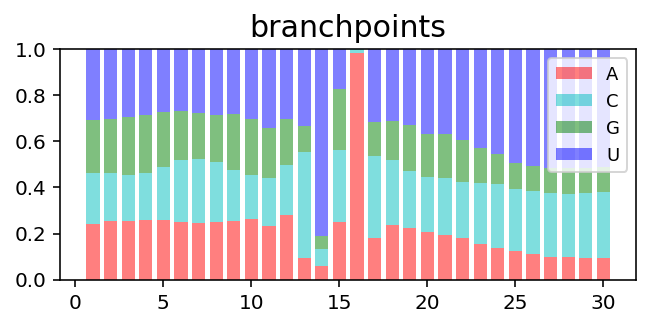

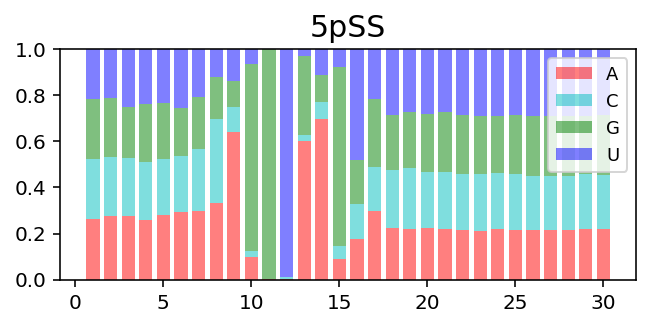

In [16]:
bp_l, bp_r = 15, 15
fp_l, fp_r = 10, 20
bp_seqs, fp_seqs = [], []
for i in range(X_all.shape[0]):
    bp = np.argmax(y_all[i])
    if bp_l < bp < 70 - bp_r:
        bp_seqs += [X_all[i, bp-bp_l:bp+bp_r].reshape(1, -1, 4)]
        fp_seqs += [a_fives[i, 20-fp_l:20+fp_r].reshape(1, -1, 4)]
bp_seqs, fp_seqs = np.vstack(bp_seqs), np.vstack(fp_seqs)
print bp_seqs.shape, fp_seqs.shape

pwm_logo(pwm(bp_seqs), 'branchpoints')
pwm_logo(pwm(fp_seqs), '5pSS')

5.952795416e-05
['0.24', '0.22', '0.22', '0.30']
['0.00', '0.00', '0.99', '0.00']


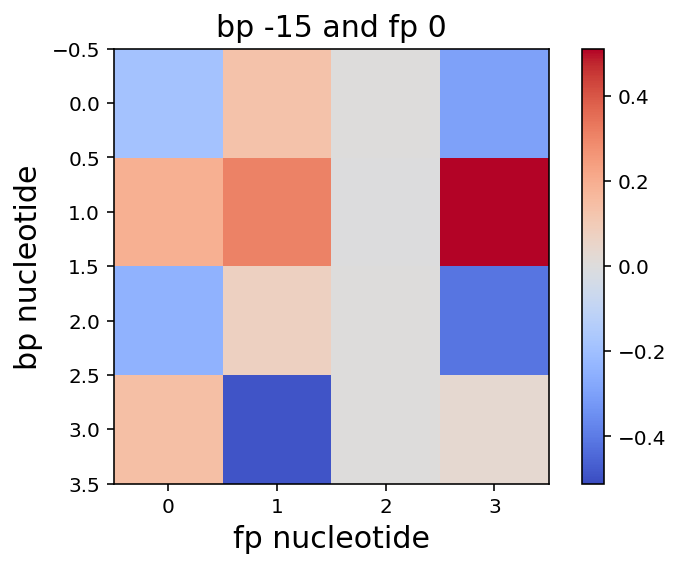

8.96809702273e-05
['0.25', '0.21', '0.23', '0.30']
['0.00', '0.00', '0.99', '0.00']


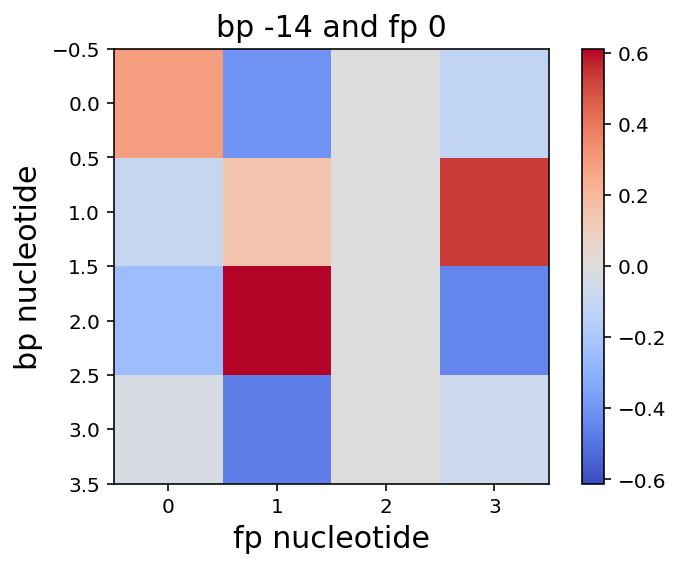

4.74781864073e-05
['0.25', '0.19', '0.24', '0.29']
['0.00', '0.00', '0.99', '0.00']


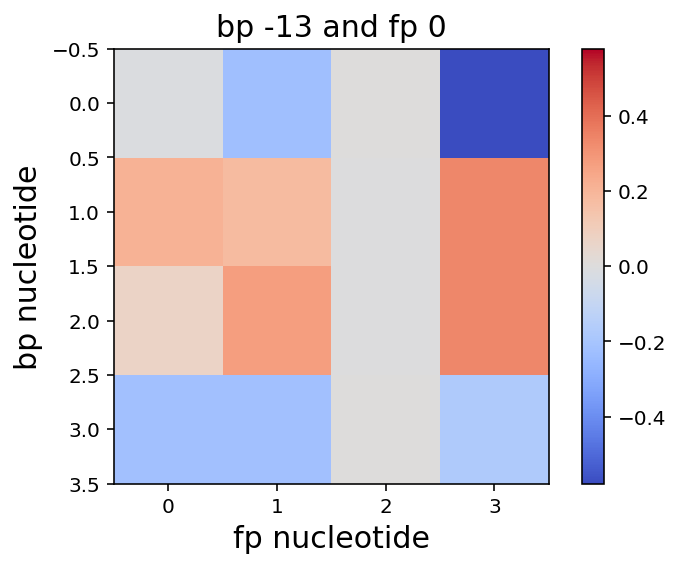

3.98489131019e-05
['0.26', '0.20', '0.25', '0.28']
['0.00', '0.00', '0.99', '0.00']


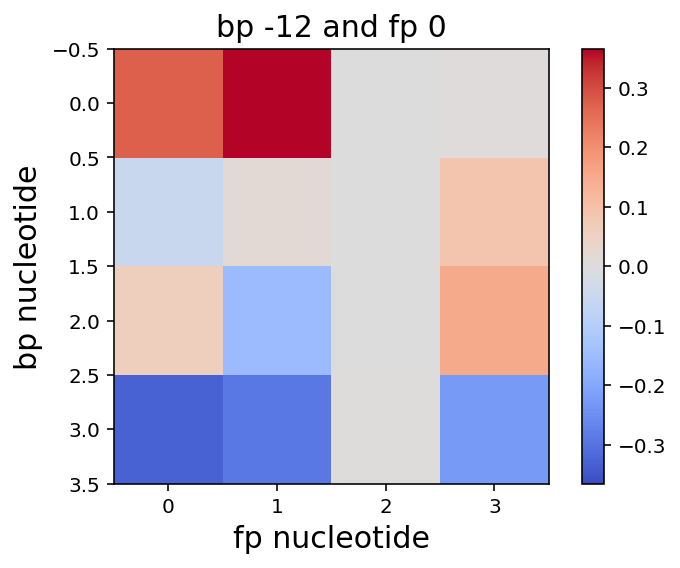

6.26815202254e-05
['0.25', '0.23', '0.23', '0.27']
['0.00', '0.00', '0.99', '0.00']


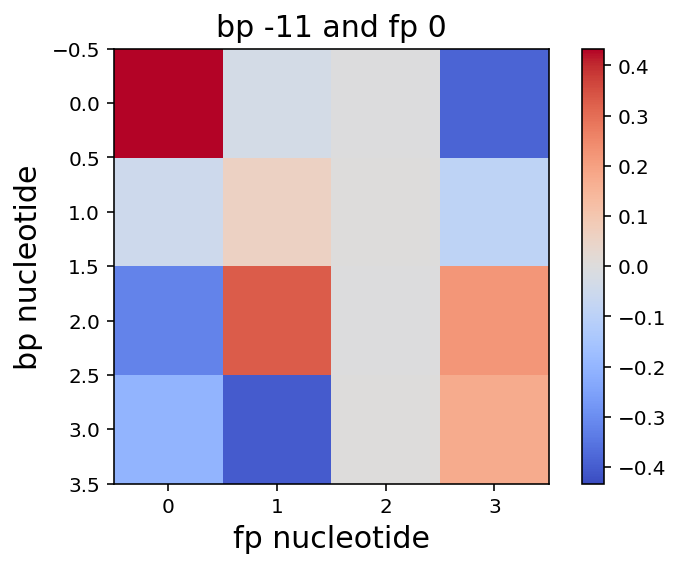

8.16593071768e-05
['0.24', '0.27', '0.21', '0.26']
['0.00', '0.00', '0.99', '0.00']


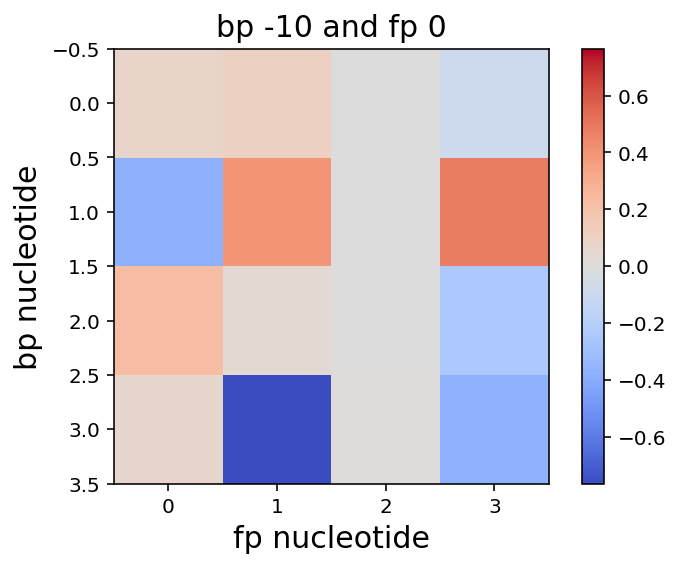

2.69503012964e-05
['0.24', '0.27', '0.19', '0.27']
['0.00', '0.00', '0.99', '0.00']


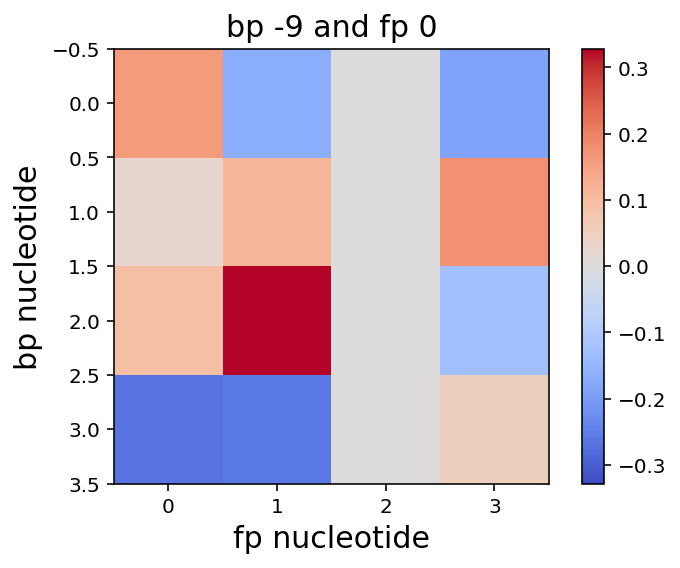

0.000104387332876
['0.25', '0.25', '0.20', '0.28']
['0.00', '0.00', '0.99', '0.00']


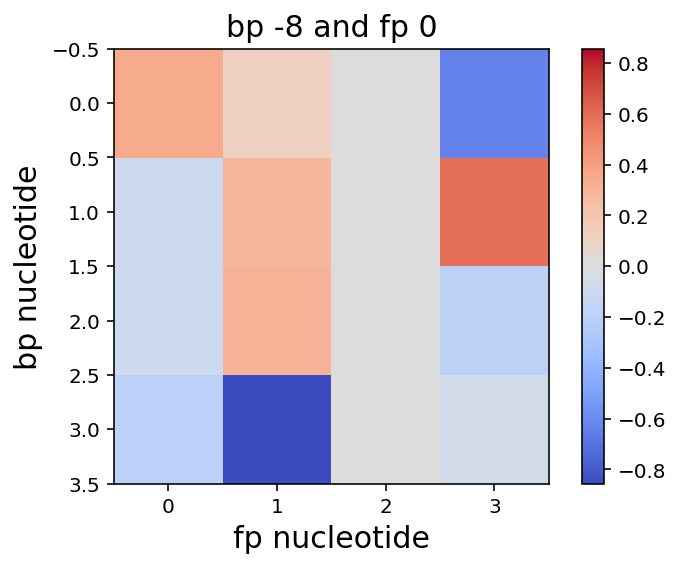

3.74956257926e-05
['0.25', '0.22', '0.23', '0.28']
['0.00', '0.00', '0.99', '0.00']


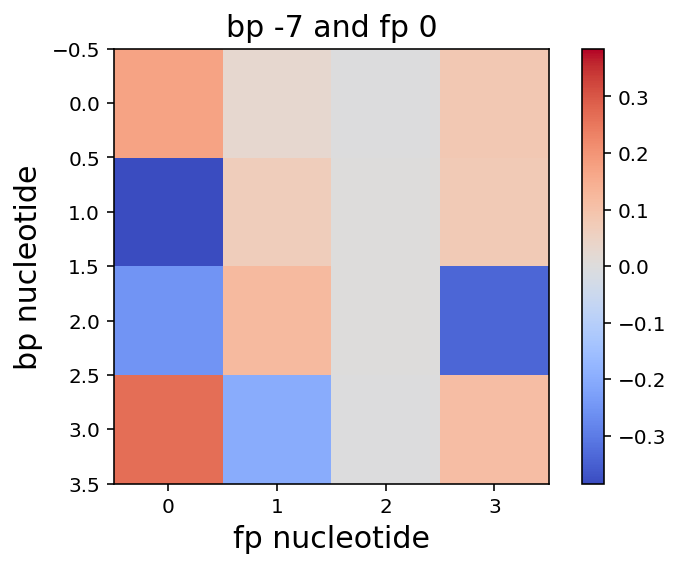

5.61937533147e-05
['0.26', '0.19', '0.24', '0.30']
['0.00', '0.00', '0.99', '0.00']


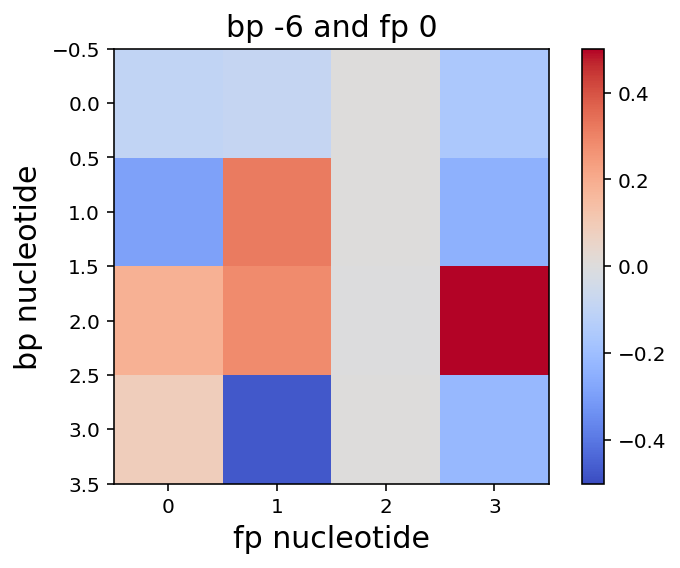

3.67656033676e-05
['0.23', '0.20', '0.21', '0.34']
['0.00', '0.00', '0.99', '0.00']


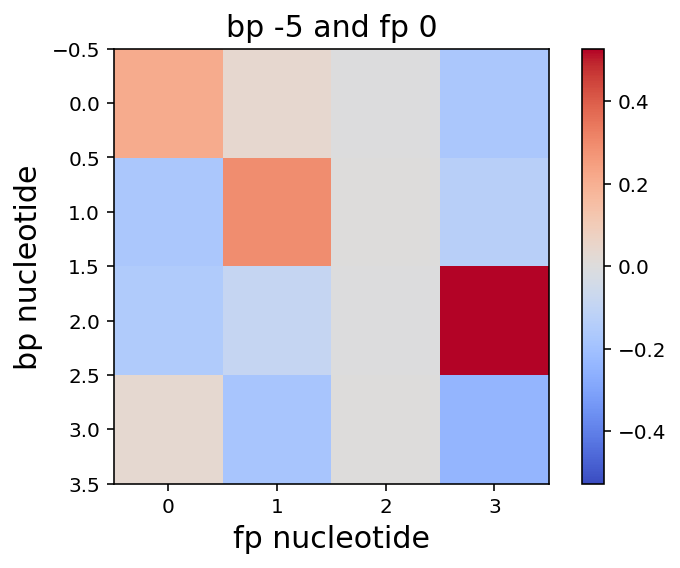

5.38771529402e-05
['0.27', '0.21', '0.19', '0.30']
['0.00', '0.00', '0.99', '0.00']


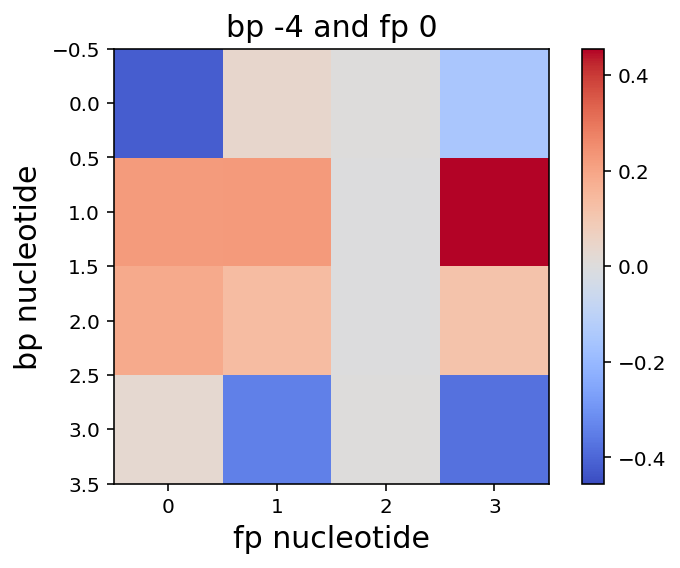

5.01201807667e-05
['0.09', '0.46', '0.11', '0.33']
['0.00', '0.00', '0.99', '0.00']


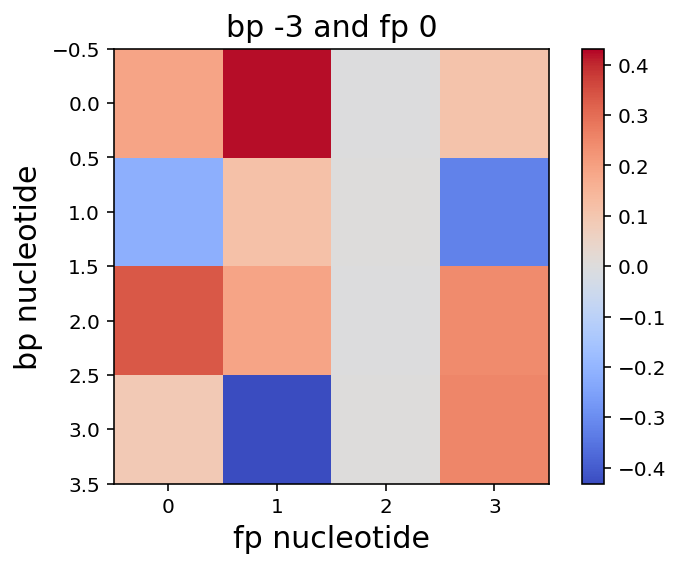

0.000109190520615
['0.06', '0.07', '0.05', '0.81']
['0.00', '0.00', '0.99', '0.00']


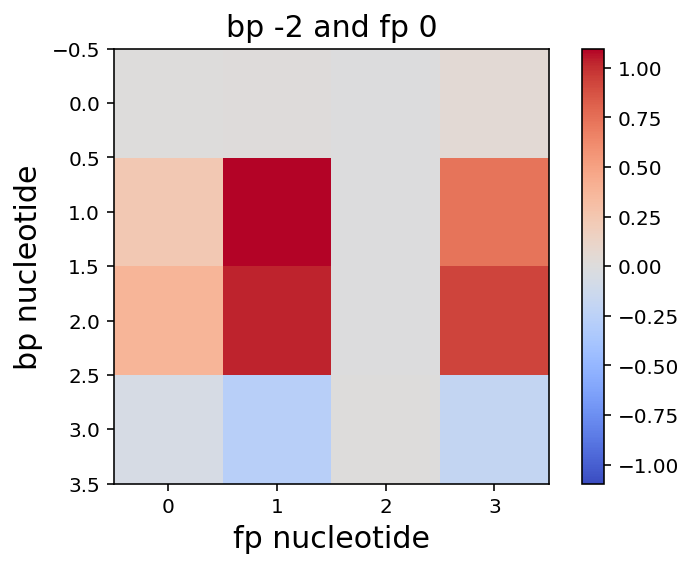

0.000103053136319
['0.24', '0.31', '0.26', '0.17']
['0.00', '0.00', '0.99', '0.00']


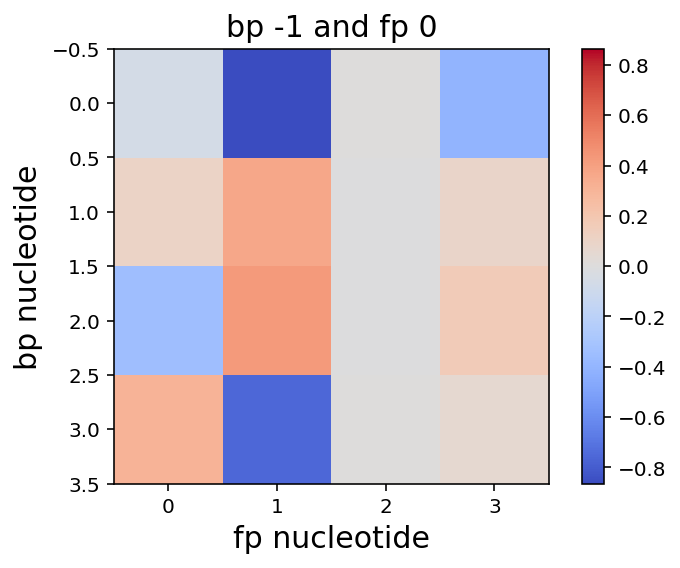

nan
['0.98', '0.01', '0.00', '0.00']
['0.00', '0.00', '0.99', '0.00']


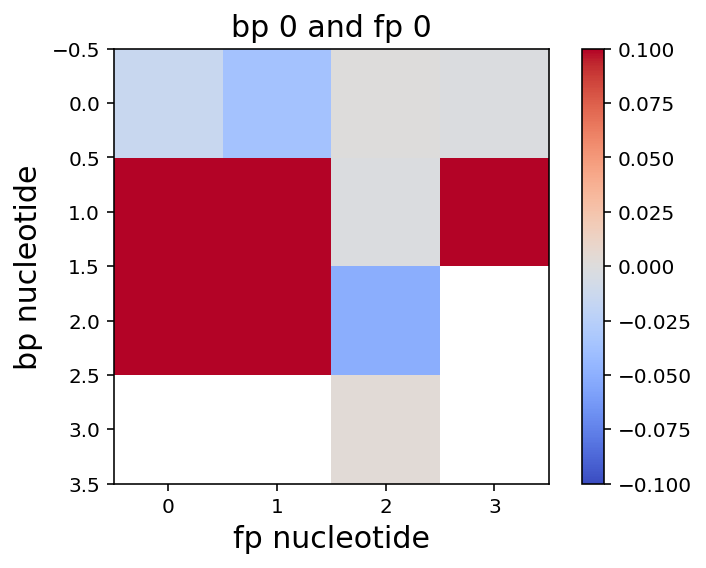

9.71009911546e-05
['0.18', '0.35', '0.14', '0.31']
['0.00', '0.00', '0.99', '0.00']


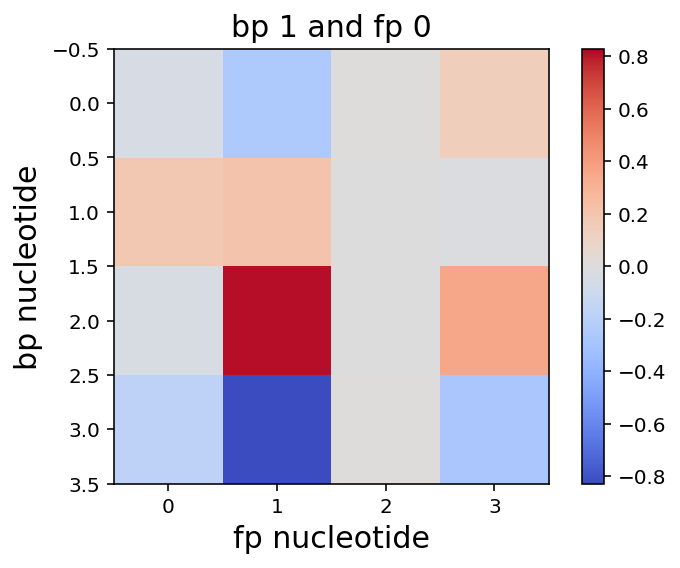

4.17083793112e-05
['0.23', '0.28', '0.16', '0.31']
['0.00', '0.00', '0.99', '0.00']


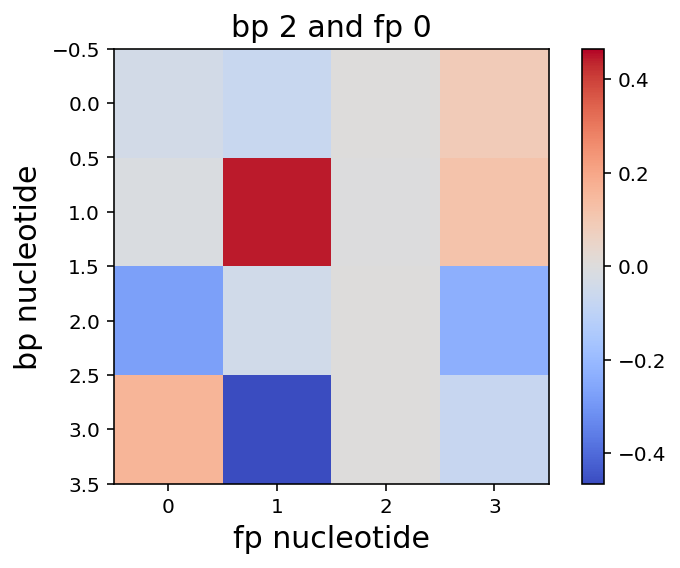

6.08830248435e-05
['0.22', '0.24', '0.20', '0.32']
['0.00', '0.00', '0.99', '0.00']


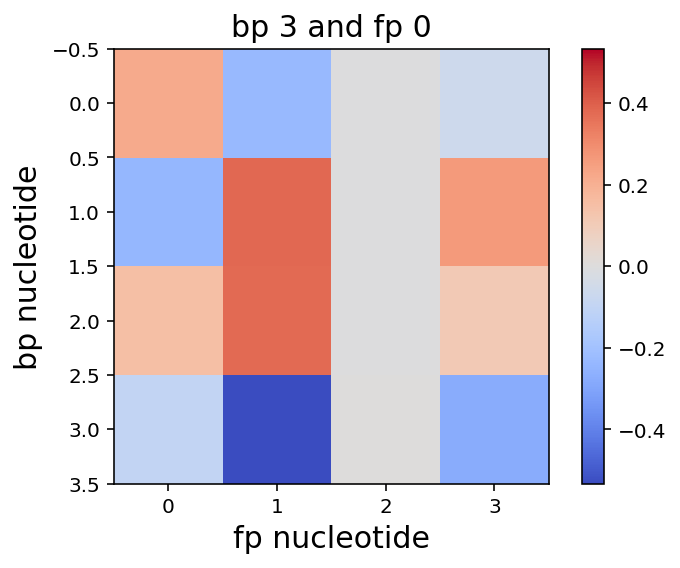

5.06813518381e-05
['0.20', '0.23', '0.18', '0.36']
['0.00', '0.00', '0.99', '0.00']


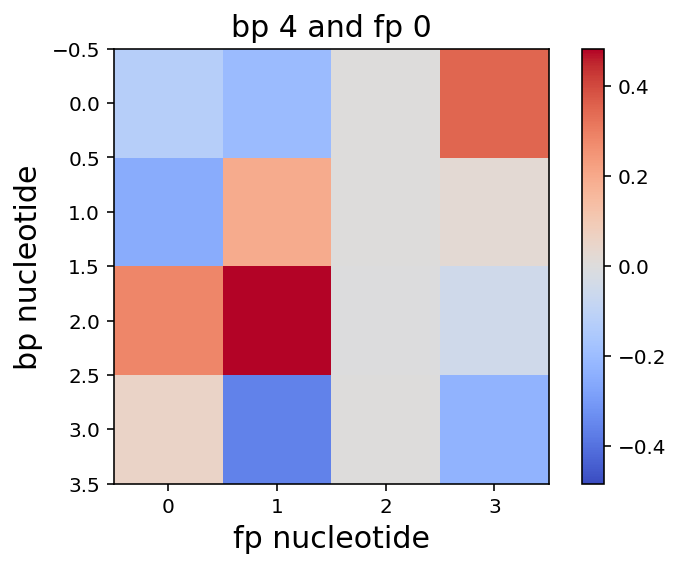

8.03437068636e-05
['0.19', '0.24', '0.19', '0.36']
['0.00', '0.00', '0.99', '0.00']


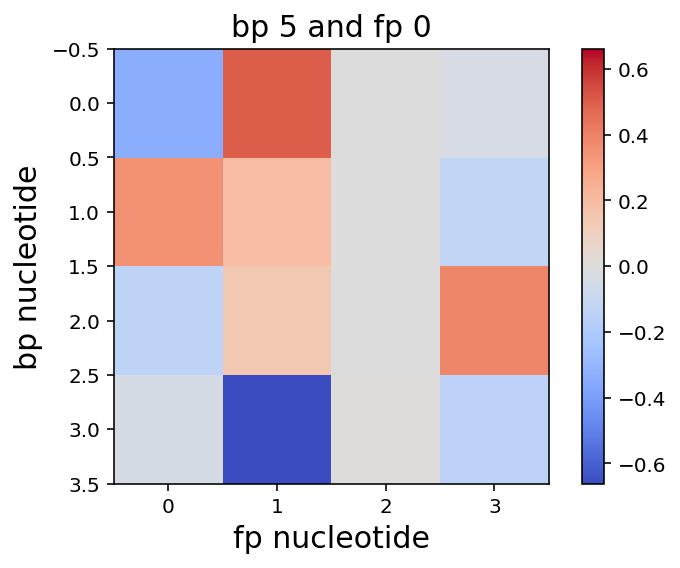

7.79930440032e-05
['0.18', '0.24', '0.18', '0.39']
['0.00', '0.00', '0.99', '0.00']


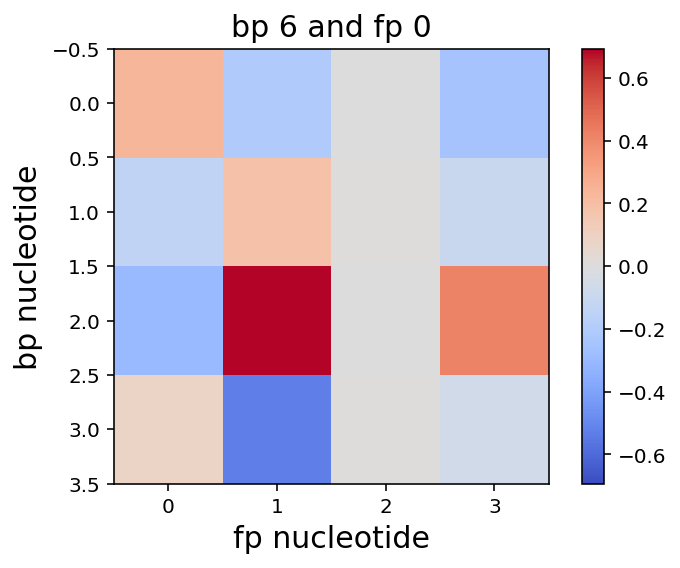

4.74983477042e-05
['0.15', '0.26', '0.15', '0.42']
['0.00', '0.00', '0.99', '0.00']


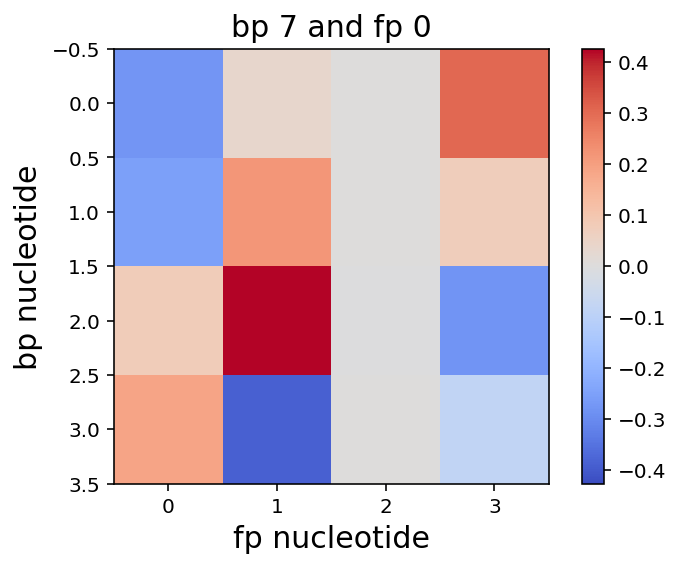

4.5906100816e-05
['0.13', '0.27', '0.12', '0.45']
['0.00', '0.00', '0.99', '0.00']


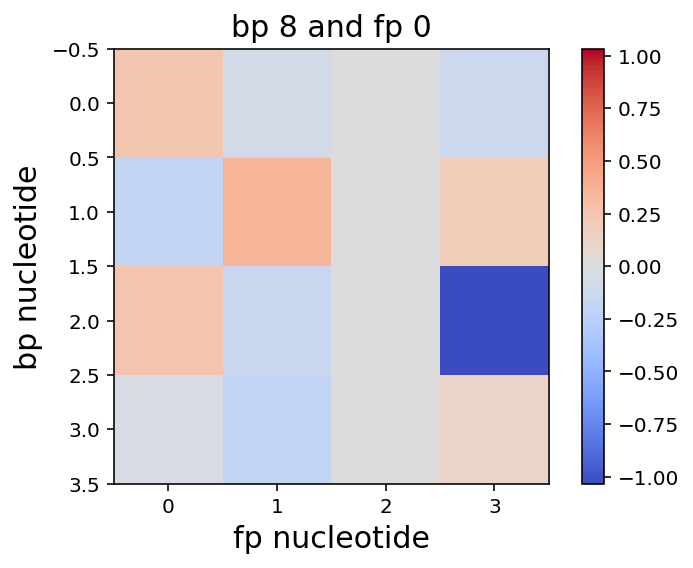

9.5091081354e-05
['0.12', '0.27', '0.11', '0.49']
['0.00', '0.00', '0.99', '0.00']


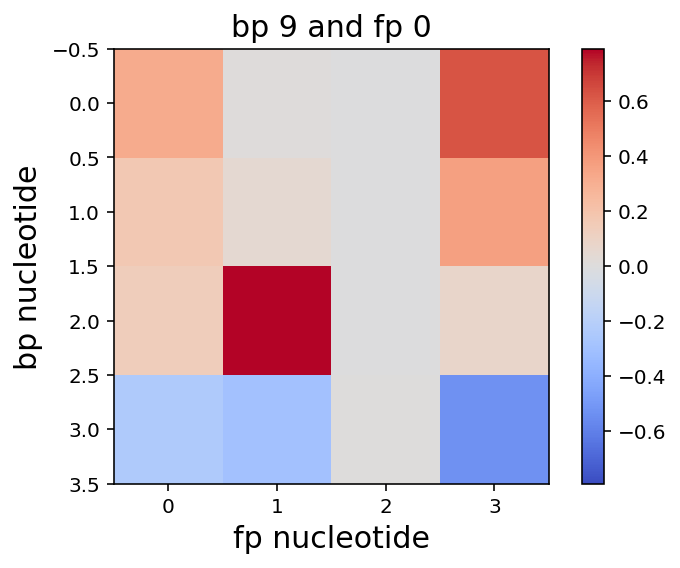

0.000169544798581
['0.11', '0.27', '0.11', '0.50']
['0.00', '0.00', '0.99', '0.00']


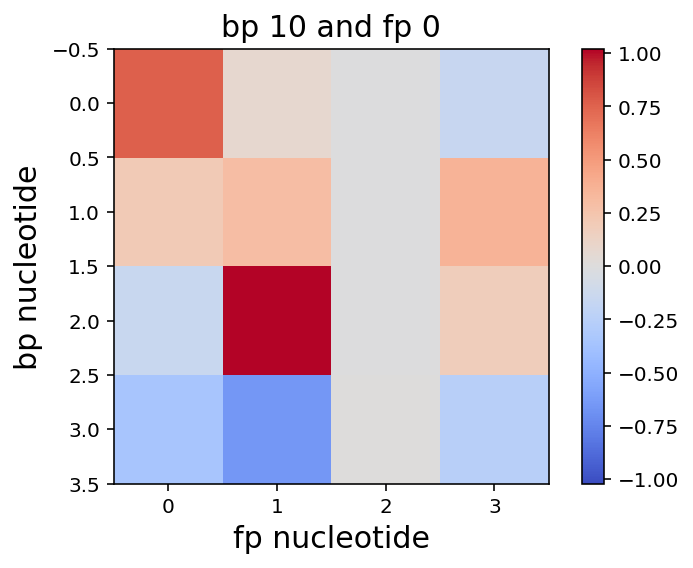

0.000182734437816
['0.09', '0.27', '0.11', '0.51']
['0.00', '0.00', '0.99', '0.00']


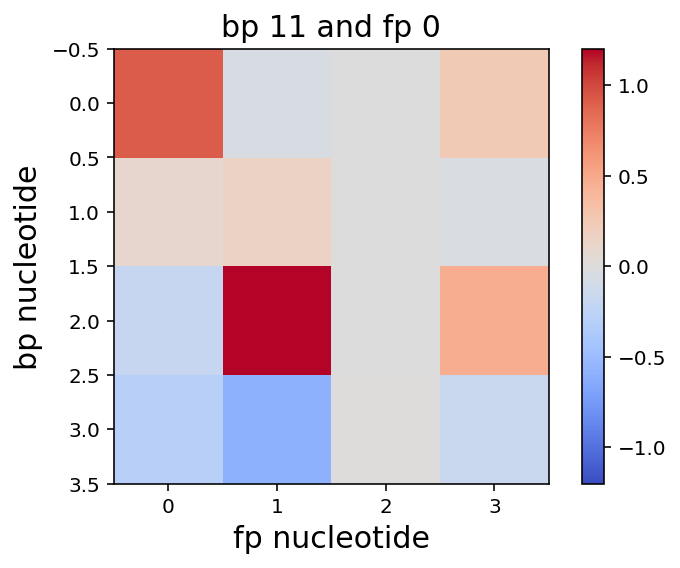

0.000104404781178
['0.09', '0.27', '0.11', '0.51']
['0.00', '0.00', '0.99', '0.00']


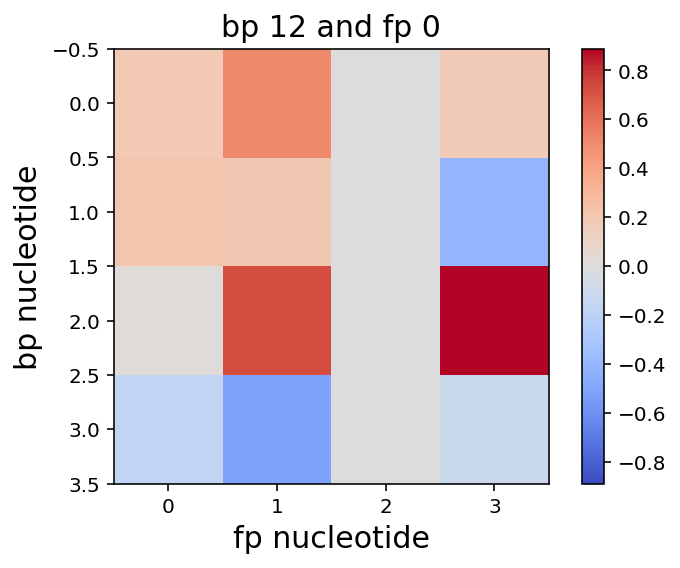

0.000161216315269
['0.09', '0.28', '0.10', '0.51']
['0.00', '0.00', '0.99', '0.00']


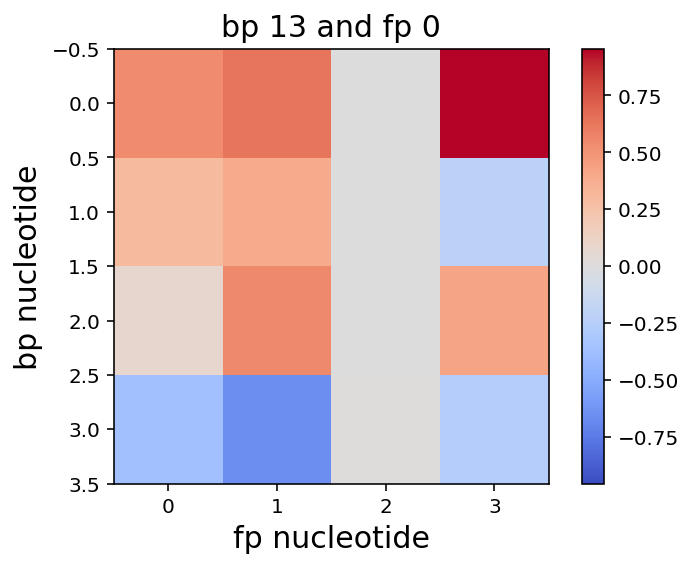

0.000238838222304
['0.09', '0.28', '0.10', '0.51']
['0.00', '0.00', '0.99', '0.00']


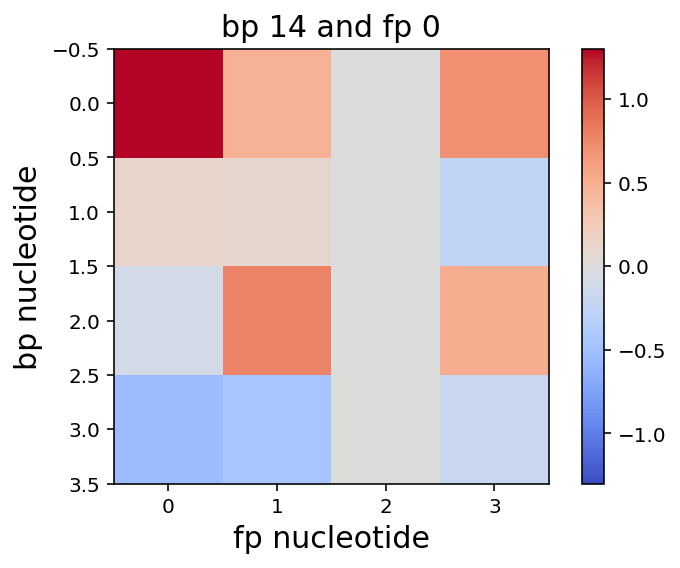

4.68431762553e-05
['0.24', '0.22', '0.22', '0.30']
['0.00', '0.01', '0.00', '0.98']


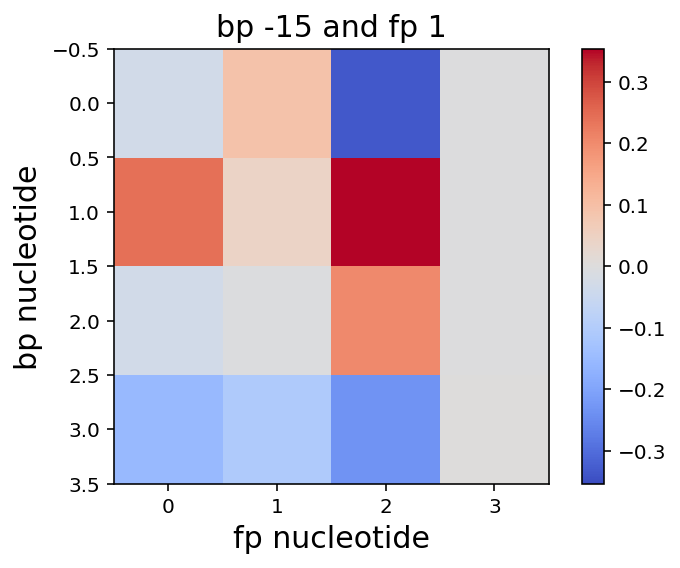

0.000129625688478
['0.25', '0.21', '0.23', '0.30']
['0.00', '0.01', '0.00', '0.98']


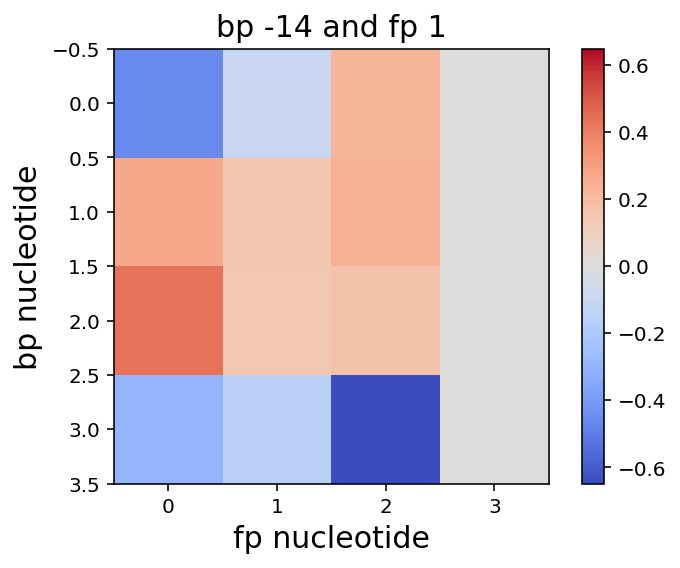

0.000144228140311
['0.25', '0.19', '0.24', '0.29']
['0.00', '0.01', '0.00', '0.98']


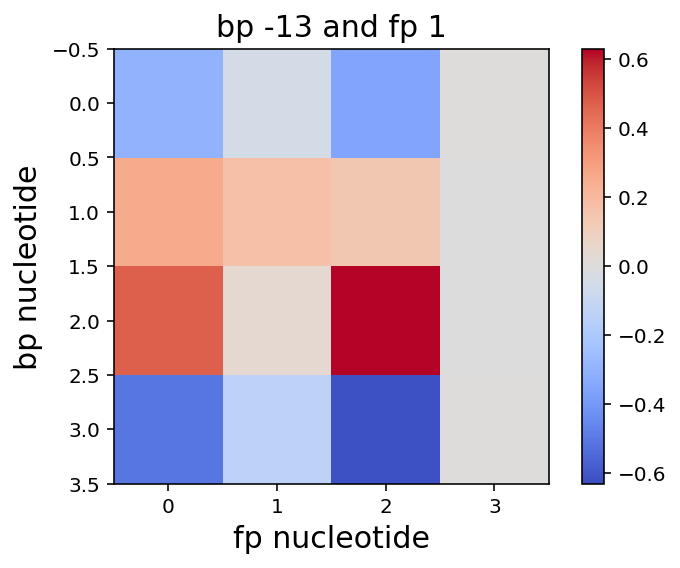

7.31880433247e-05
['0.26', '0.20', '0.25', '0.28']
['0.00', '0.01', '0.00', '0.98']


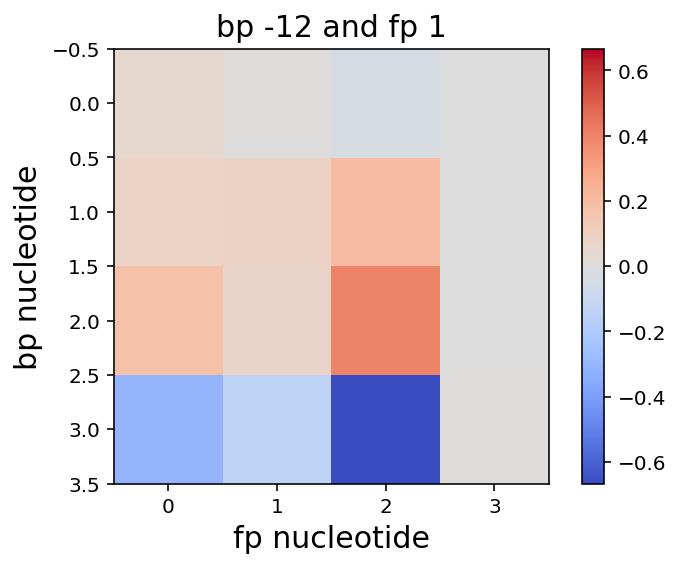

0.000132880148112
['0.25', '0.23', '0.23', '0.27']
['0.00', '0.01', '0.00', '0.98']


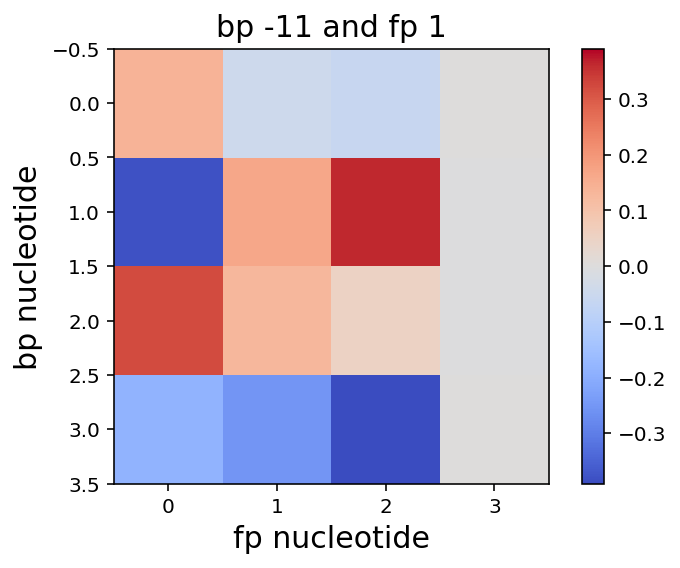

7.1080923502e-05
['0.24', '0.27', '0.21', '0.26']
['0.00', '0.01', '0.00', '0.98']


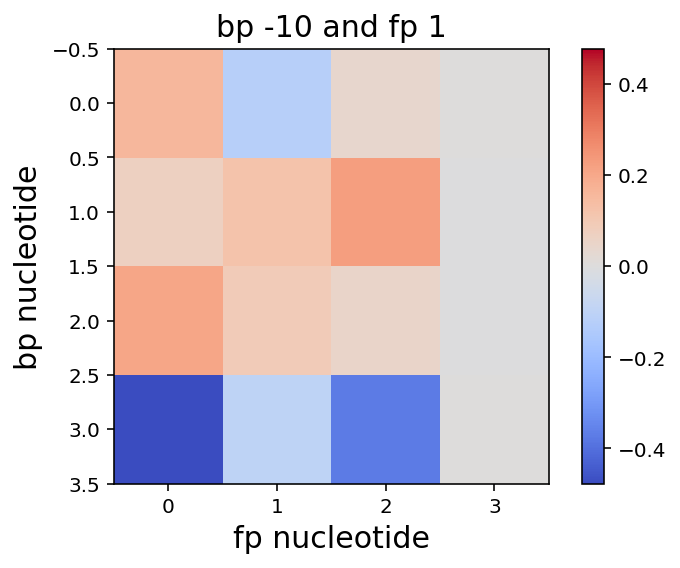

4.05473267761e-05
['0.24', '0.27', '0.19', '0.27']
['0.00', '0.01', '0.00', '0.98']


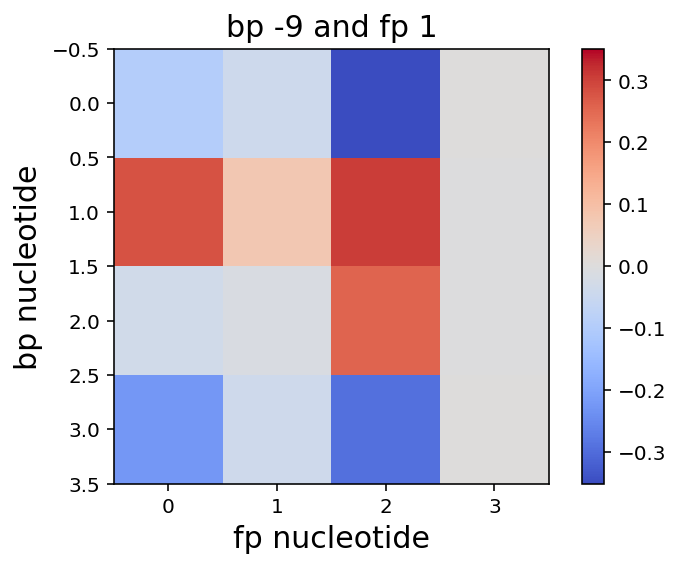

8.24843444138e-05
['0.25', '0.25', '0.20', '0.28']
['0.00', '0.01', '0.00', '0.98']


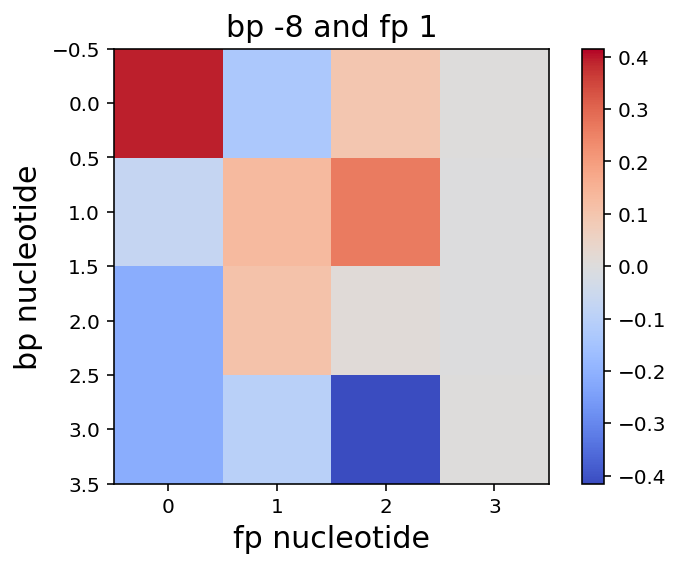

9.45070587839e-05
['0.25', '0.22', '0.23', '0.28']
['0.00', '0.01', '0.00', '0.98']


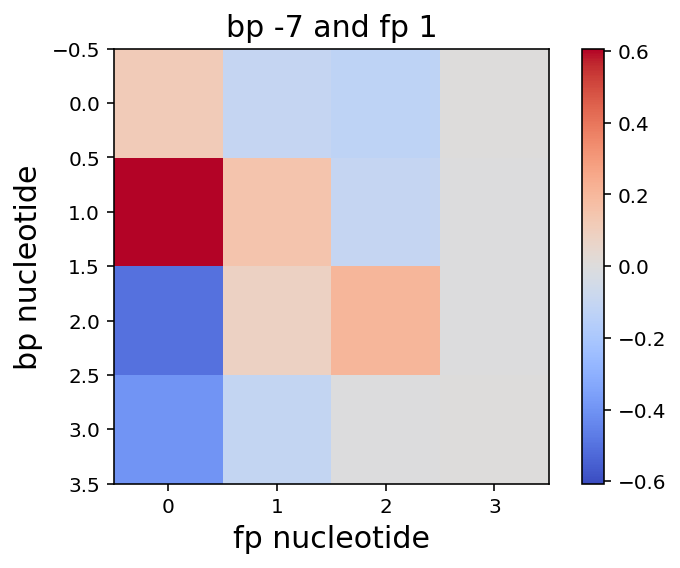

7.63351263212e-05
['0.26', '0.19', '0.24', '0.30']
['0.00', '0.01', '0.00', '0.98']


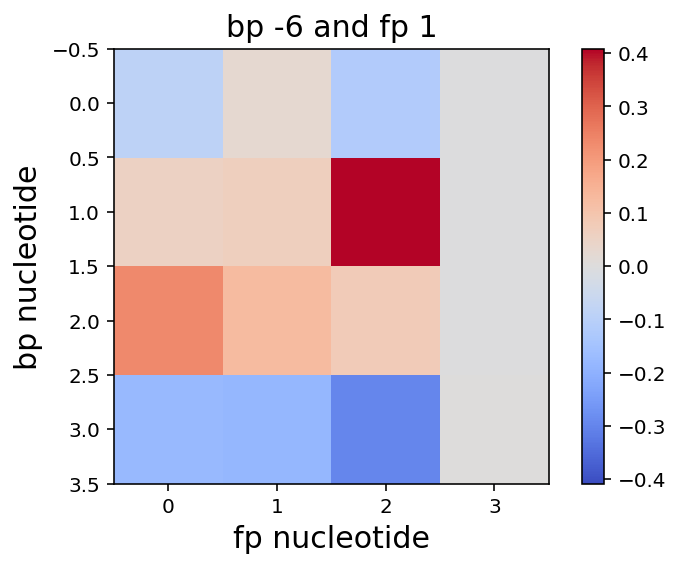

7.20977956646e-05
['0.23', '0.20', '0.21', '0.34']
['0.00', '0.01', '0.00', '0.98']


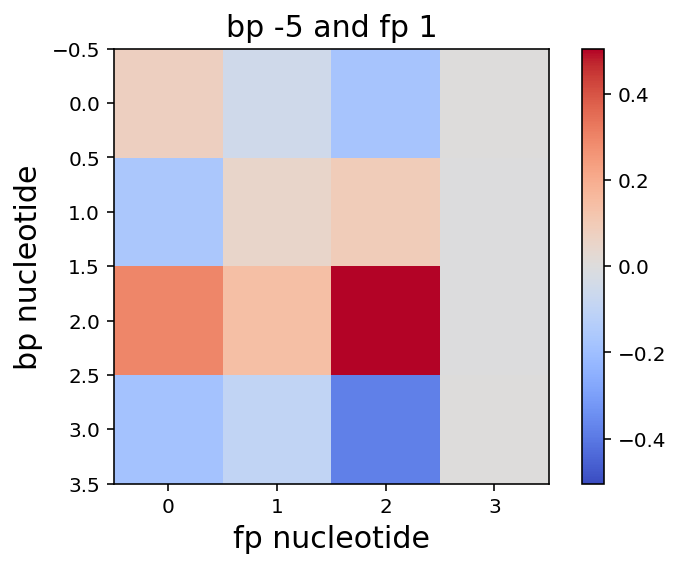

0.000126486678148
['0.27', '0.21', '0.19', '0.30']
['0.00', '0.01', '0.00', '0.98']


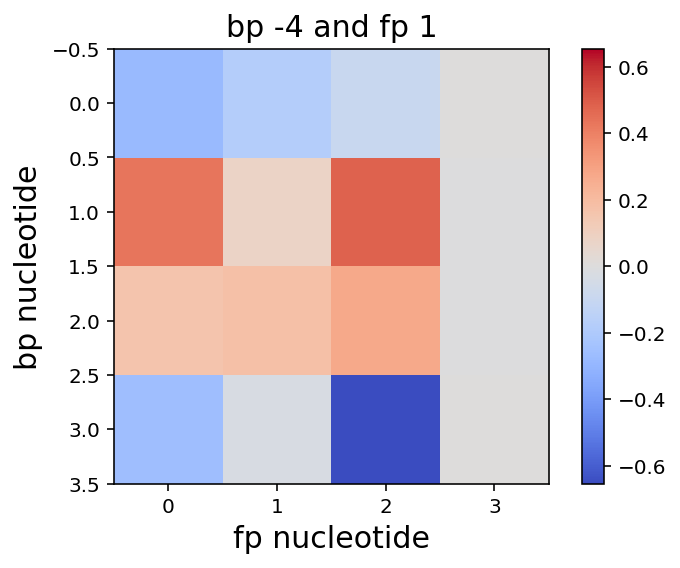

5.2648652064e-05
['0.09', '0.46', '0.11', '0.33']
['0.00', '0.01', '0.00', '0.98']


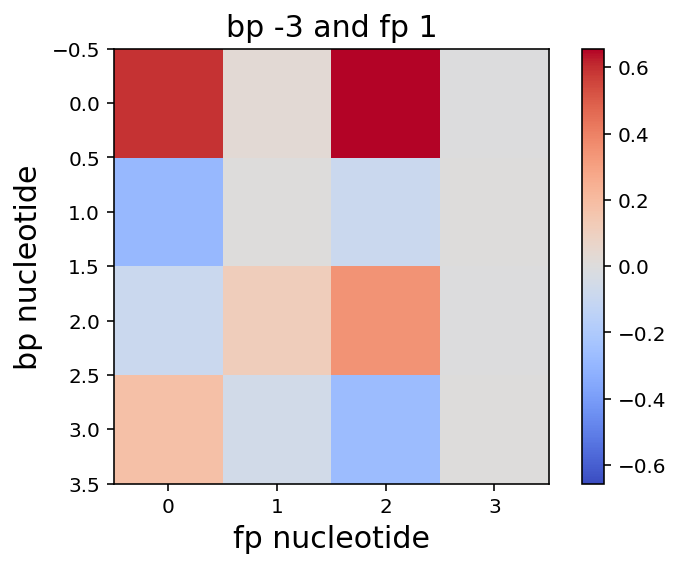

0.000263490704043
['0.06', '0.07', '0.05', '0.81']
['0.00', '0.01', '0.00', '0.98']


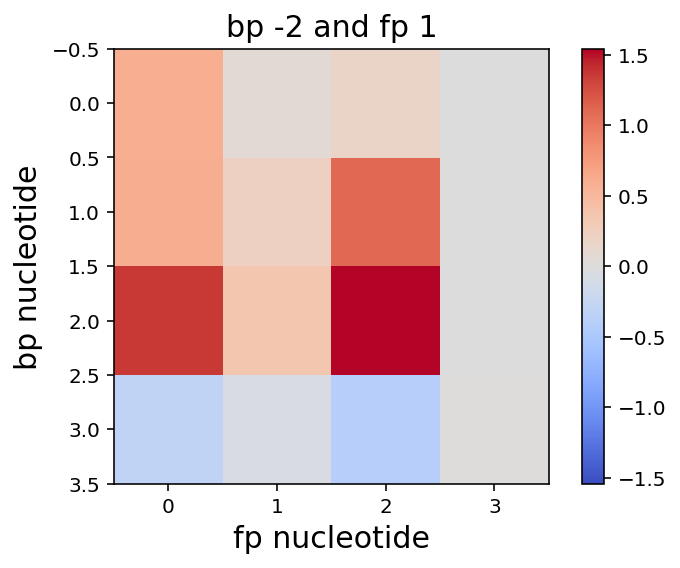

0.000134665009879
['0.24', '0.31', '0.26', '0.17']
['0.00', '0.01', '0.00', '0.98']


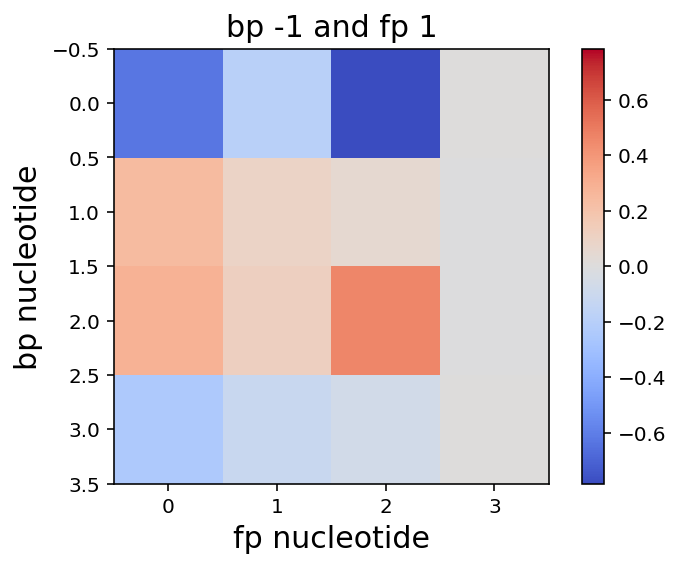

nan
['0.98', '0.01', '0.00', '0.00']
['0.00', '0.01', '0.00', '0.98']


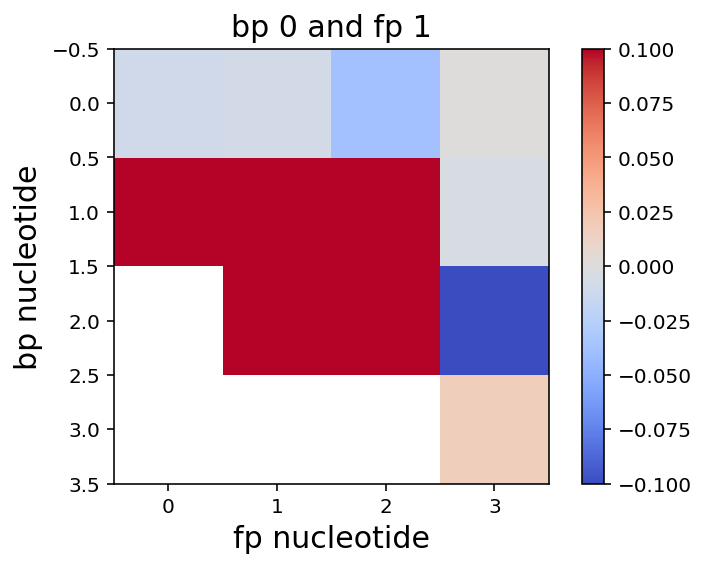

0.000207890003546
['0.18', '0.35', '0.14', '0.31']
['0.00', '0.01', '0.00', '0.98']


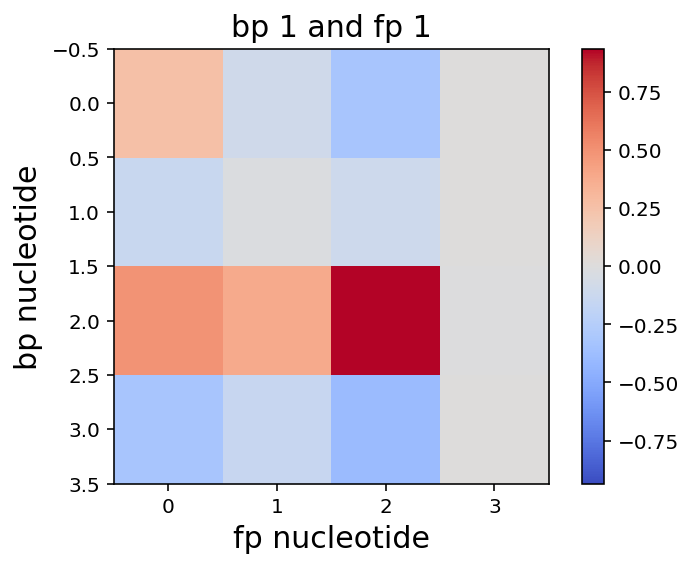

0.000197063026001
['0.23', '0.28', '0.16', '0.31']
['0.00', '0.01', '0.00', '0.98']


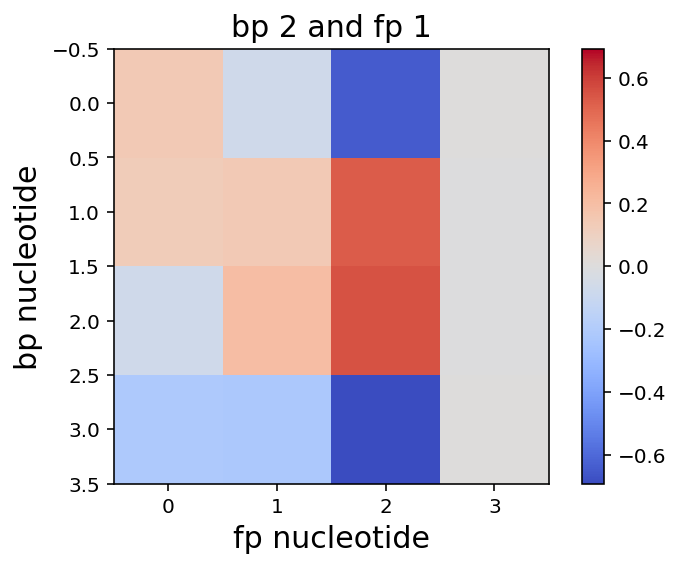

9.02915190836e-05
['0.22', '0.24', '0.20', '0.32']
['0.00', '0.01', '0.00', '0.98']


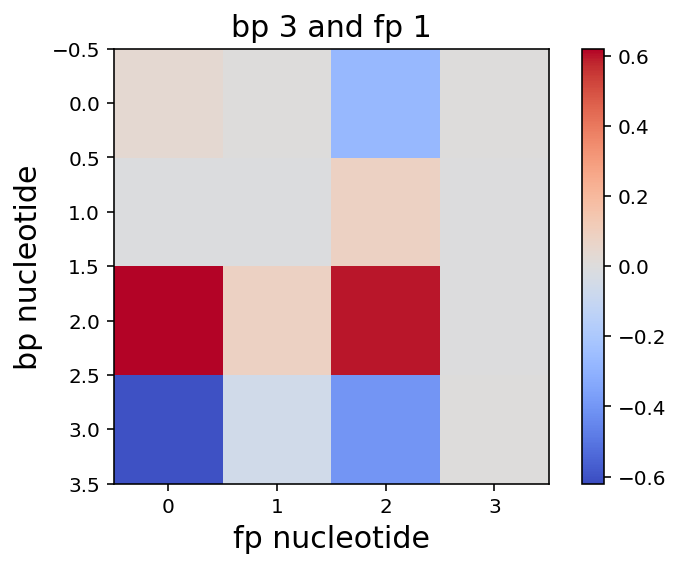

0.000109249125215
['0.20', '0.23', '0.18', '0.36']
['0.00', '0.01', '0.00', '0.98']


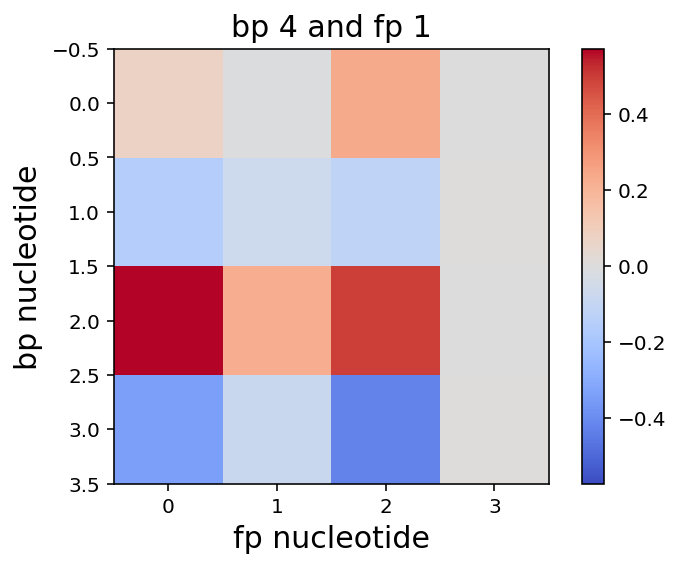

0.000264552591669
['0.19', '0.24', '0.19', '0.36']
['0.00', '0.01', '0.00', '0.98']


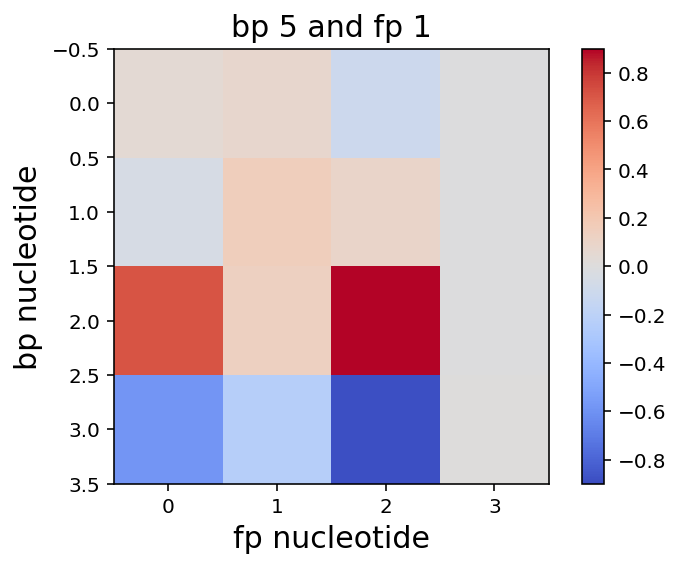

0.000194300423927
['0.18', '0.24', '0.18', '0.39']
['0.00', '0.01', '0.00', '0.98']


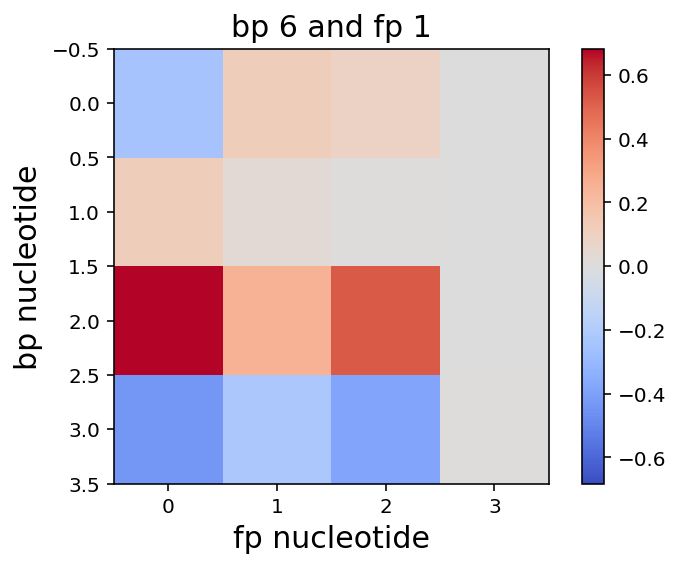

0.000141190379035
['0.15', '0.26', '0.15', '0.42']
['0.00', '0.01', '0.00', '0.98']


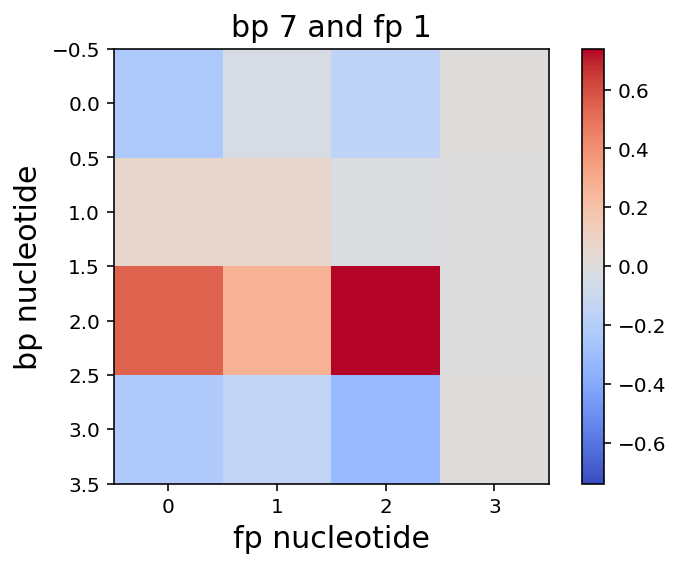

0.000158488241379
['0.13', '0.27', '0.12', '0.45']
['0.00', '0.01', '0.00', '0.98']


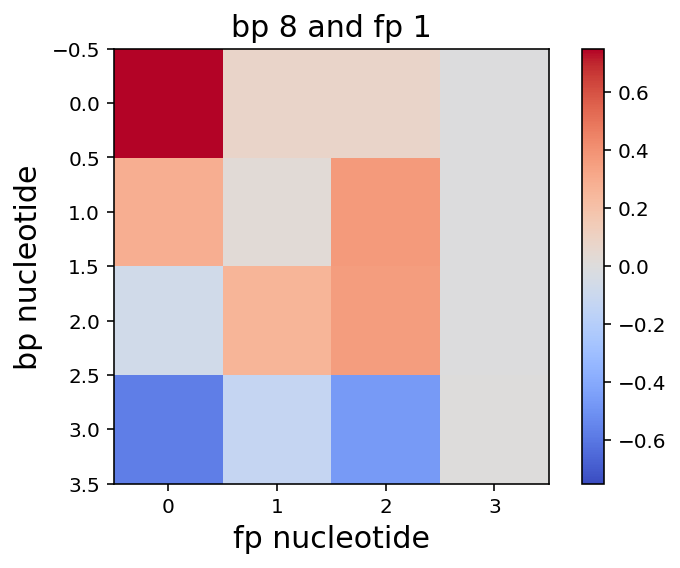

0.000140189882035
['0.12', '0.27', '0.11', '0.49']
['0.00', '0.01', '0.00', '0.98']


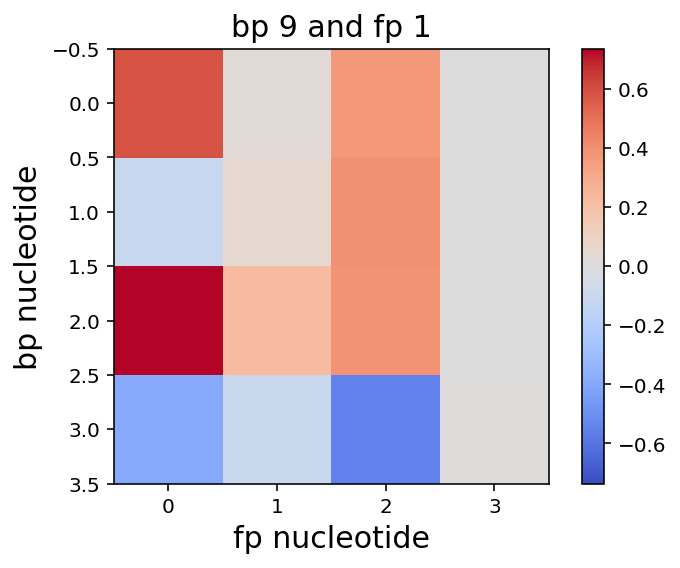

0.000181487815281
['0.11', '0.27', '0.11', '0.50']
['0.00', '0.01', '0.00', '0.98']


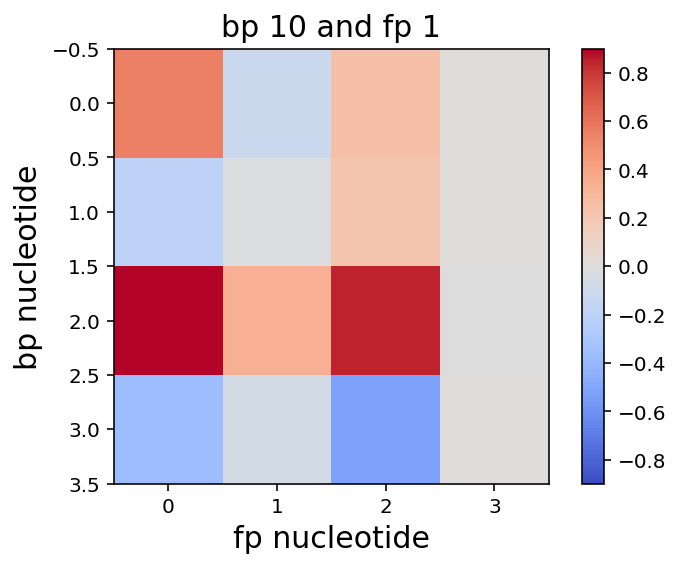

0.000283105291322
['0.09', '0.27', '0.11', '0.51']
['0.00', '0.01', '0.00', '0.98']


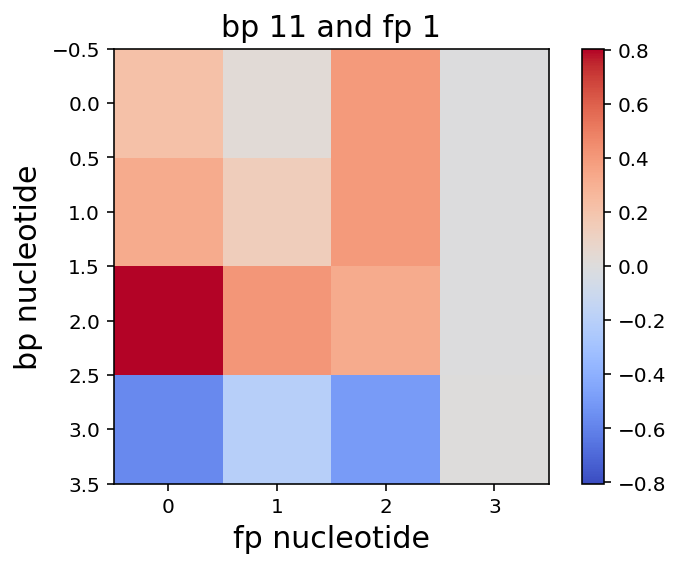

0.000192962093205
['0.09', '0.27', '0.11', '0.51']
['0.00', '0.01', '0.00', '0.98']


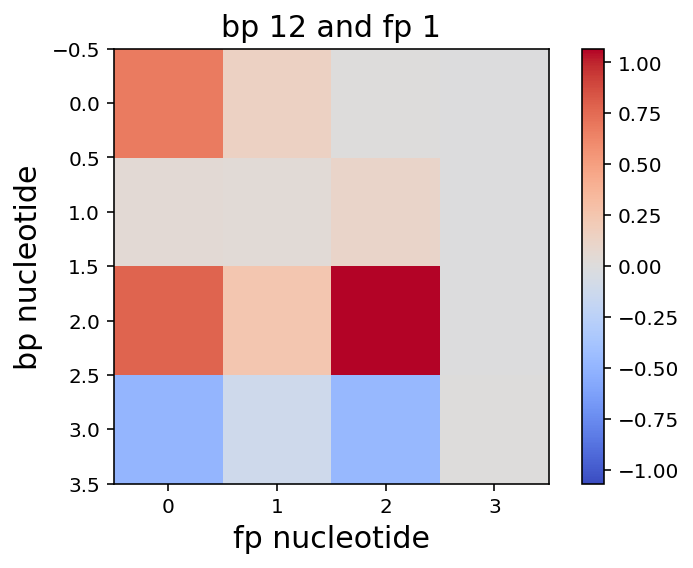

0.000199981986257
['0.09', '0.28', '0.10', '0.51']
['0.00', '0.01', '0.00', '0.98']


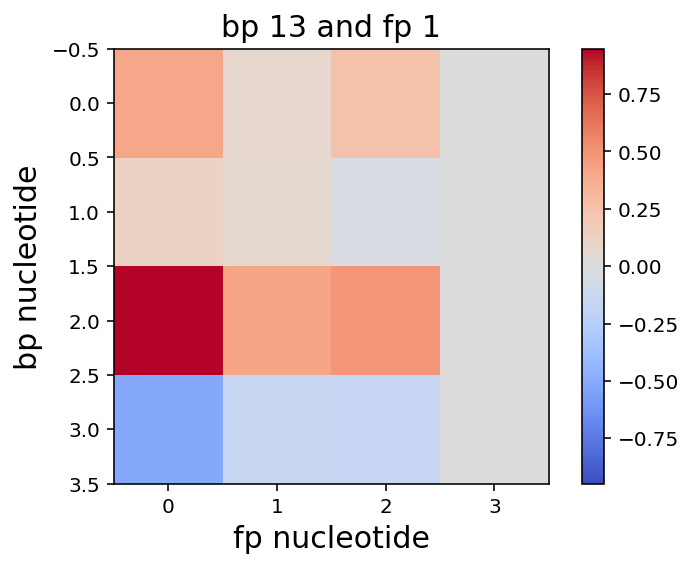

0.000292600172949
['0.09', '0.28', '0.10', '0.51']
['0.00', '0.01', '0.00', '0.98']


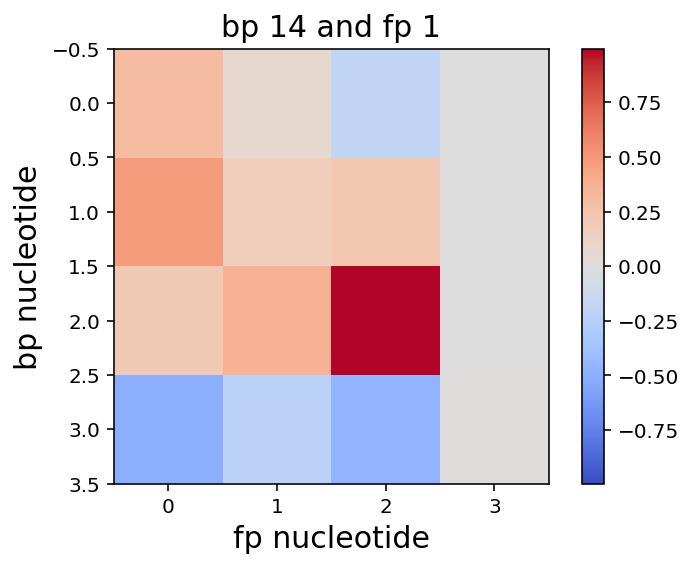

0.00765767305928
['0.24', '0.22', '0.22', '0.30']
['0.60', '0.02', '0.34', '0.02']


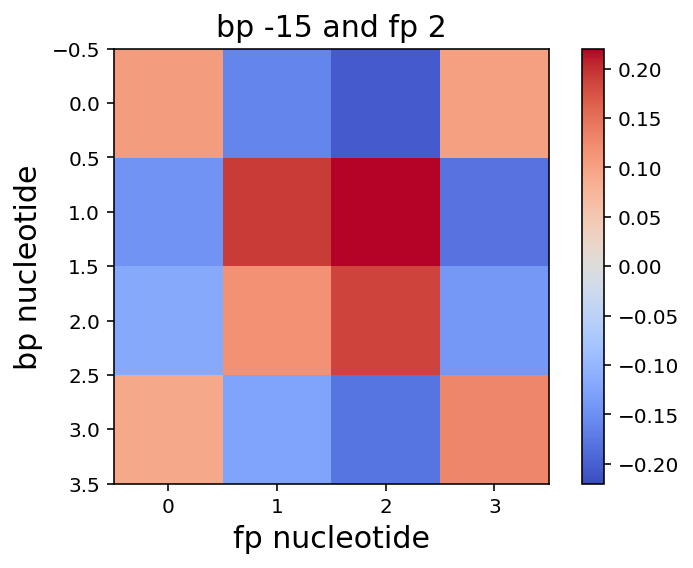

0.00701835756218
['0.25', '0.21', '0.23', '0.30']
['0.60', '0.02', '0.34', '0.02']


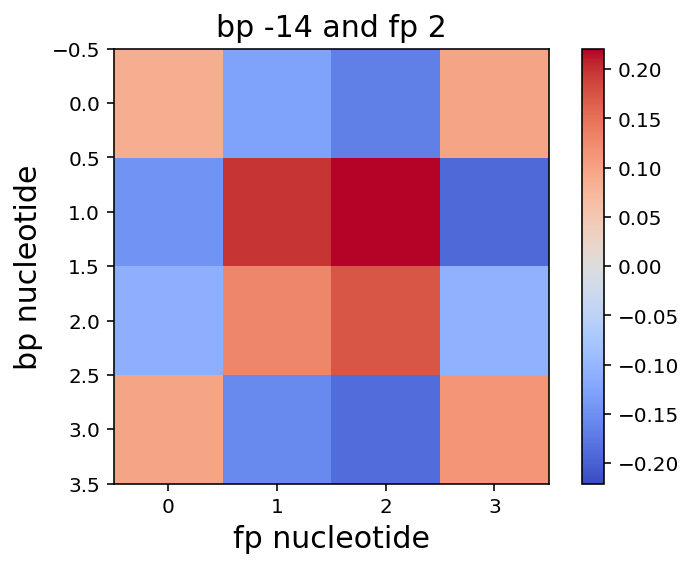

0.00769238310484
['0.25', '0.19', '0.24', '0.29']
['0.60', '0.02', '0.34', '0.02']


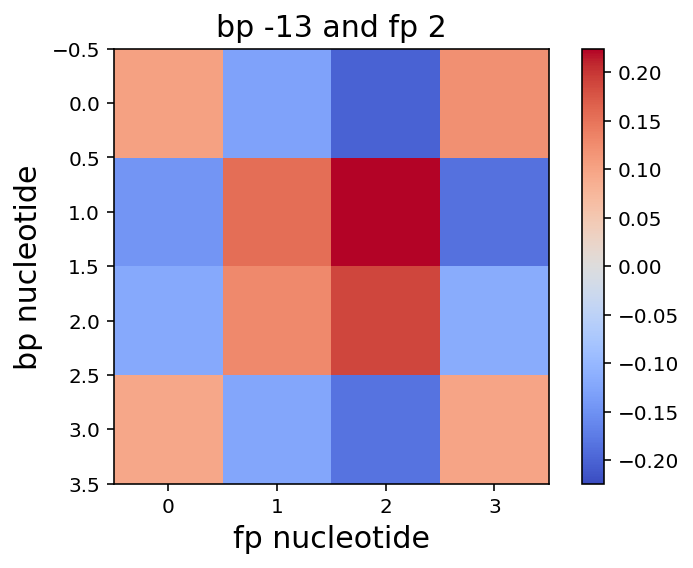

0.00686823035739
['0.26', '0.20', '0.25', '0.28']
['0.60', '0.02', '0.34', '0.02']


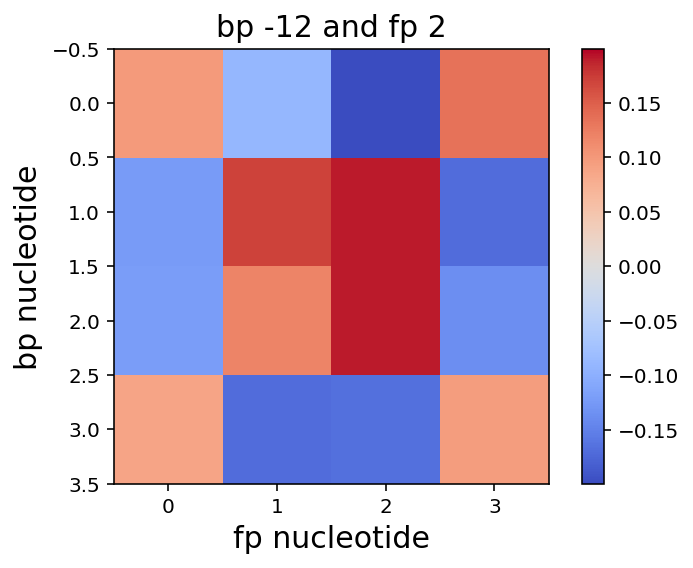

0.00703061319735
['0.25', '0.23', '0.23', '0.27']
['0.60', '0.02', '0.34', '0.02']


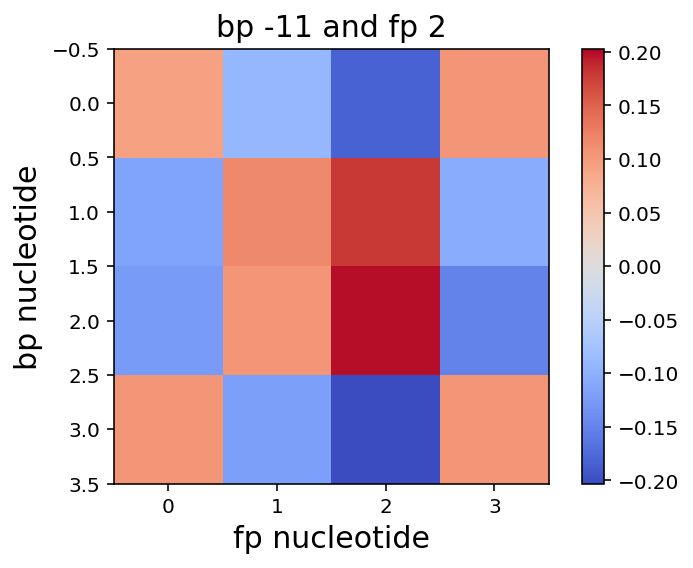

0.00784204450847
['0.24', '0.27', '0.21', '0.26']
['0.60', '0.02', '0.34', '0.02']


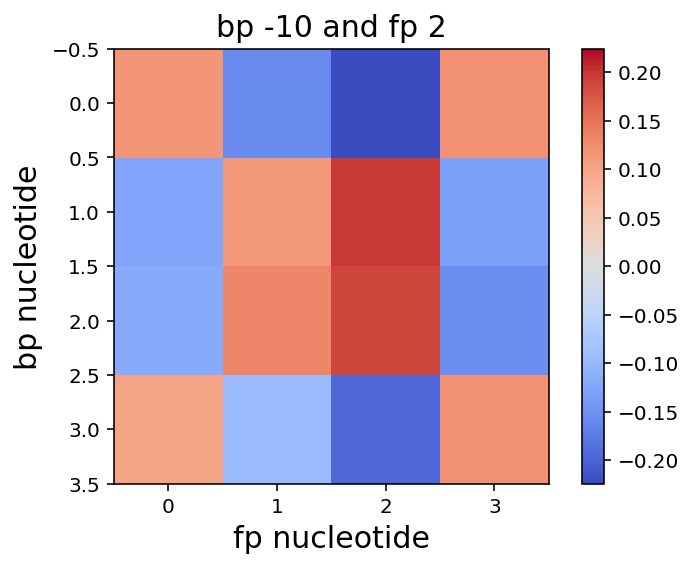

0.00708899133403
['0.24', '0.27', '0.19', '0.27']
['0.60', '0.02', '0.34', '0.02']


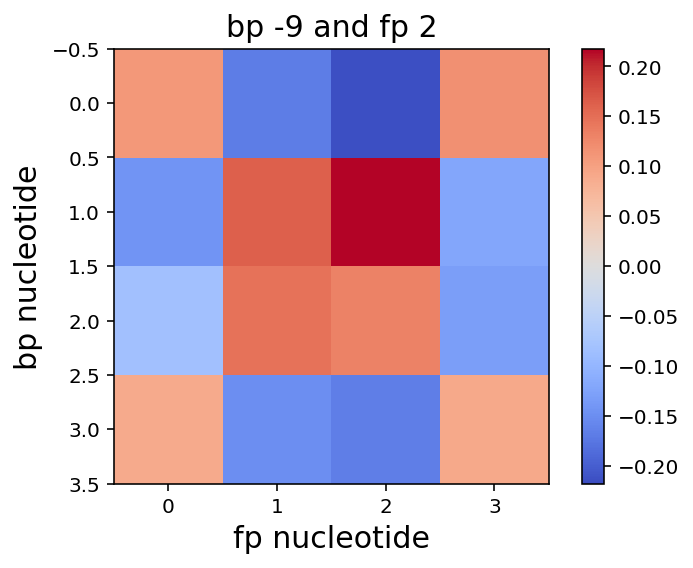

0.00762349293275
['0.25', '0.25', '0.20', '0.28']
['0.60', '0.02', '0.34', '0.02']


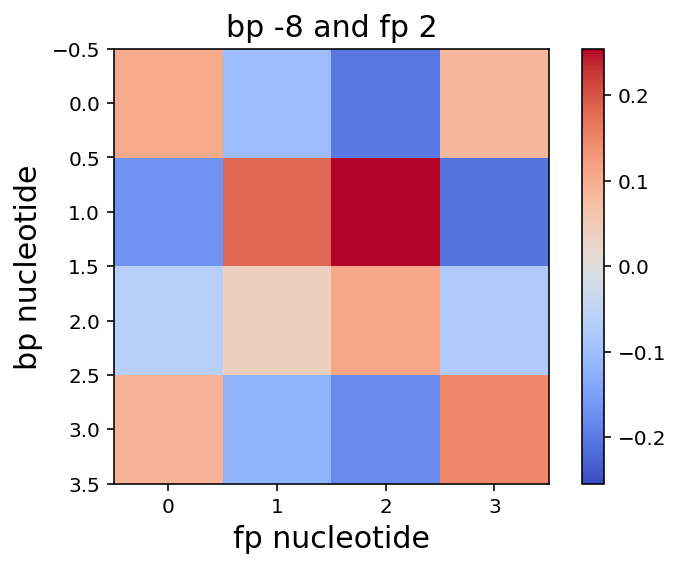

0.00752738195018
['0.25', '0.22', '0.23', '0.28']
['0.60', '0.02', '0.34', '0.02']


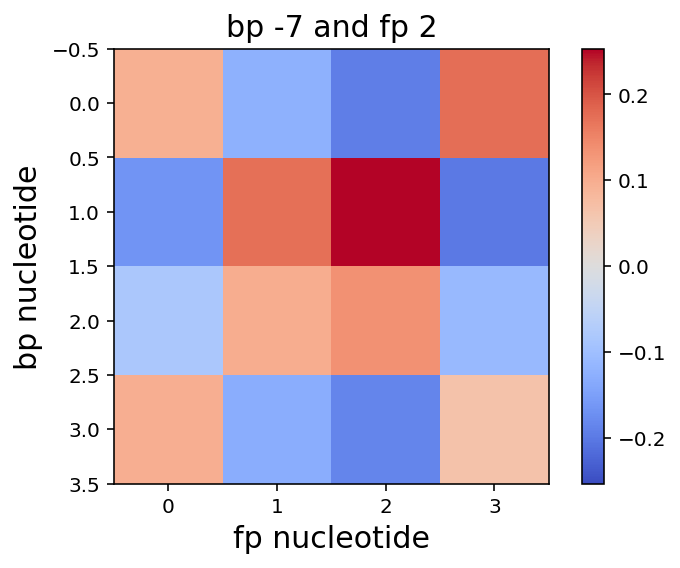

0.00819151014994
['0.26', '0.19', '0.24', '0.30']
['0.60', '0.02', '0.34', '0.02']


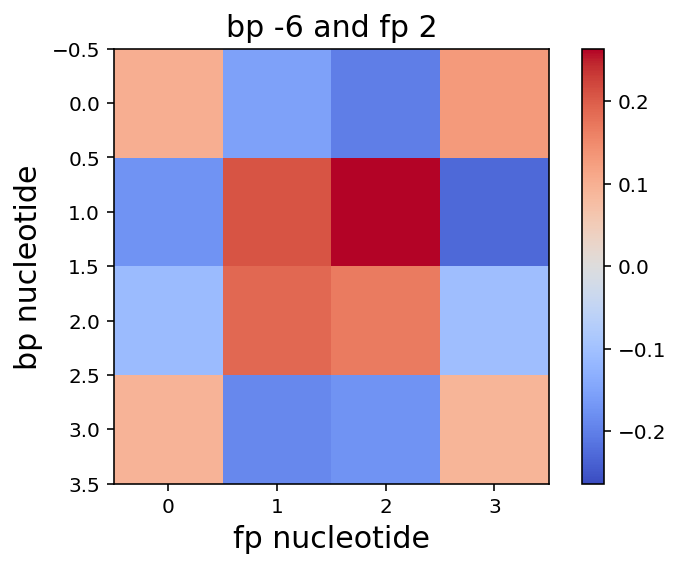

0.00857834905651
['0.23', '0.20', '0.21', '0.34']
['0.60', '0.02', '0.34', '0.02']


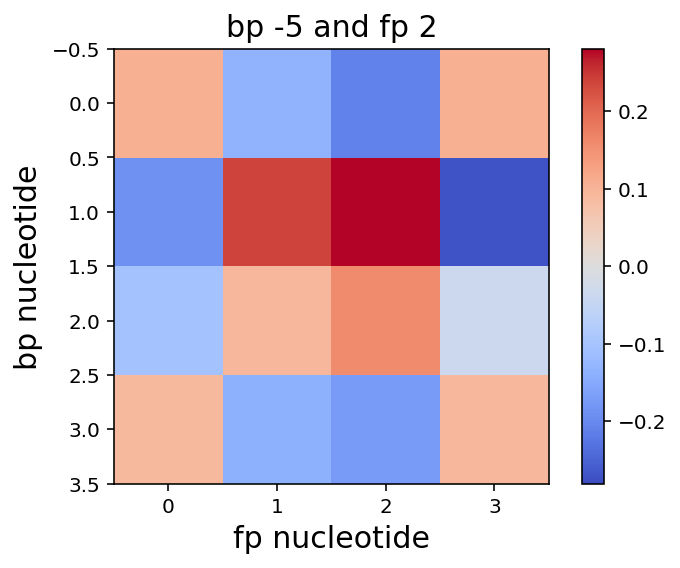

0.00861186408512
['0.27', '0.21', '0.19', '0.30']
['0.60', '0.02', '0.34', '0.02']


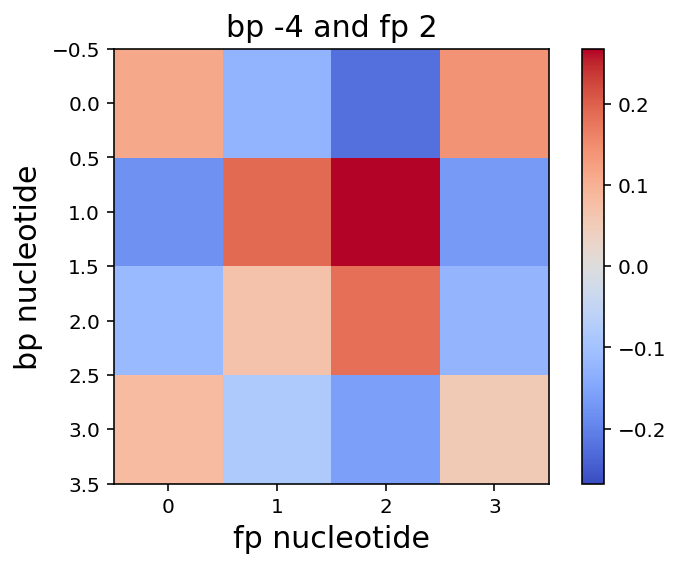

0.0101262254056
['0.09', '0.46', '0.11', '0.33']
['0.60', '0.02', '0.34', '0.02']


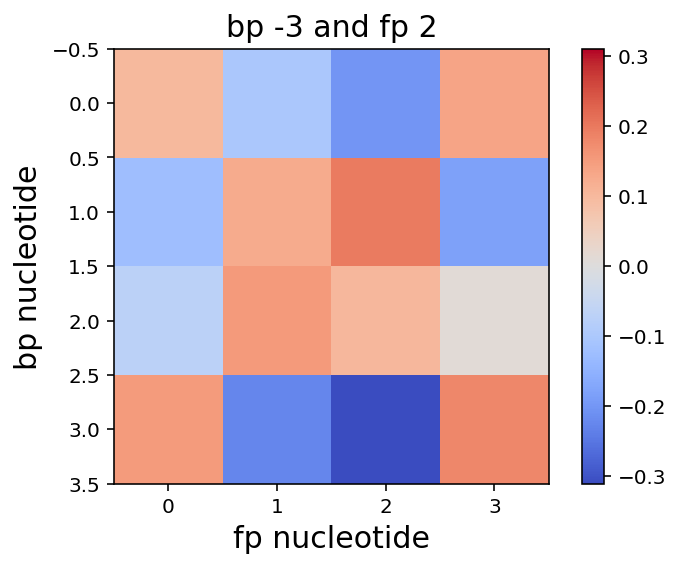

0.00228301126964
['0.06', '0.07', '0.05', '0.81']
['0.60', '0.02', '0.34', '0.02']


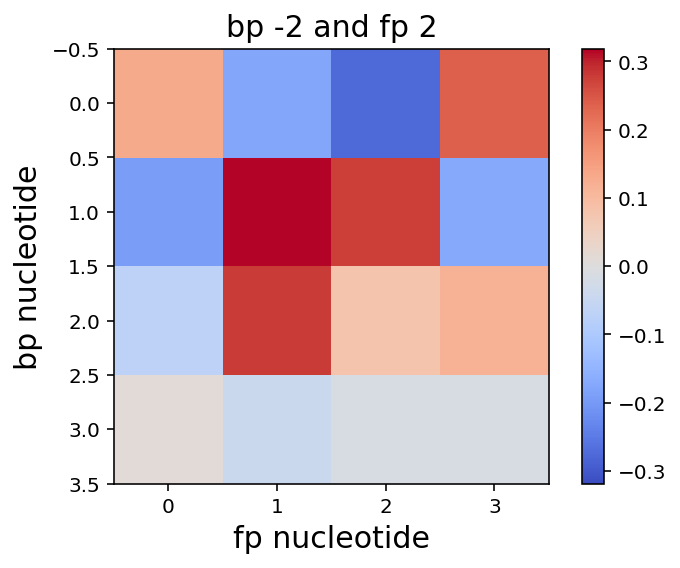

0.0121698334824
['0.24', '0.31', '0.26', '0.17']
['0.60', '0.02', '0.34', '0.02']


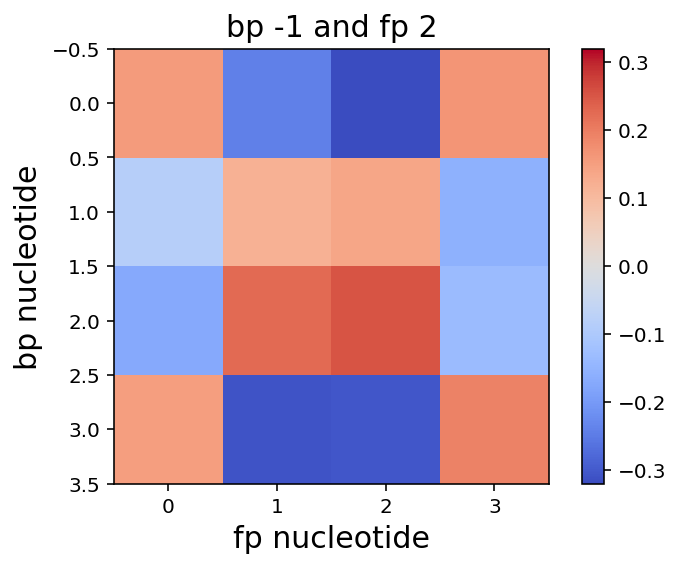

0.000774287391609
['0.98', '0.01', '0.00', '0.00']
['0.60', '0.02', '0.34', '0.02']


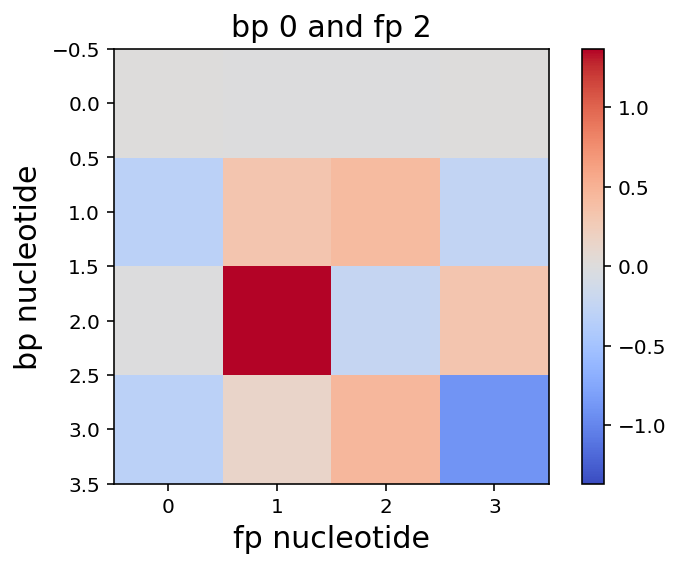

0.0100556551481
['0.18', '0.35', '0.14', '0.31']
['0.60', '0.02', '0.34', '0.02']


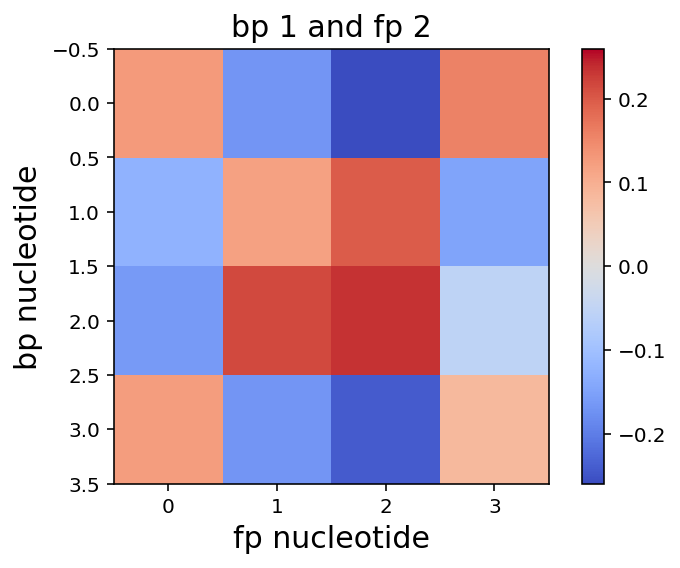

0.00753696626748
['0.23', '0.28', '0.16', '0.31']
['0.60', '0.02', '0.34', '0.02']


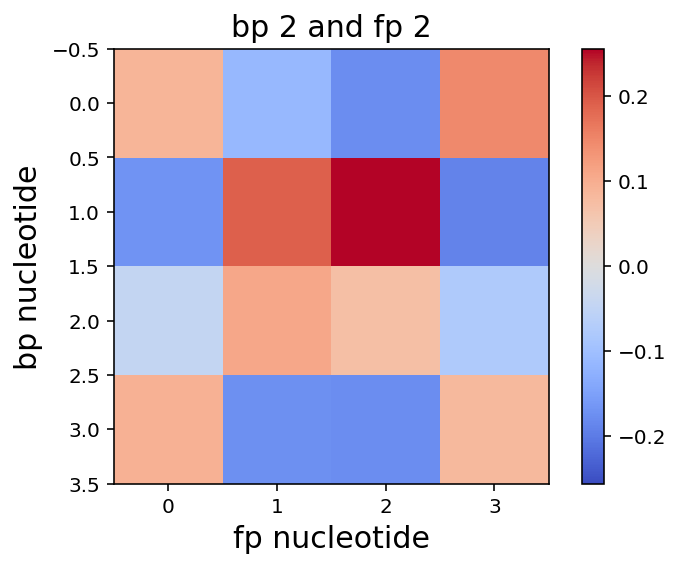

0.00732527074824
['0.22', '0.24', '0.20', '0.32']
['0.60', '0.02', '0.34', '0.02']


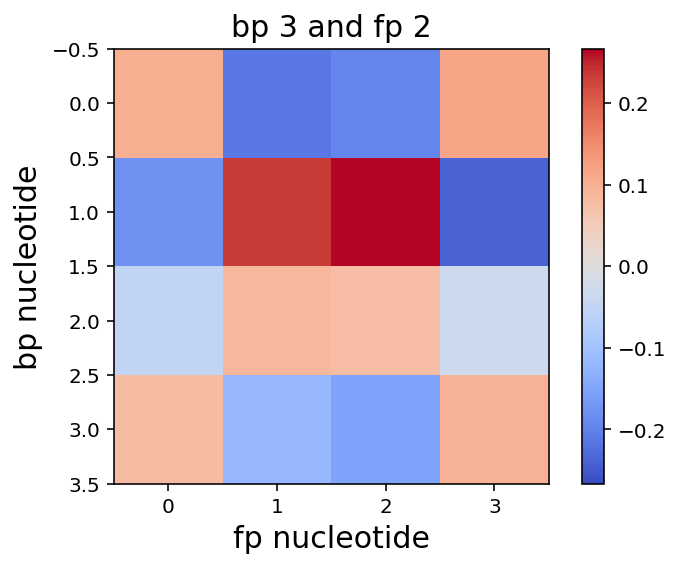

0.00816016835427
['0.20', '0.23', '0.18', '0.36']
['0.60', '0.02', '0.34', '0.02']


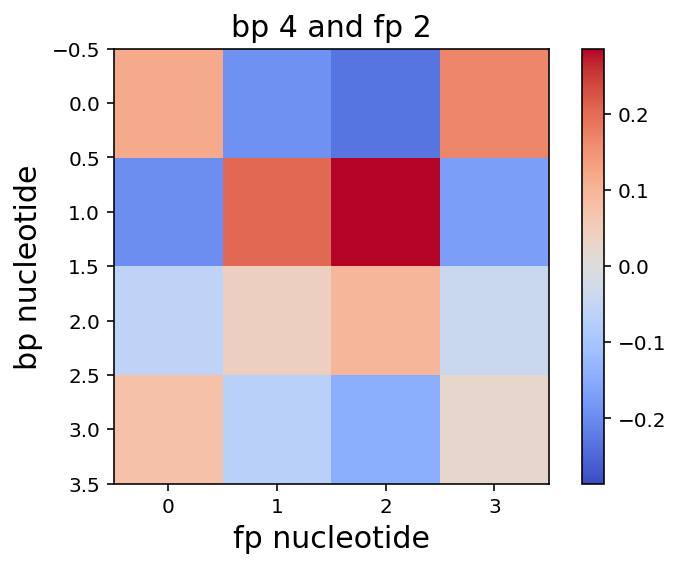

0.00702377357601
['0.19', '0.24', '0.19', '0.36']
['0.60', '0.02', '0.34', '0.02']


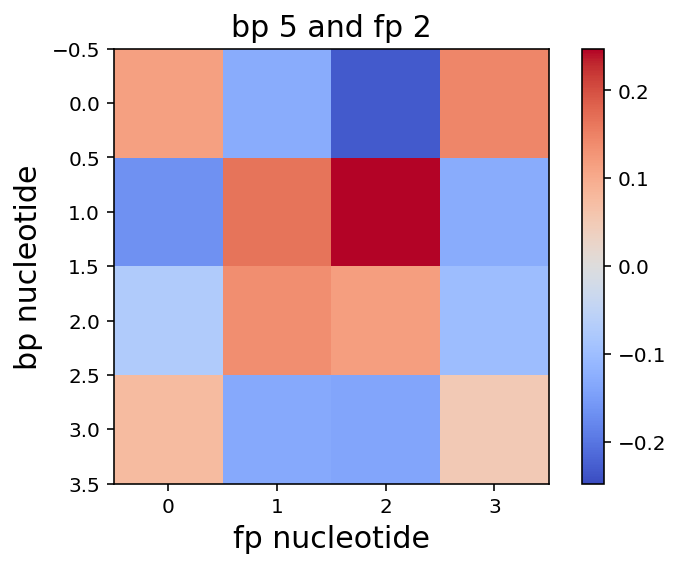

0.00745205395844
['0.18', '0.24', '0.18', '0.39']
['0.60', '0.02', '0.34', '0.02']


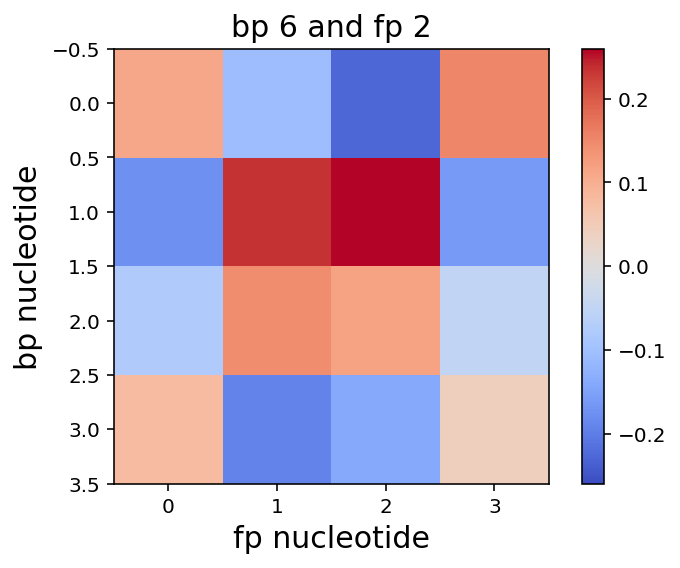

0.00870048760472
['0.15', '0.26', '0.15', '0.42']
['0.60', '0.02', '0.34', '0.02']


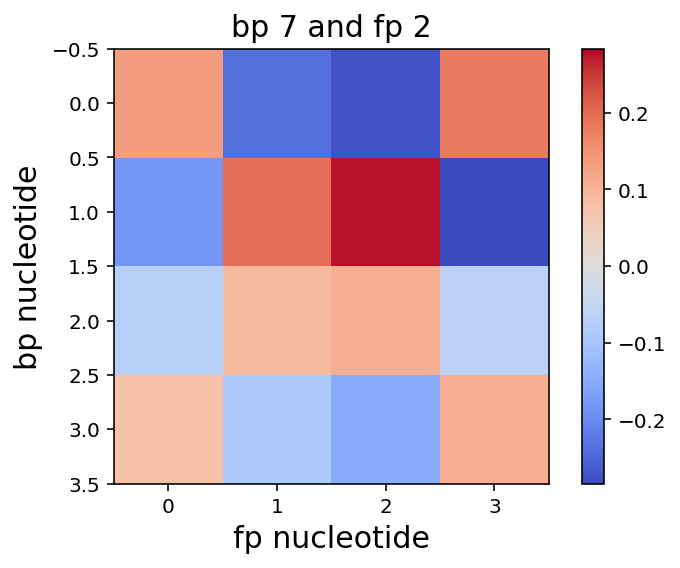

0.00803651013469
['0.13', '0.27', '0.12', '0.45']
['0.60', '0.02', '0.34', '0.02']


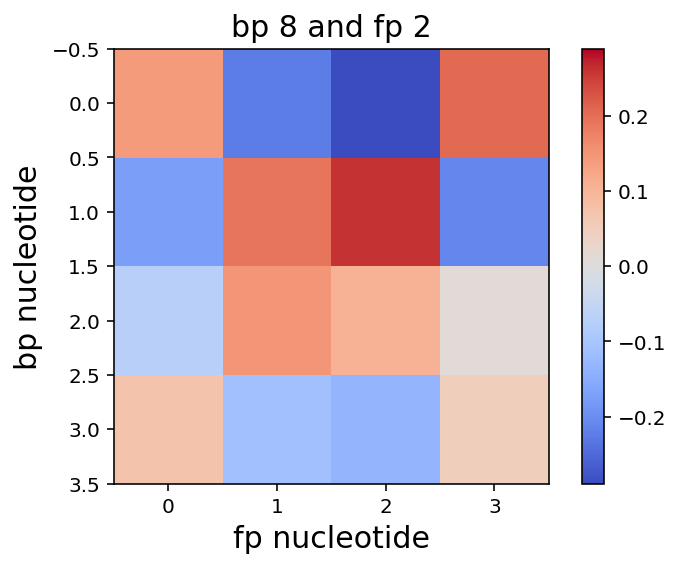

0.00823591559894
['0.12', '0.27', '0.11', '0.49']
['0.60', '0.02', '0.34', '0.02']


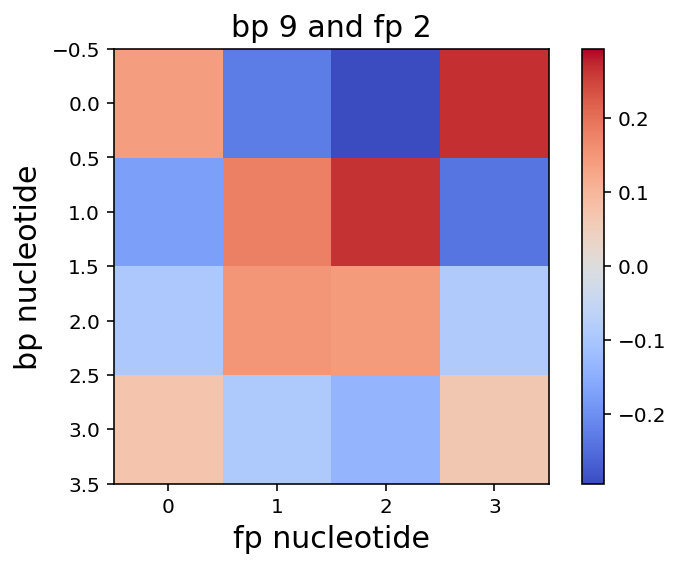

0.00779046994967
['0.11', '0.27', '0.11', '0.50']
['0.60', '0.02', '0.34', '0.02']


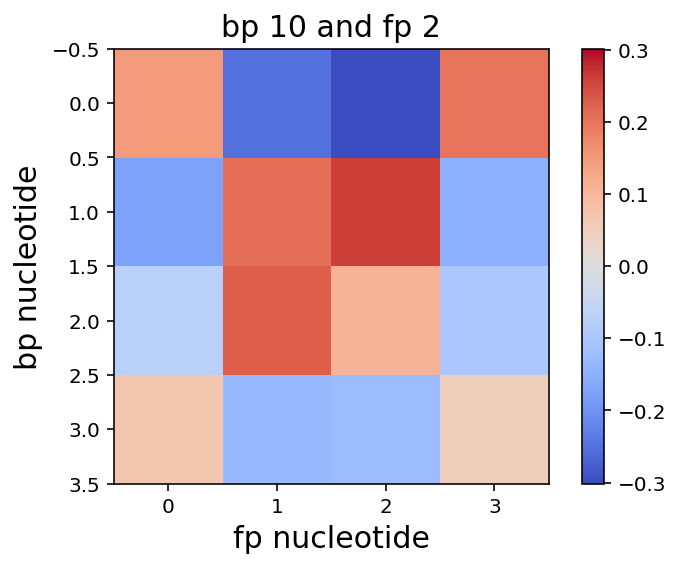

0.00814178351621
['0.09', '0.27', '0.11', '0.51']
['0.60', '0.02', '0.34', '0.02']


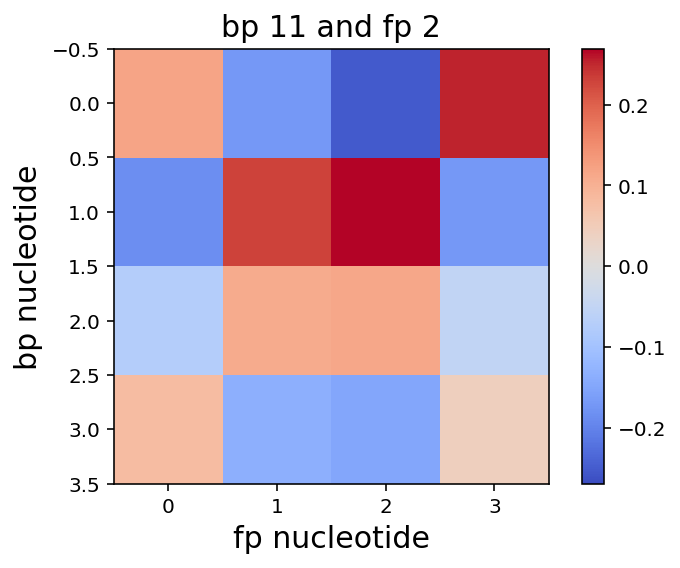

0.00781577105496
['0.09', '0.27', '0.11', '0.51']
['0.60', '0.02', '0.34', '0.02']


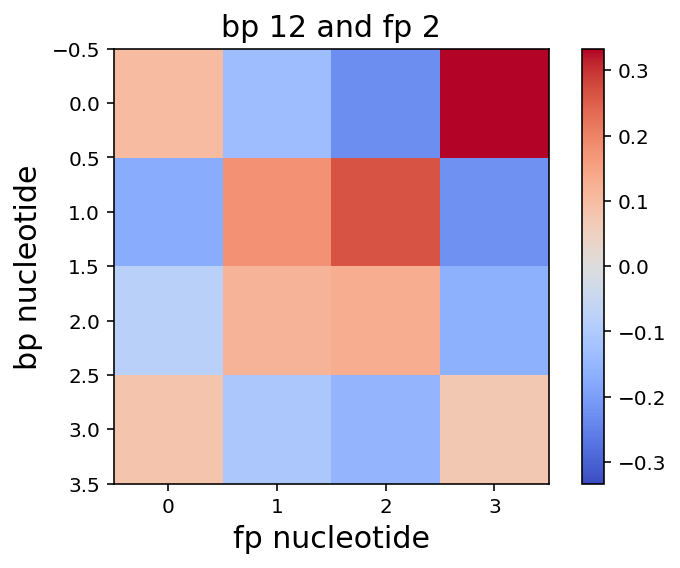

0.00749816744225
['0.09', '0.28', '0.10', '0.51']
['0.60', '0.02', '0.34', '0.02']


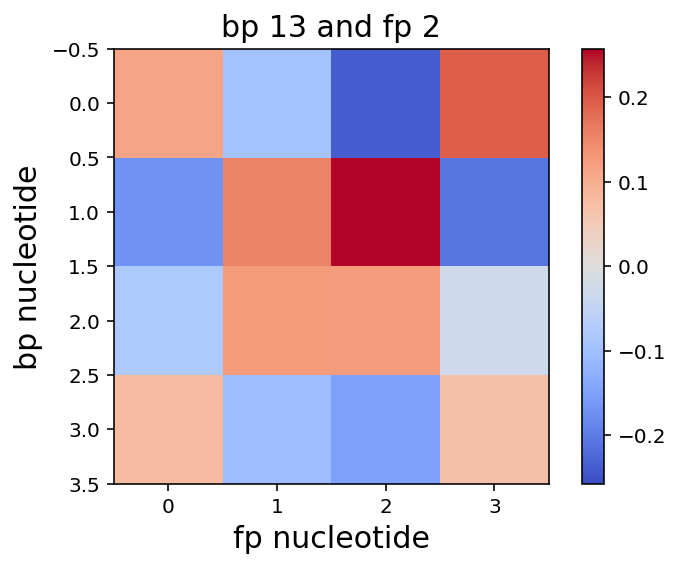

0.00744768585569
['0.09', '0.28', '0.10', '0.51']
['0.60', '0.02', '0.34', '0.02']


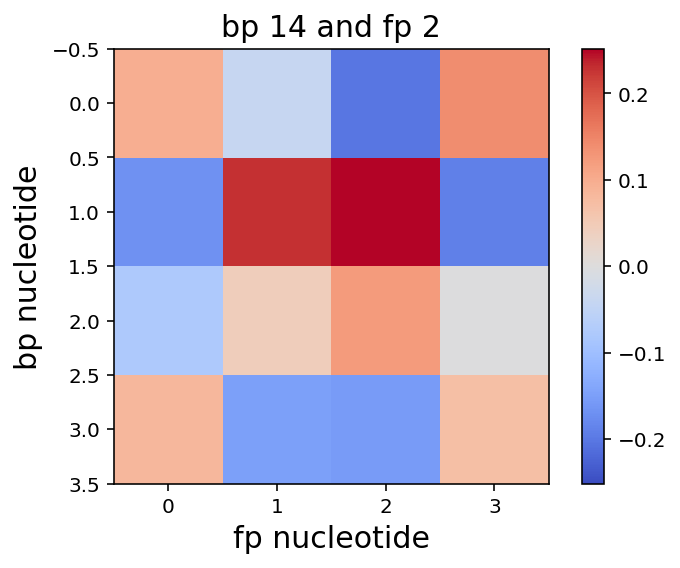

0.00200828652164
['0.24', '0.22', '0.22', '0.30']
['0.69', '0.07', '0.11', '0.11']


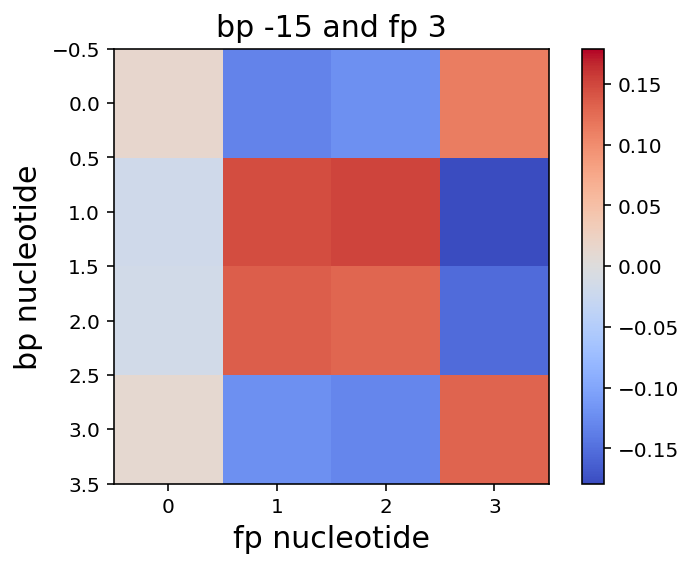

0.00160644355423
['0.25', '0.21', '0.23', '0.30']
['0.69', '0.07', '0.11', '0.11']


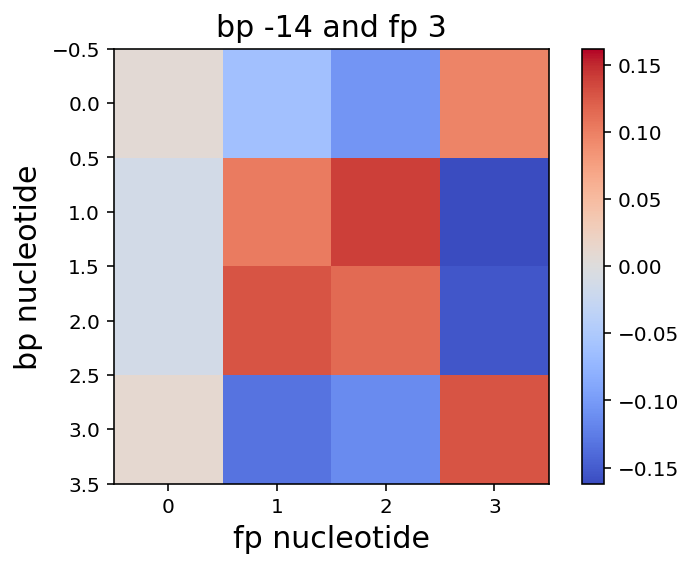

0.00166204830566
['0.25', '0.19', '0.24', '0.29']
['0.69', '0.07', '0.11', '0.11']


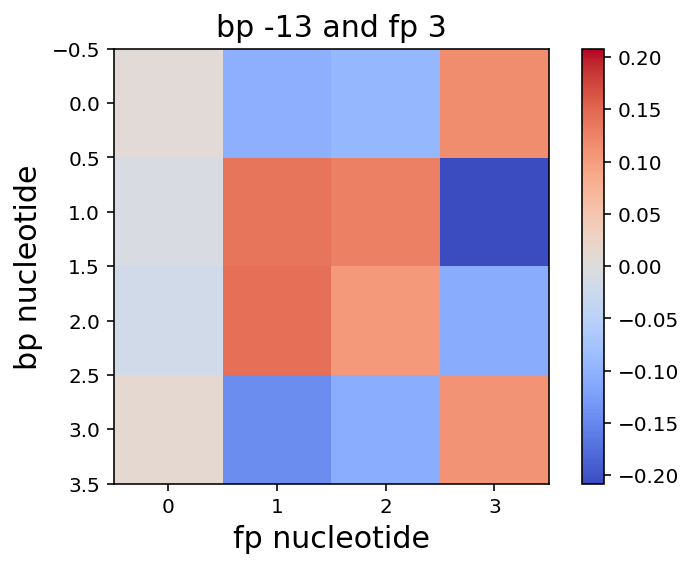

0.00167790435064
['0.26', '0.20', '0.25', '0.28']
['0.69', '0.07', '0.11', '0.11']


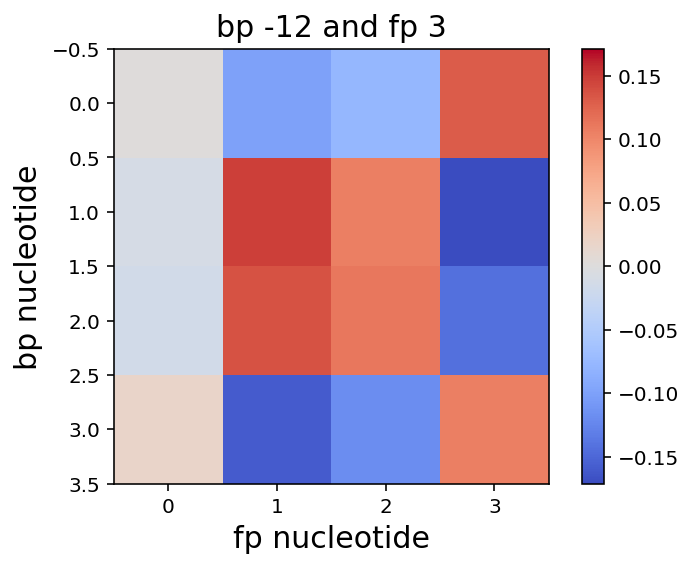

0.0016012550176
['0.25', '0.23', '0.23', '0.27']
['0.69', '0.07', '0.11', '0.11']


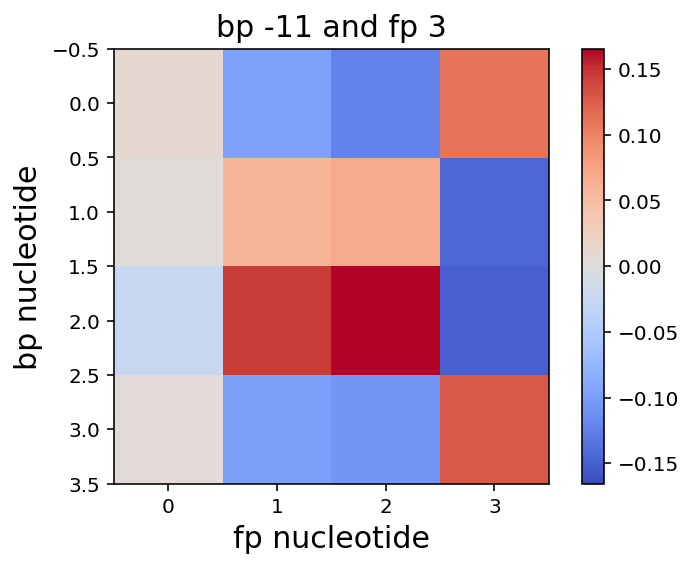

0.00182684159206
['0.24', '0.27', '0.21', '0.26']
['0.69', '0.07', '0.11', '0.11']


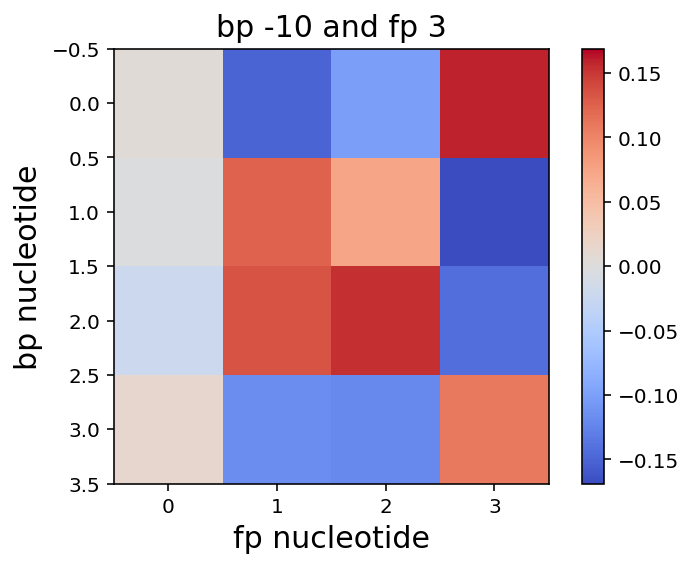

0.00144948664244
['0.24', '0.27', '0.19', '0.27']
['0.69', '0.07', '0.11', '0.11']


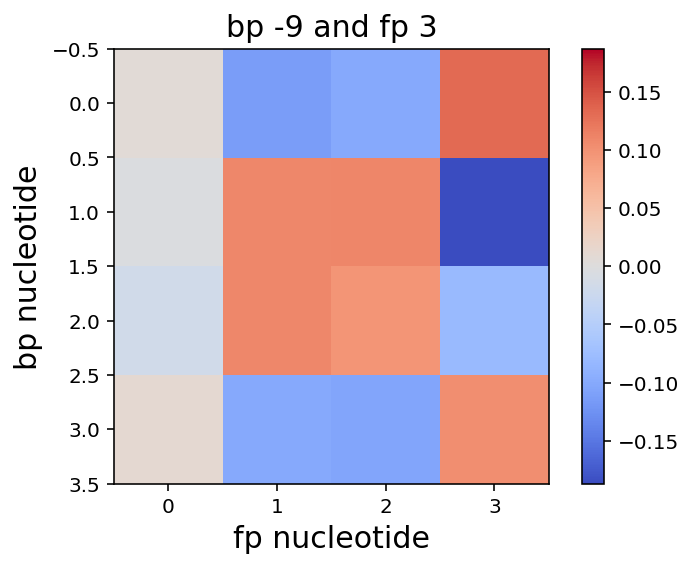

0.00169102394368
['0.25', '0.25', '0.20', '0.28']
['0.69', '0.07', '0.11', '0.11']


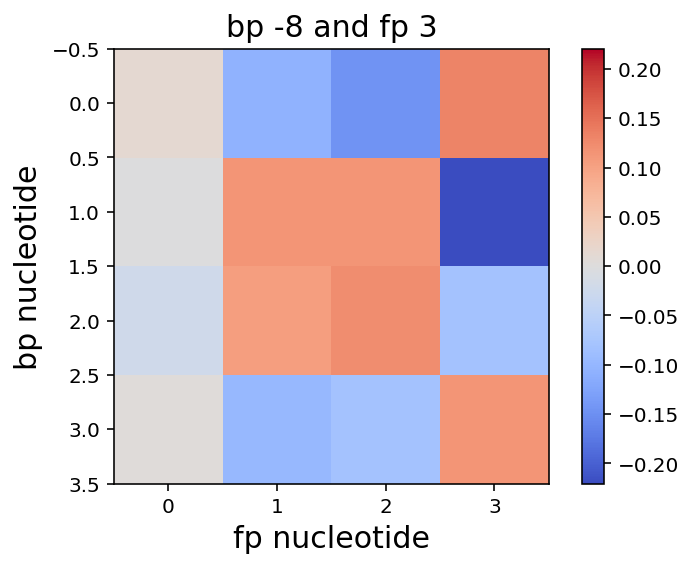

0.00169637207797
['0.25', '0.22', '0.23', '0.28']
['0.69', '0.07', '0.11', '0.11']


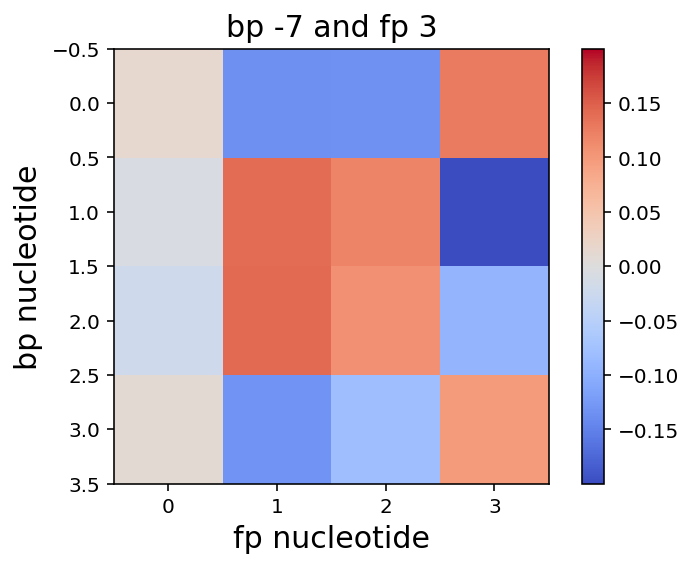

0.00208047637028
['0.26', '0.19', '0.24', '0.30']
['0.69', '0.07', '0.11', '0.11']


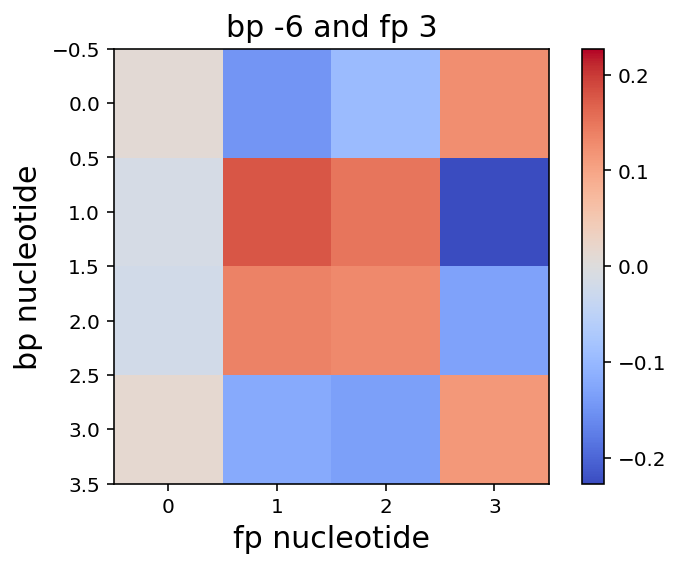

0.00195570521703
['0.23', '0.20', '0.21', '0.34']
['0.69', '0.07', '0.11', '0.11']


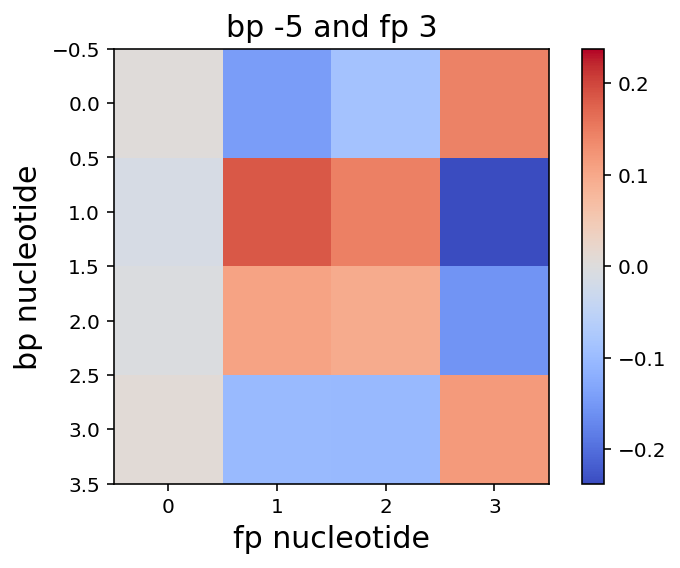

0.00178579510582
['0.27', '0.21', '0.19', '0.30']
['0.69', '0.07', '0.11', '0.11']


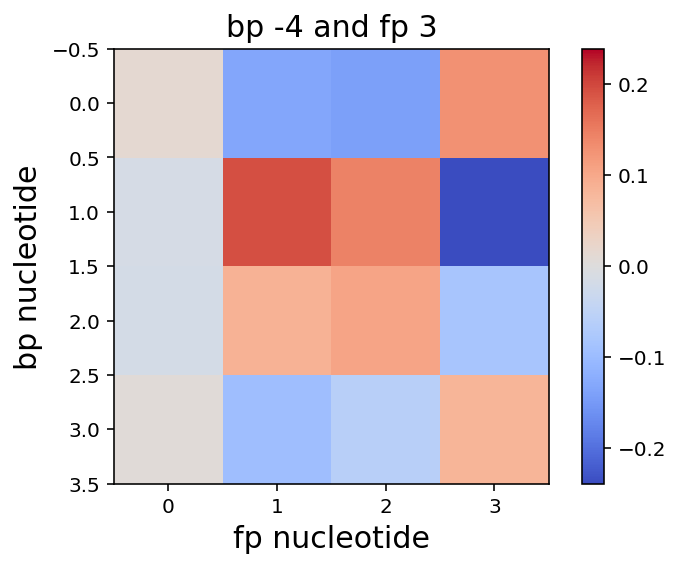

0.00205565808097
['0.09', '0.46', '0.11', '0.33']
['0.69', '0.07', '0.11', '0.11']


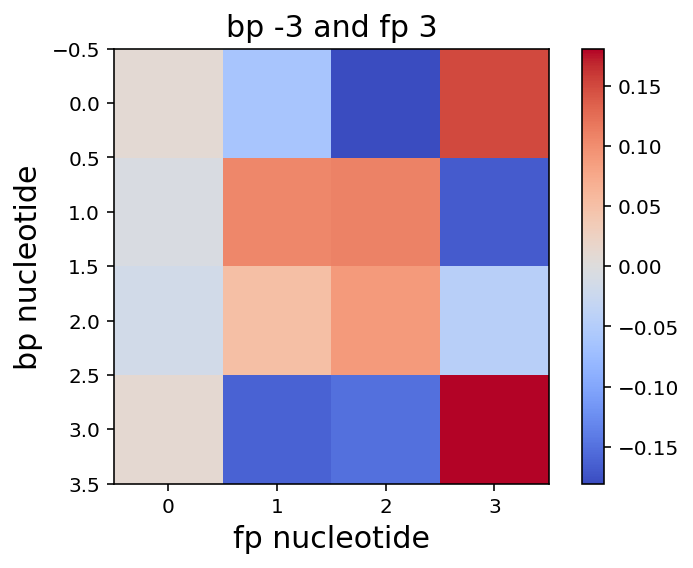

0.00064668176606
['0.06', '0.07', '0.05', '0.81']
['0.69', '0.07', '0.11', '0.11']


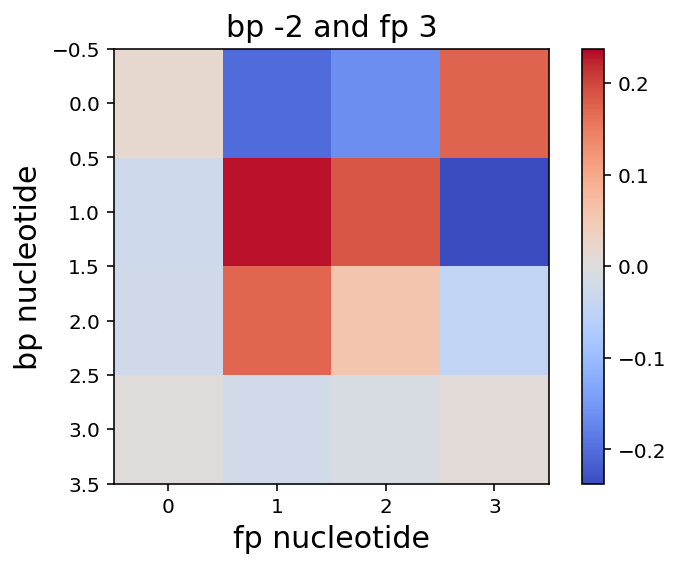

0.00262554244267
['0.24', '0.31', '0.26', '0.17']
['0.69', '0.07', '0.11', '0.11']


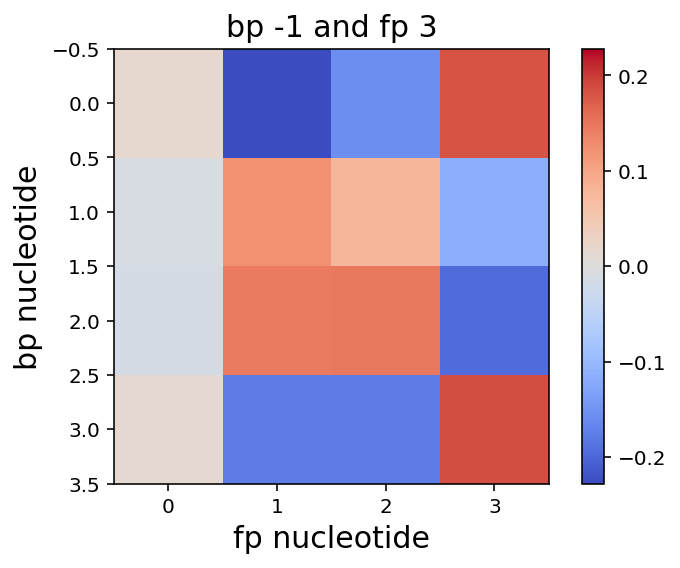

0.000195367485424
['0.98', '0.01', '0.00', '0.00']
['0.69', '0.07', '0.11', '0.11']


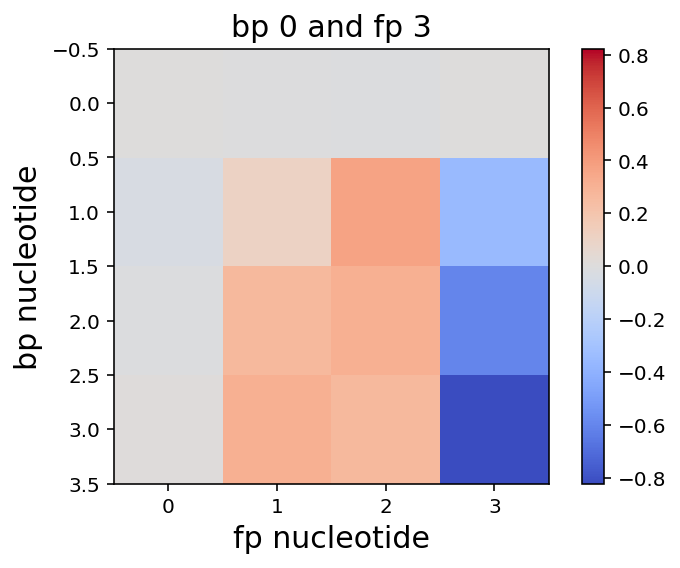

0.00228333243234
['0.18', '0.35', '0.14', '0.31']
['0.69', '0.07', '0.11', '0.11']


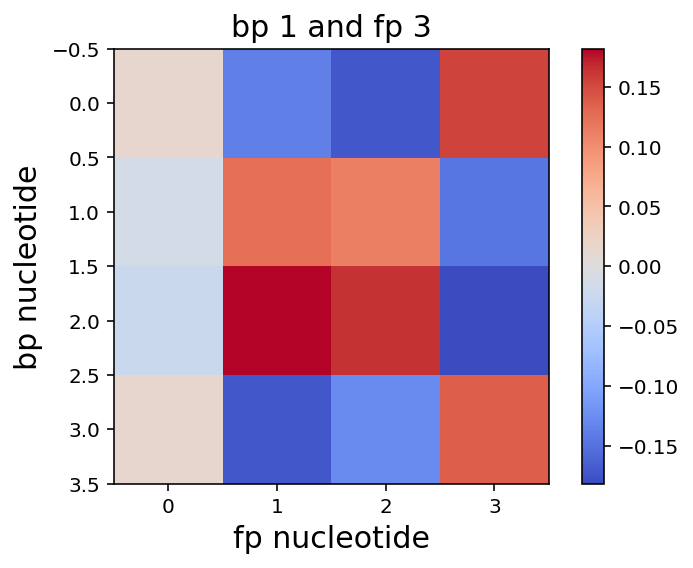

0.00189909710069
['0.23', '0.28', '0.16', '0.31']
['0.69', '0.07', '0.11', '0.11']


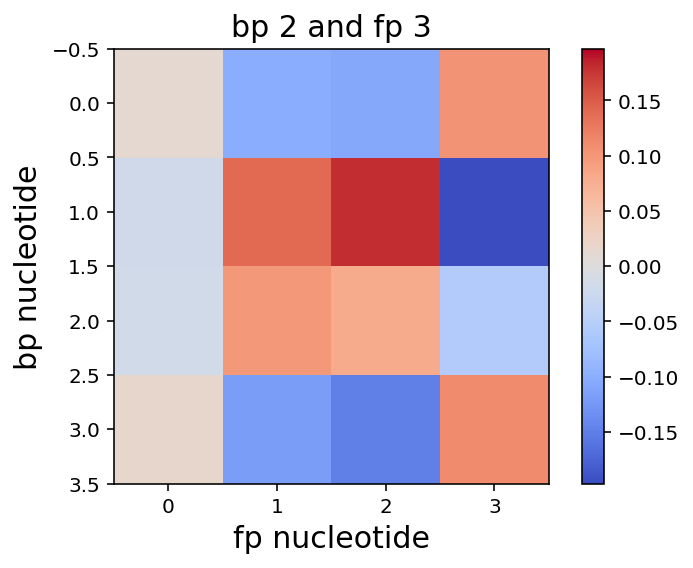

0.00179817283732
['0.22', '0.24', '0.20', '0.32']
['0.69', '0.07', '0.11', '0.11']


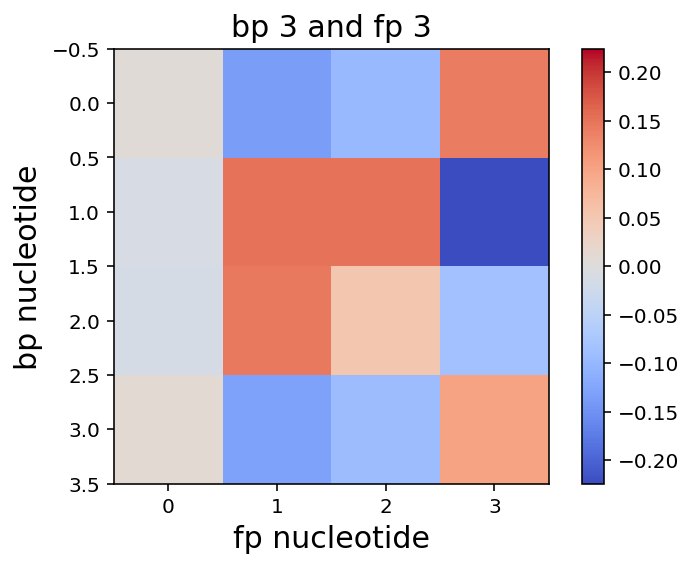

0.001933429306
['0.20', '0.23', '0.18', '0.36']
['0.69', '0.07', '0.11', '0.11']


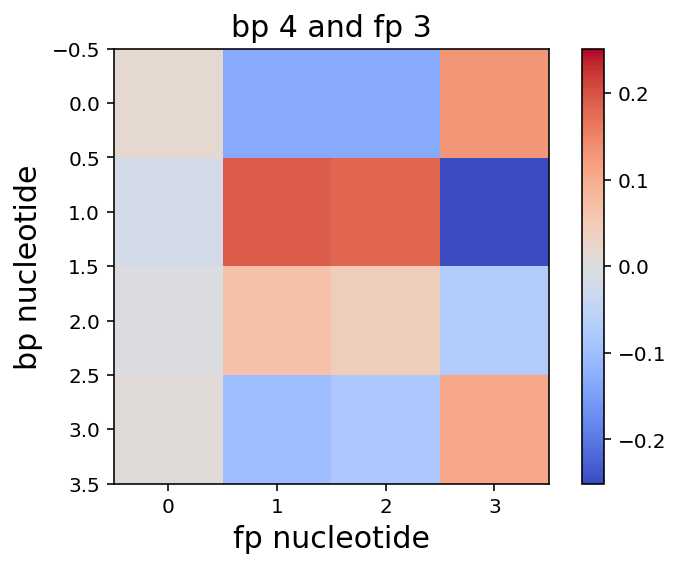

0.00176338876487
['0.19', '0.24', '0.19', '0.36']
['0.69', '0.07', '0.11', '0.11']


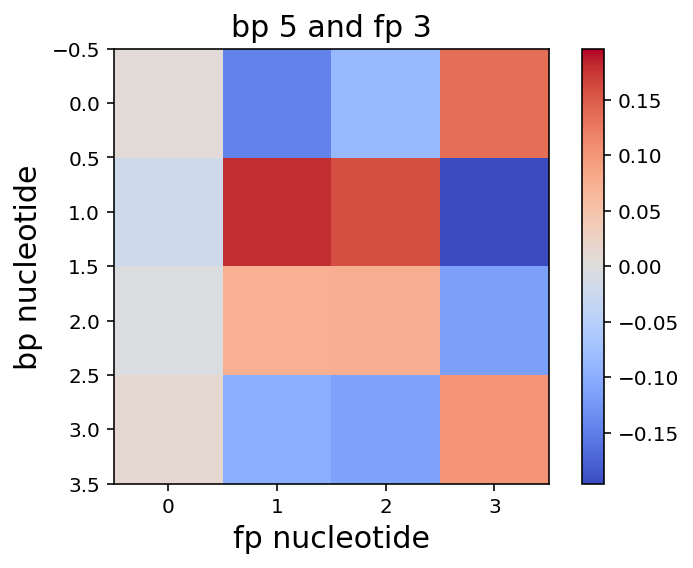

0.00178413631997
['0.18', '0.24', '0.18', '0.39']
['0.69', '0.07', '0.11', '0.11']


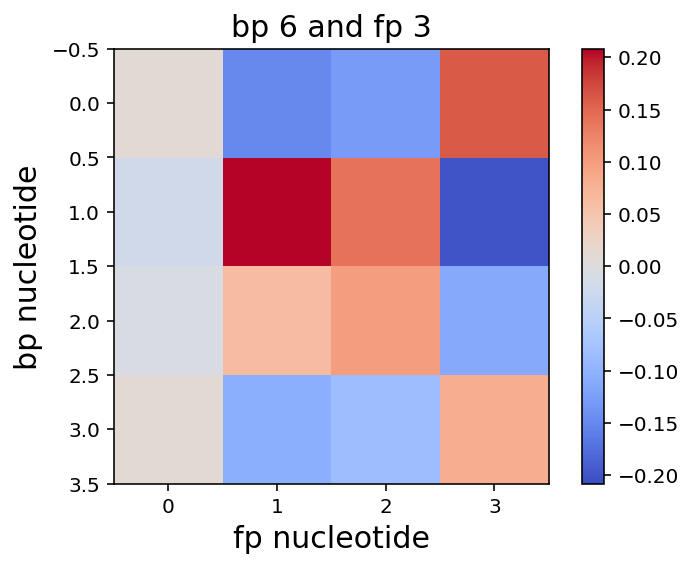

0.00192830305876
['0.15', '0.26', '0.15', '0.42']
['0.69', '0.07', '0.11', '0.11']


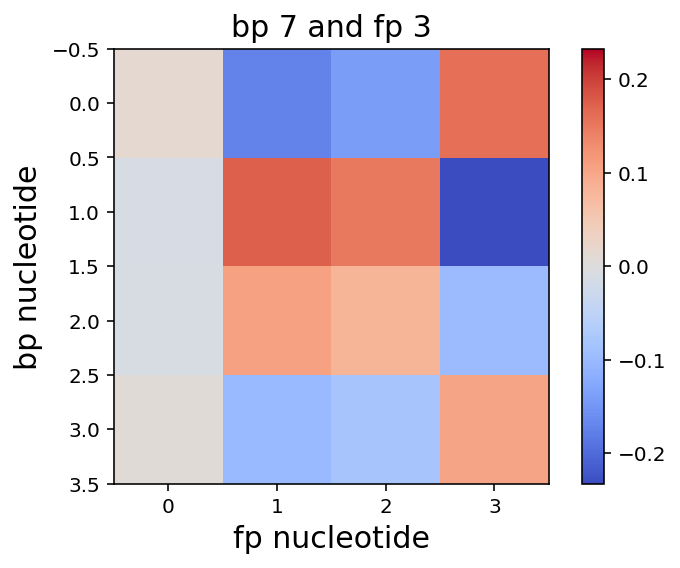

0.0019224754232
['0.13', '0.27', '0.12', '0.45']
['0.69', '0.07', '0.11', '0.11']


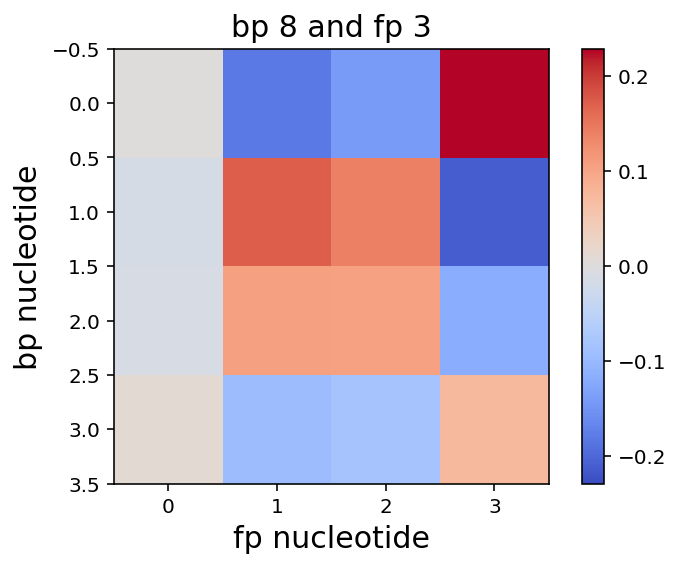

0.00186010450921
['0.12', '0.27', '0.11', '0.49']
['0.69', '0.07', '0.11', '0.11']


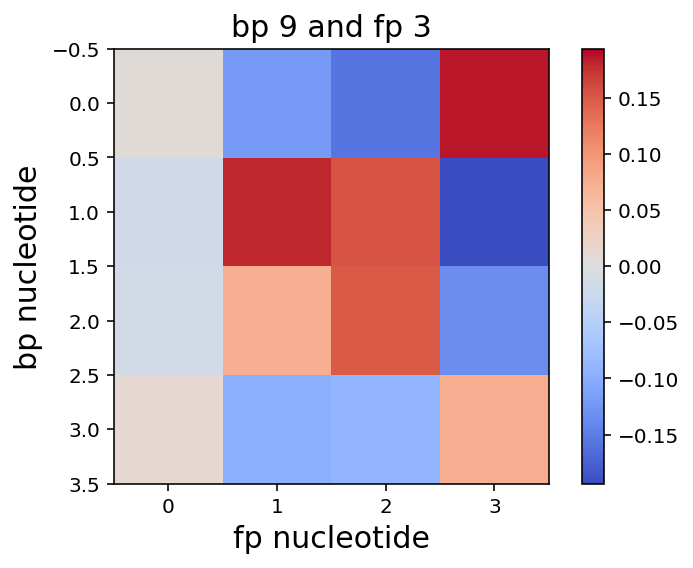

0.001483341146
['0.11', '0.27', '0.11', '0.50']
['0.69', '0.07', '0.11', '0.11']


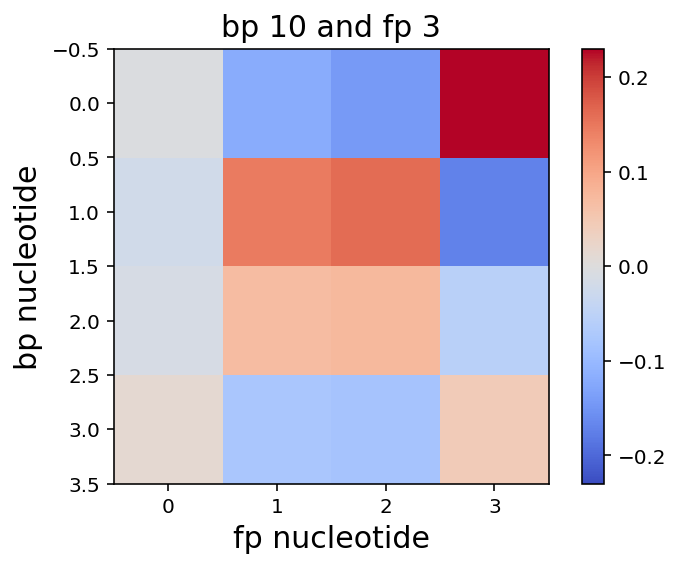

0.00181778431001
['0.09', '0.27', '0.11', '0.51']
['0.69', '0.07', '0.11', '0.11']


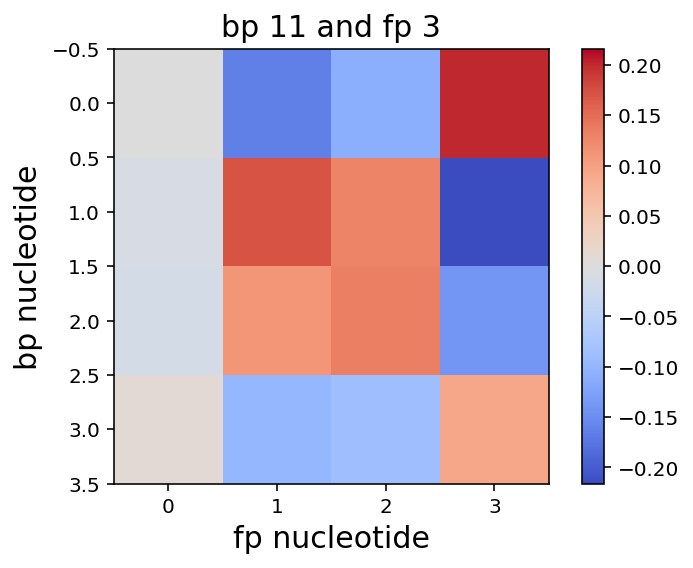

0.00126075357079
['0.09', '0.27', '0.11', '0.51']
['0.69', '0.07', '0.11', '0.11']


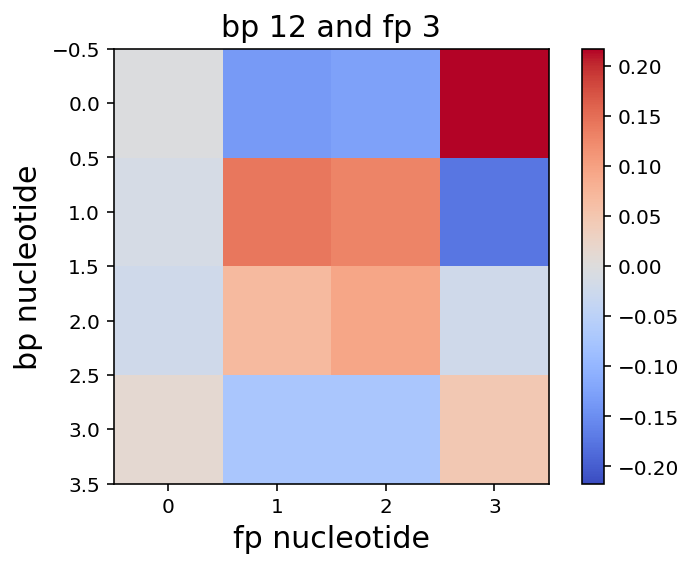

0.00166279785045
['0.09', '0.28', '0.10', '0.51']
['0.69', '0.07', '0.11', '0.11']


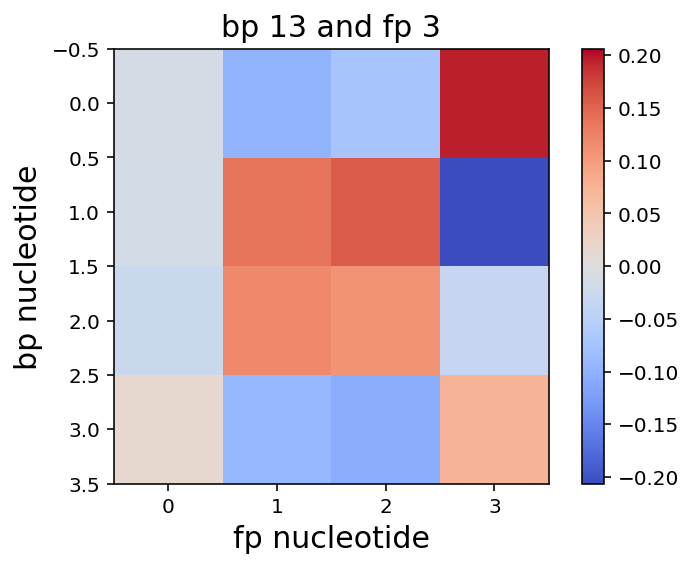

0.00150073415048
['0.09', '0.28', '0.10', '0.51']
['0.69', '0.07', '0.11', '0.11']


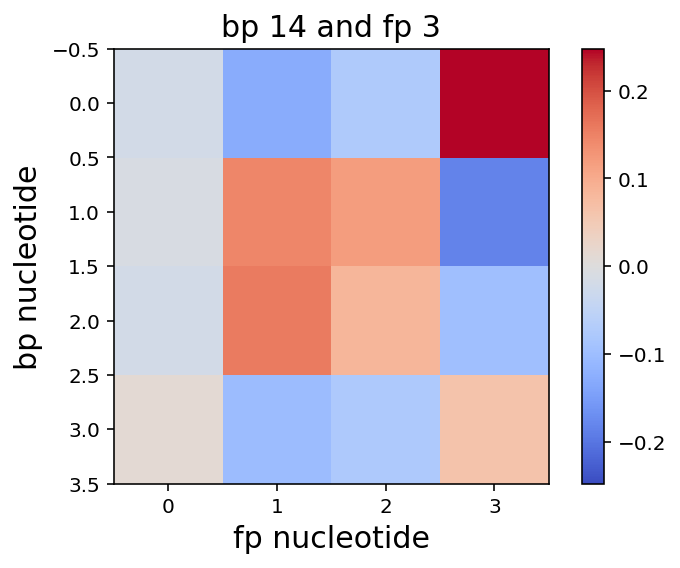

0.00228273598268
['0.24', '0.22', '0.22', '0.30']
['0.08', '0.05', '0.77', '0.07']


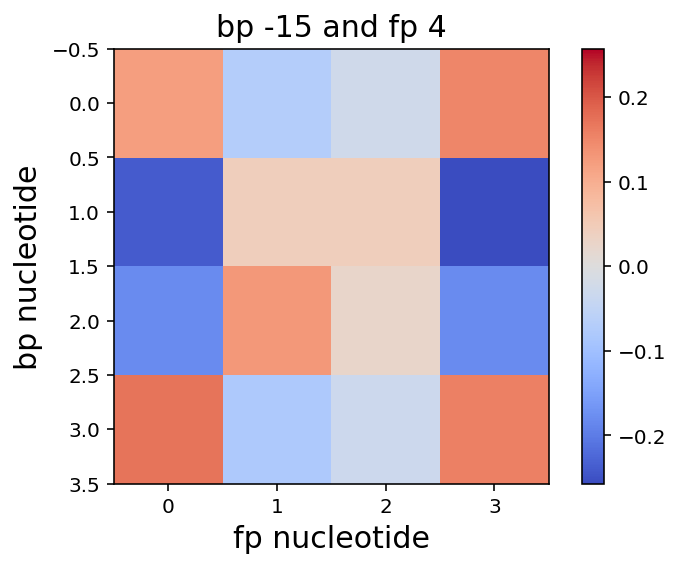

0.00191704789819
['0.25', '0.21', '0.23', '0.30']
['0.08', '0.05', '0.77', '0.07']


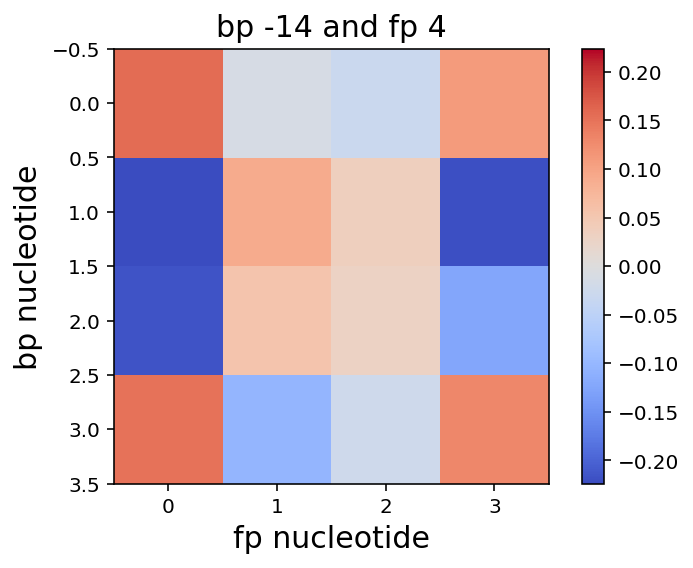

0.001881501976
['0.25', '0.19', '0.24', '0.29']
['0.08', '0.05', '0.77', '0.07']


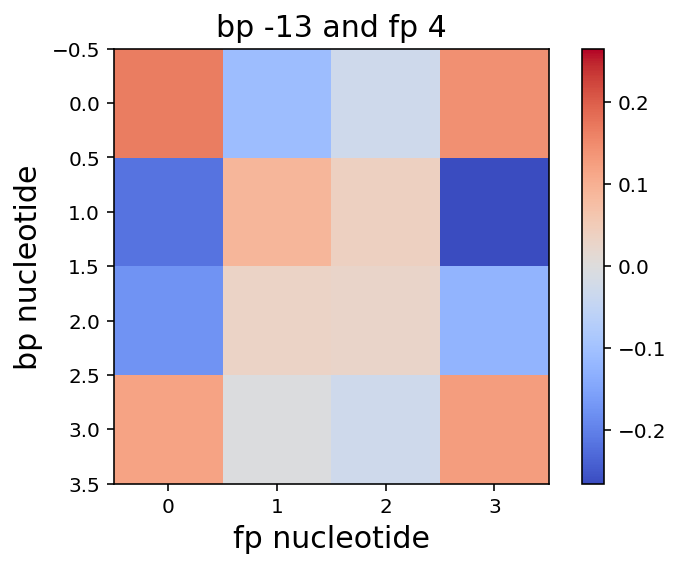

0.00184058833005
['0.26', '0.20', '0.25', '0.28']
['0.08', '0.05', '0.77', '0.07']


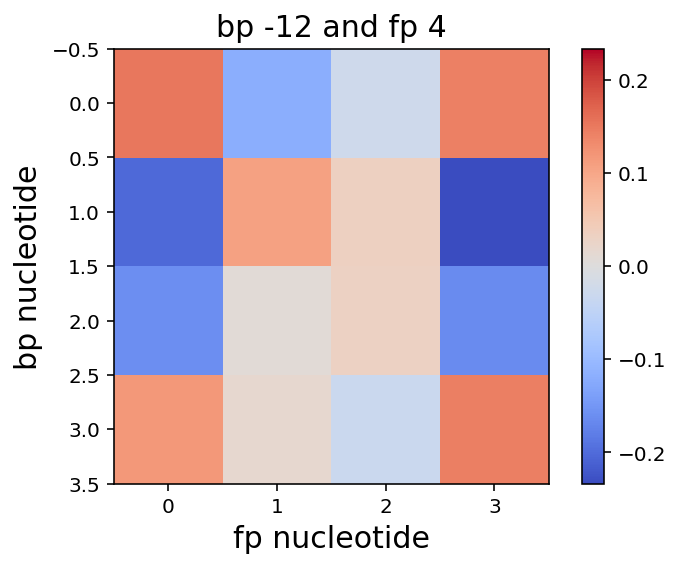

0.00218725551172
['0.25', '0.23', '0.23', '0.27']
['0.08', '0.05', '0.77', '0.07']


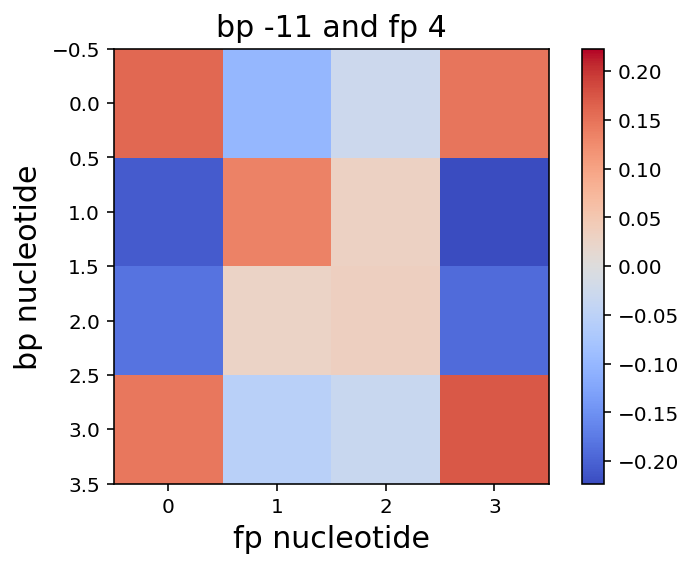

0.00190029289715
['0.24', '0.27', '0.21', '0.26']
['0.08', '0.05', '0.77', '0.07']


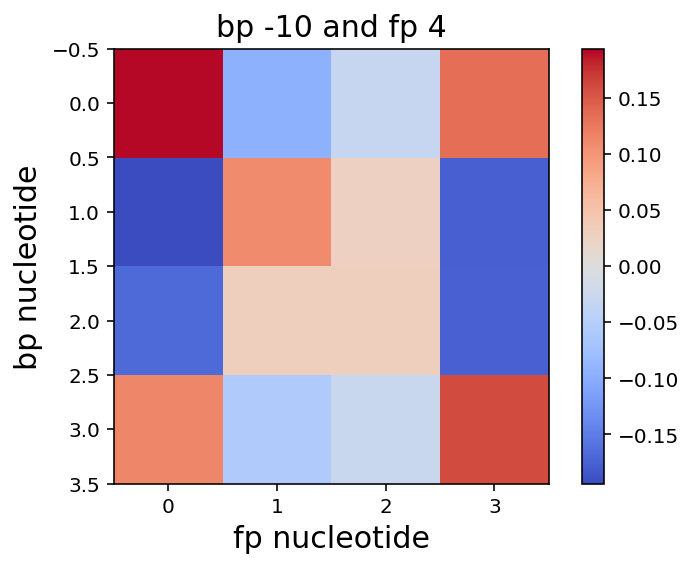

0.0020237450788
['0.24', '0.27', '0.19', '0.27']
['0.08', '0.05', '0.77', '0.07']


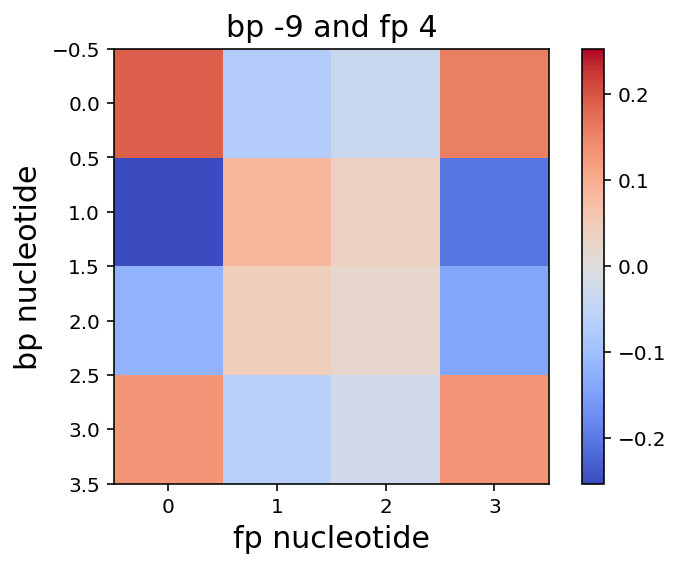

0.00215964821703
['0.25', '0.25', '0.20', '0.28']
['0.08', '0.05', '0.77', '0.07']


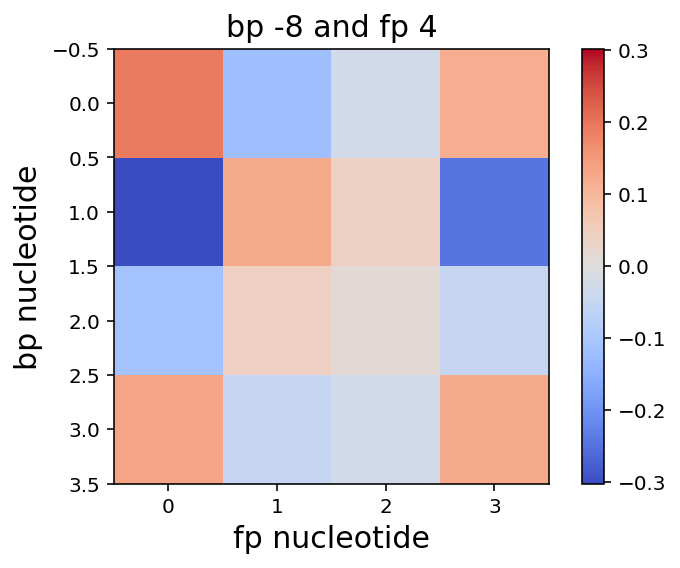

0.00208762138939
['0.25', '0.22', '0.23', '0.28']
['0.08', '0.05', '0.77', '0.07']


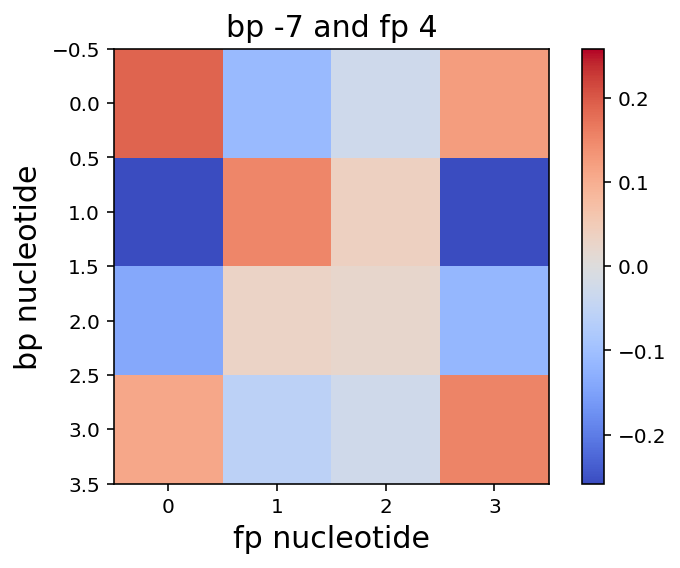

0.0025383096714
['0.26', '0.19', '0.24', '0.30']
['0.08', '0.05', '0.77', '0.07']


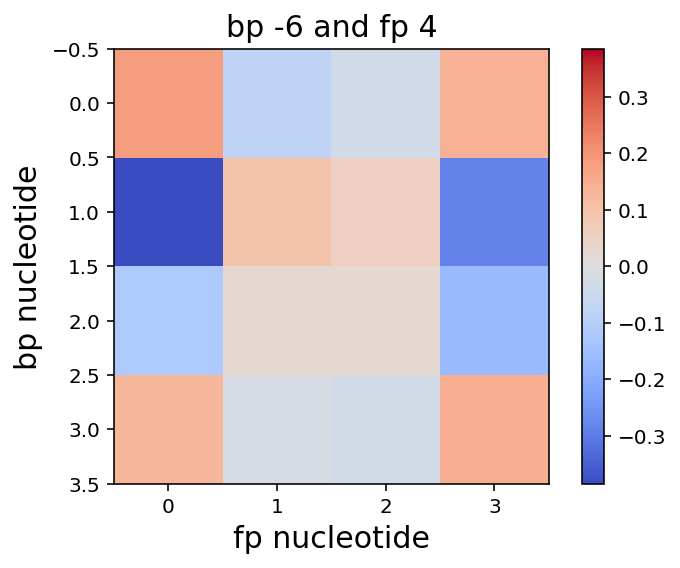

0.00225583500946
['0.23', '0.20', '0.21', '0.34']
['0.08', '0.05', '0.77', '0.07']


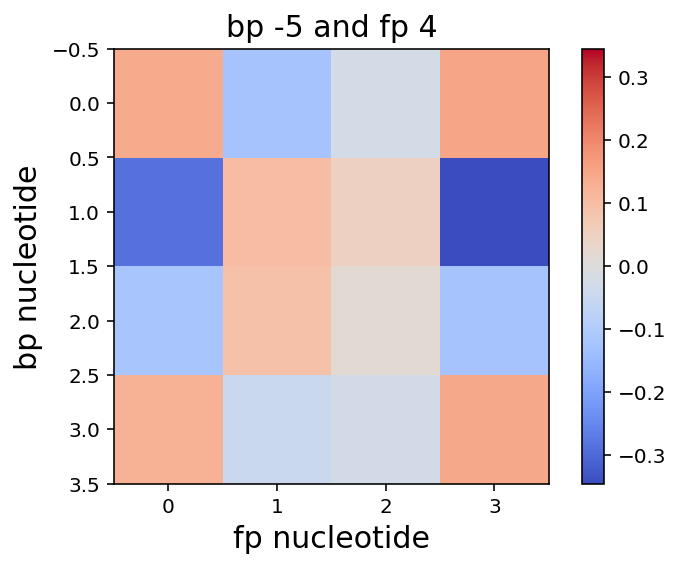

0.00226650051922
['0.27', '0.21', '0.19', '0.30']
['0.08', '0.05', '0.77', '0.07']


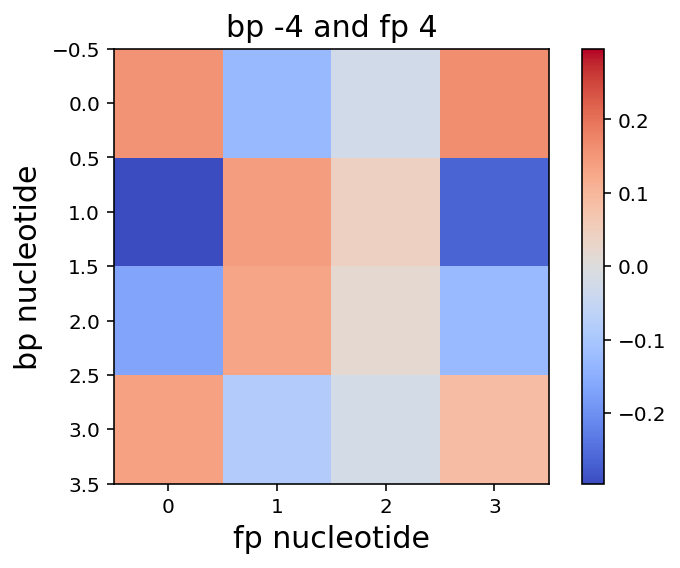

0.00239609639108
['0.09', '0.46', '0.11', '0.33']
['0.08', '0.05', '0.77', '0.07']


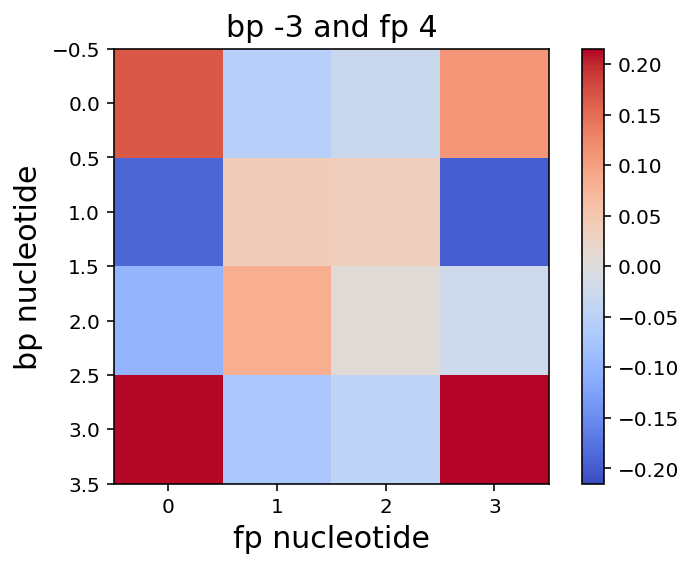

0.000726880531956
['0.06', '0.07', '0.05', '0.81']
['0.08', '0.05', '0.77', '0.07']


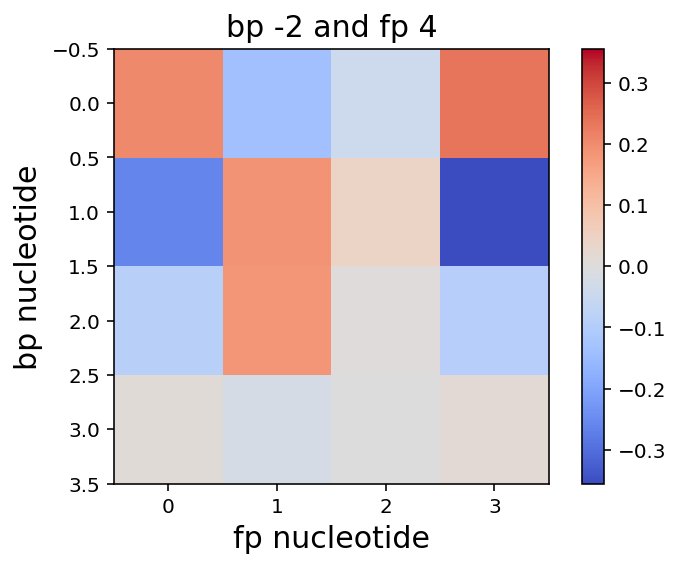

0.00299056983049
['0.24', '0.31', '0.26', '0.17']
['0.08', '0.05', '0.77', '0.07']


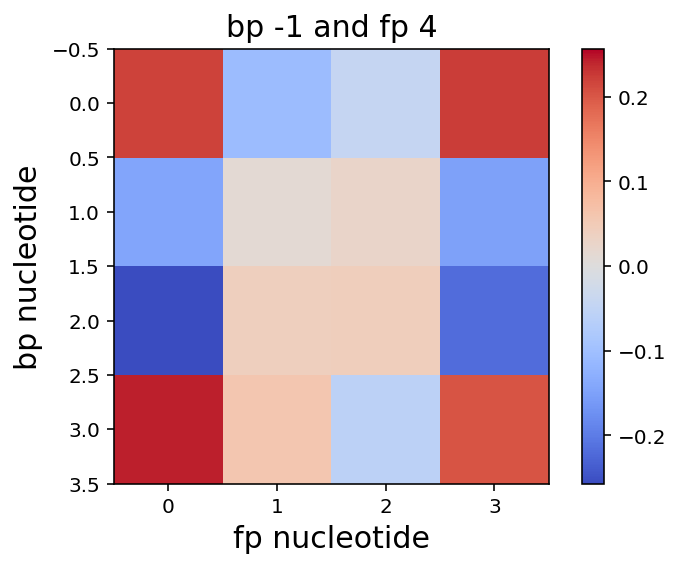

0.000412197152326
['0.98', '0.01', '0.00', '0.00']
['0.08', '0.05', '0.77', '0.07']


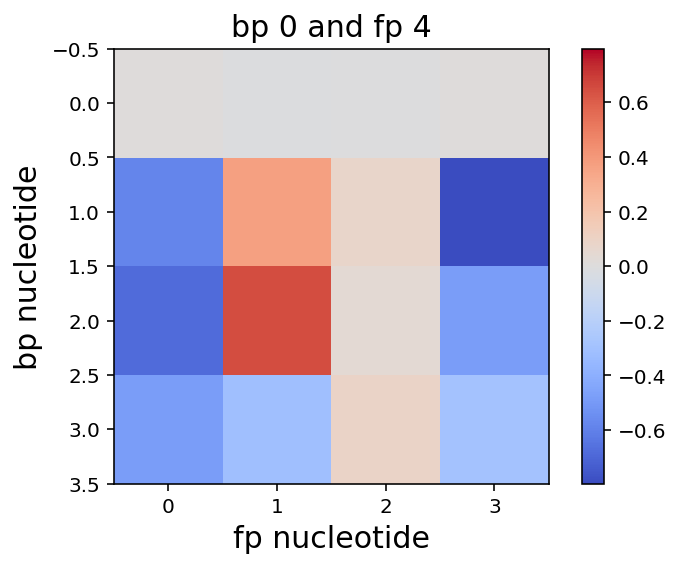

0.00305841670927
['0.18', '0.35', '0.14', '0.31']
['0.08', '0.05', '0.77', '0.07']


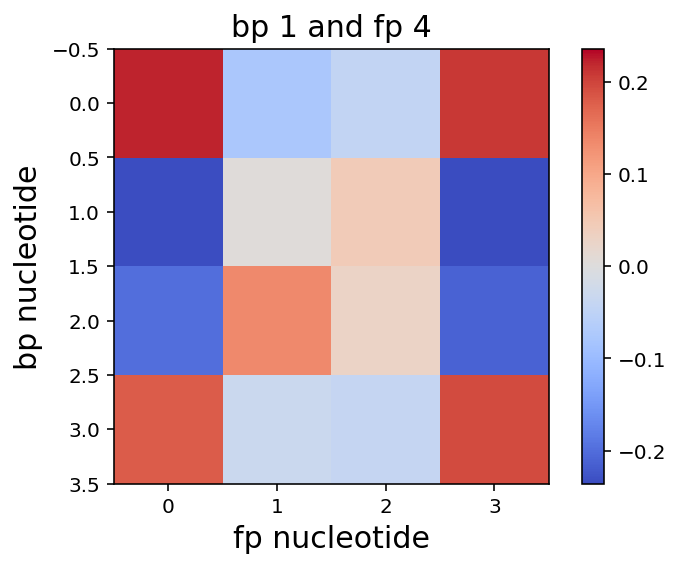

0.00205597310015
['0.23', '0.28', '0.16', '0.31']
['0.08', '0.05', '0.77', '0.07']


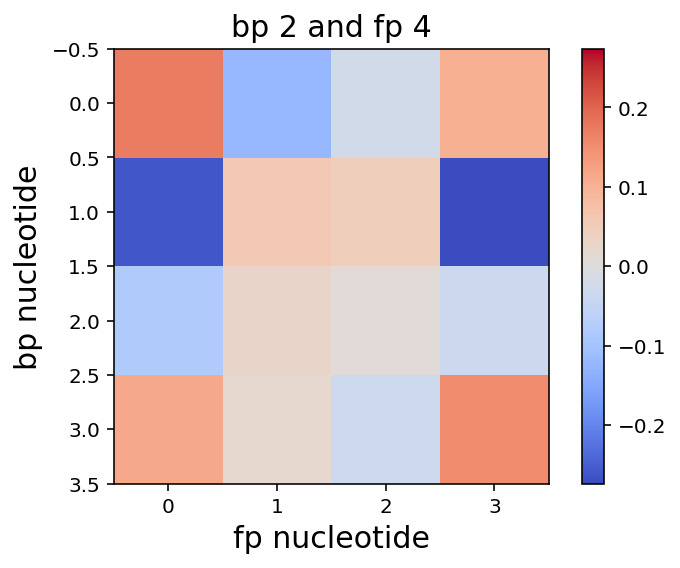

0.00196030852526
['0.22', '0.24', '0.20', '0.32']
['0.08', '0.05', '0.77', '0.07']


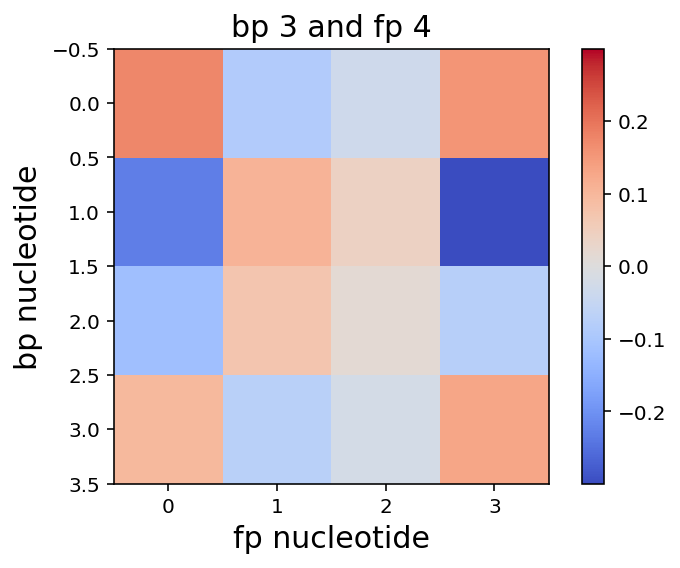

0.00265598515474
['0.20', '0.23', '0.18', '0.36']
['0.08', '0.05', '0.77', '0.07']


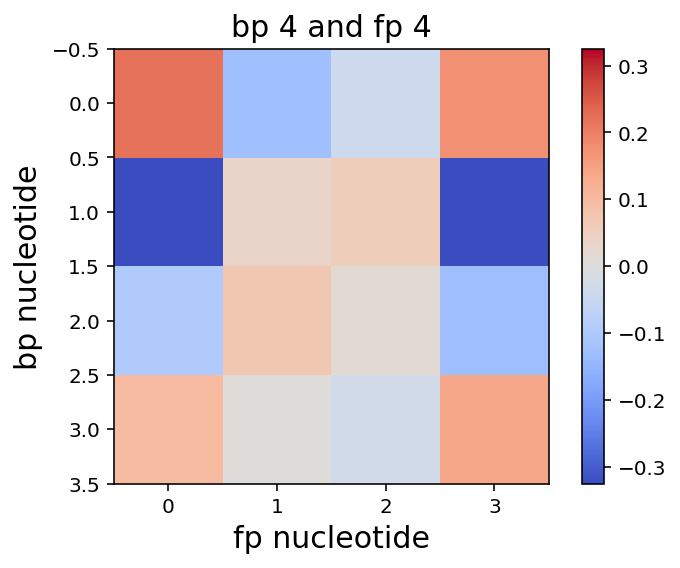

0.00171841327852
['0.19', '0.24', '0.19', '0.36']
['0.08', '0.05', '0.77', '0.07']


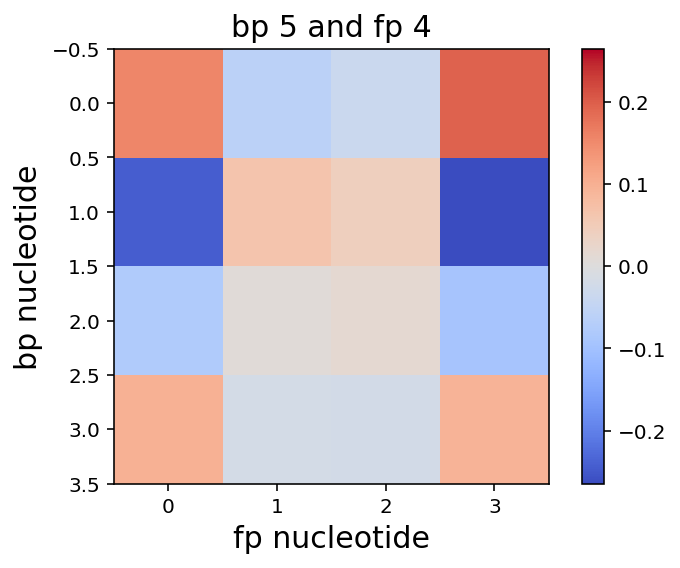

0.0021166348213
['0.18', '0.24', '0.18', '0.39']
['0.08', '0.05', '0.77', '0.07']


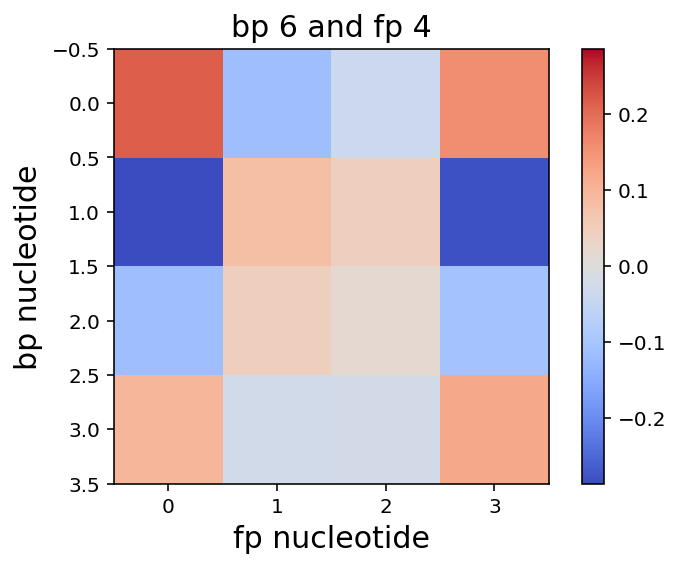

0.00243571145048
['0.15', '0.26', '0.15', '0.42']
['0.08', '0.05', '0.77', '0.07']


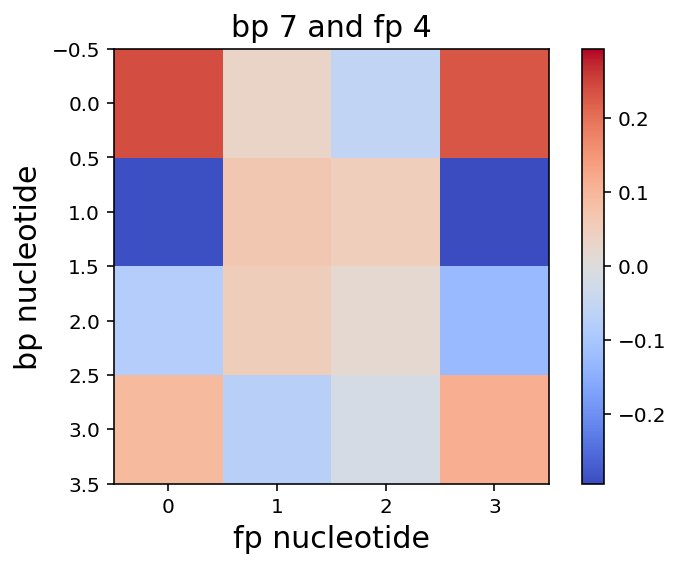

0.00224504227003
['0.13', '0.27', '0.12', '0.45']
['0.08', '0.05', '0.77', '0.07']


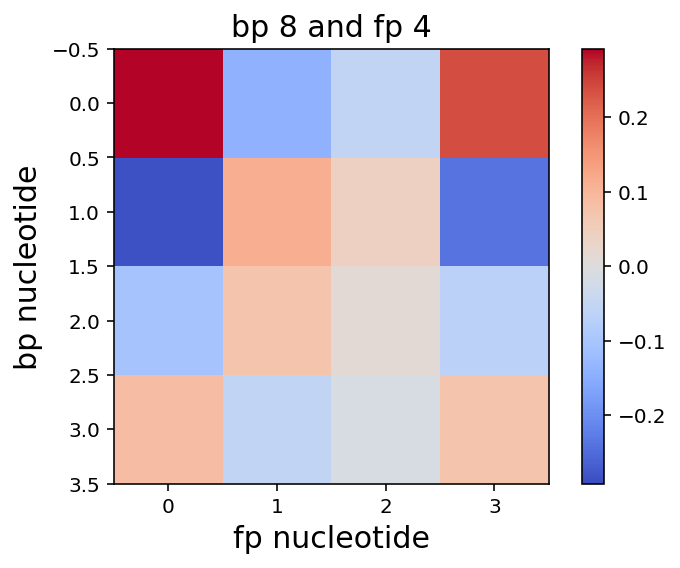

0.00232872007633
['0.12', '0.27', '0.11', '0.49']
['0.08', '0.05', '0.77', '0.07']


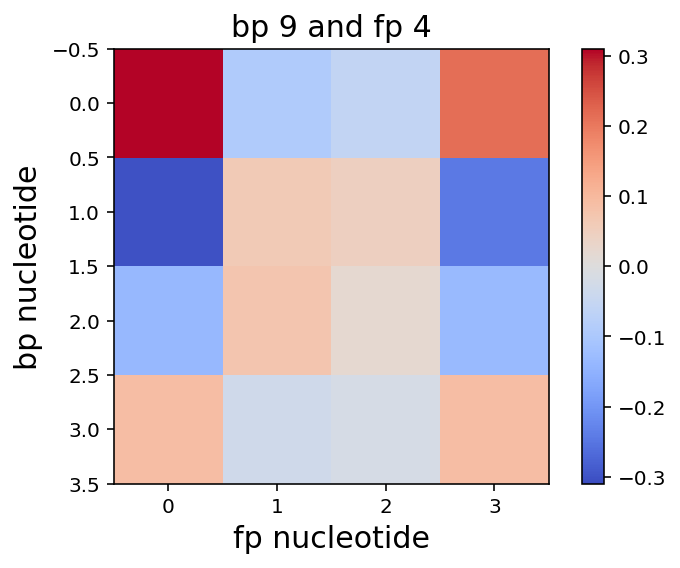

0.00190845429949
['0.11', '0.27', '0.11', '0.50']
['0.08', '0.05', '0.77', '0.07']


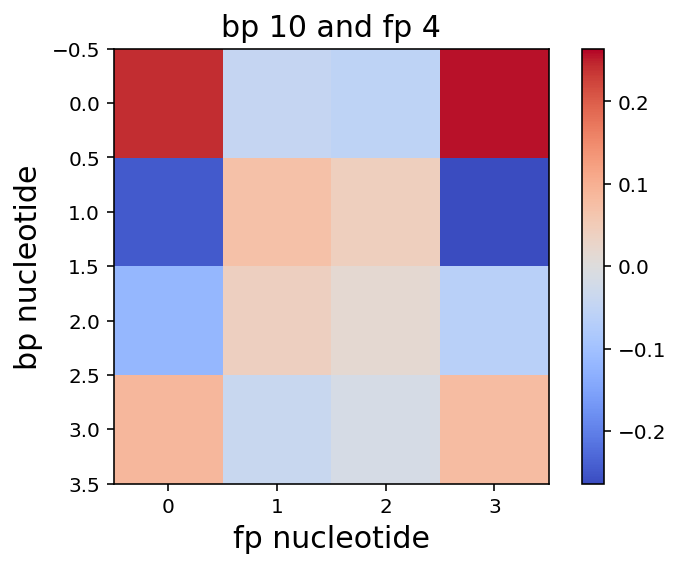

0.0016547839088
['0.09', '0.27', '0.11', '0.51']
['0.08', '0.05', '0.77', '0.07']


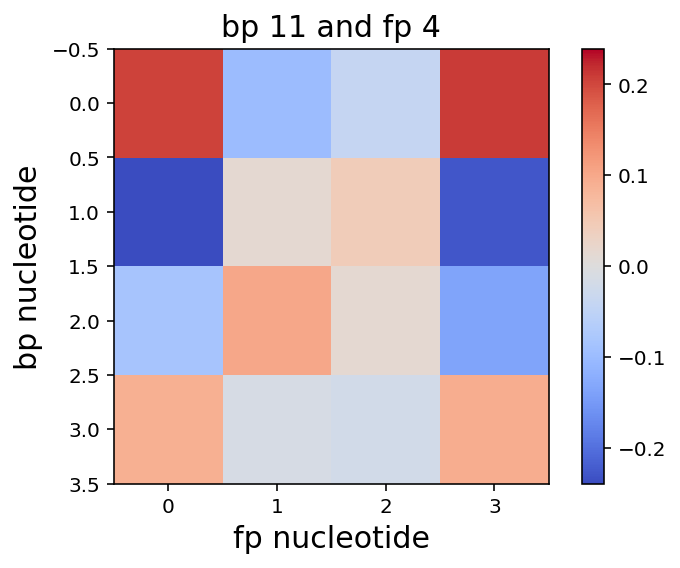

0.00173220490199
['0.09', '0.27', '0.11', '0.51']
['0.08', '0.05', '0.77', '0.07']


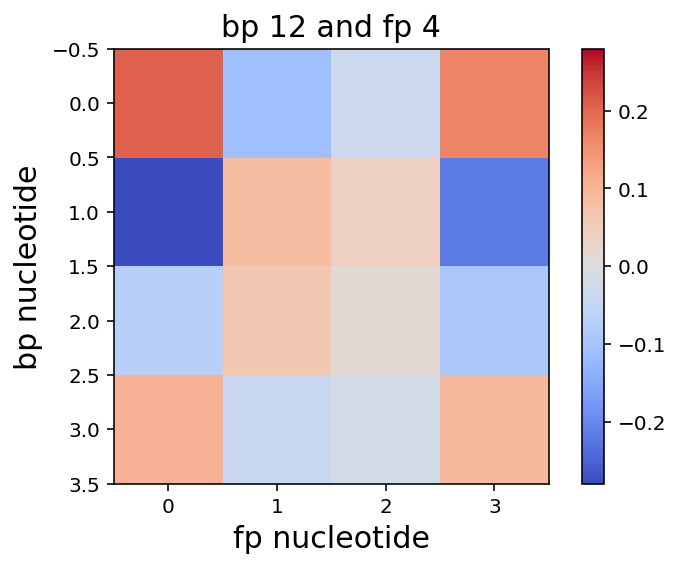

0.00201578754179
['0.09', '0.28', '0.10', '0.51']
['0.08', '0.05', '0.77', '0.07']


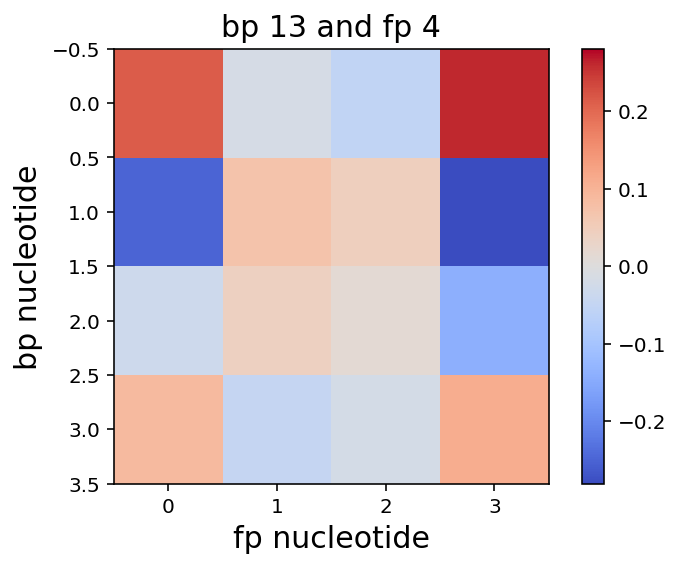

0.00192736828382
['0.09', '0.28', '0.10', '0.51']
['0.08', '0.05', '0.77', '0.07']


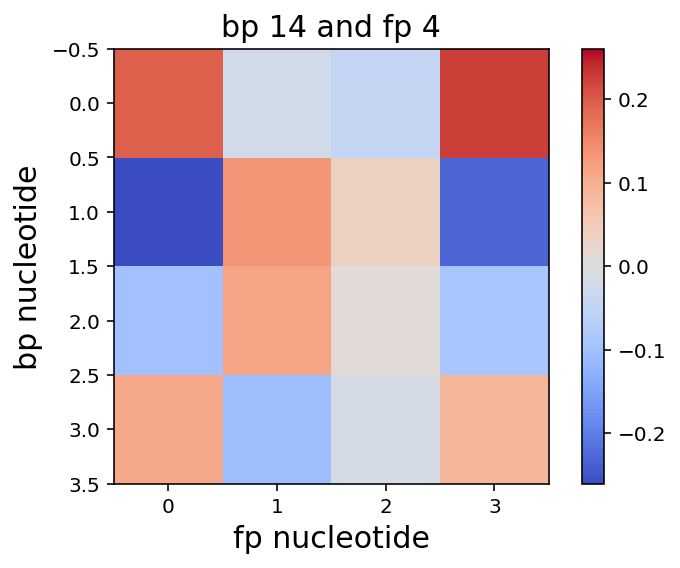

0.00255616768619
['0.24', '0.22', '0.22', '0.30']
['0.17', '0.15', '0.19', '0.48']


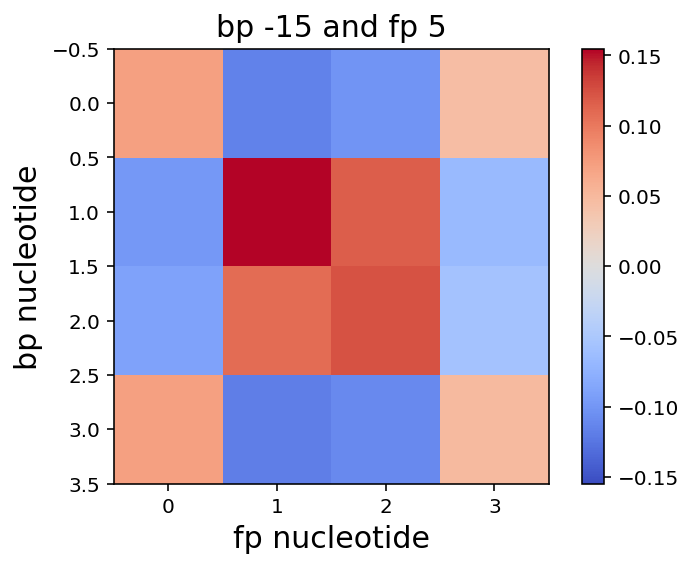

0.0024680133278
['0.25', '0.21', '0.23', '0.30']
['0.17', '0.15', '0.19', '0.48']


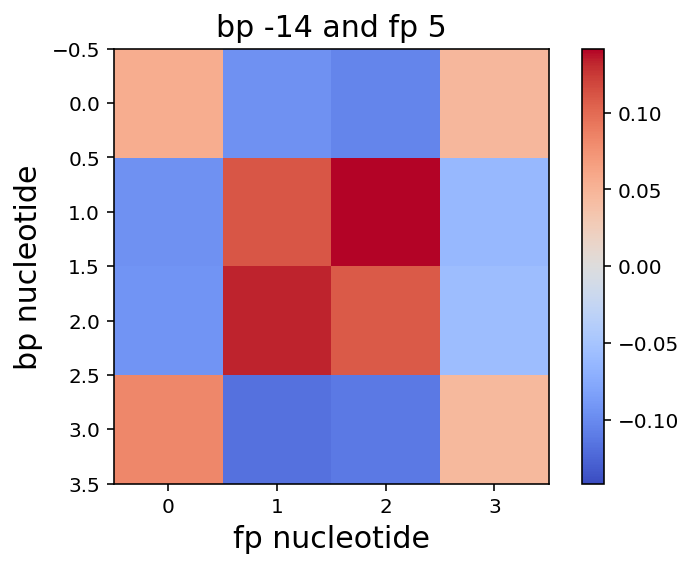

0.00254447011854
['0.25', '0.19', '0.24', '0.29']
['0.17', '0.15', '0.19', '0.48']


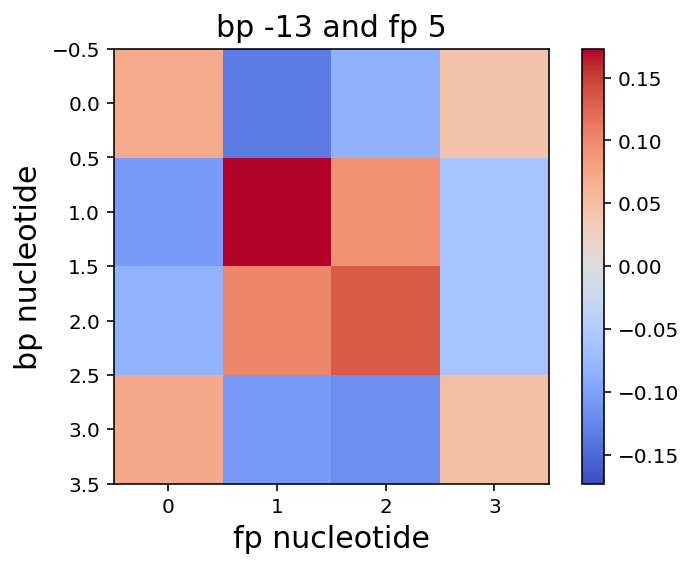

0.00226077711301
['0.26', '0.20', '0.25', '0.28']
['0.17', '0.15', '0.19', '0.48']


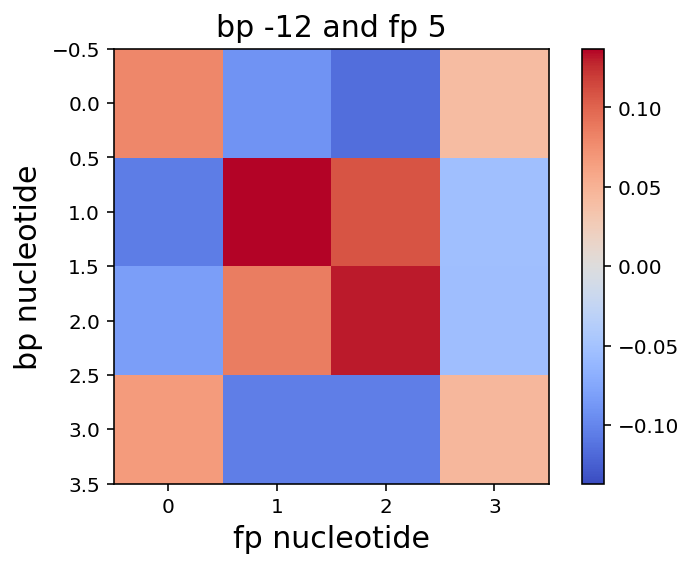

0.00218925695538
['0.25', '0.23', '0.23', '0.27']
['0.17', '0.15', '0.19', '0.48']


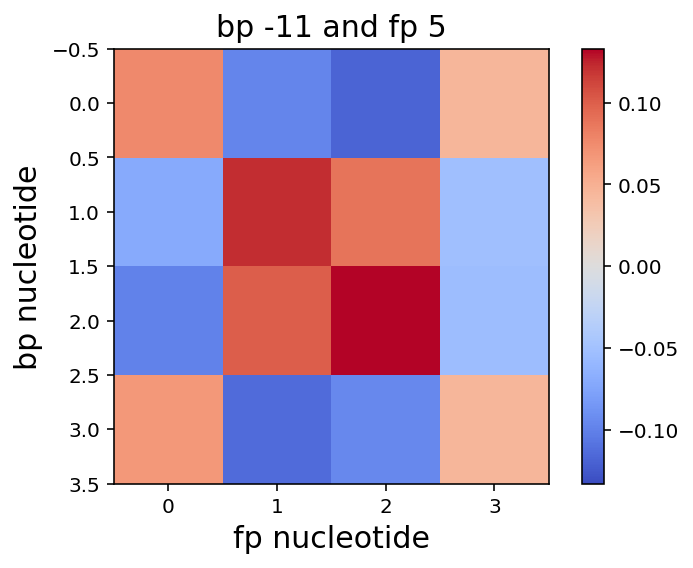

0.00242356620424
['0.24', '0.27', '0.21', '0.26']
['0.17', '0.15', '0.19', '0.48']


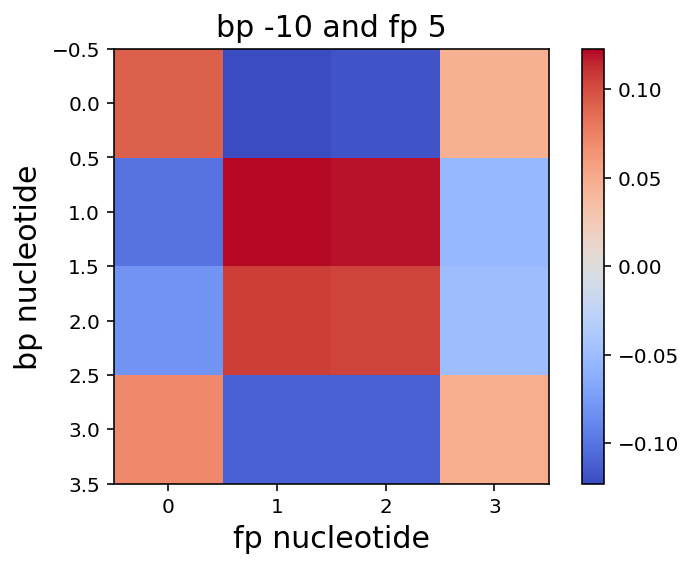

0.00226408819122
['0.24', '0.27', '0.19', '0.27']
['0.17', '0.15', '0.19', '0.48']


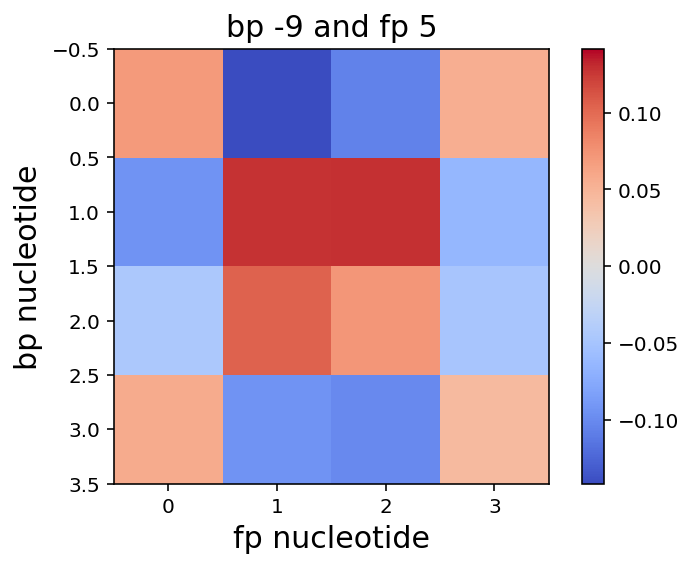

0.00230200293027
['0.25', '0.25', '0.20', '0.28']
['0.17', '0.15', '0.19', '0.48']


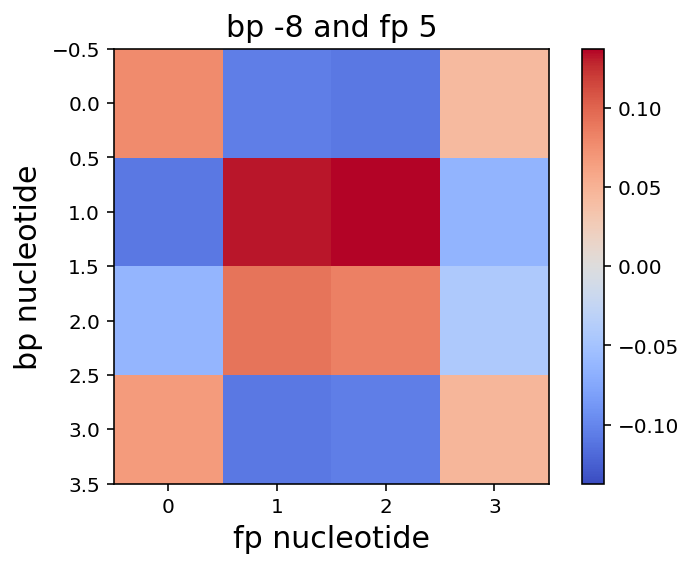

0.00248106103086
['0.25', '0.22', '0.23', '0.28']
['0.17', '0.15', '0.19', '0.48']


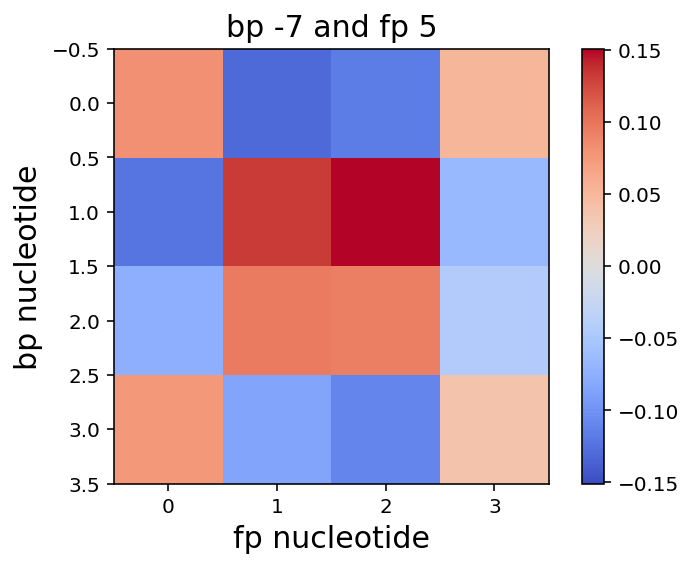

0.00263897557878
['0.26', '0.19', '0.24', '0.30']
['0.17', '0.15', '0.19', '0.48']


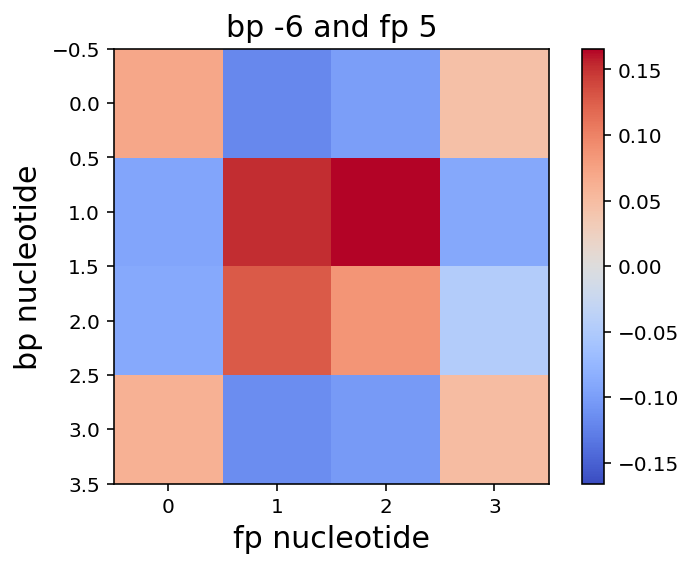

0.00267870509875
['0.23', '0.20', '0.21', '0.34']
['0.17', '0.15', '0.19', '0.48']


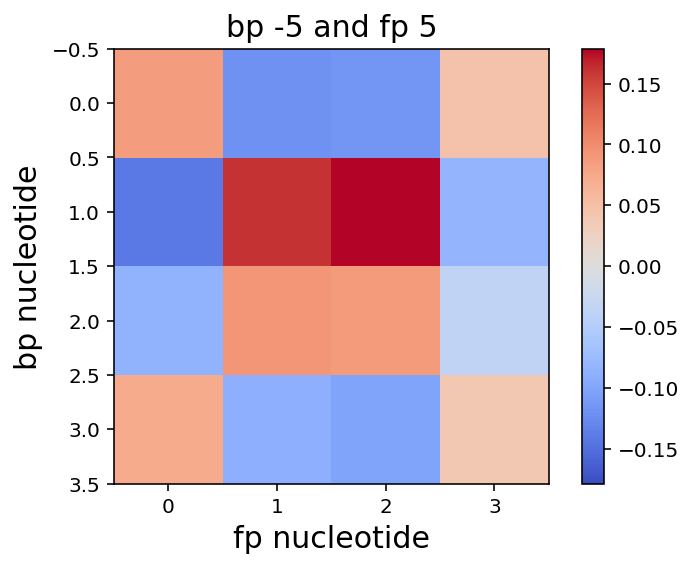

0.0030568712668
['0.27', '0.21', '0.19', '0.30']
['0.17', '0.15', '0.19', '0.48']


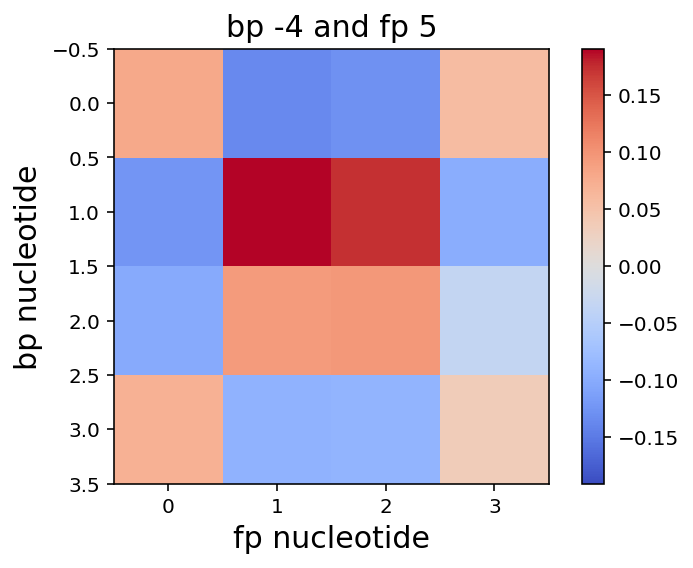

0.00264404708186
['0.09', '0.46', '0.11', '0.33']
['0.17', '0.15', '0.19', '0.48']


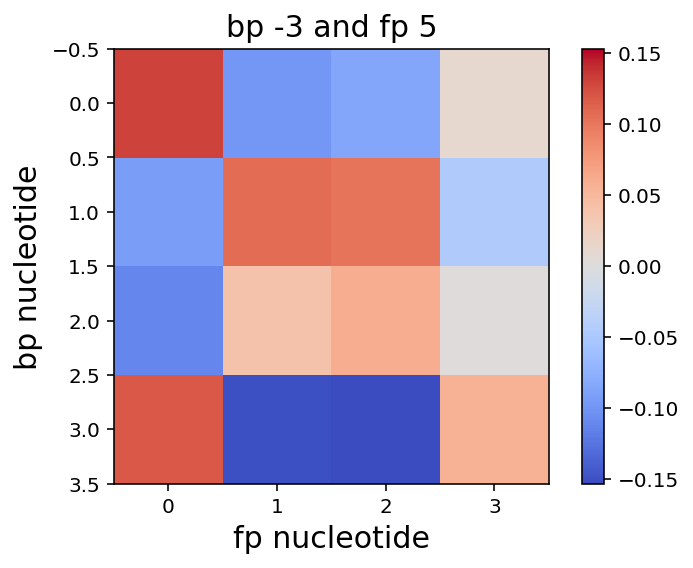

0.00125857181857
['0.06', '0.07', '0.05', '0.81']
['0.17', '0.15', '0.19', '0.48']


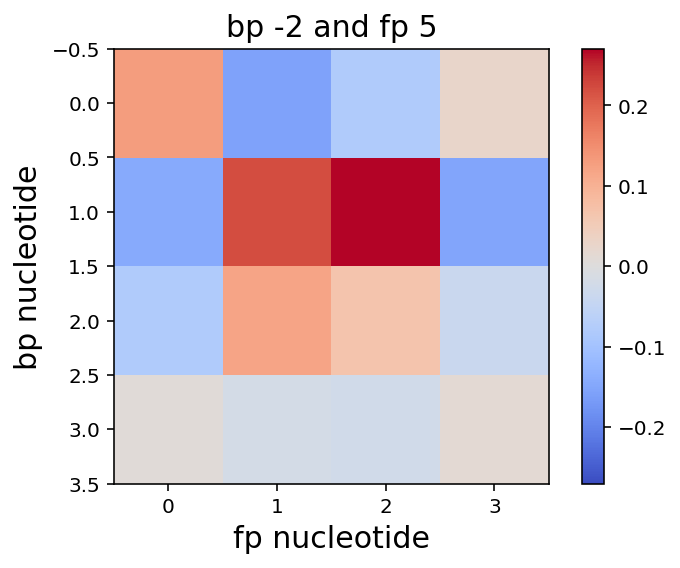

0.00424167803776
['0.24', '0.31', '0.26', '0.17']
['0.17', '0.15', '0.19', '0.48']


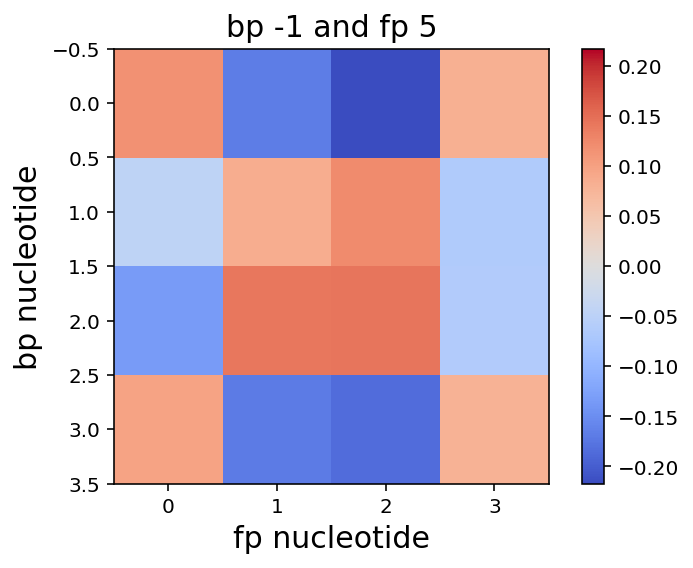

0.00033178784304
['0.98', '0.01', '0.00', '0.00']
['0.17', '0.15', '0.19', '0.48']


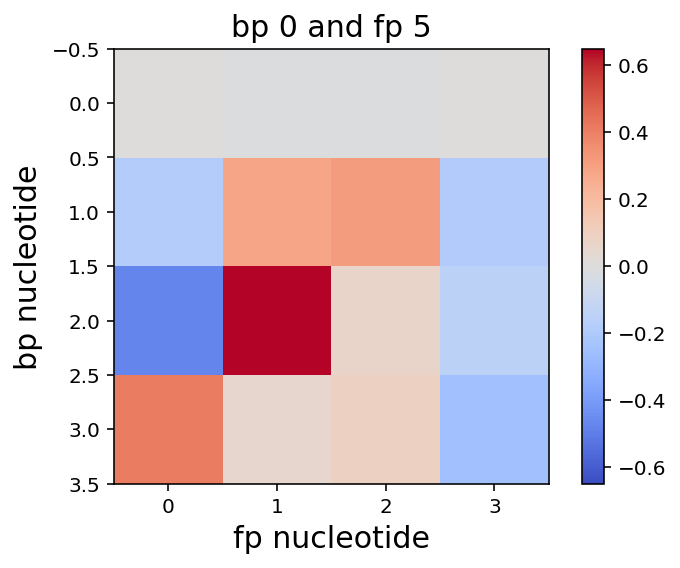

0.00376669170072
['0.18', '0.35', '0.14', '0.31']
['0.17', '0.15', '0.19', '0.48']


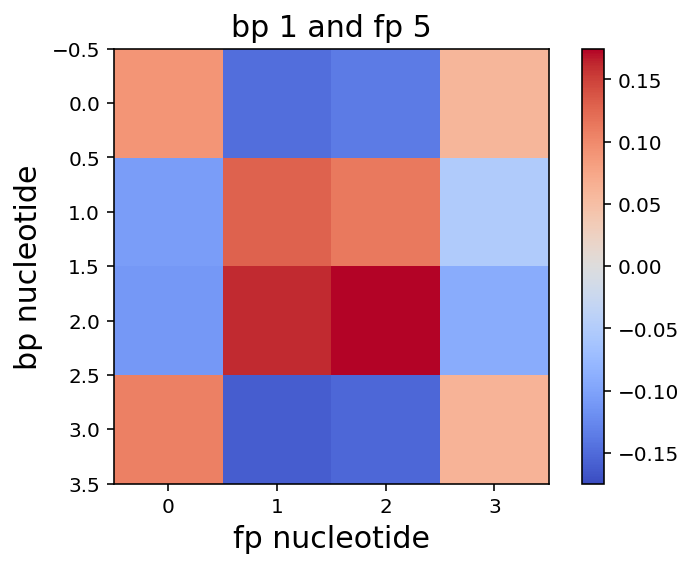

0.00267792291207
['0.23', '0.28', '0.16', '0.31']
['0.17', '0.15', '0.19', '0.48']


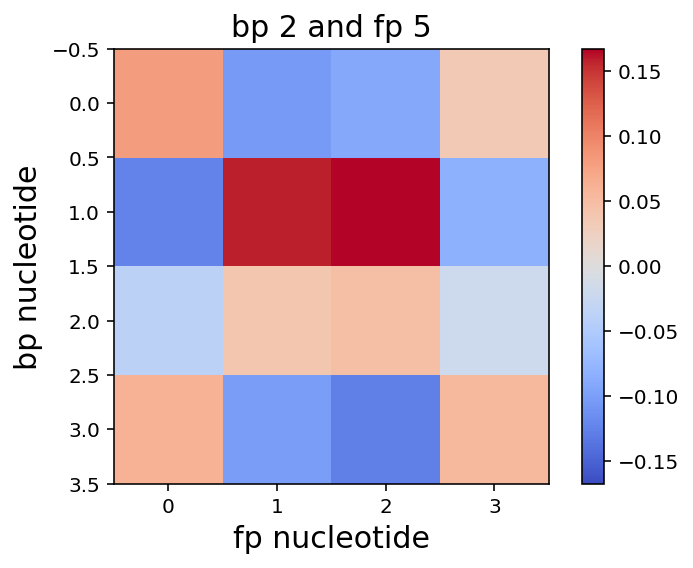

0.0025376190241
['0.22', '0.24', '0.20', '0.32']
['0.17', '0.15', '0.19', '0.48']


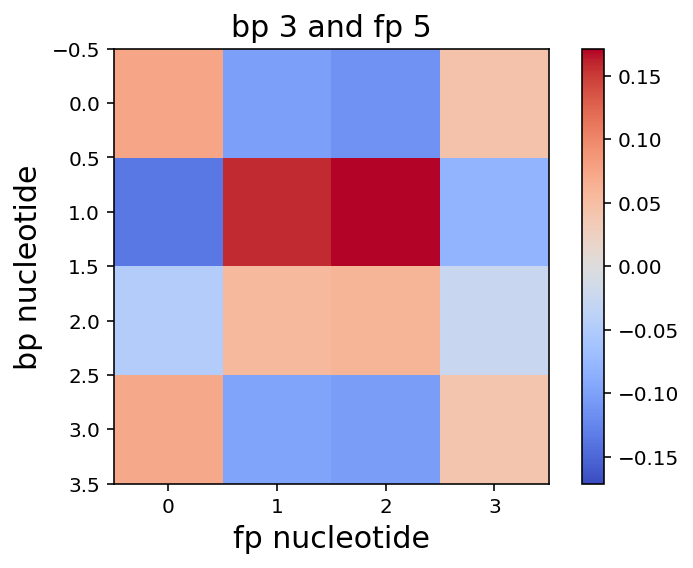

0.00276329544152
['0.20', '0.23', '0.18', '0.36']
['0.17', '0.15', '0.19', '0.48']


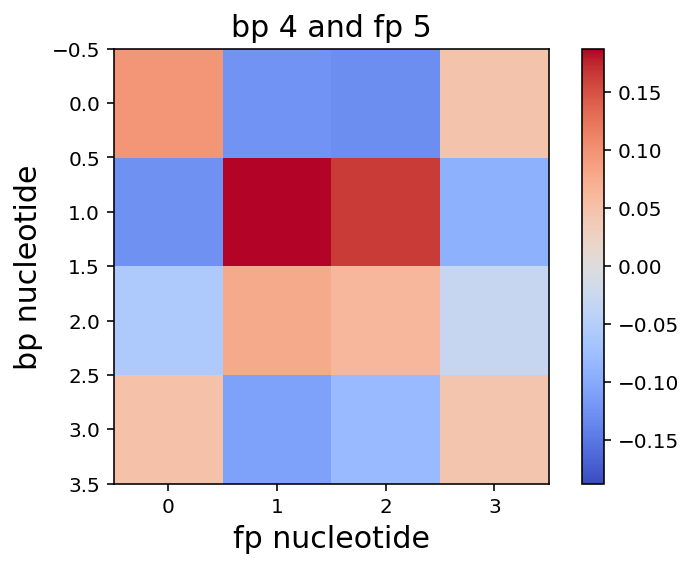

0.00254672465534
['0.19', '0.24', '0.19', '0.36']
['0.17', '0.15', '0.19', '0.48']


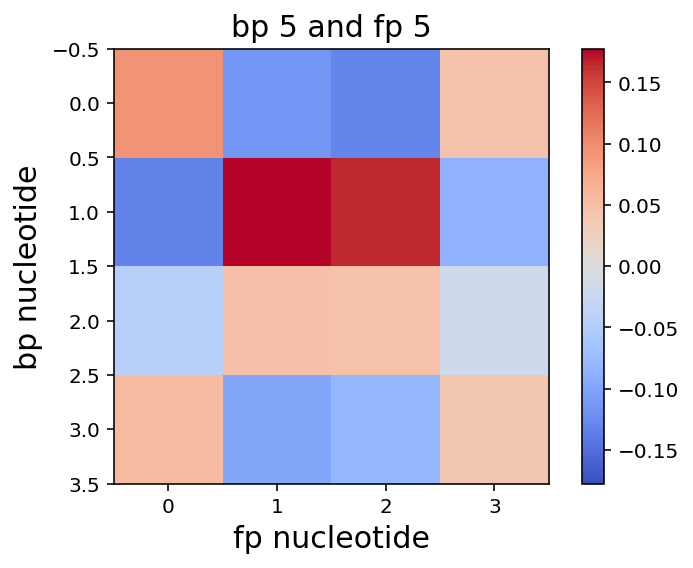

0.00230907881802
['0.18', '0.24', '0.18', '0.39']
['0.17', '0.15', '0.19', '0.48']


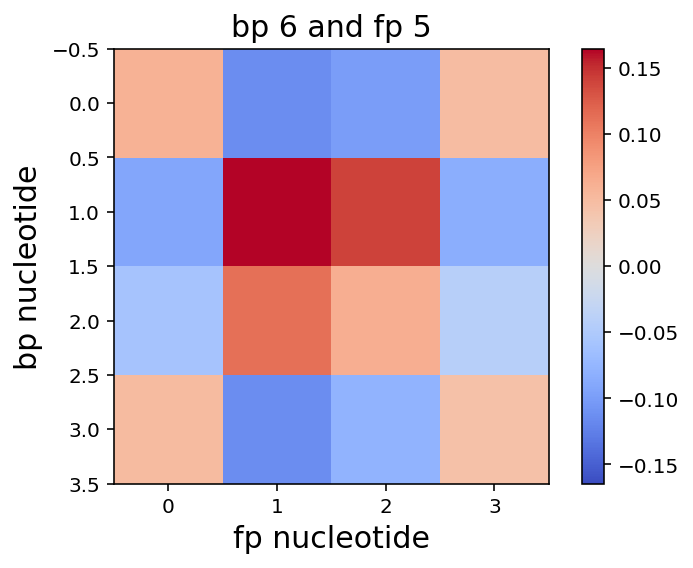

0.00289375737542
['0.15', '0.26', '0.15', '0.42']
['0.17', '0.15', '0.19', '0.48']


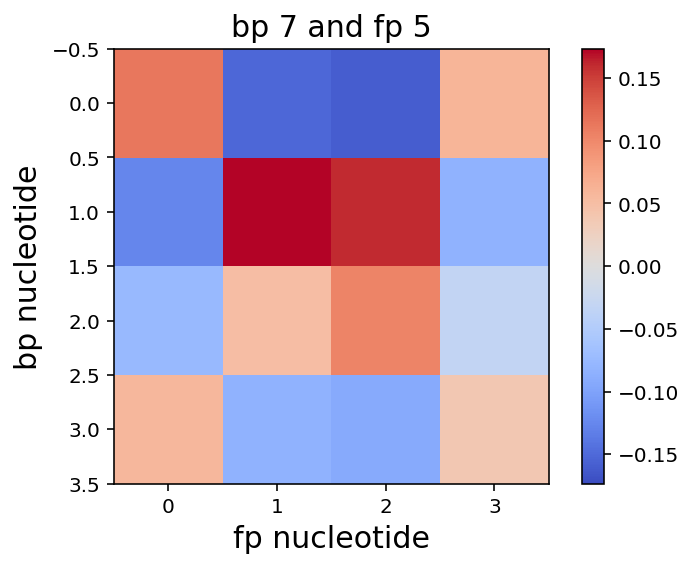

0.00293605998977
['0.13', '0.27', '0.12', '0.45']
['0.17', '0.15', '0.19', '0.48']


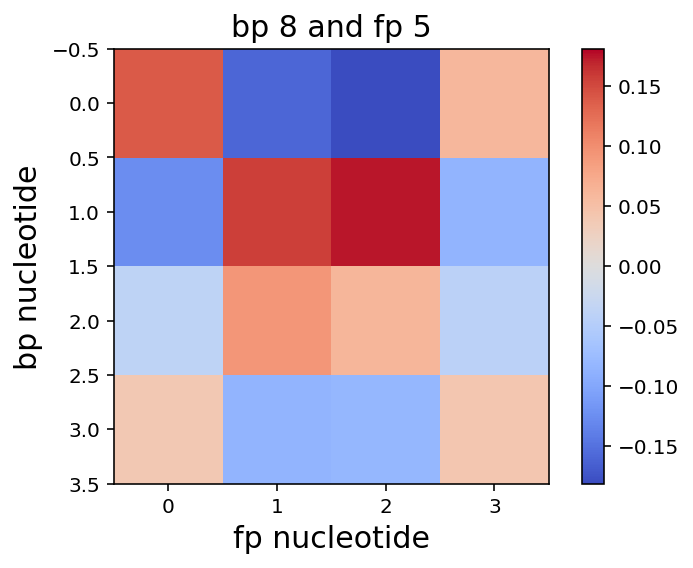

0.00276678499883
['0.12', '0.27', '0.11', '0.49']
['0.17', '0.15', '0.19', '0.48']


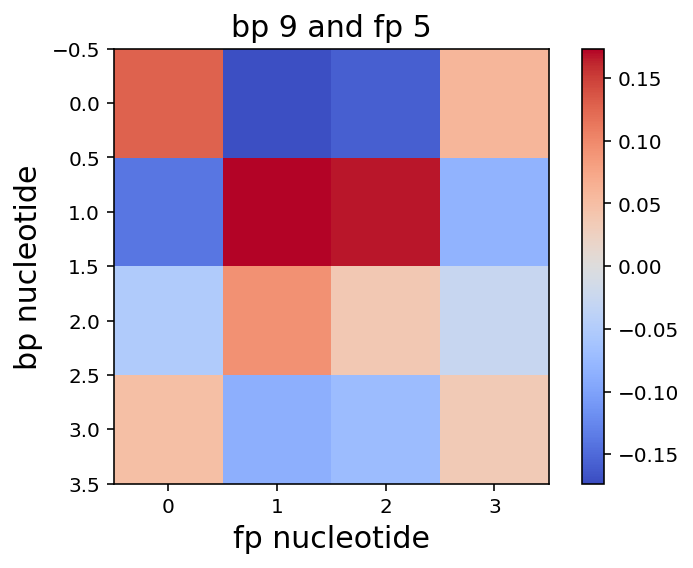

0.00250254842137
['0.11', '0.27', '0.11', '0.50']
['0.17', '0.15', '0.19', '0.48']


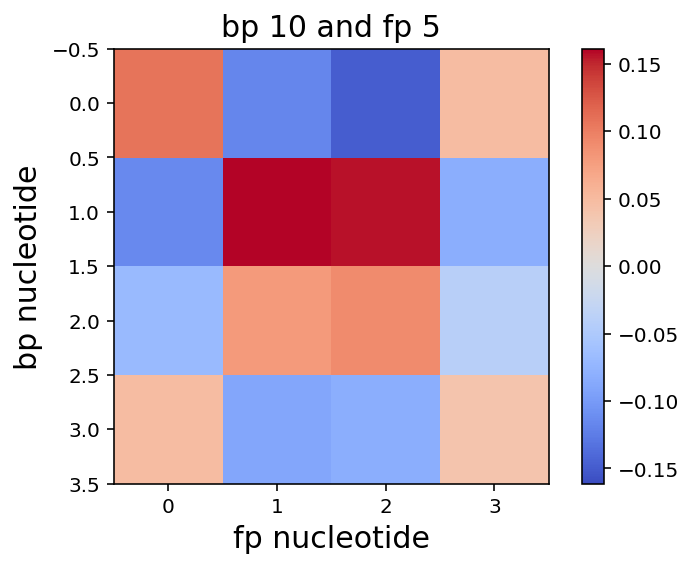

0.00290336384421
['0.09', '0.27', '0.11', '0.51']
['0.17', '0.15', '0.19', '0.48']


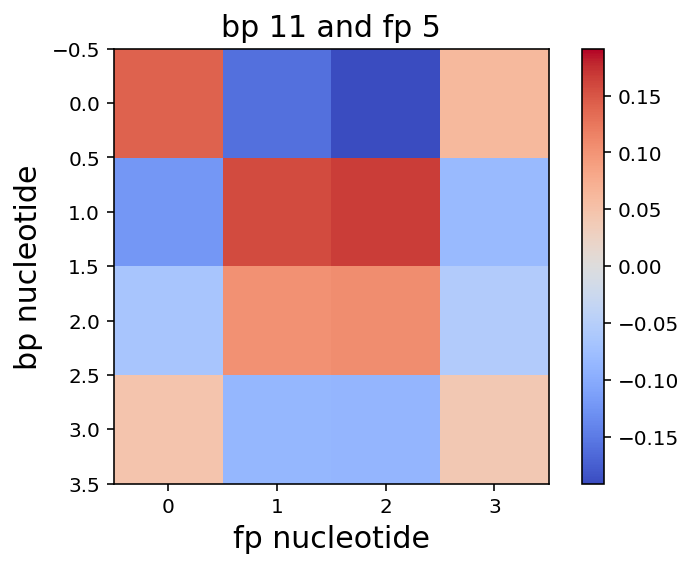

0.00202555007021
['0.09', '0.27', '0.11', '0.51']
['0.17', '0.15', '0.19', '0.48']


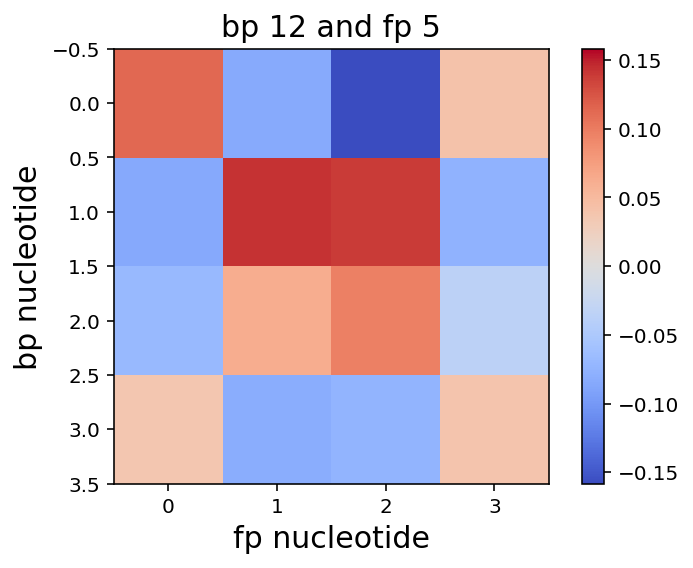

0.0028114841461
['0.09', '0.28', '0.10', '0.51']
['0.17', '0.15', '0.19', '0.48']


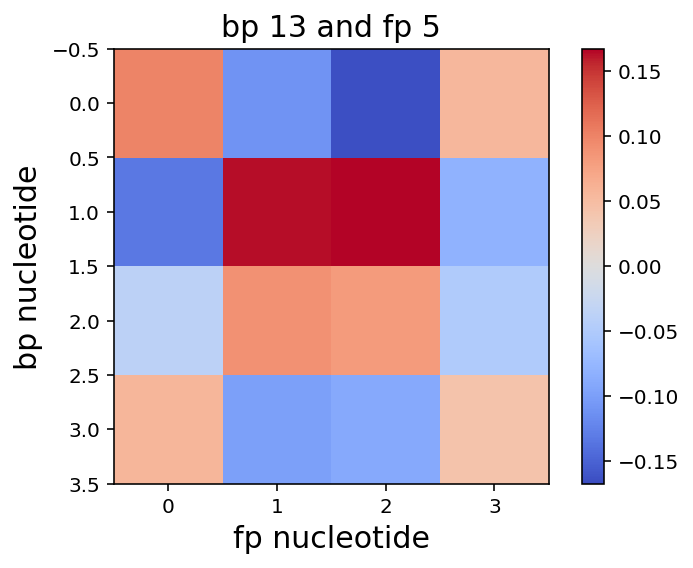

0.00277317497358
['0.09', '0.28', '0.10', '0.51']
['0.17', '0.15', '0.19', '0.48']


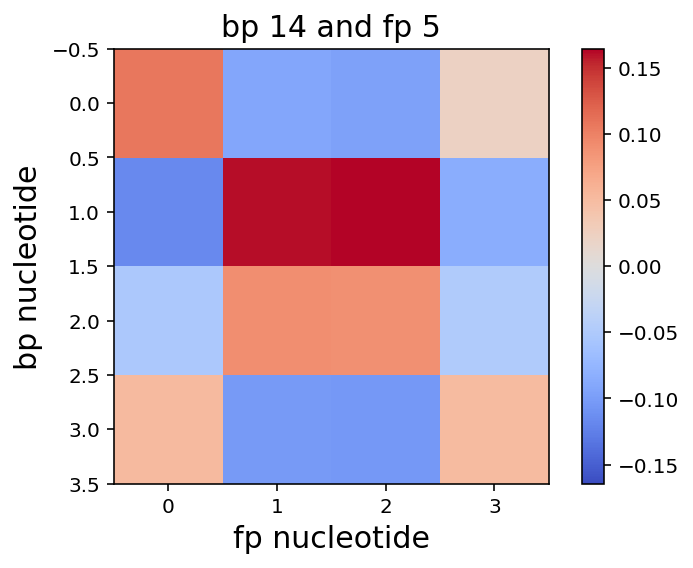

0.00646114935937
['0.24', '0.22', '0.22', '0.30']
['0.29', '0.19', '0.29', '0.21']


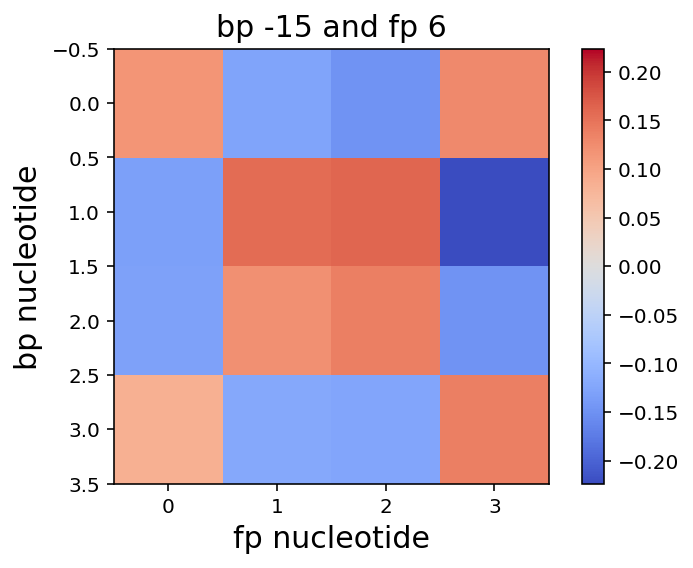

0.00554159372996
['0.25', '0.21', '0.23', '0.30']
['0.29', '0.19', '0.29', '0.21']


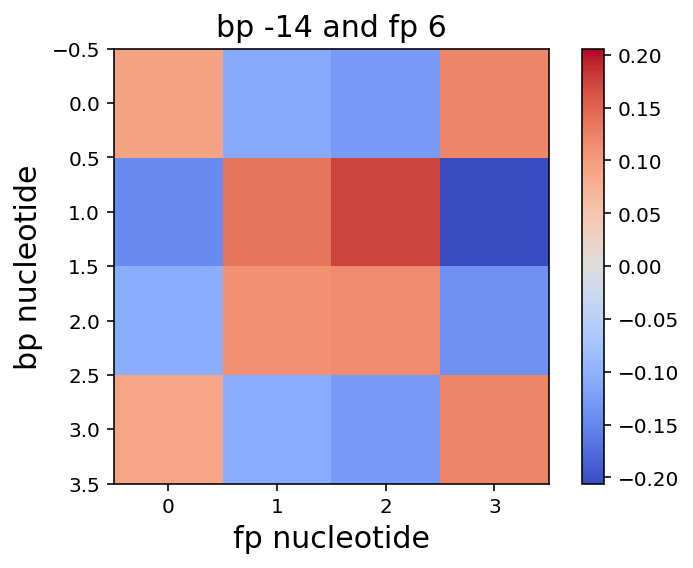

0.00563680706654
['0.25', '0.19', '0.24', '0.29']
['0.29', '0.19', '0.29', '0.21']


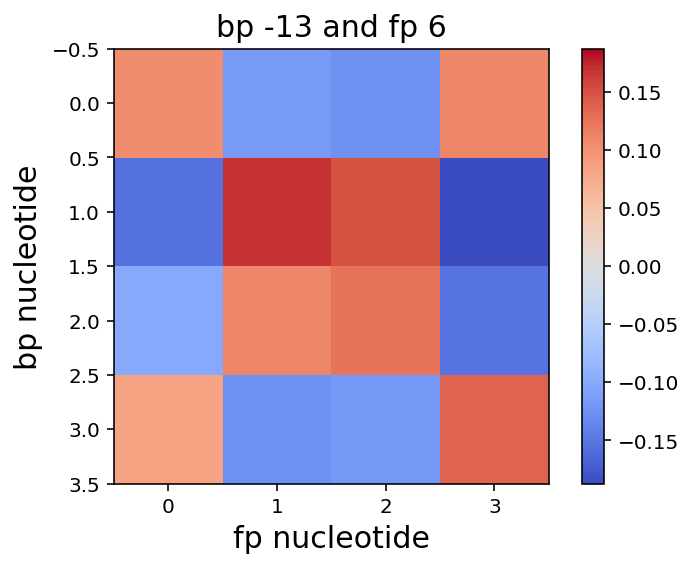

0.0048572253986
['0.26', '0.20', '0.25', '0.28']
['0.29', '0.19', '0.29', '0.21']


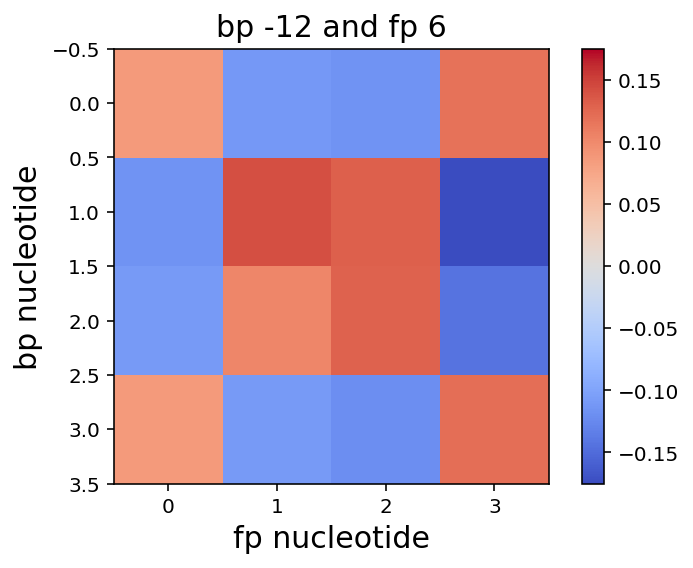

0.00501818623631
['0.25', '0.23', '0.23', '0.27']
['0.29', '0.19', '0.29', '0.21']


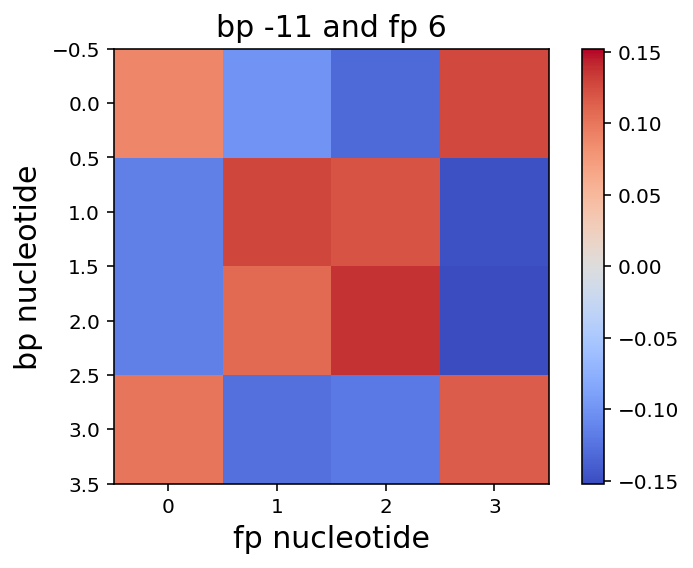

0.0051759525193
['0.24', '0.27', '0.21', '0.26']
['0.29', '0.19', '0.29', '0.21']


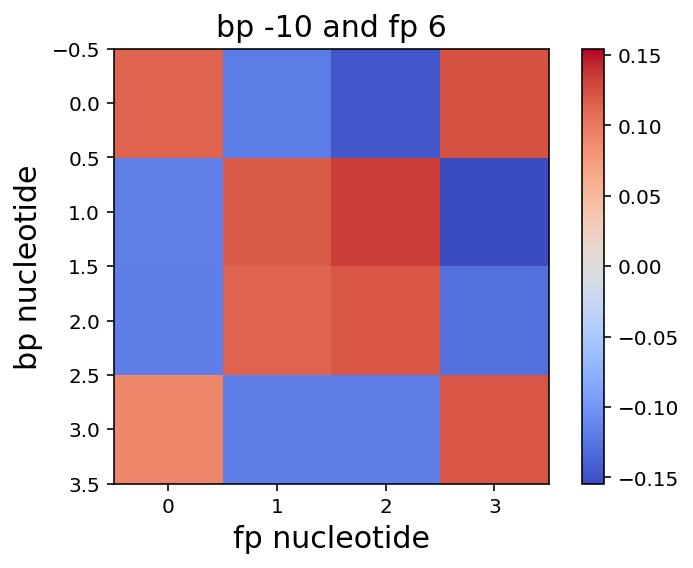

0.00491904490504
['0.24', '0.27', '0.19', '0.27']
['0.29', '0.19', '0.29', '0.21']


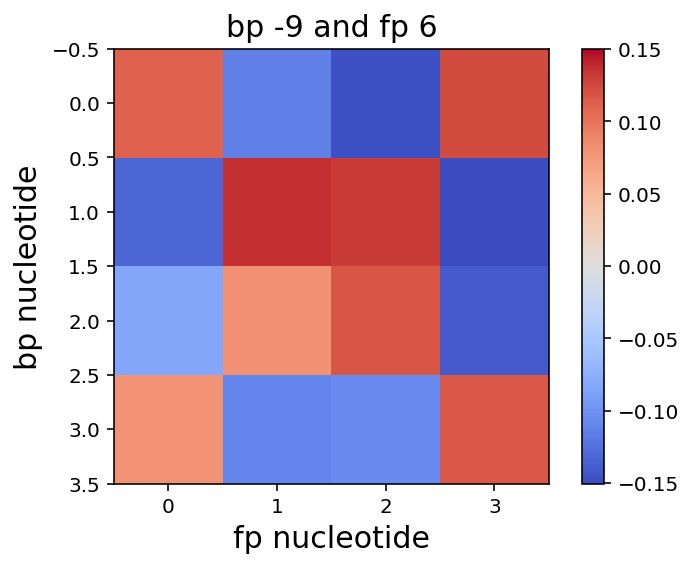

0.0055721417131
['0.25', '0.25', '0.20', '0.28']
['0.29', '0.19', '0.29', '0.21']


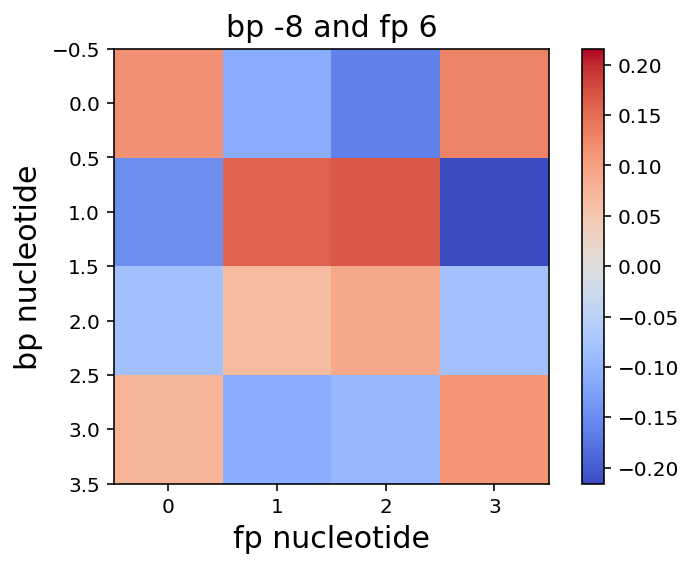

0.00548856867838
['0.25', '0.22', '0.23', '0.28']
['0.29', '0.19', '0.29', '0.21']


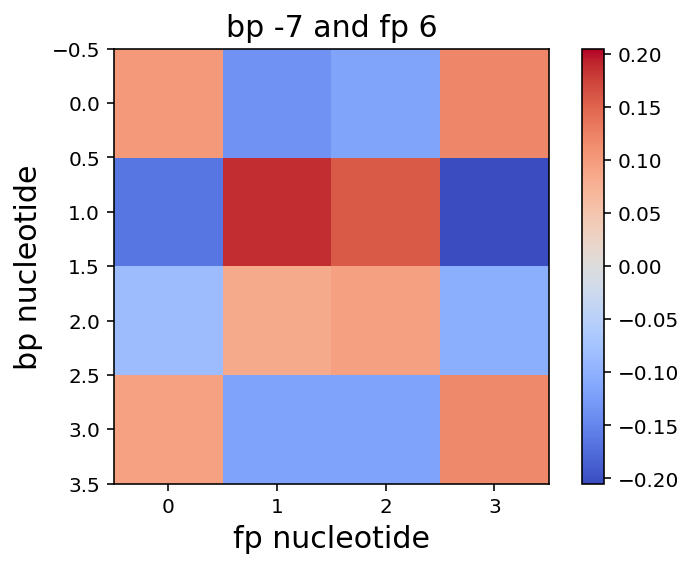

0.00568334520461
['0.26', '0.19', '0.24', '0.30']
['0.29', '0.19', '0.29', '0.21']


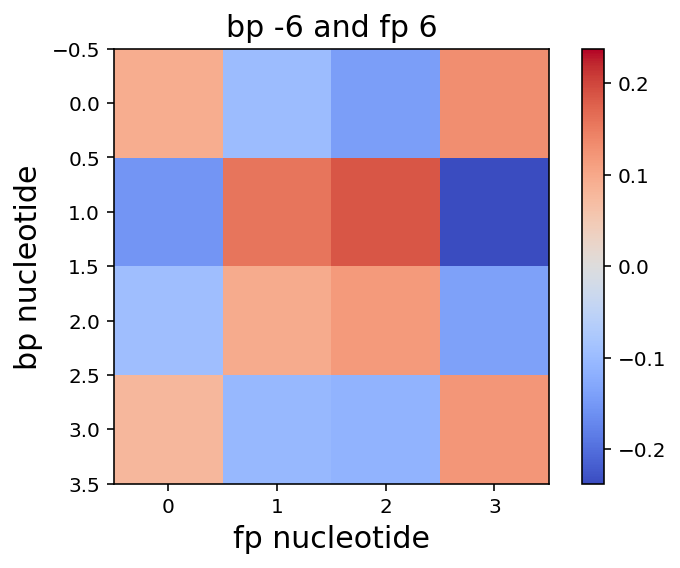

0.00607284340176
['0.23', '0.20', '0.21', '0.34']
['0.29', '0.19', '0.29', '0.21']


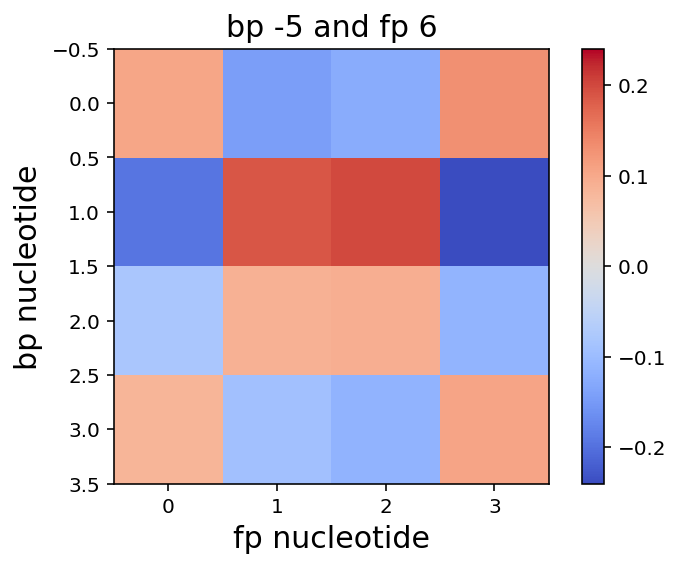

0.00544326859298
['0.27', '0.21', '0.19', '0.30']
['0.29', '0.19', '0.29', '0.21']


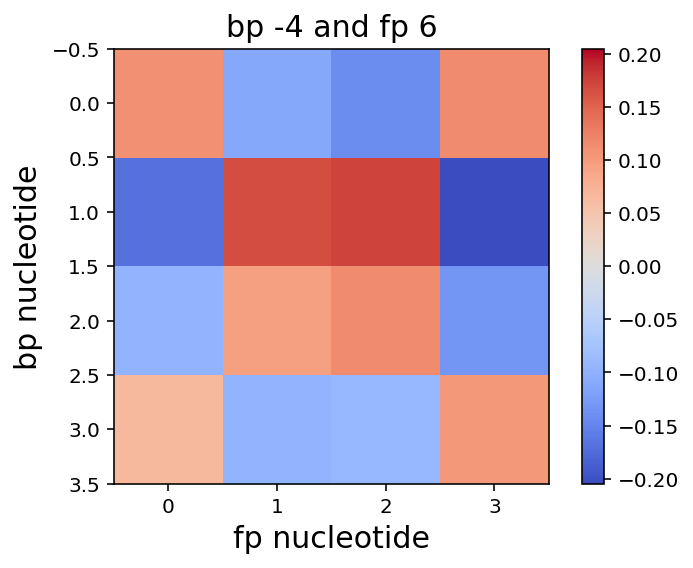

0.006735800262
['0.09', '0.46', '0.11', '0.33']
['0.29', '0.19', '0.29', '0.21']


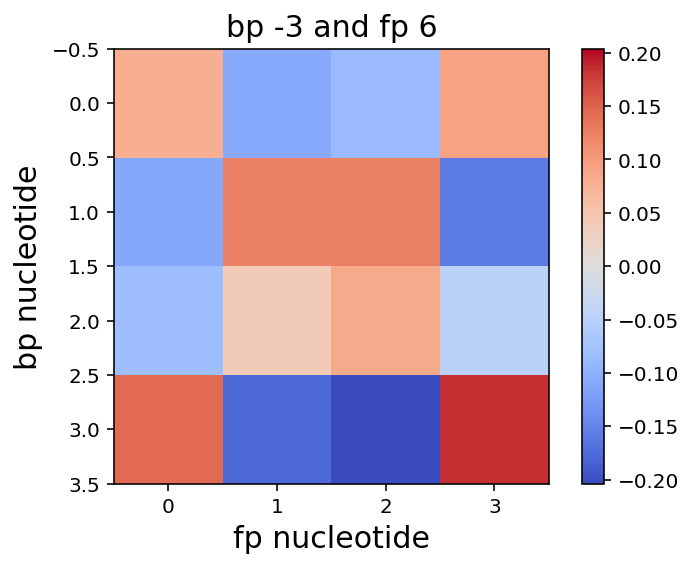

0.00185238646451
['0.06', '0.07', '0.05', '0.81']
['0.29', '0.19', '0.29', '0.21']


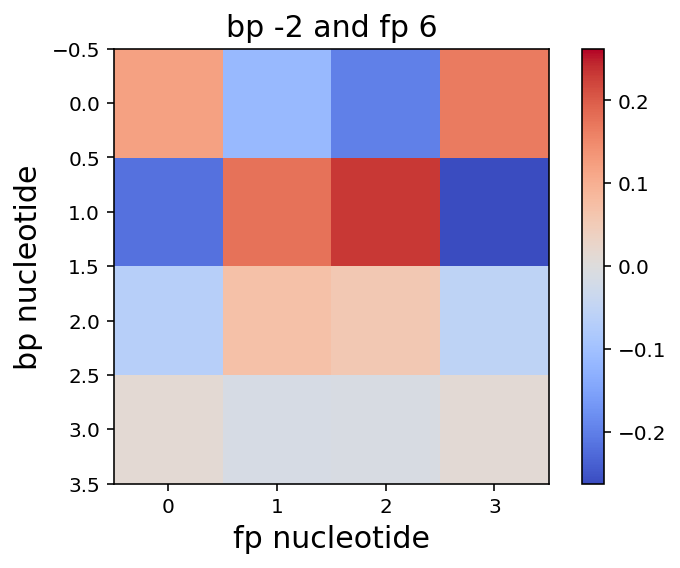

0.00878384691437
['0.24', '0.31', '0.26', '0.17']
['0.29', '0.19', '0.29', '0.21']


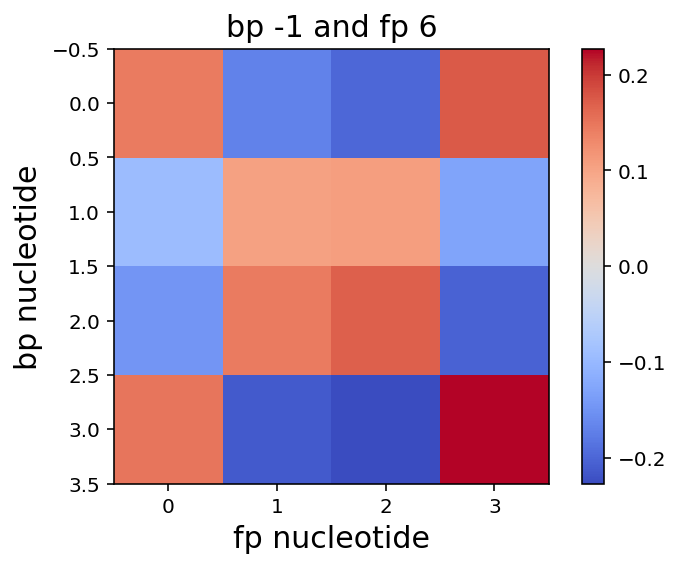

0.000813020953101
['0.98', '0.01', '0.00', '0.00']
['0.29', '0.19', '0.29', '0.21']


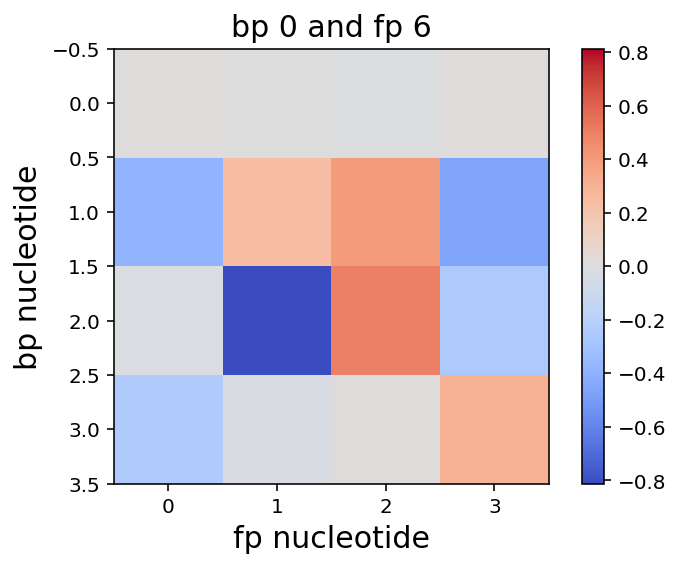

0.00816916385329
['0.18', '0.35', '0.14', '0.31']
['0.29', '0.19', '0.29', '0.21']


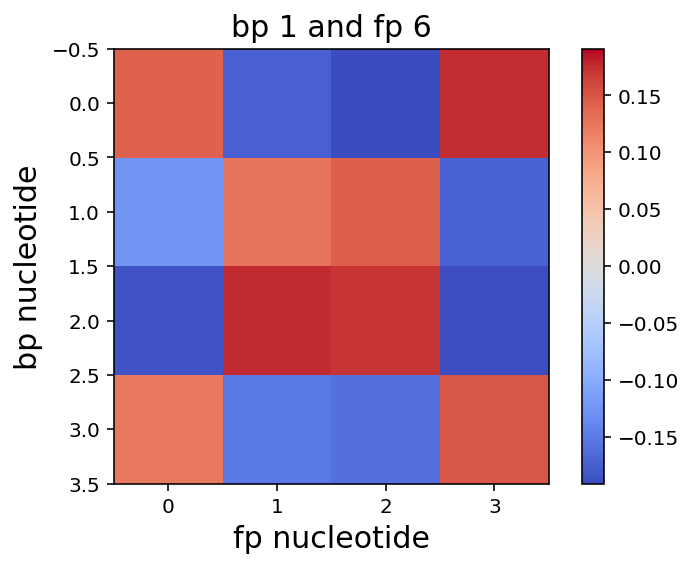

0.00573847556546
['0.23', '0.28', '0.16', '0.31']
['0.29', '0.19', '0.29', '0.21']


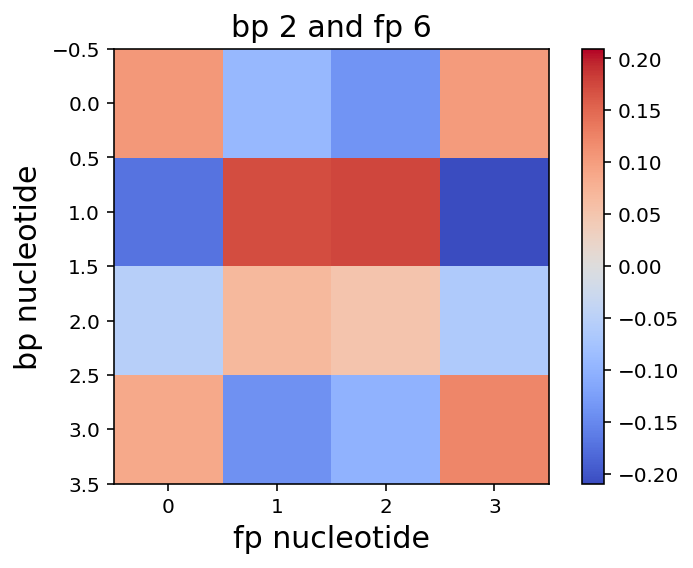

0.00455000967956
['0.22', '0.24', '0.20', '0.32']
['0.29', '0.19', '0.29', '0.21']


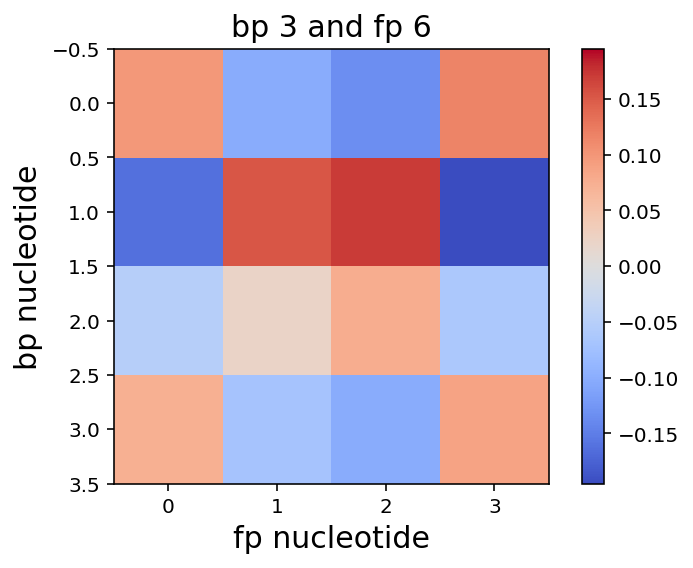

0.00594546256148
['0.20', '0.23', '0.18', '0.36']
['0.29', '0.19', '0.29', '0.21']


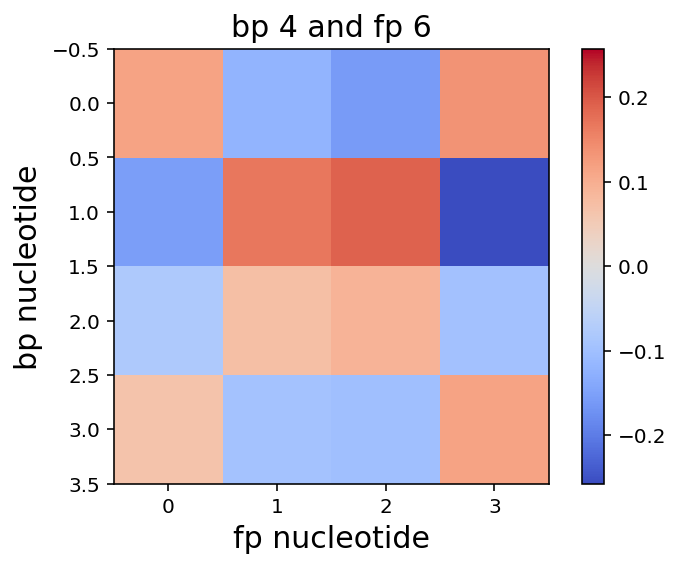

0.00535315603706
['0.19', '0.24', '0.19', '0.36']
['0.29', '0.19', '0.29', '0.21']


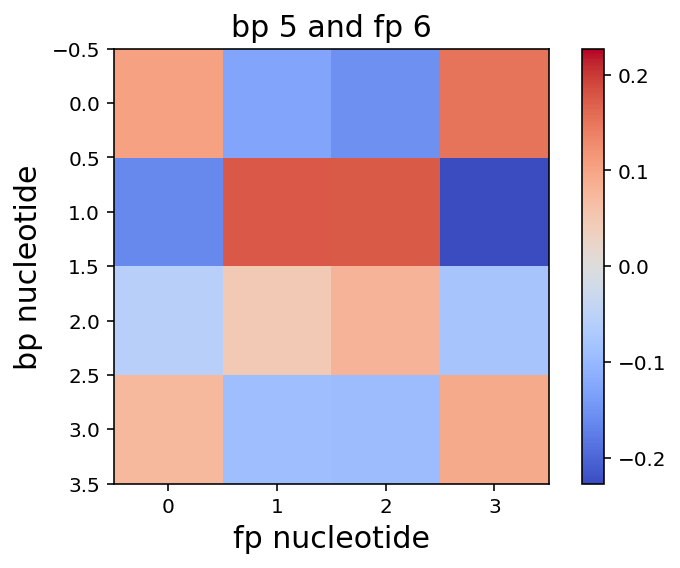

0.00609949967985
['0.18', '0.24', '0.18', '0.39']
['0.29', '0.19', '0.29', '0.21']


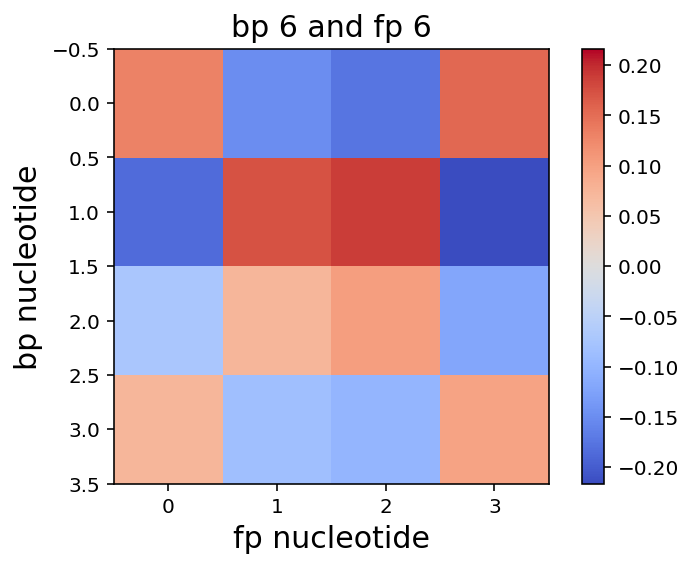

0.0057790087057
['0.15', '0.26', '0.15', '0.42']
['0.29', '0.19', '0.29', '0.21']


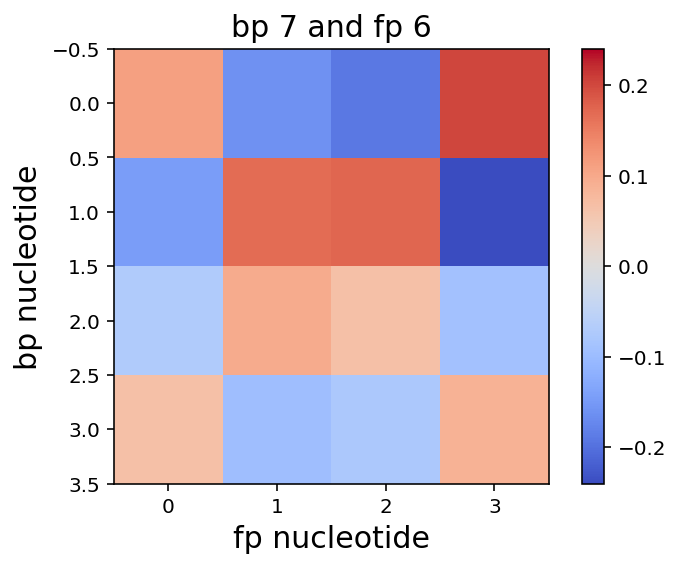

0.00612021435381
['0.13', '0.27', '0.12', '0.45']
['0.29', '0.19', '0.29', '0.21']


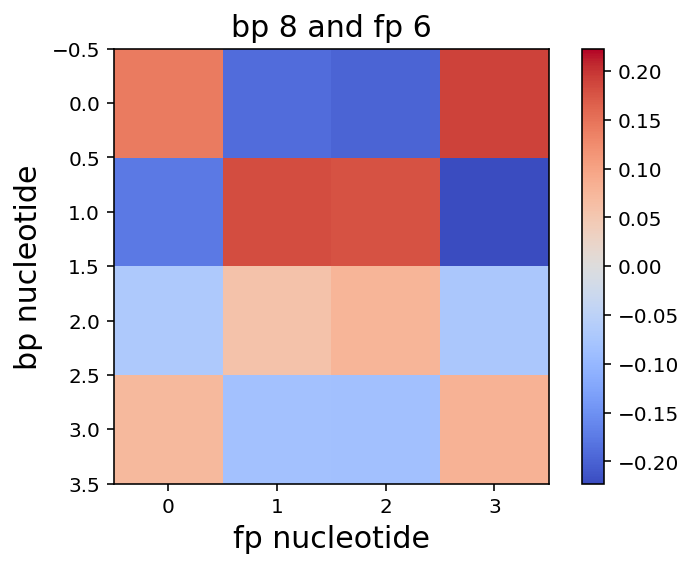

0.00541936253434
['0.12', '0.27', '0.11', '0.49']
['0.29', '0.19', '0.29', '0.21']


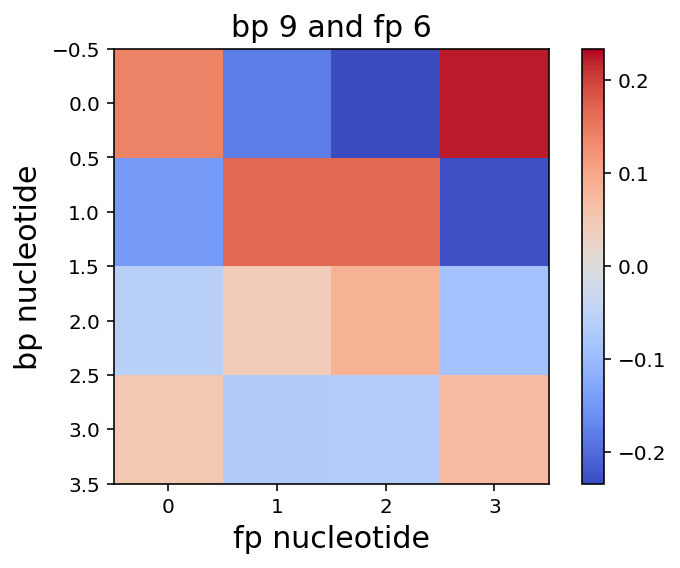

0.00551457951065
['0.11', '0.27', '0.11', '0.50']
['0.29', '0.19', '0.29', '0.21']


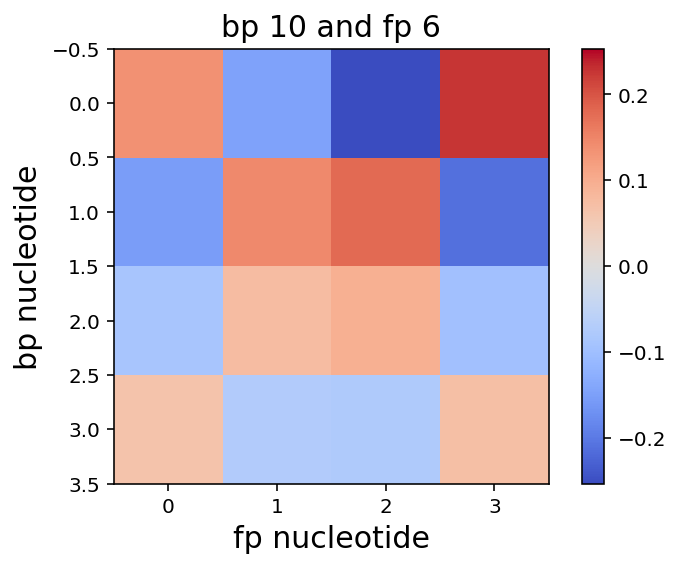

0.00449477481832
['0.09', '0.27', '0.11', '0.51']
['0.29', '0.19', '0.29', '0.21']


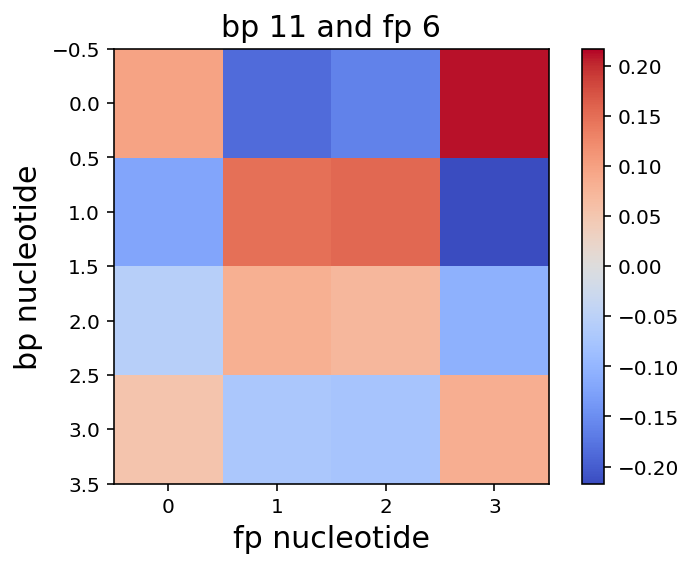

0.00534687376932
['0.09', '0.27', '0.11', '0.51']
['0.29', '0.19', '0.29', '0.21']


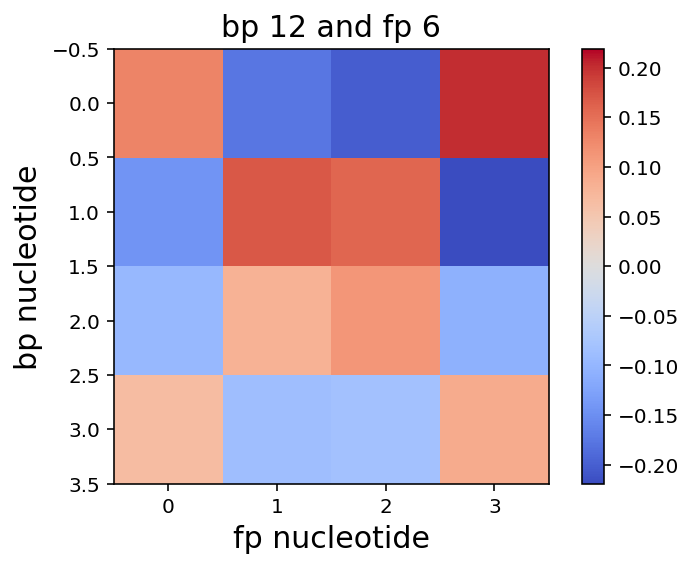

0.00464718872991
['0.09', '0.28', '0.10', '0.51']
['0.29', '0.19', '0.29', '0.21']


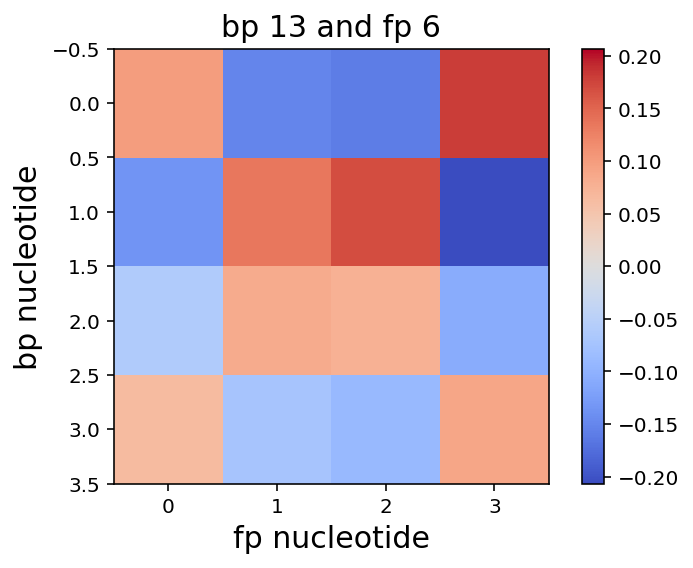

0.00584274562853
['0.09', '0.28', '0.10', '0.51']
['0.29', '0.19', '0.29', '0.21']


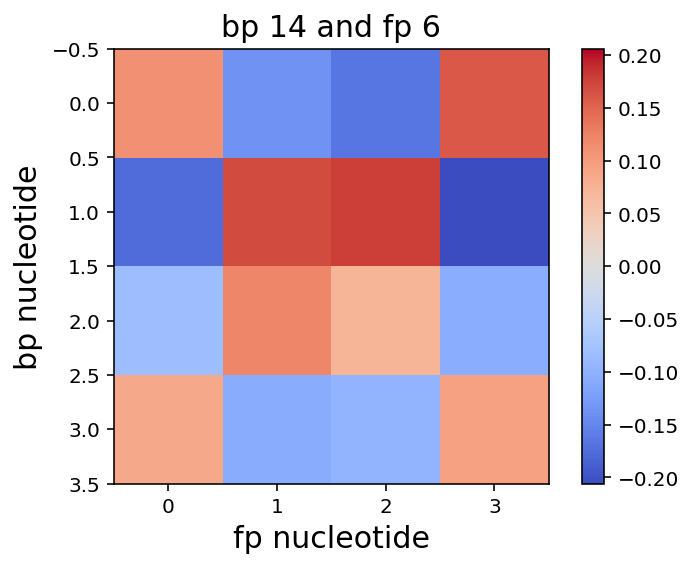

0.00478867544152
['0.24', '0.22', '0.22', '0.30']
['0.22', '0.25', '0.23', '0.28']


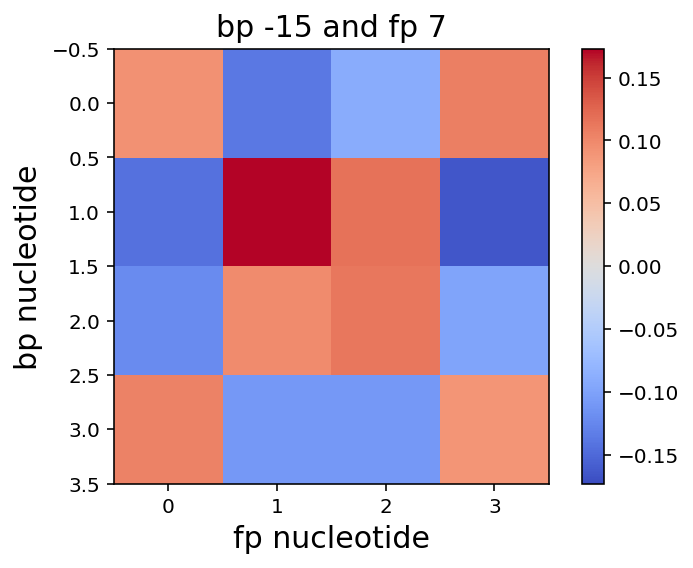

0.0045255366294
['0.25', '0.21', '0.23', '0.30']
['0.22', '0.25', '0.23', '0.28']


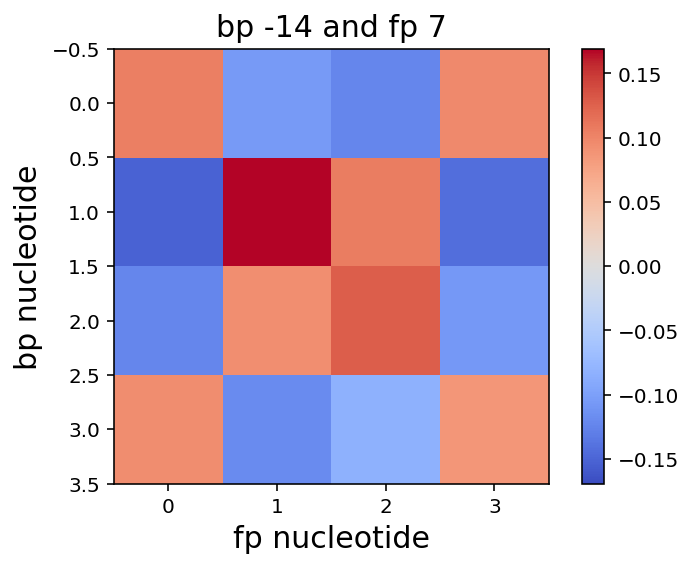

0.0050350343194
['0.25', '0.19', '0.24', '0.29']
['0.22', '0.25', '0.23', '0.28']


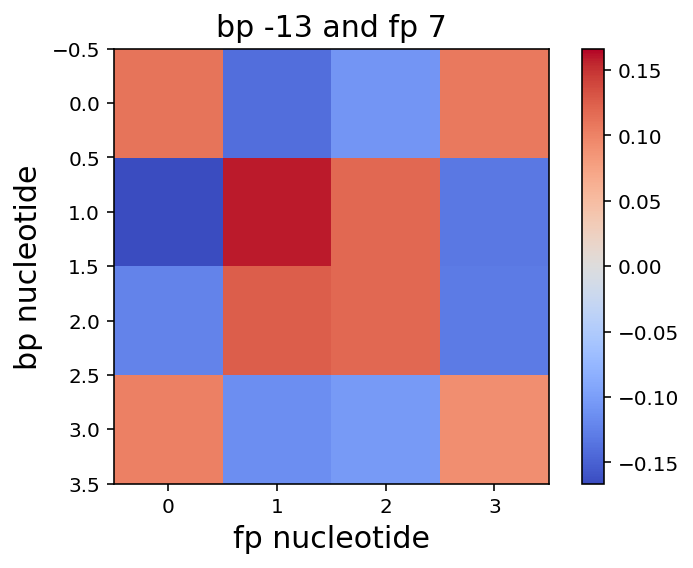

0.00468571280441
['0.26', '0.20', '0.25', '0.28']
['0.22', '0.25', '0.23', '0.28']


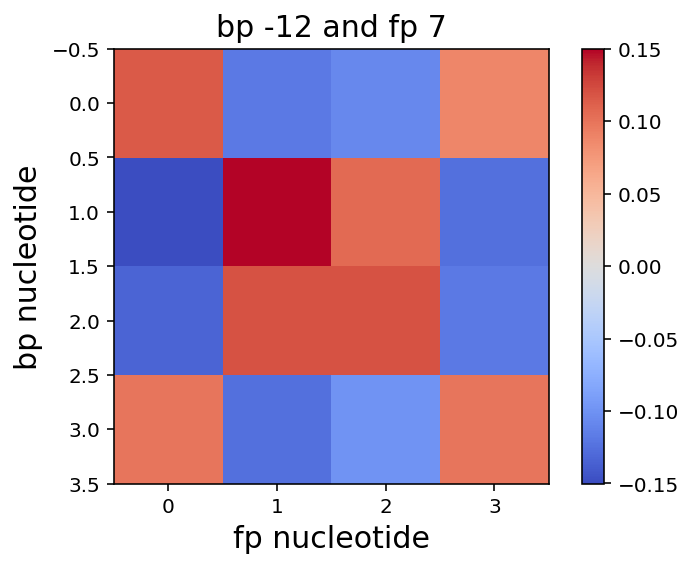

0.00420443515459
['0.25', '0.23', '0.23', '0.27']
['0.22', '0.25', '0.23', '0.28']


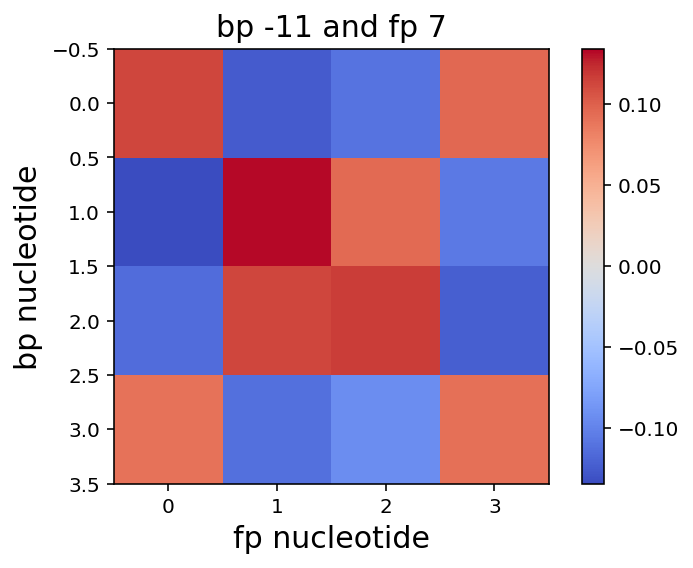

0.0041685084679
['0.24', '0.27', '0.21', '0.26']
['0.22', '0.25', '0.23', '0.28']


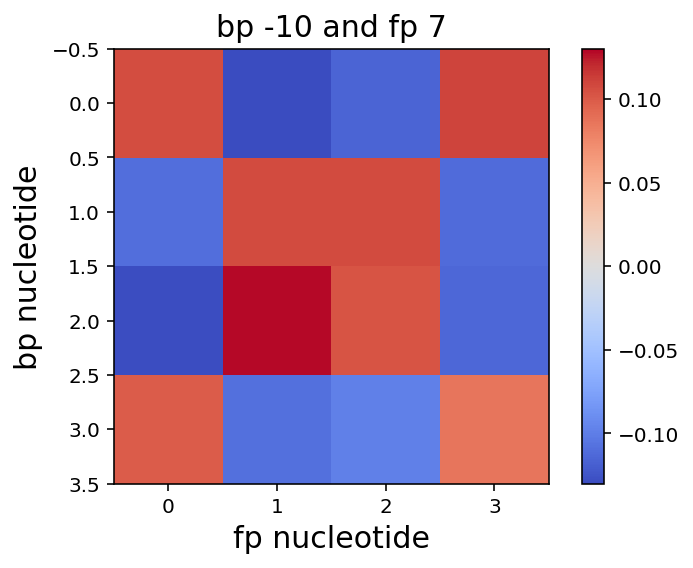

0.00405687151857
['0.24', '0.27', '0.19', '0.27']
['0.22', '0.25', '0.23', '0.28']


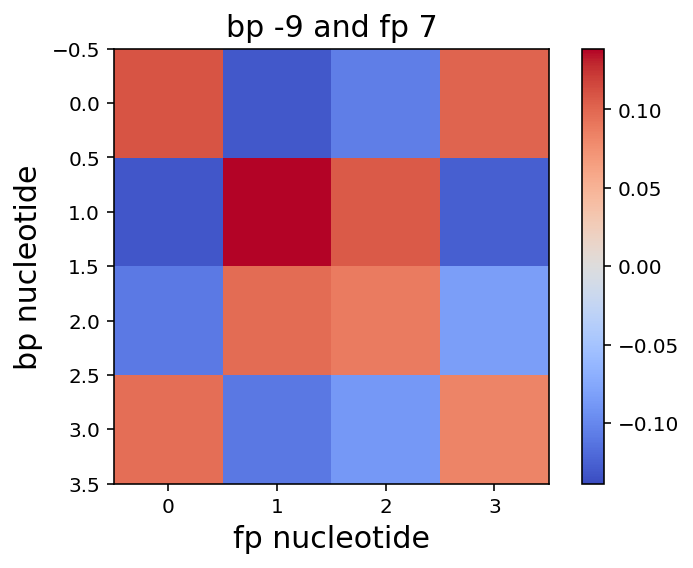

0.00437197488131
['0.25', '0.25', '0.20', '0.28']
['0.22', '0.25', '0.23', '0.28']


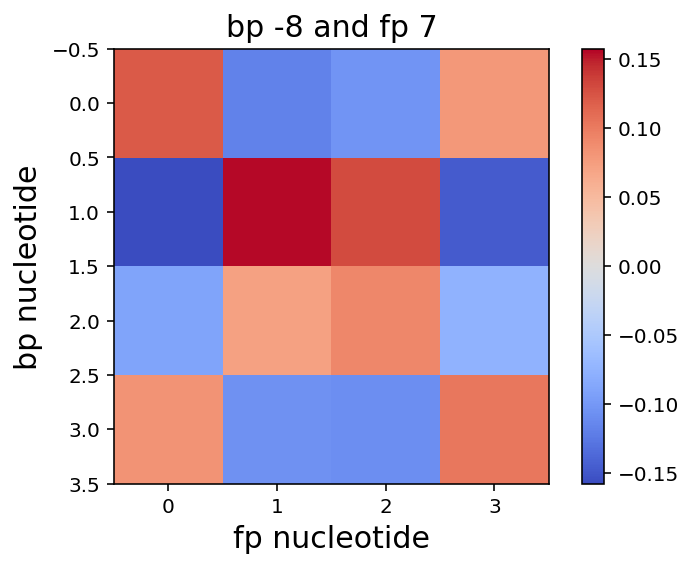

0.00462341215732
['0.25', '0.22', '0.23', '0.28']
['0.22', '0.25', '0.23', '0.28']


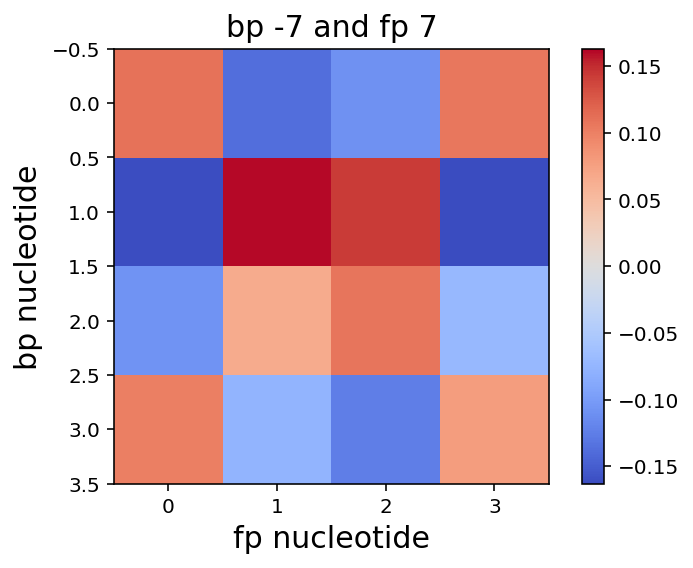

0.00565675880692
['0.26', '0.19', '0.24', '0.30']
['0.22', '0.25', '0.23', '0.28']


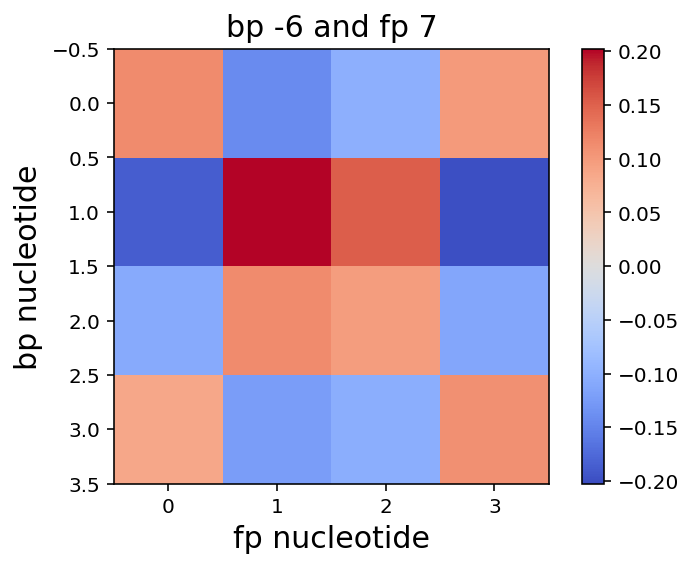

0.00483691602588
['0.23', '0.20', '0.21', '0.34']
['0.22', '0.25', '0.23', '0.28']


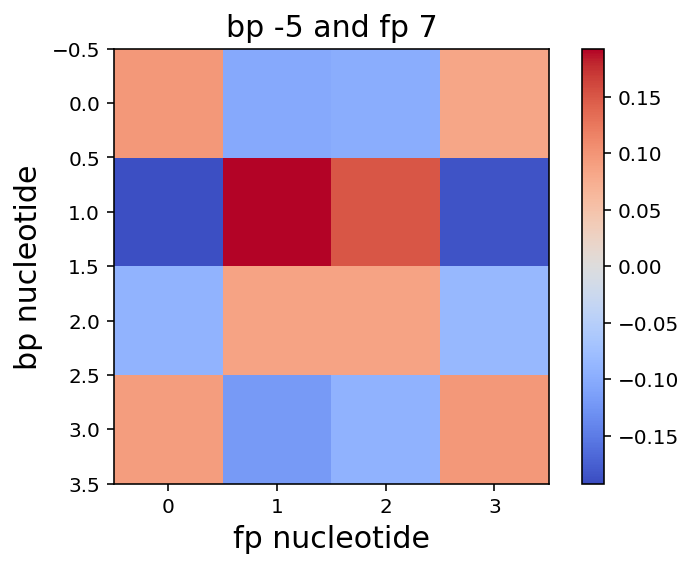

0.00507663120854
['0.27', '0.21', '0.19', '0.30']
['0.22', '0.25', '0.23', '0.28']


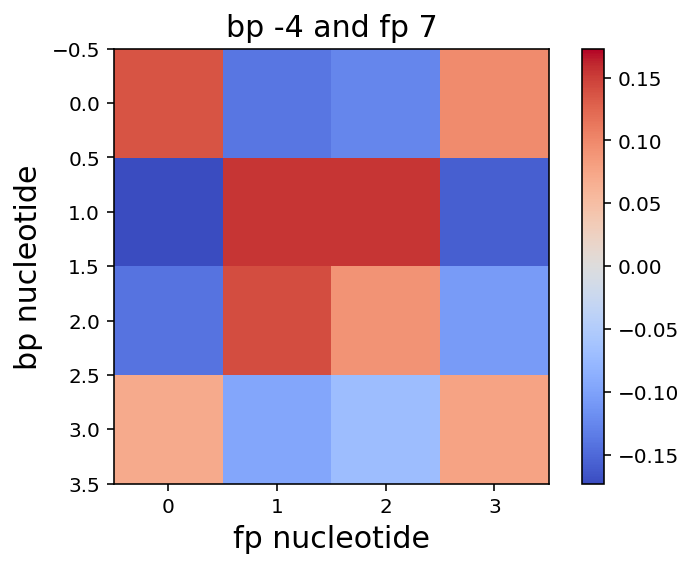

0.00569926999602
['0.09', '0.46', '0.11', '0.33']
['0.22', '0.25', '0.23', '0.28']


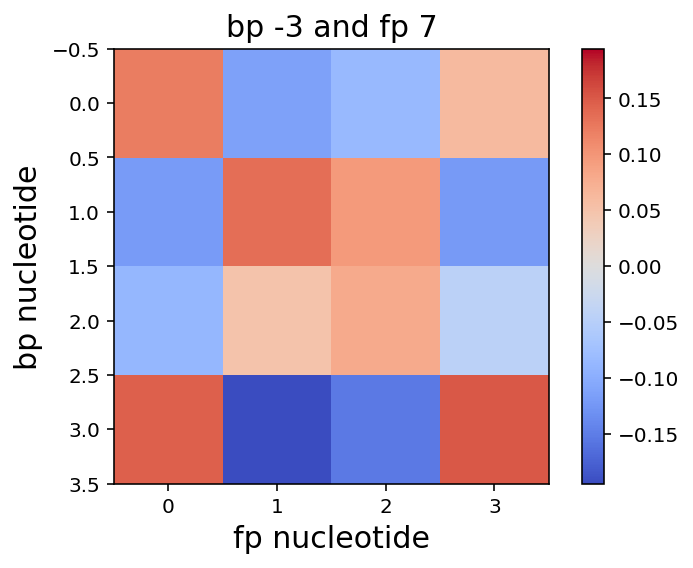

0.00130627442501
['0.06', '0.07', '0.05', '0.81']
['0.22', '0.25', '0.23', '0.28']


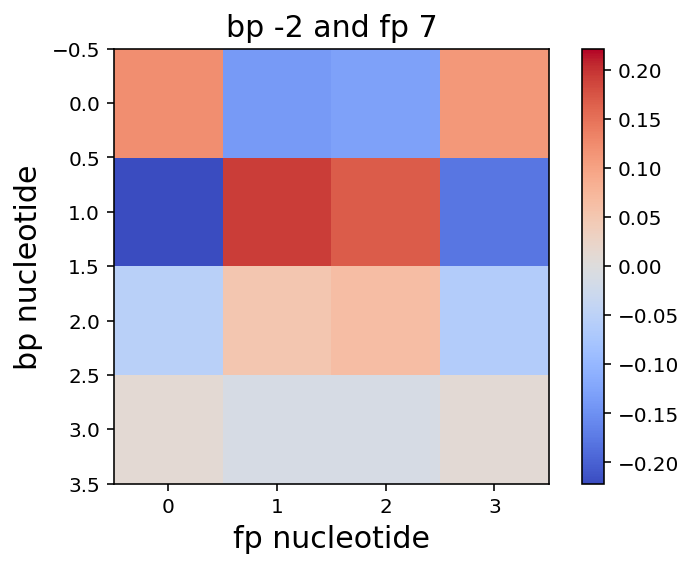

0.00720058210911
['0.24', '0.31', '0.26', '0.17']
['0.22', '0.25', '0.23', '0.28']


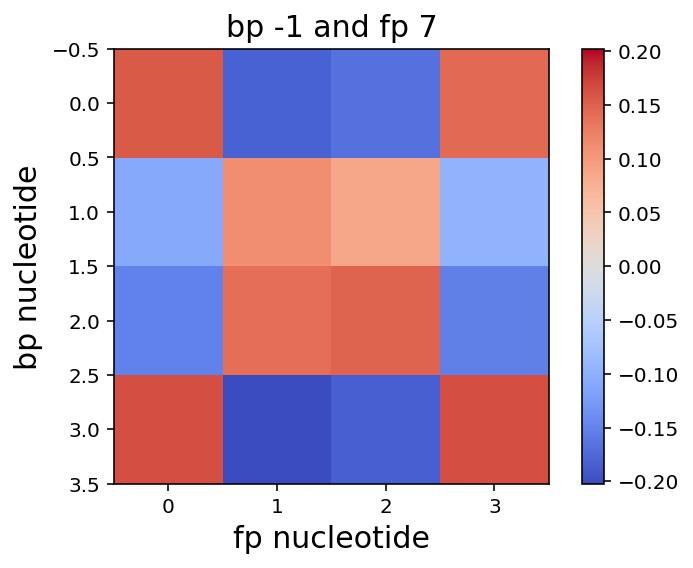

0.000463882653865
['0.98', '0.01', '0.00', '0.00']
['0.22', '0.25', '0.23', '0.28']


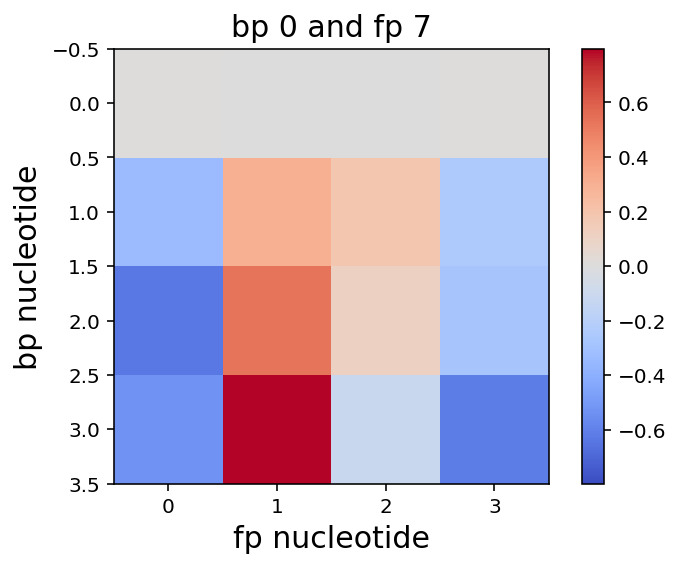

0.00631513851173
['0.18', '0.35', '0.14', '0.31']
['0.22', '0.25', '0.23', '0.28']


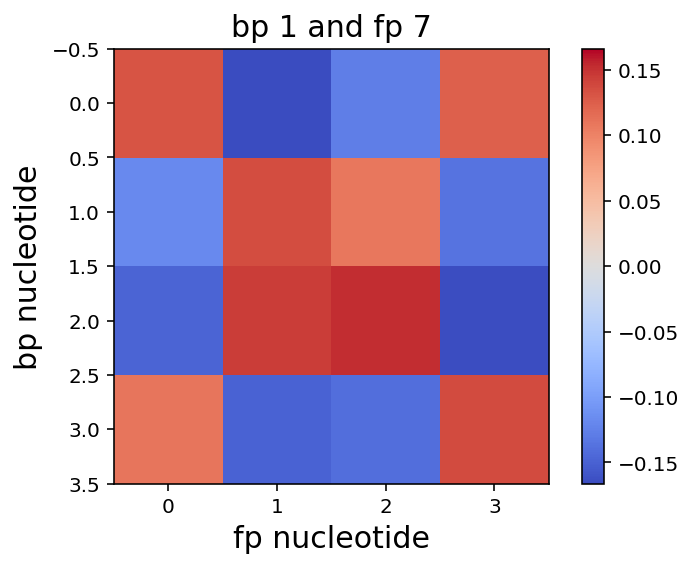

0.00477581468638
['0.23', '0.28', '0.16', '0.31']
['0.22', '0.25', '0.23', '0.28']


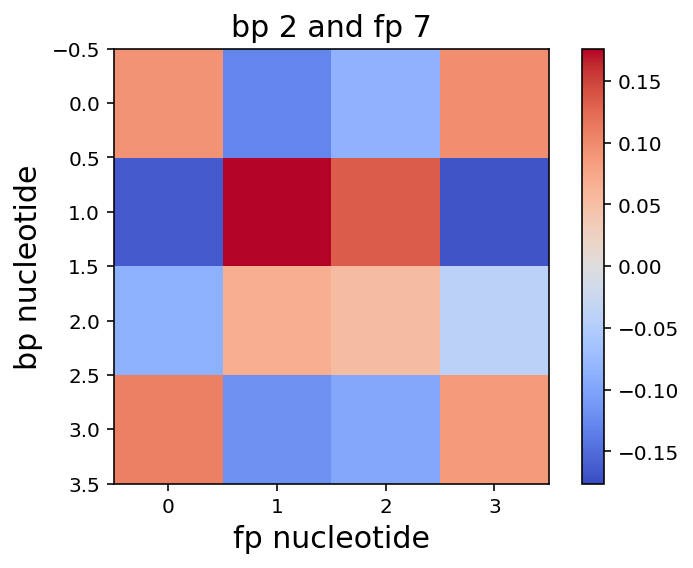

0.00417264560459
['0.22', '0.24', '0.20', '0.32']
['0.22', '0.25', '0.23', '0.28']


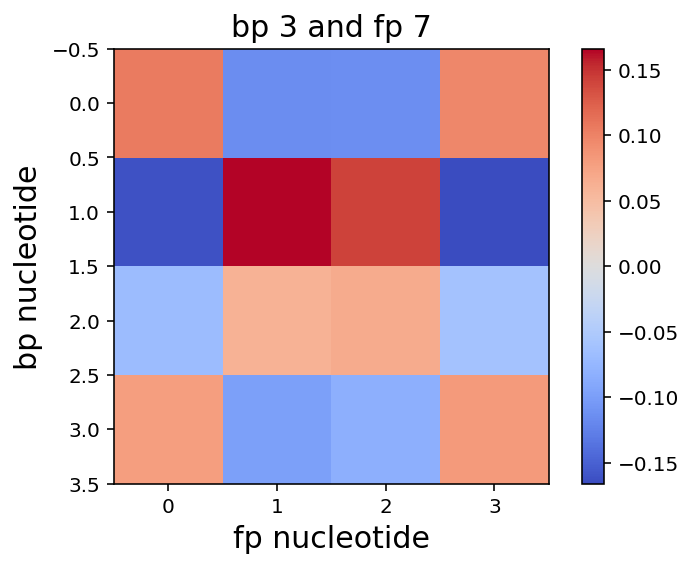

0.00490269865604
['0.20', '0.23', '0.18', '0.36']
['0.22', '0.25', '0.23', '0.28']


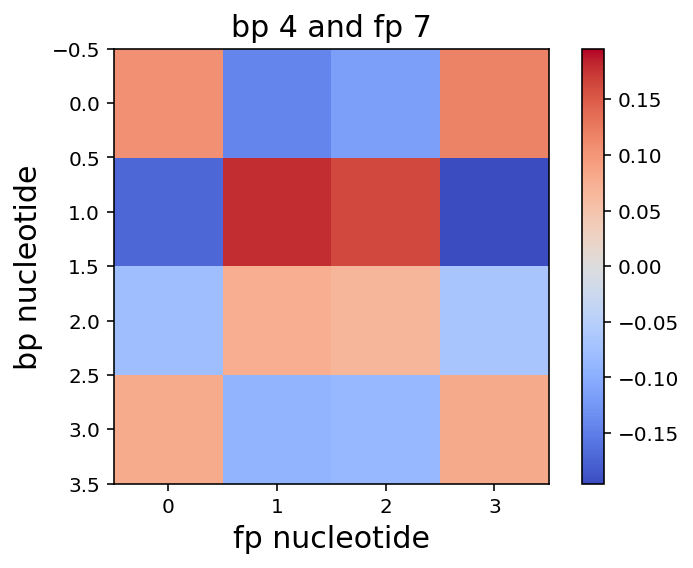

0.00467901966676
['0.19', '0.24', '0.19', '0.36']
['0.22', '0.25', '0.23', '0.28']


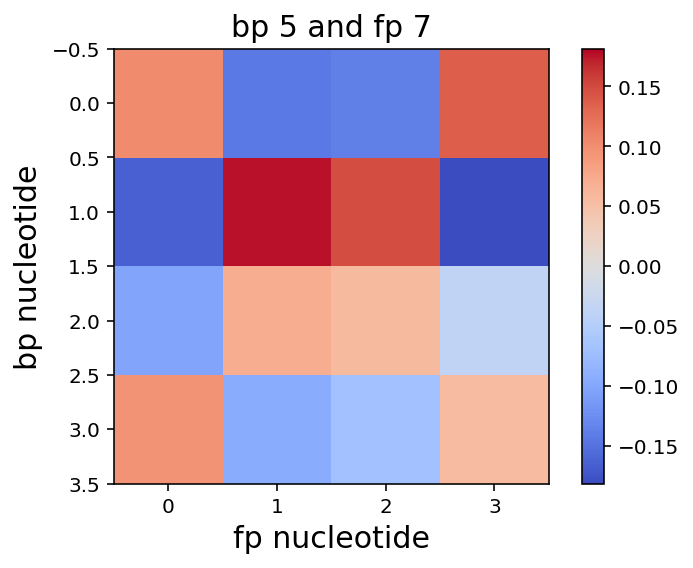

0.00464385559631
['0.18', '0.24', '0.18', '0.39']
['0.22', '0.25', '0.23', '0.28']


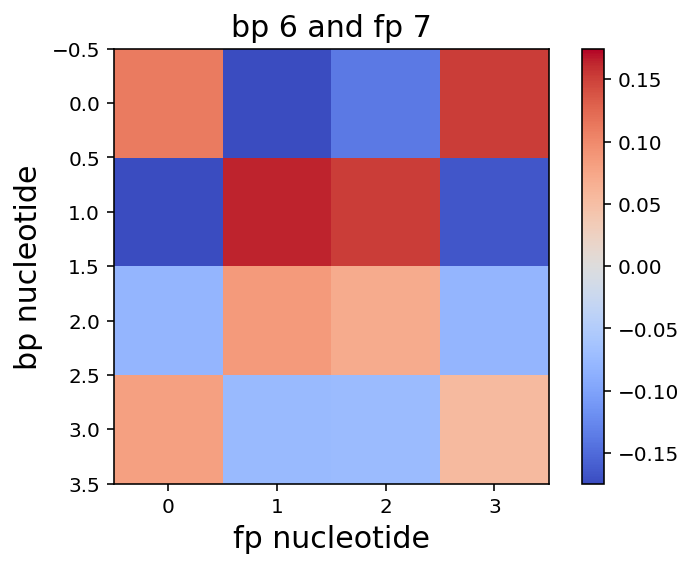

0.00539883956578
['0.15', '0.26', '0.15', '0.42']
['0.22', '0.25', '0.23', '0.28']


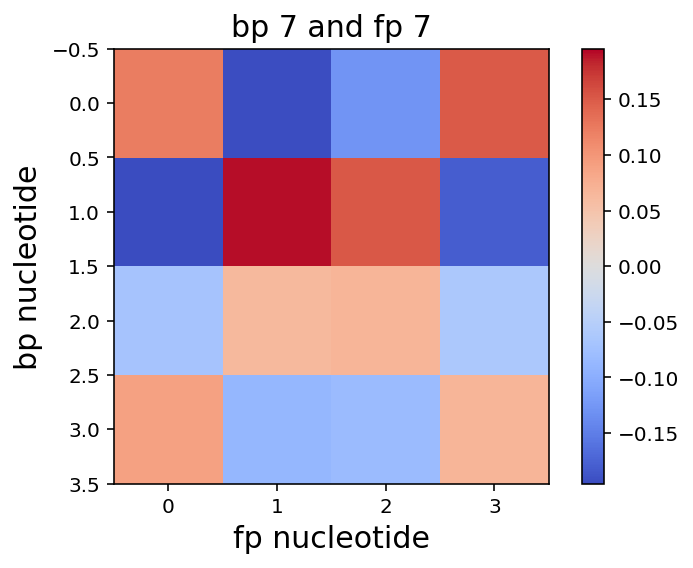

0.00535024035123
['0.13', '0.27', '0.12', '0.45']
['0.22', '0.25', '0.23', '0.28']


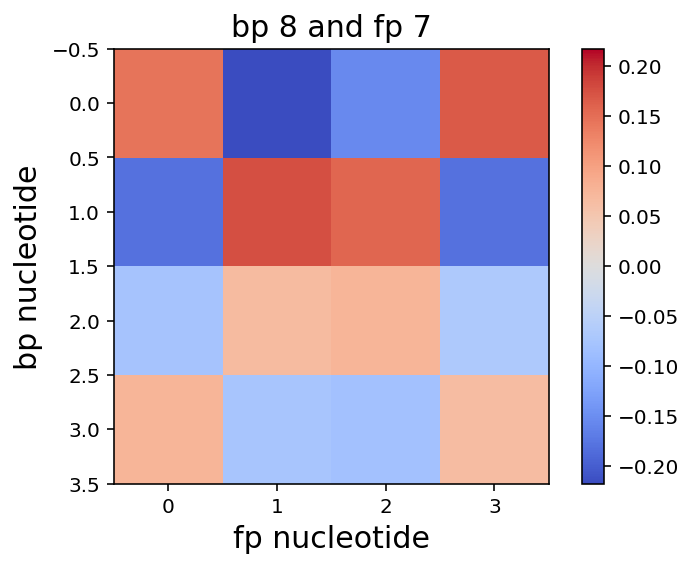

0.0046314433615
['0.12', '0.27', '0.11', '0.49']
['0.22', '0.25', '0.23', '0.28']


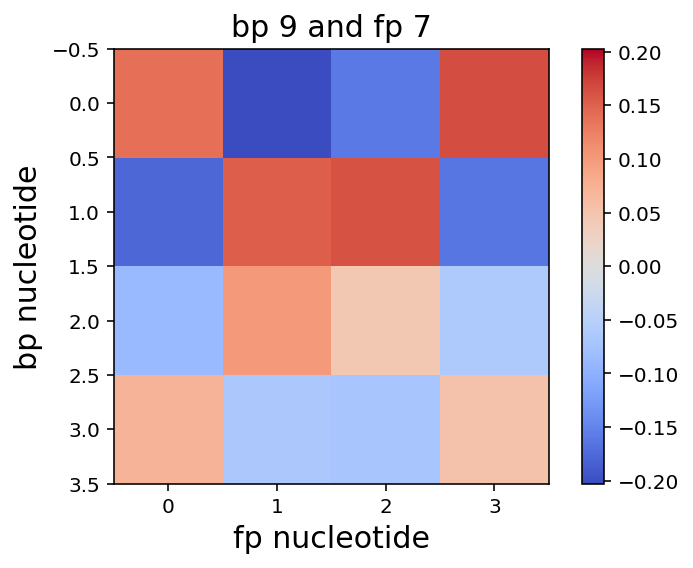

0.00483554106694
['0.11', '0.27', '0.11', '0.50']
['0.22', '0.25', '0.23', '0.28']


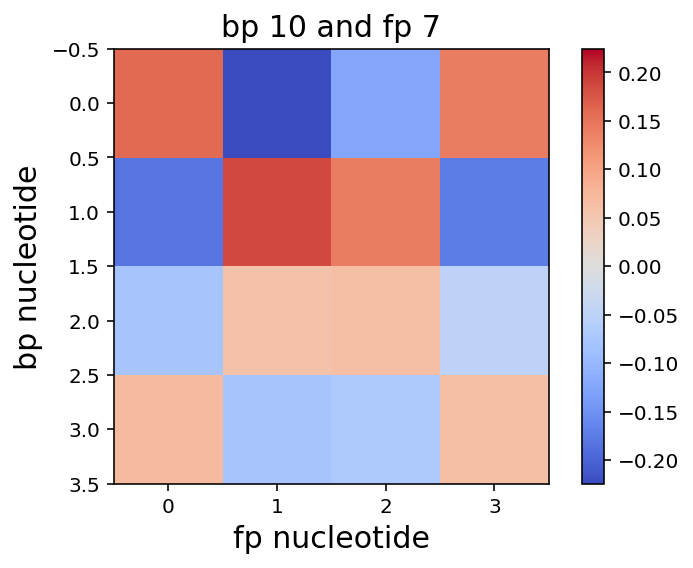

0.00478931759934
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.25', '0.23', '0.28']


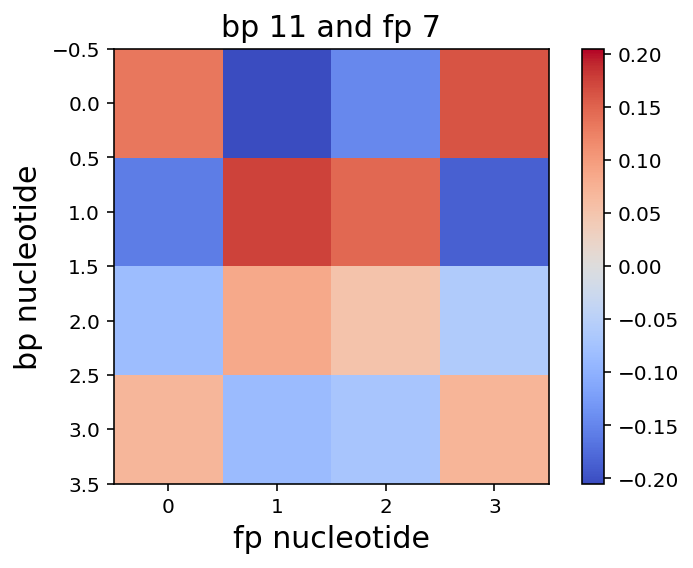

0.00411876936804
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.25', '0.23', '0.28']


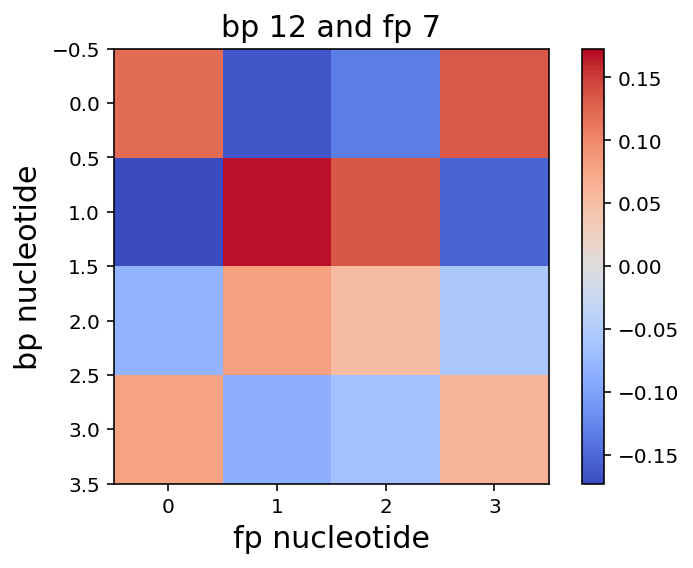

0.00473099484193
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.25', '0.23', '0.28']


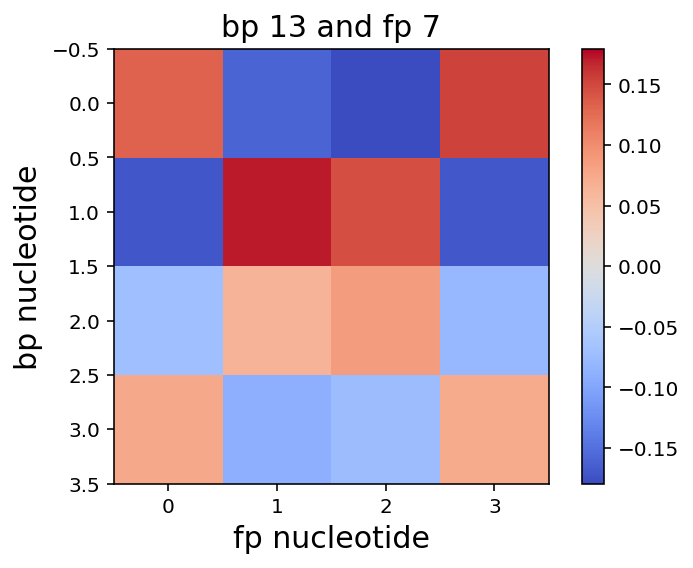

0.00421809418865
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.25', '0.23', '0.28']


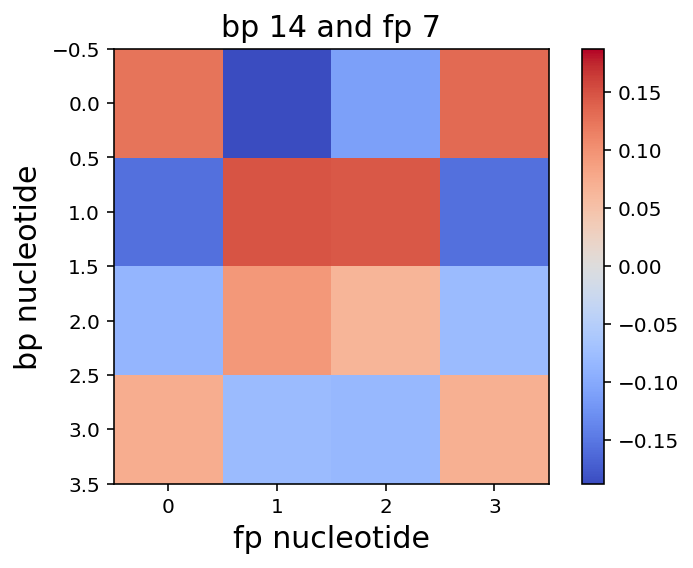

0.00509050388419
['0.24', '0.22', '0.22', '0.30']
['0.22', '0.26', '0.24', '0.27']


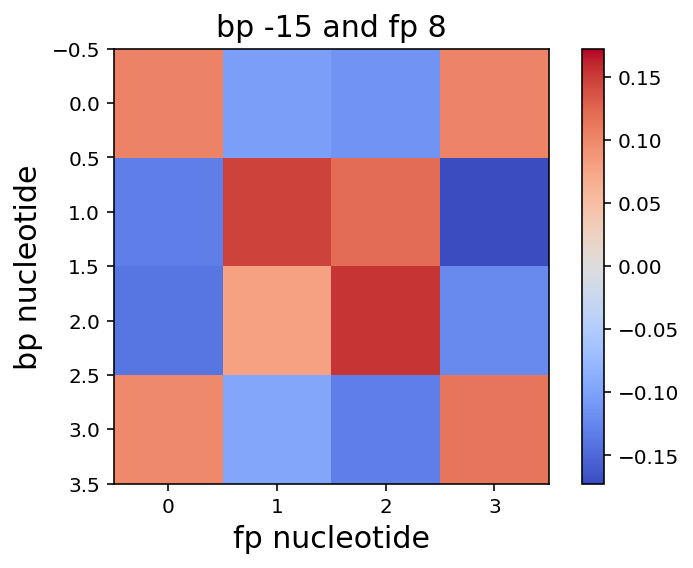

0.00434452196979
['0.25', '0.21', '0.23', '0.30']
['0.22', '0.26', '0.24', '0.27']


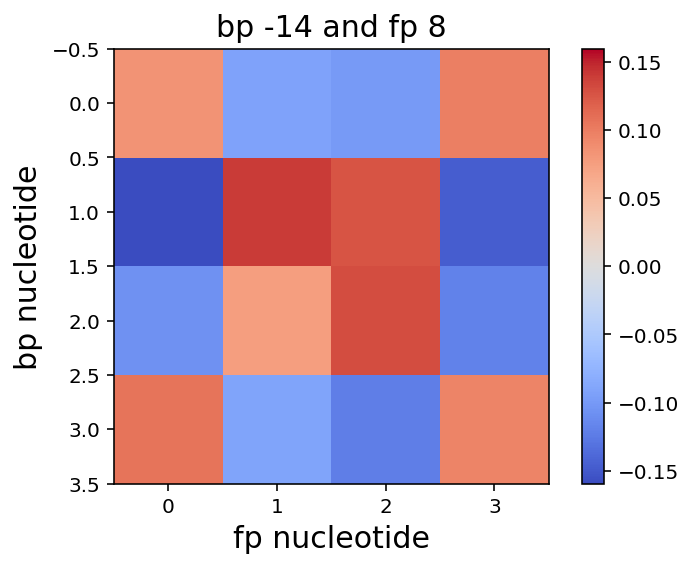

0.0052751411157
['0.25', '0.19', '0.24', '0.29']
['0.22', '0.26', '0.24', '0.27']


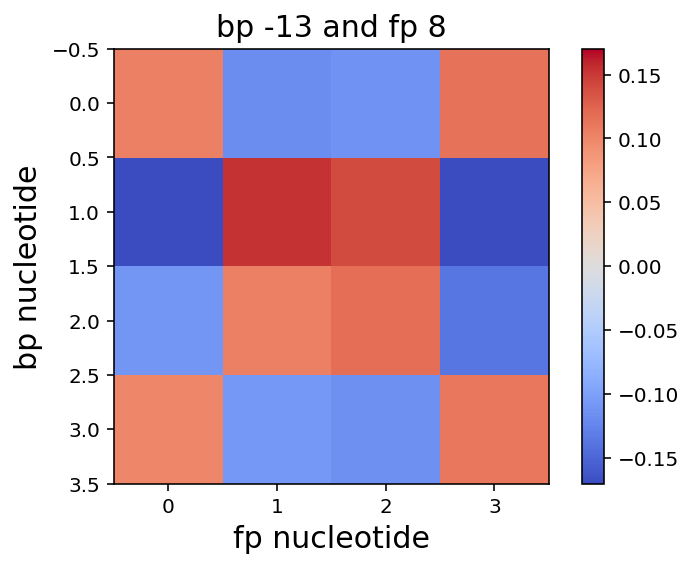

0.00432610375892
['0.26', '0.20', '0.25', '0.28']
['0.22', '0.26', '0.24', '0.27']


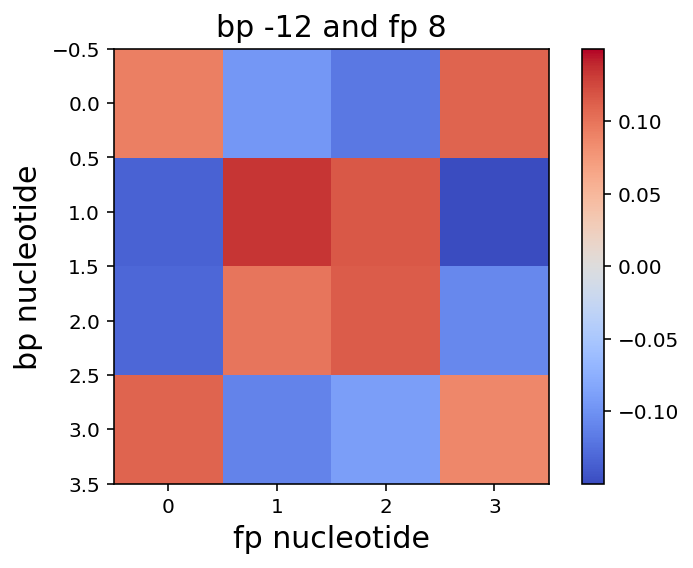

0.00439870814264
['0.25', '0.23', '0.23', '0.27']
['0.22', '0.26', '0.24', '0.27']


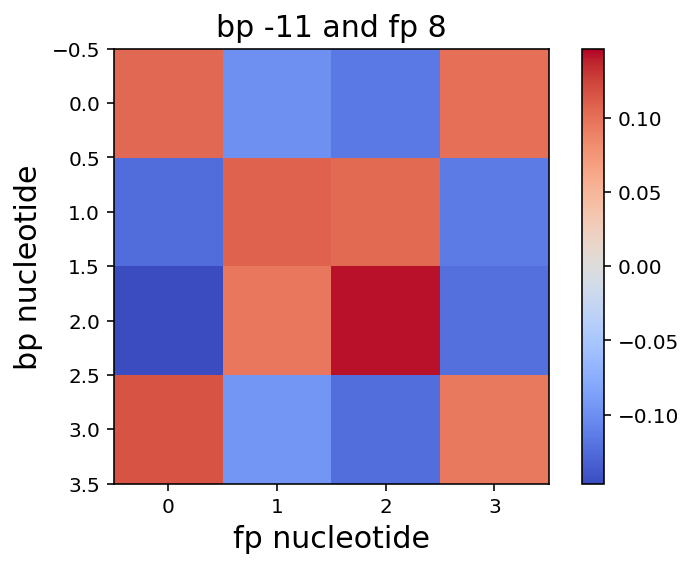

0.00493957880187
['0.24', '0.27', '0.21', '0.26']
['0.22', '0.26', '0.24', '0.27']


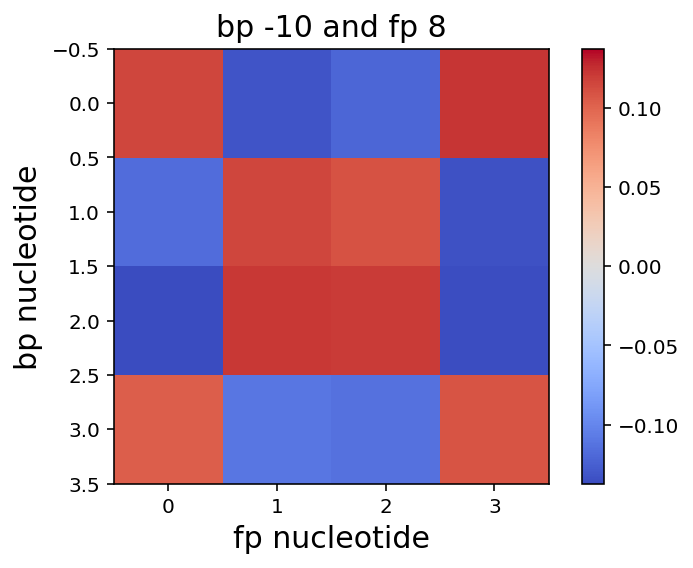

0.00446579064205
['0.24', '0.27', '0.19', '0.27']
['0.22', '0.26', '0.24', '0.27']


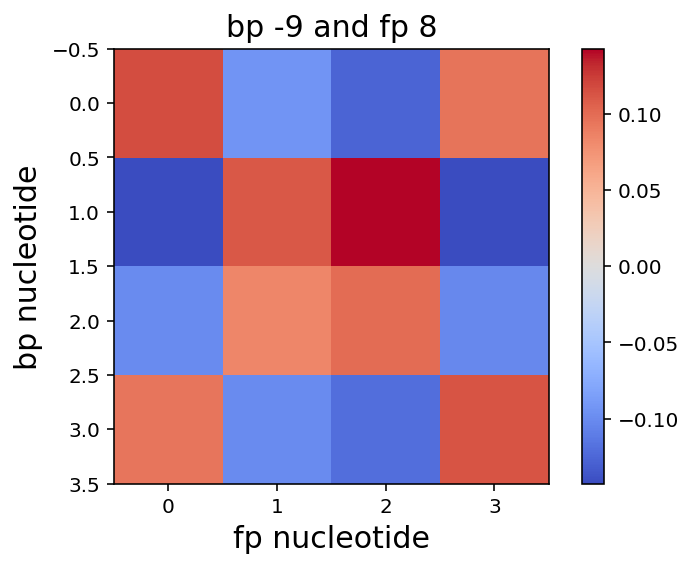

0.00523703659091
['0.25', '0.25', '0.20', '0.28']
['0.22', '0.26', '0.24', '0.27']


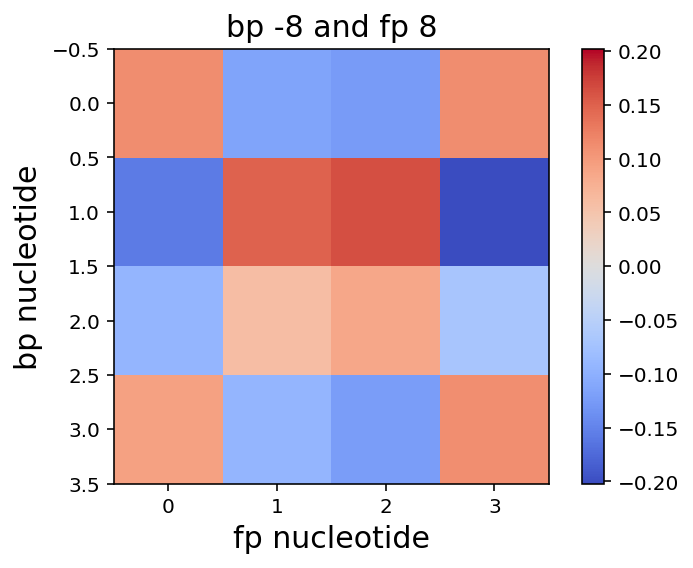

0.00533422556623
['0.25', '0.22', '0.23', '0.28']
['0.22', '0.26', '0.24', '0.27']


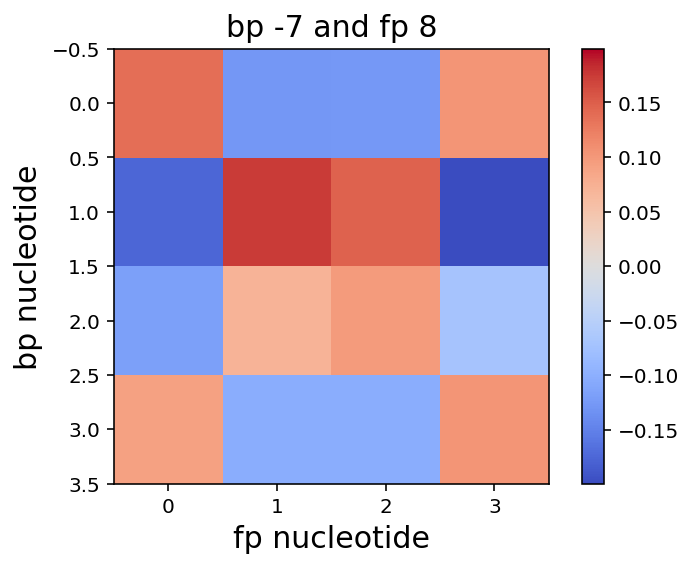

0.00555991507159
['0.26', '0.19', '0.24', '0.30']
['0.22', '0.26', '0.24', '0.27']


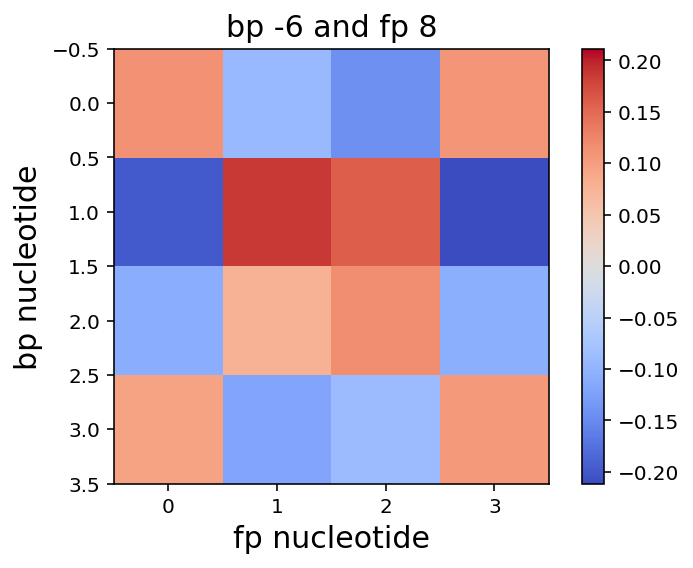

0.00558088960417
['0.23', '0.20', '0.21', '0.34']
['0.22', '0.26', '0.24', '0.27']


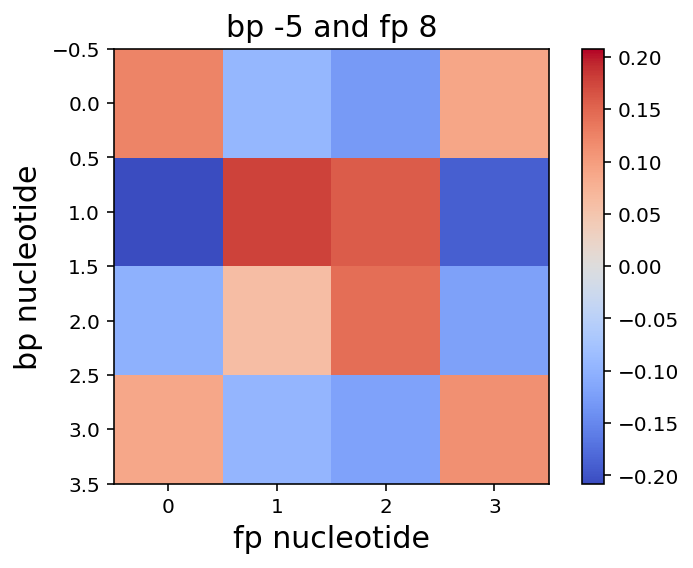

0.00557377246963
['0.27', '0.21', '0.19', '0.30']
['0.22', '0.26', '0.24', '0.27']


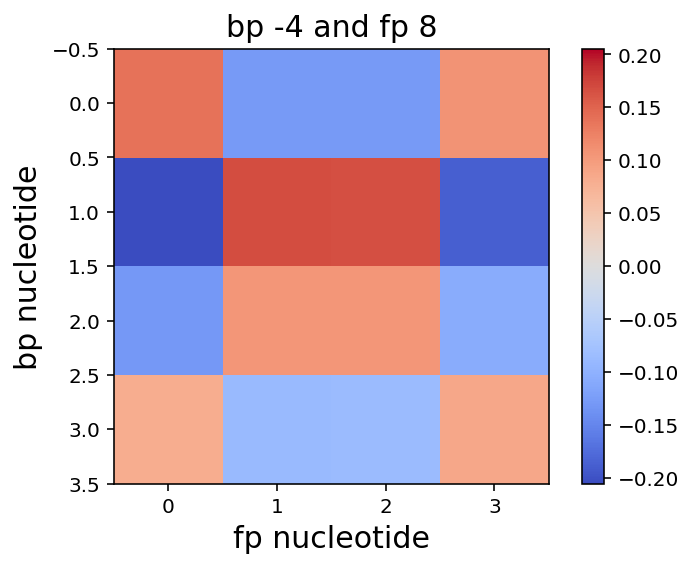

0.00649938737663
['0.09', '0.46', '0.11', '0.33']
['0.22', '0.26', '0.24', '0.27']


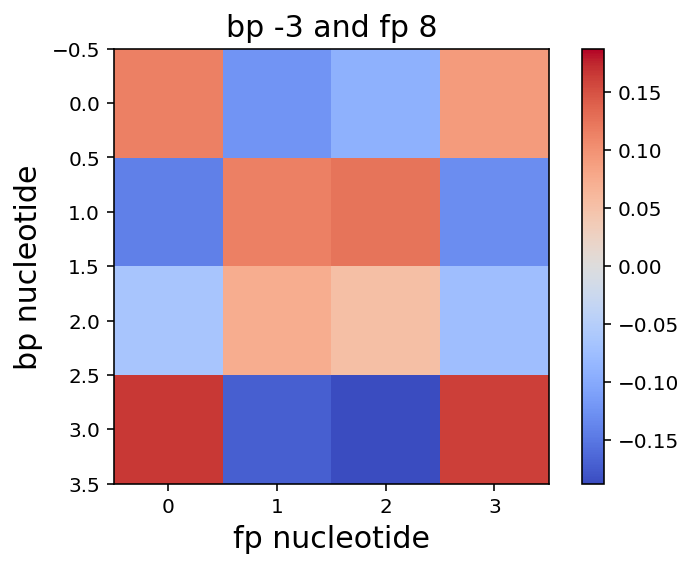

0.00183376069471
['0.06', '0.07', '0.05', '0.81']
['0.22', '0.26', '0.24', '0.27']


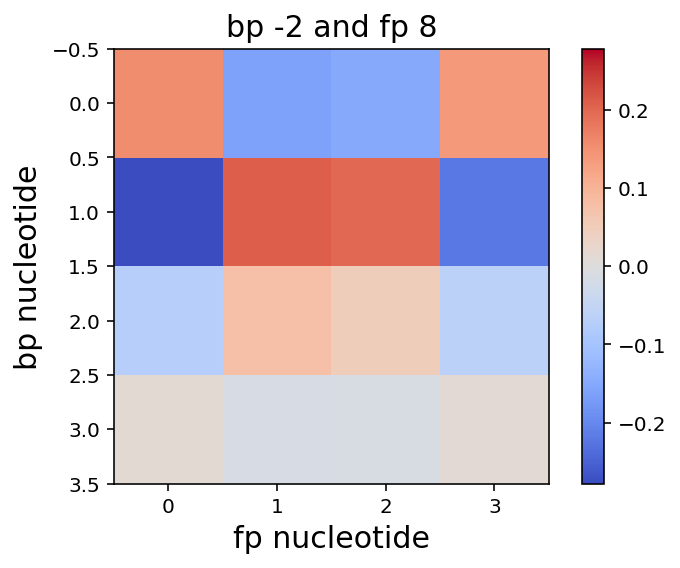

0.00728410716476
['0.24', '0.31', '0.26', '0.17']
['0.22', '0.26', '0.24', '0.27']


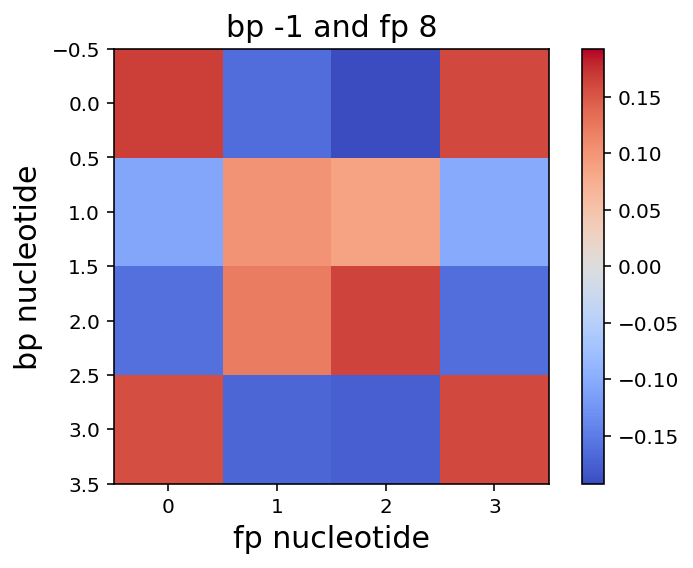

0.000662676422682
['0.98', '0.01', '0.00', '0.00']
['0.22', '0.26', '0.24', '0.27']


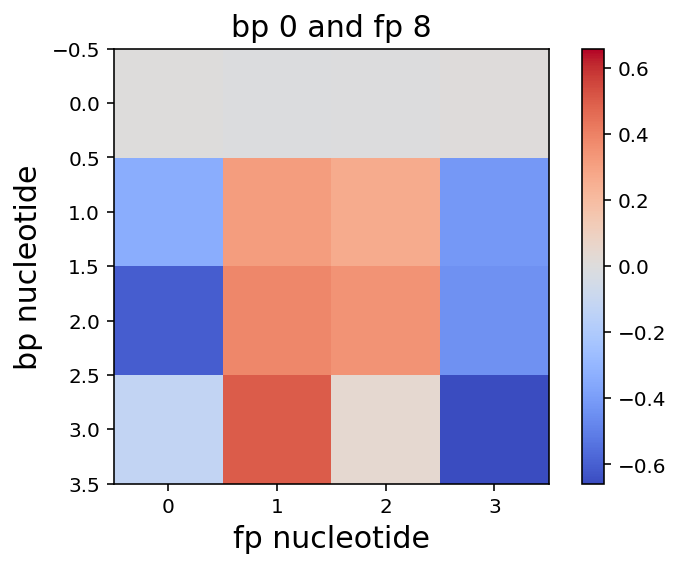

0.00577391522974
['0.18', '0.35', '0.14', '0.31']
['0.22', '0.26', '0.24', '0.27']


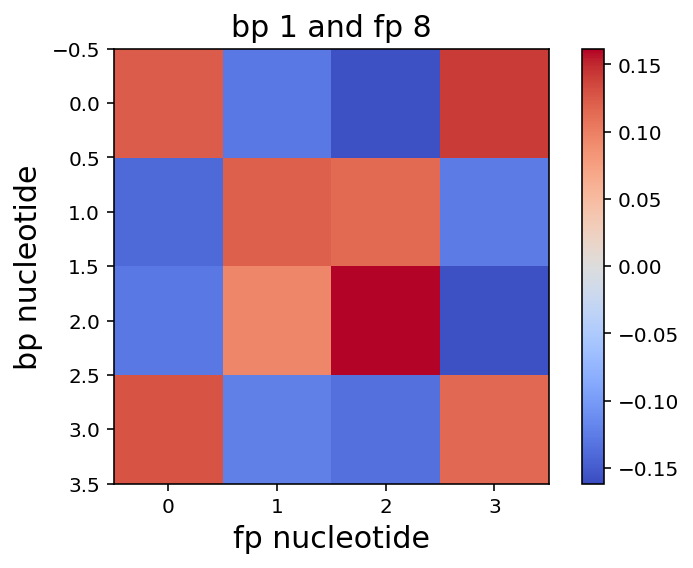

0.00481161280768
['0.23', '0.28', '0.16', '0.31']
['0.22', '0.26', '0.24', '0.27']


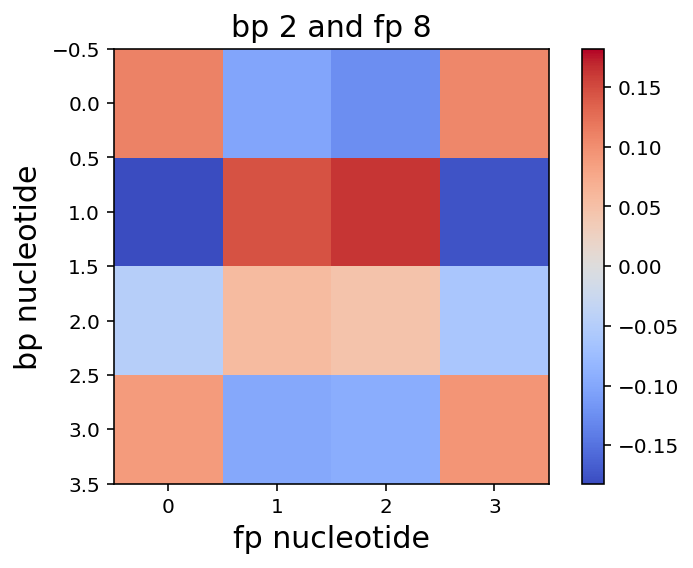

0.00493711189817
['0.22', '0.24', '0.20', '0.32']
['0.22', '0.26', '0.24', '0.27']


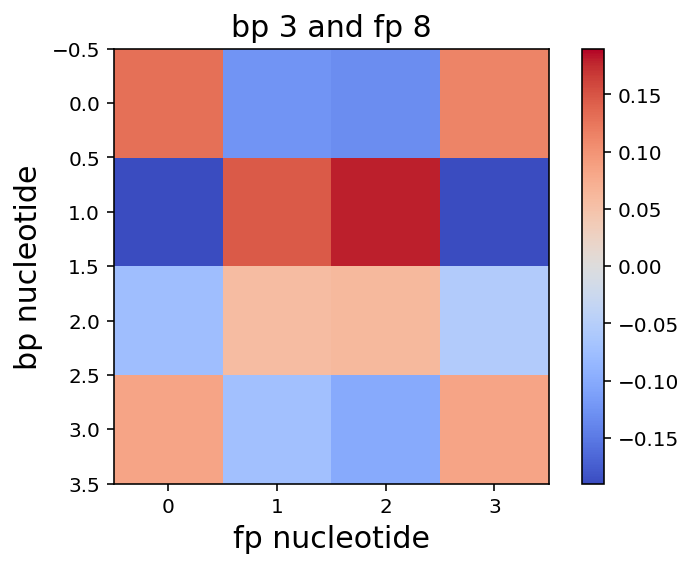

0.00539807655442
['0.20', '0.23', '0.18', '0.36']
['0.22', '0.26', '0.24', '0.27']


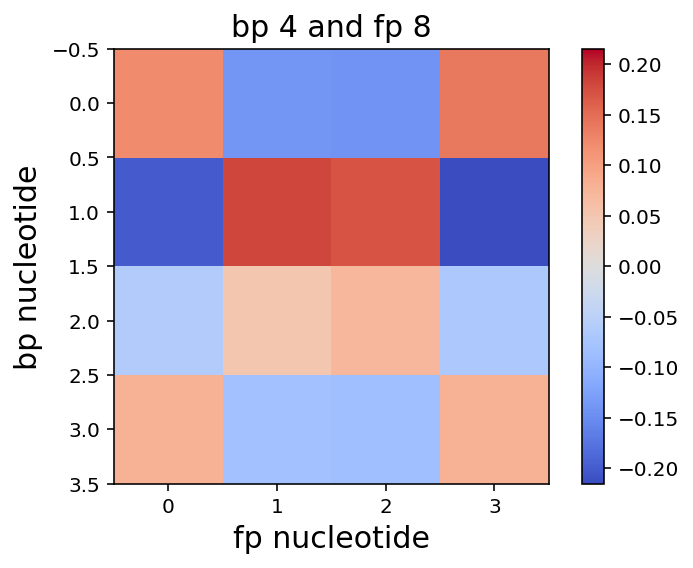

0.00496928772558
['0.19', '0.24', '0.19', '0.36']
['0.22', '0.26', '0.24', '0.27']


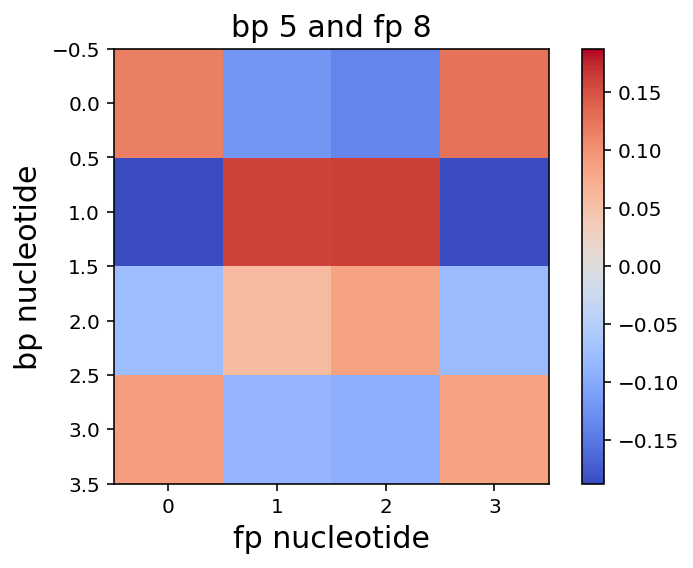

0.00474458505147
['0.18', '0.24', '0.18', '0.39']
['0.22', '0.26', '0.24', '0.27']


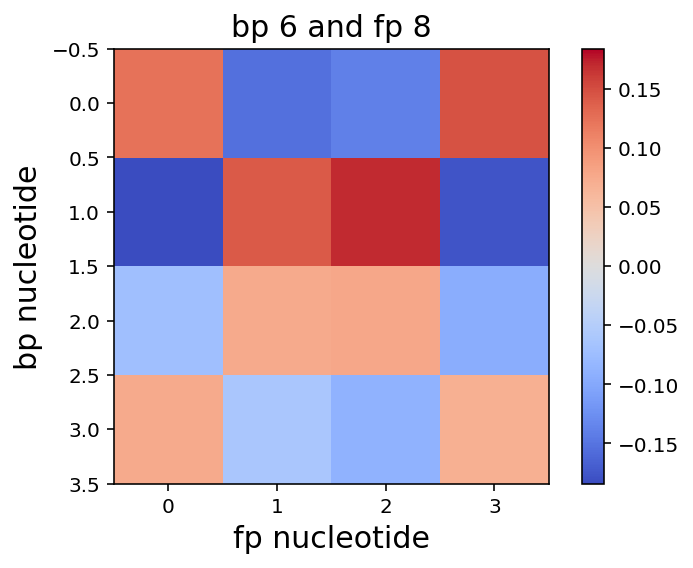

0.00512385869911
['0.15', '0.26', '0.15', '0.42']
['0.22', '0.26', '0.24', '0.27']


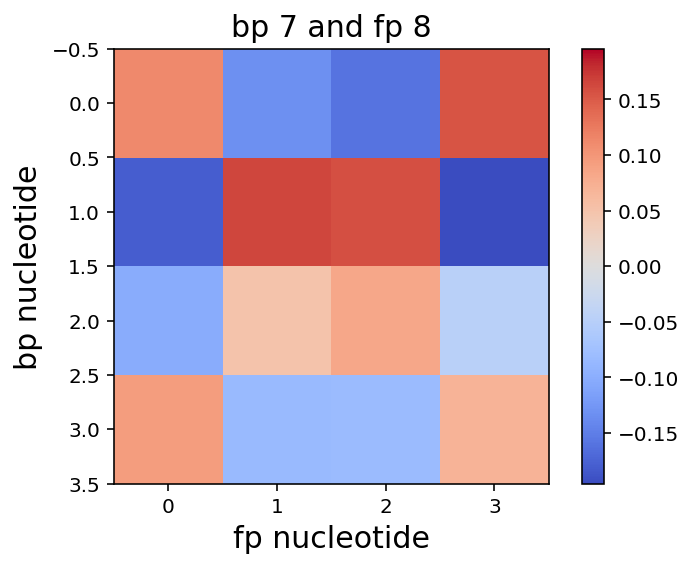

0.0054813682921
['0.13', '0.27', '0.12', '0.45']
['0.22', '0.26', '0.24', '0.27']


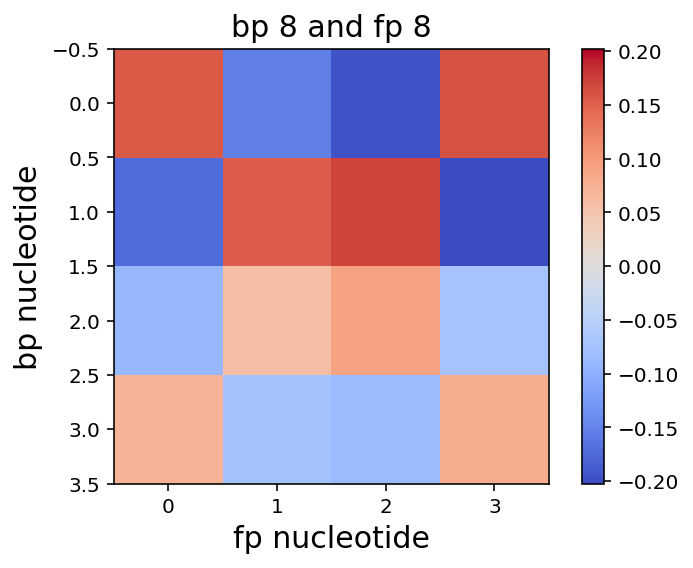

0.00537990682769
['0.12', '0.27', '0.11', '0.49']
['0.22', '0.26', '0.24', '0.27']


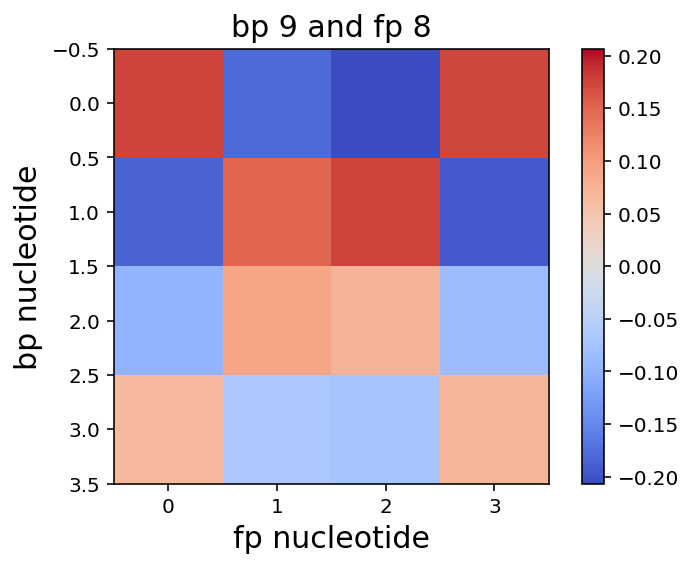

0.00446581194872
['0.11', '0.27', '0.11', '0.50']
['0.22', '0.26', '0.24', '0.27']


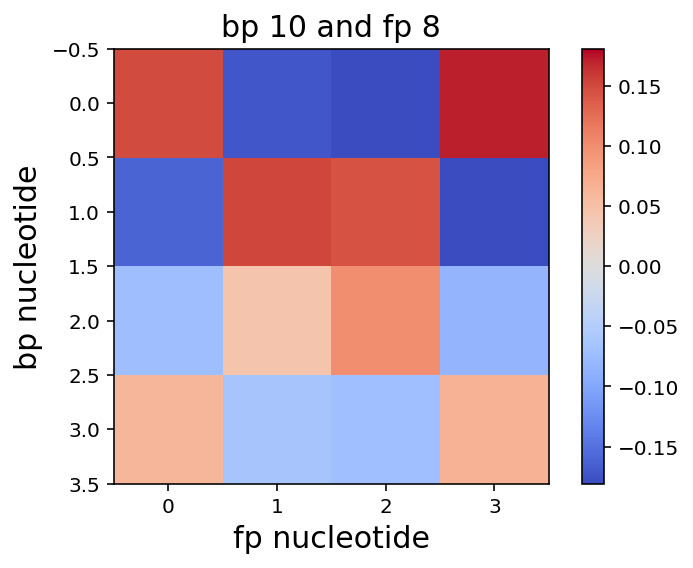

0.00492125748767
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.26', '0.24', '0.27']


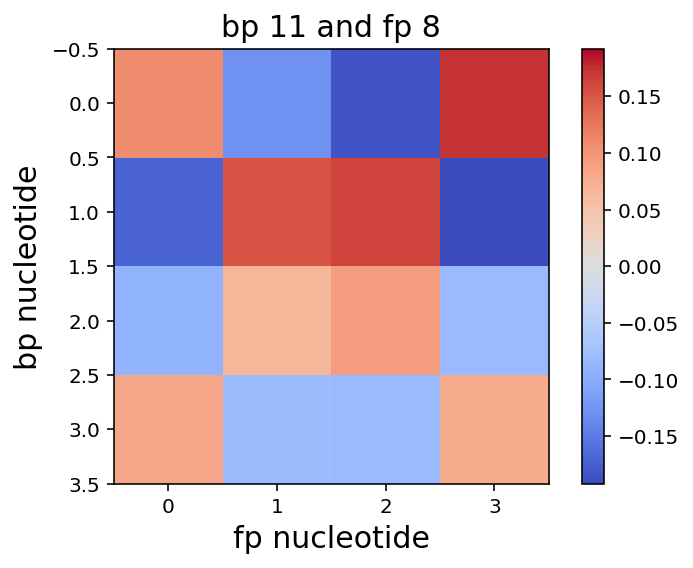

0.00413551943414
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.26', '0.24', '0.27']


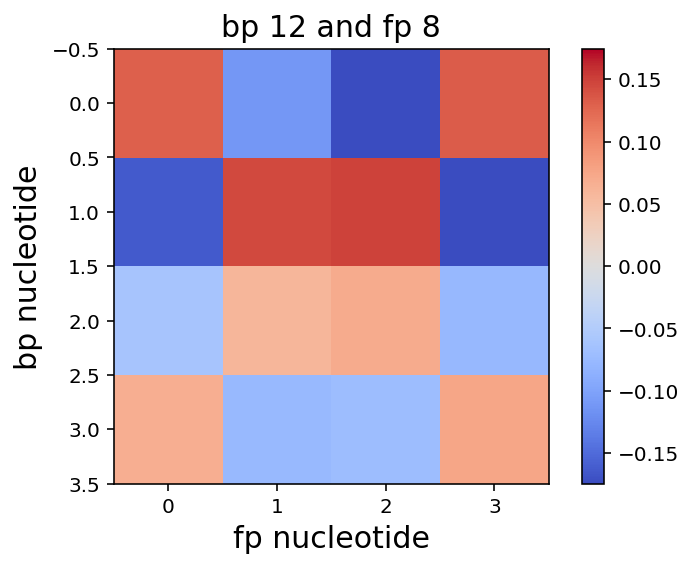

0.00451429664136
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.26', '0.24', '0.27']


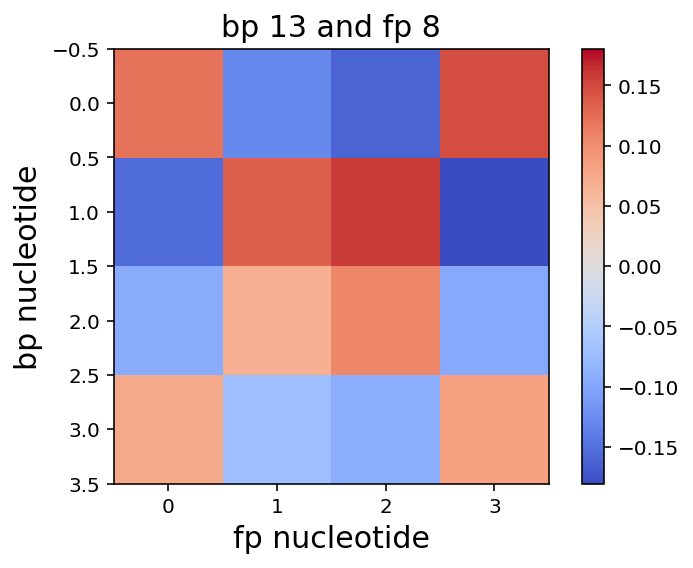

0.00558572629303
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.26', '0.24', '0.27']


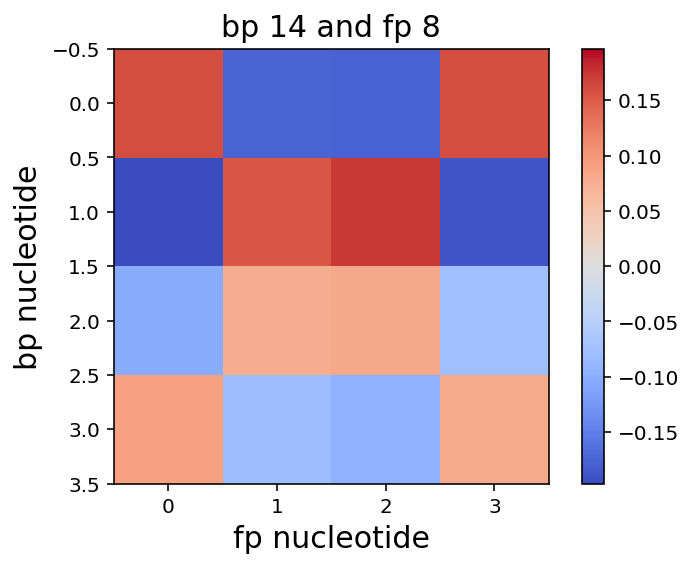

0.00555123534373
['0.24', '0.22', '0.22', '0.30']
['0.22', '0.24', '0.25', '0.27']


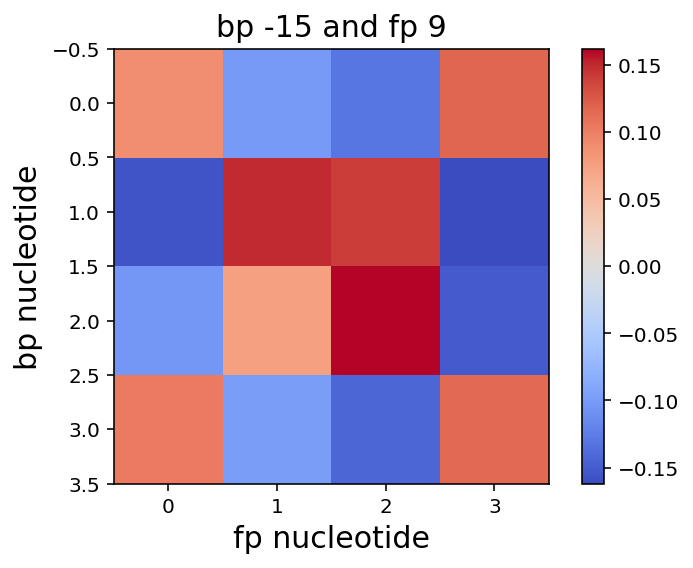

0.0051326666017
['0.25', '0.21', '0.23', '0.30']
['0.22', '0.24', '0.25', '0.27']


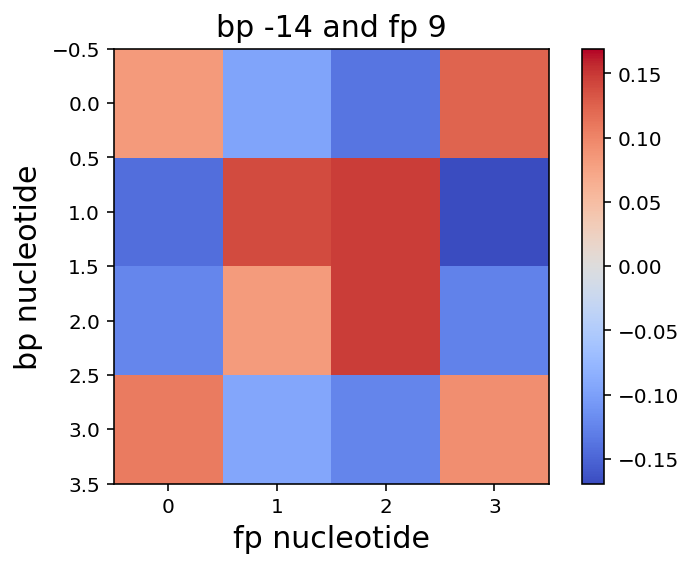

0.00489444033347
['0.25', '0.19', '0.24', '0.29']
['0.22', '0.24', '0.25', '0.27']


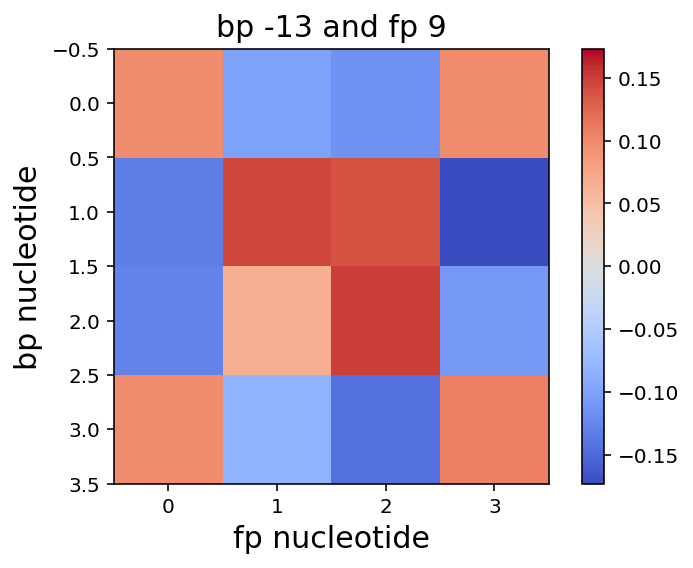

0.00484911813711
['0.26', '0.20', '0.25', '0.28']
['0.22', '0.24', '0.25', '0.27']


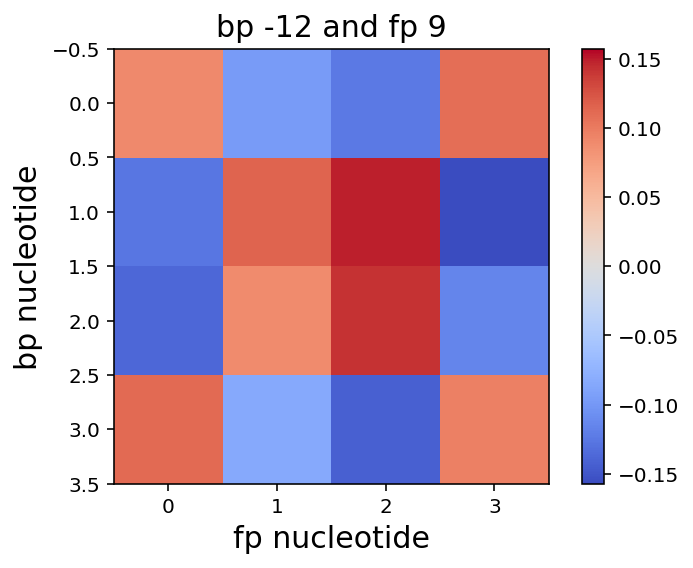

0.00457953490361
['0.25', '0.23', '0.23', '0.27']
['0.22', '0.24', '0.25', '0.27']


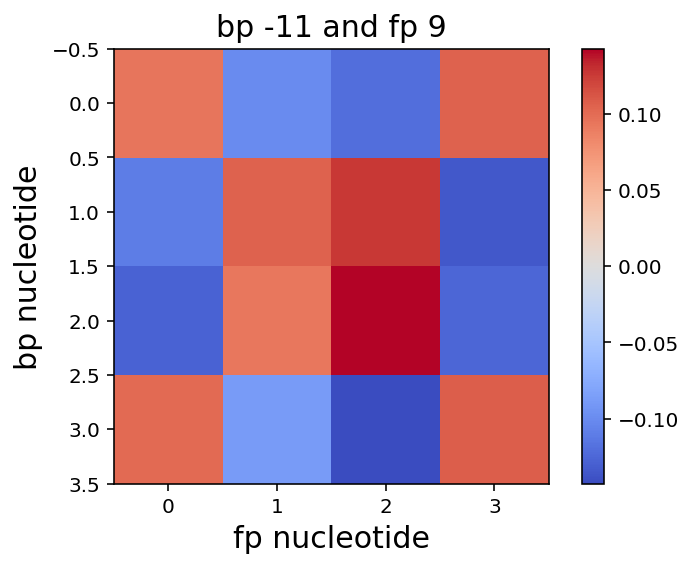

0.0046415968908
['0.24', '0.27', '0.21', '0.26']
['0.22', '0.24', '0.25', '0.27']


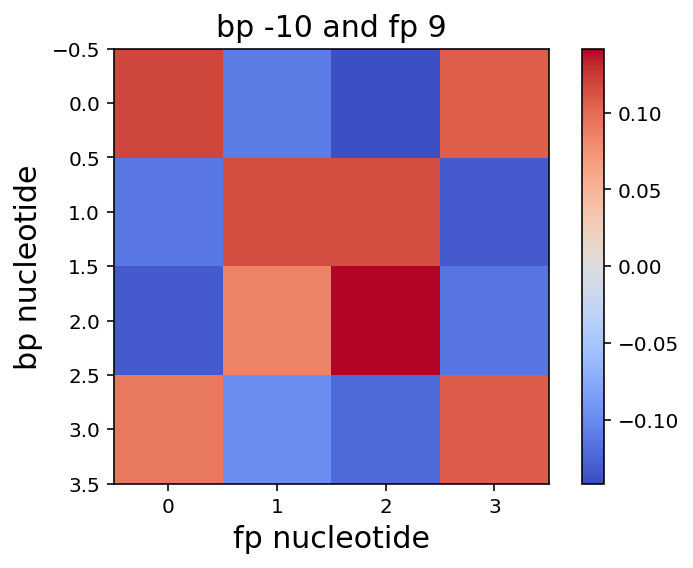

0.00470935736572
['0.24', '0.27', '0.19', '0.27']
['0.22', '0.24', '0.25', '0.27']


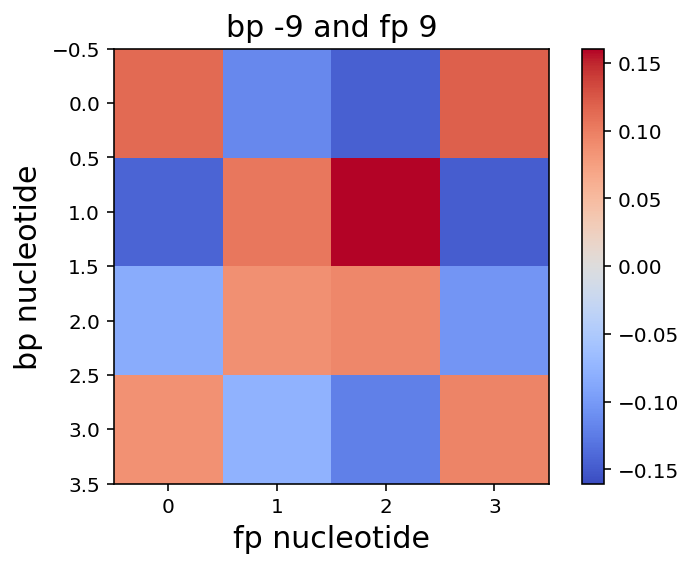

0.00519554001995
['0.25', '0.25', '0.20', '0.28']
['0.22', '0.24', '0.25', '0.27']


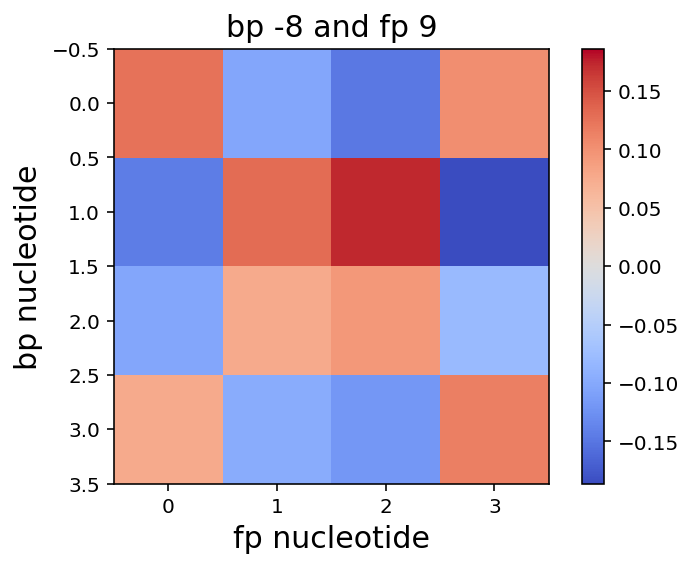

0.00484830199732
['0.25', '0.22', '0.23', '0.28']
['0.22', '0.24', '0.25', '0.27']


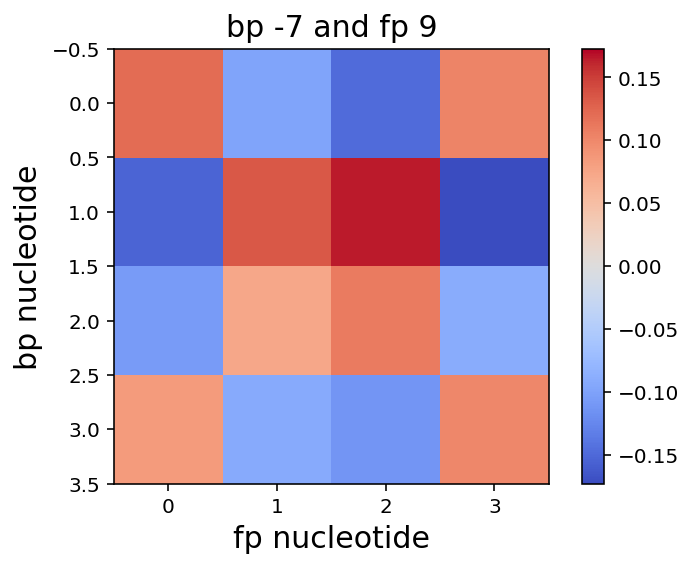

0.00588685523964
['0.26', '0.19', '0.24', '0.30']
['0.22', '0.24', '0.25', '0.27']


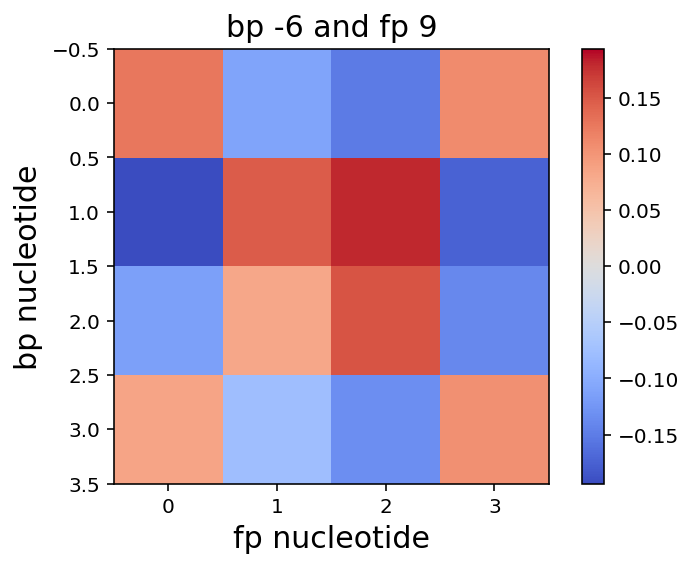

0.00541787807666
['0.23', '0.20', '0.21', '0.34']
['0.22', '0.24', '0.25', '0.27']


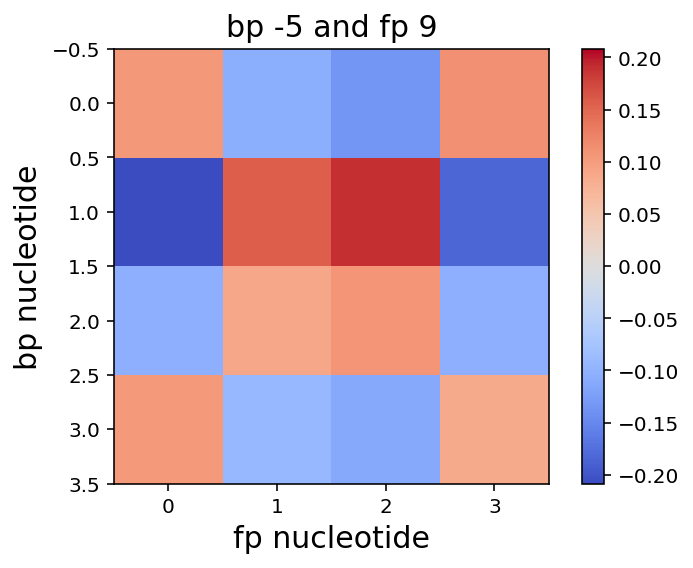

0.00543513169284
['0.27', '0.21', '0.19', '0.30']
['0.22', '0.24', '0.25', '0.27']


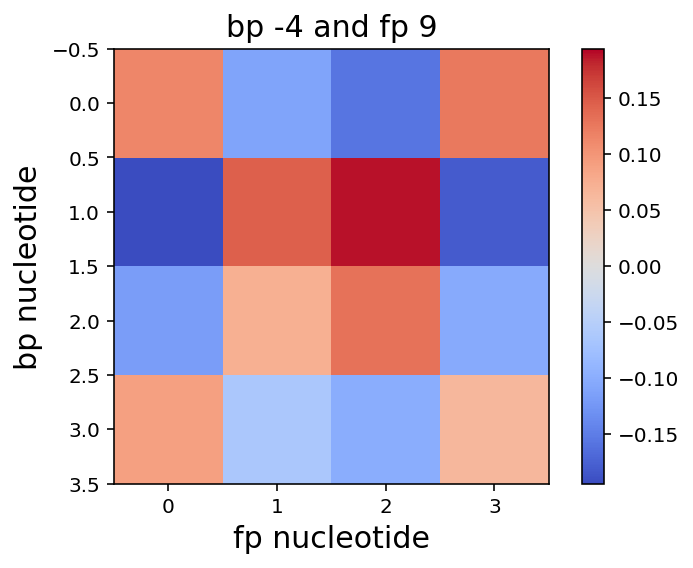

0.0060852418529
['0.09', '0.46', '0.11', '0.33']
['0.22', '0.24', '0.25', '0.27']


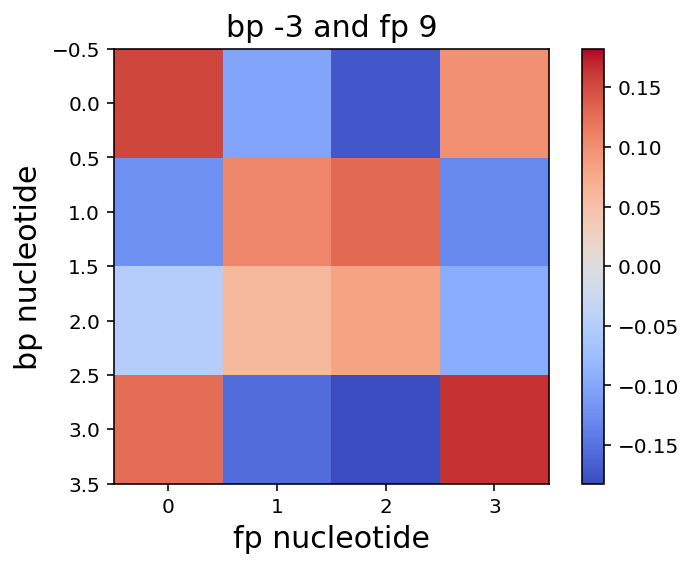

0.00148227512029
['0.06', '0.07', '0.05', '0.81']
['0.22', '0.24', '0.25', '0.27']


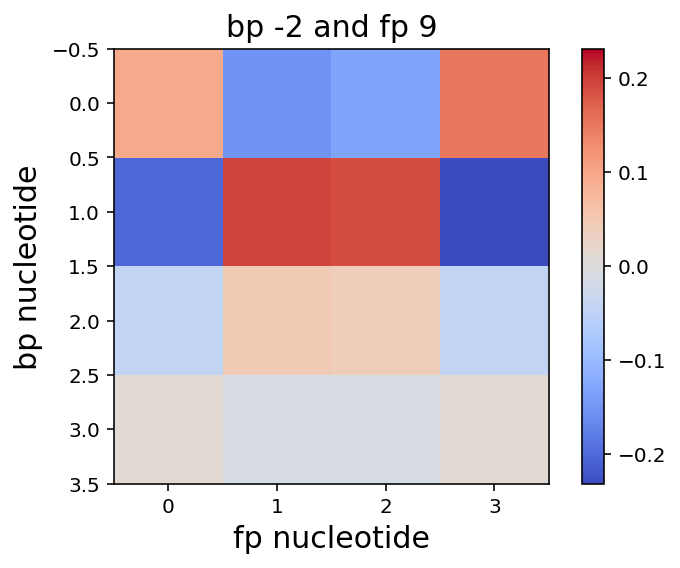

0.00834634701508
['0.24', '0.31', '0.26', '0.17']
['0.22', '0.24', '0.25', '0.27']


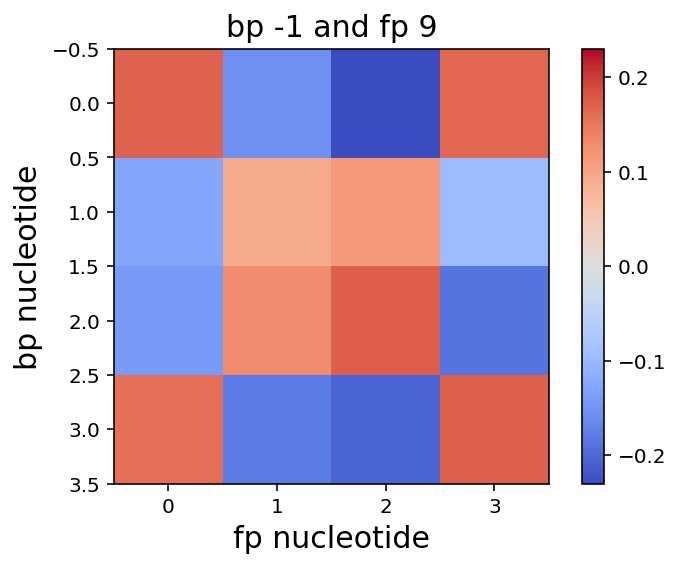

0.00058001897115
['0.98', '0.01', '0.00', '0.00']
['0.22', '0.24', '0.25', '0.27']


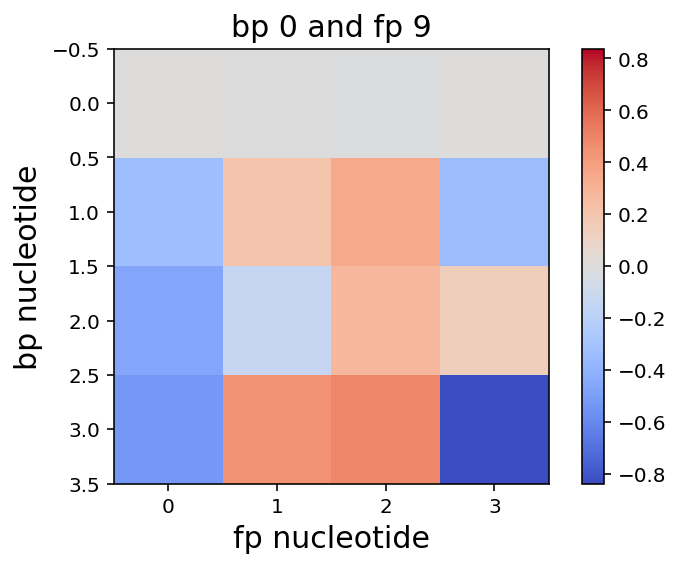

0.00731053821943
['0.18', '0.35', '0.14', '0.31']
['0.22', '0.24', '0.25', '0.27']


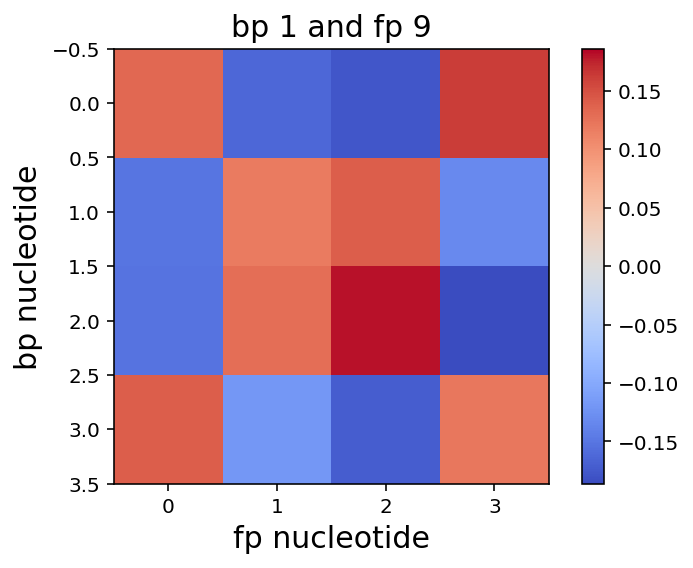

0.005383438589
['0.23', '0.28', '0.16', '0.31']
['0.22', '0.24', '0.25', '0.27']


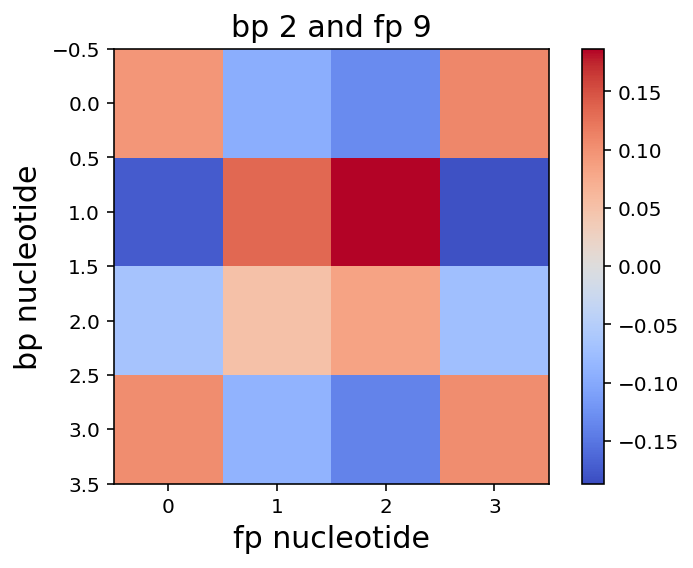

0.00445487150007
['0.22', '0.24', '0.20', '0.32']
['0.22', '0.24', '0.25', '0.27']


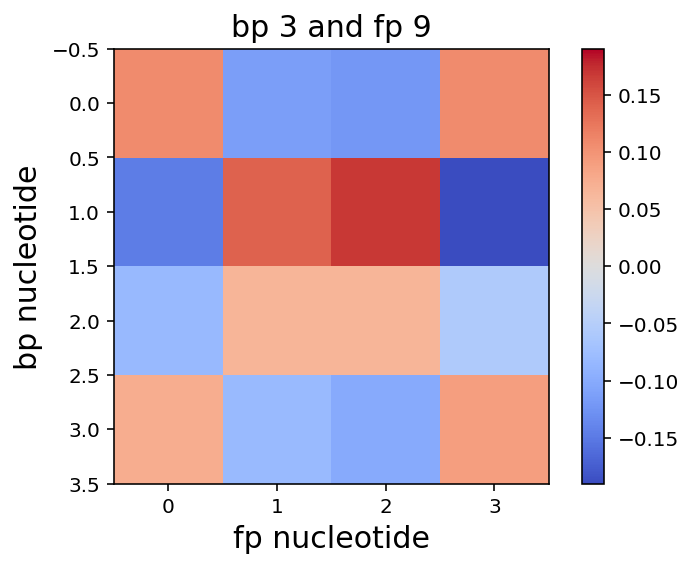

0.00553411131106
['0.20', '0.23', '0.18', '0.36']
['0.22', '0.24', '0.25', '0.27']


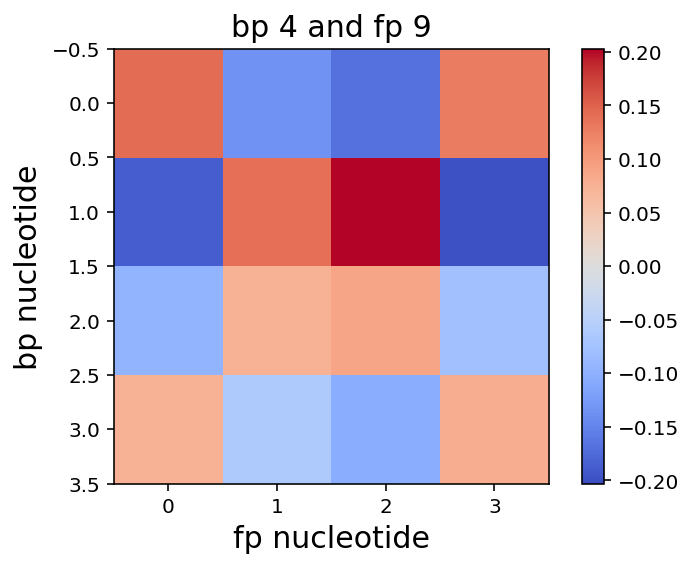

0.00479090512259
['0.19', '0.24', '0.19', '0.36']
['0.22', '0.24', '0.25', '0.27']


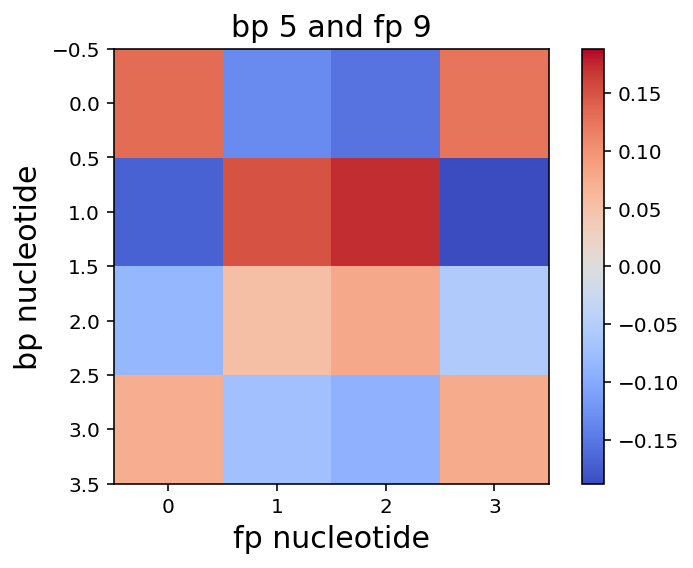

0.00565150761317
['0.18', '0.24', '0.18', '0.39']
['0.22', '0.24', '0.25', '0.27']


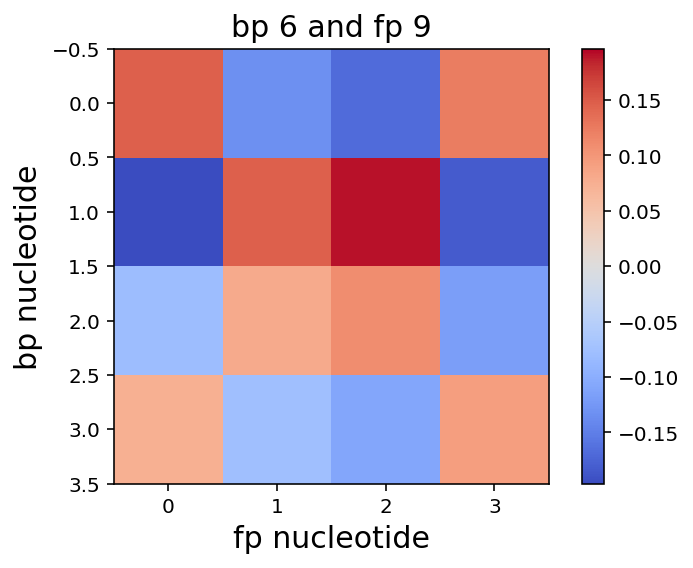

0.005853384861
['0.15', '0.26', '0.15', '0.42']
['0.22', '0.24', '0.25', '0.27']


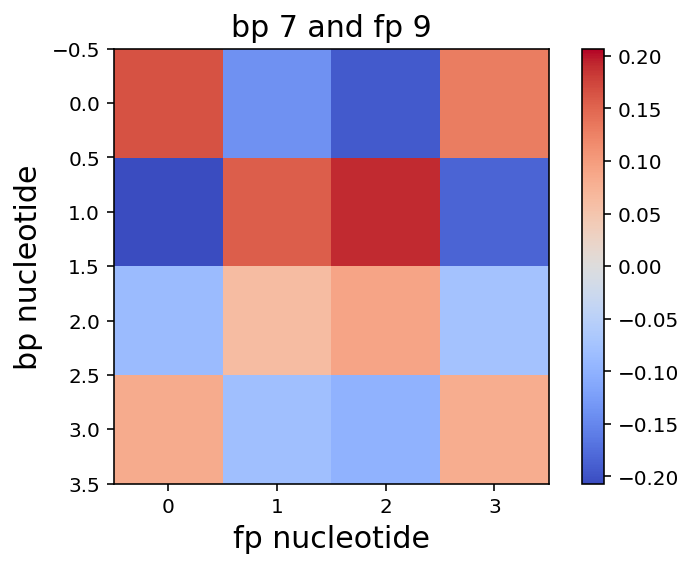

0.00623649248026
['0.13', '0.27', '0.12', '0.45']
['0.22', '0.24', '0.25', '0.27']


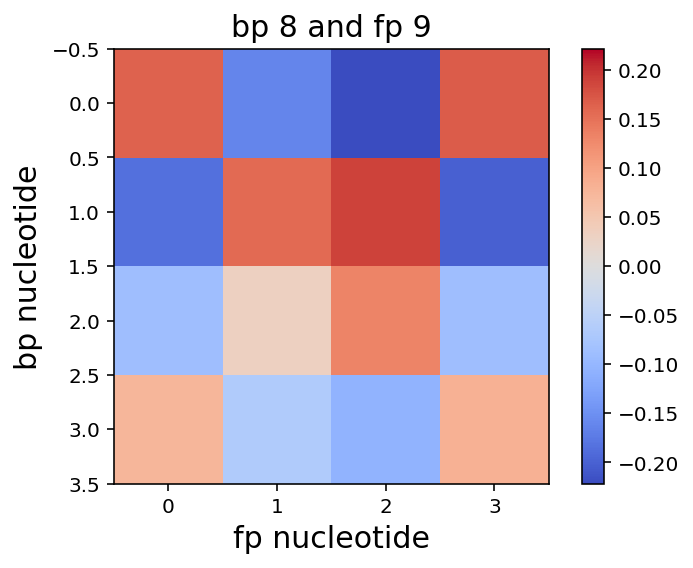

0.0050678173071
['0.12', '0.27', '0.11', '0.49']
['0.22', '0.24', '0.25', '0.27']


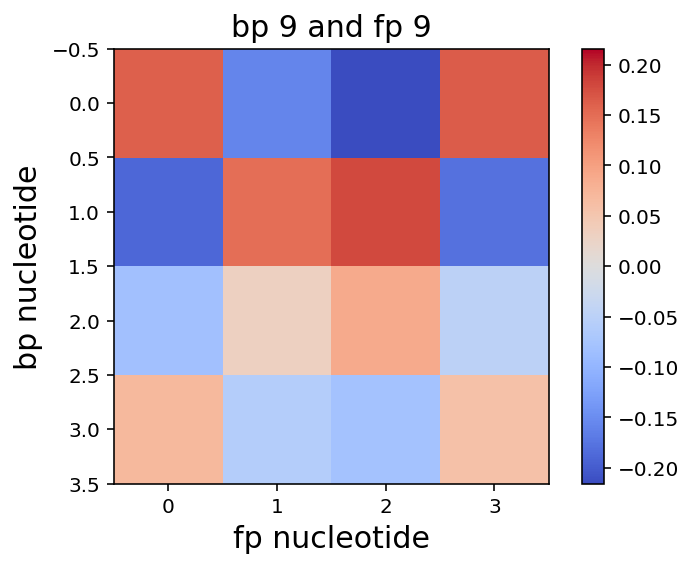

0.00488302214938
['0.11', '0.27', '0.11', '0.50']
['0.22', '0.24', '0.25', '0.27']


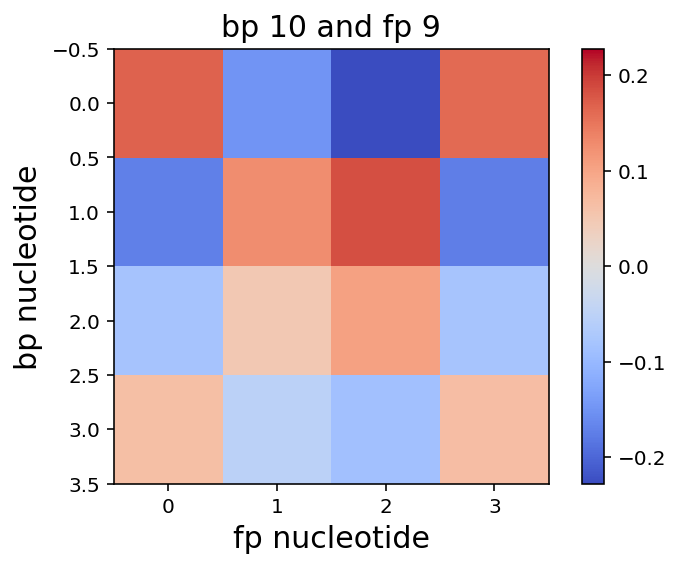

0.00439777679605
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.24', '0.25', '0.27']


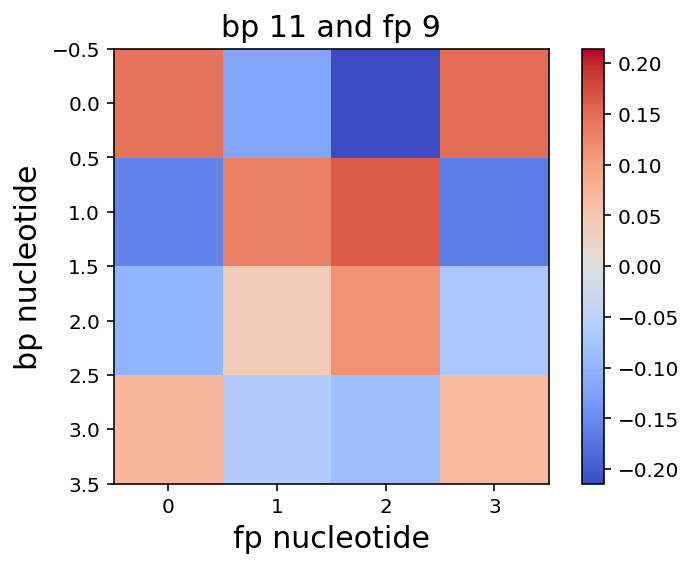

0.00483996221551
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.24', '0.25', '0.27']


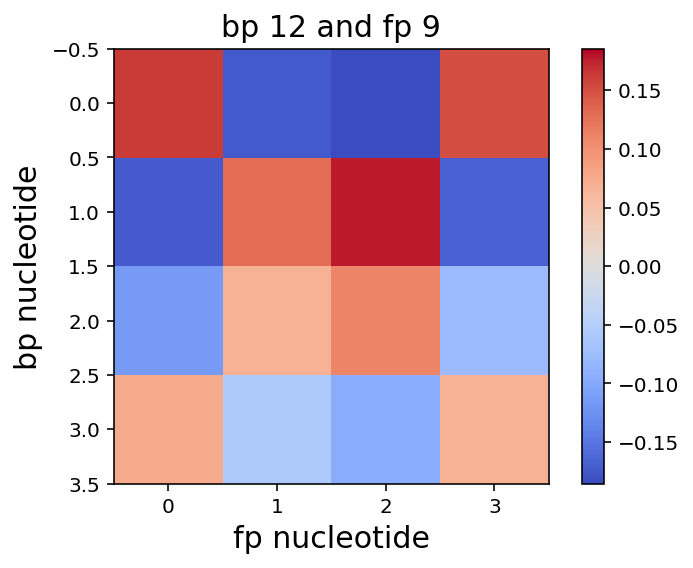

0.00506651730171
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.24', '0.25', '0.27']


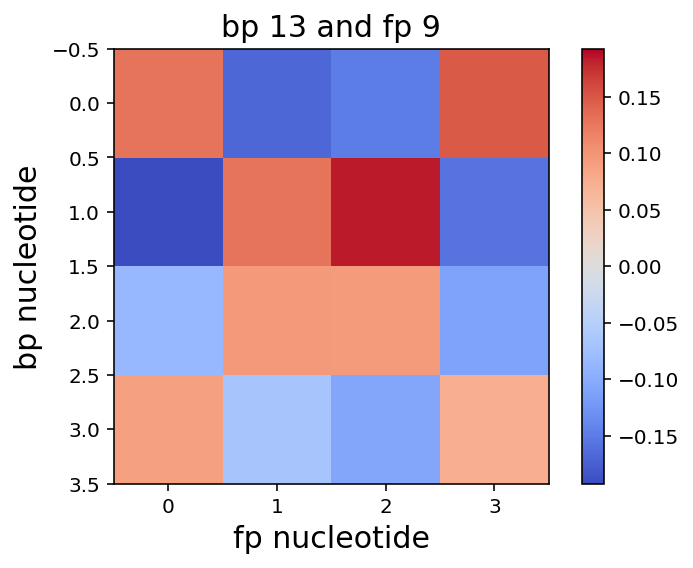

0.00496955594419
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.24', '0.25', '0.27']


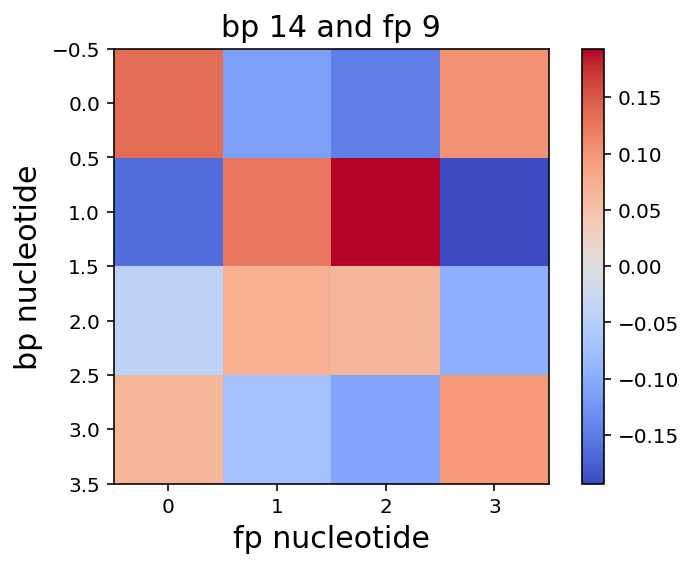

0.00563114151175
['0.24', '0.22', '0.22', '0.30']
['0.22', '0.24', '0.25', '0.27']


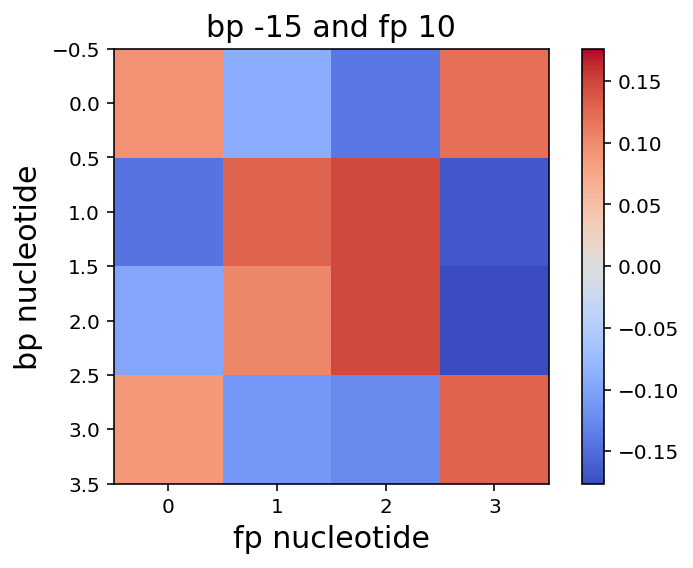

0.00486083817592
['0.25', '0.21', '0.23', '0.30']
['0.22', '0.24', '0.25', '0.27']


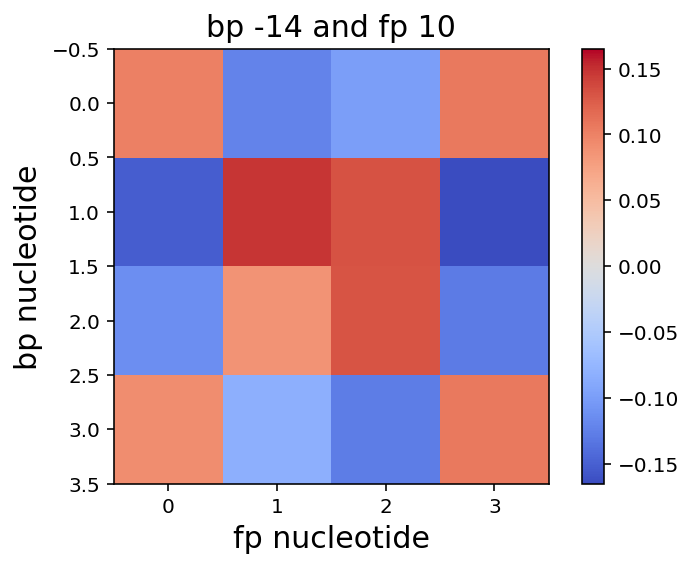

0.00498308508565
['0.25', '0.19', '0.24', '0.29']
['0.22', '0.24', '0.25', '0.27']


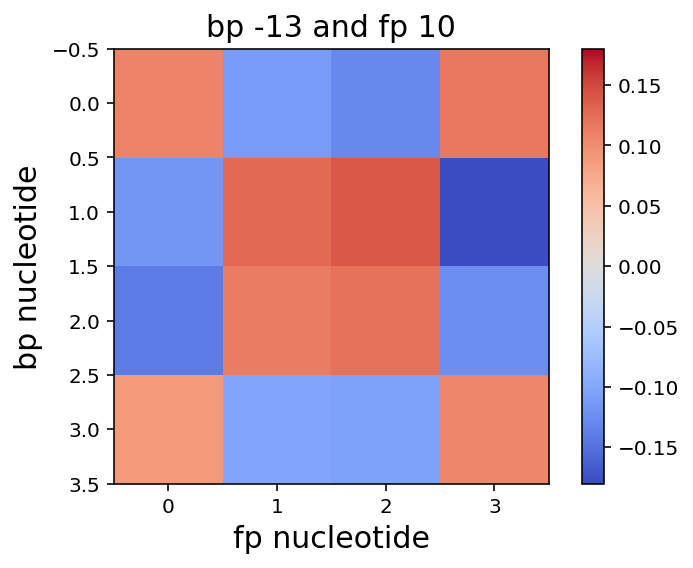

0.00485547158818
['0.26', '0.20', '0.25', '0.28']
['0.22', '0.24', '0.25', '0.27']


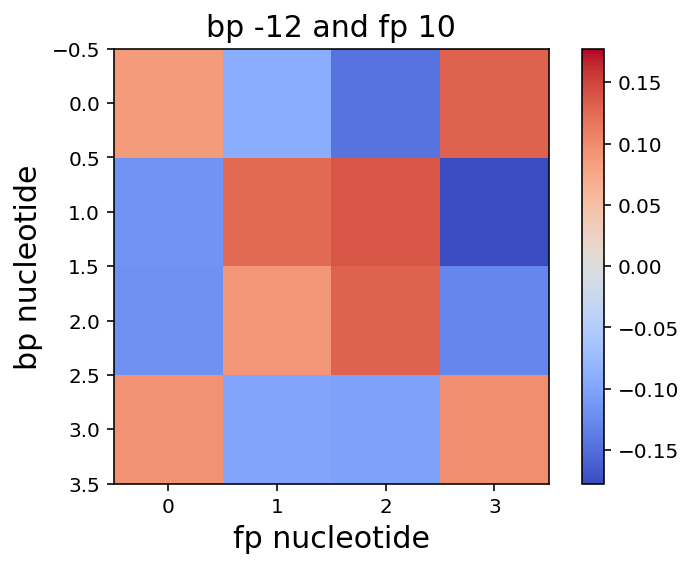

0.0046739635779
['0.25', '0.23', '0.23', '0.27']
['0.22', '0.24', '0.25', '0.27']


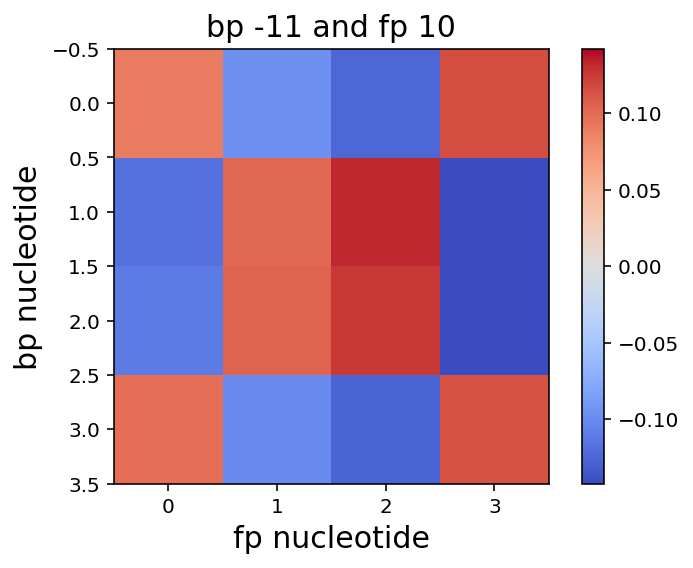

0.00480222383371
['0.24', '0.27', '0.21', '0.26']
['0.22', '0.24', '0.25', '0.27']


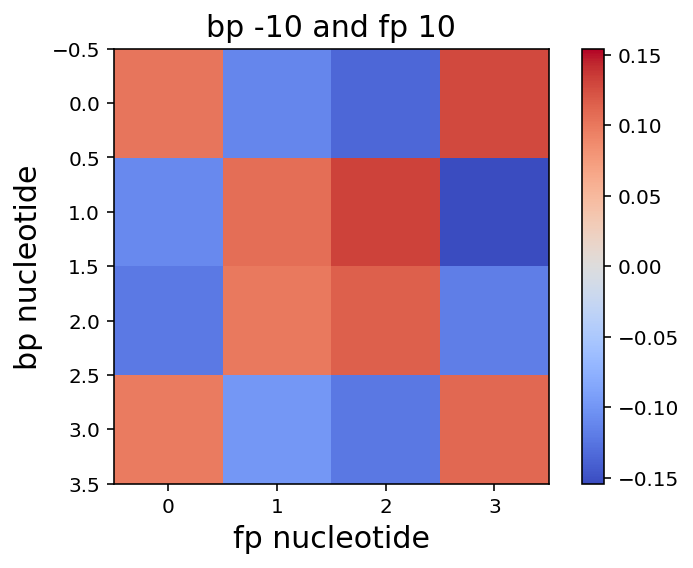

0.00501579786807
['0.24', '0.27', '0.19', '0.27']
['0.22', '0.24', '0.25', '0.27']


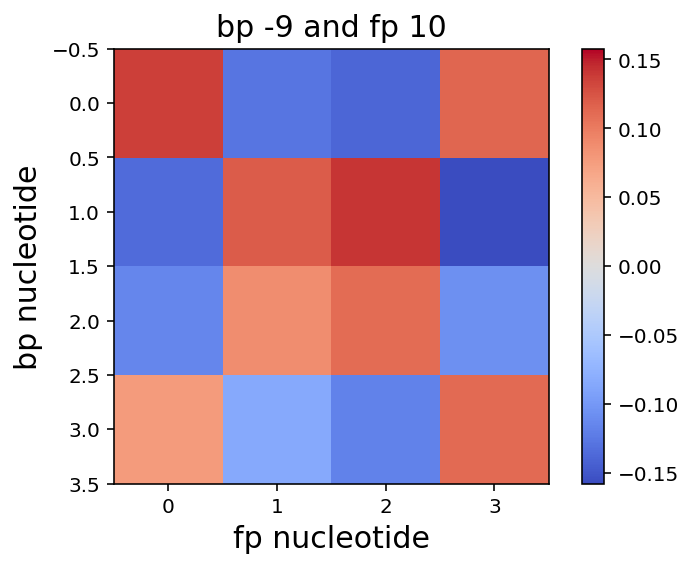

0.00524591099765
['0.25', '0.25', '0.20', '0.28']
['0.22', '0.24', '0.25', '0.27']


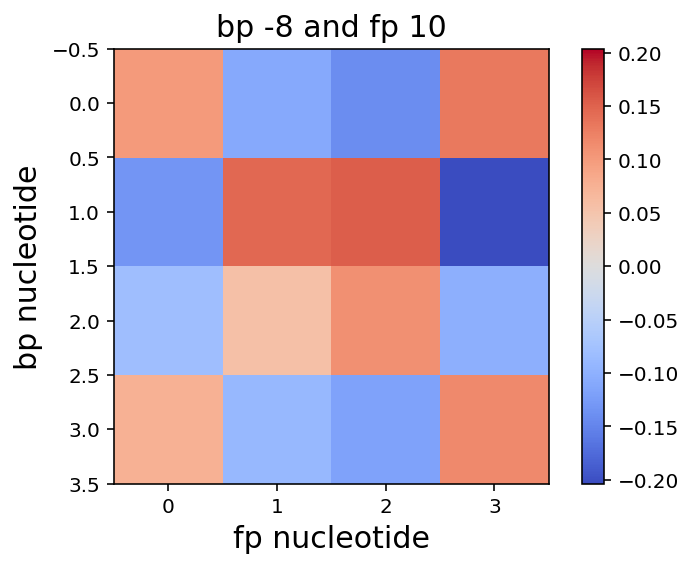

0.00522259566371
['0.25', '0.22', '0.23', '0.28']
['0.22', '0.24', '0.25', '0.27']


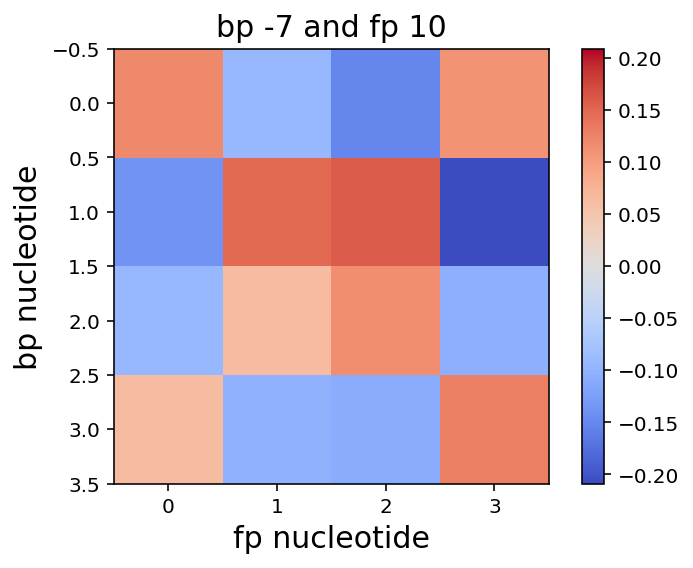

0.00554665789477
['0.26', '0.19', '0.24', '0.30']
['0.22', '0.24', '0.25', '0.27']


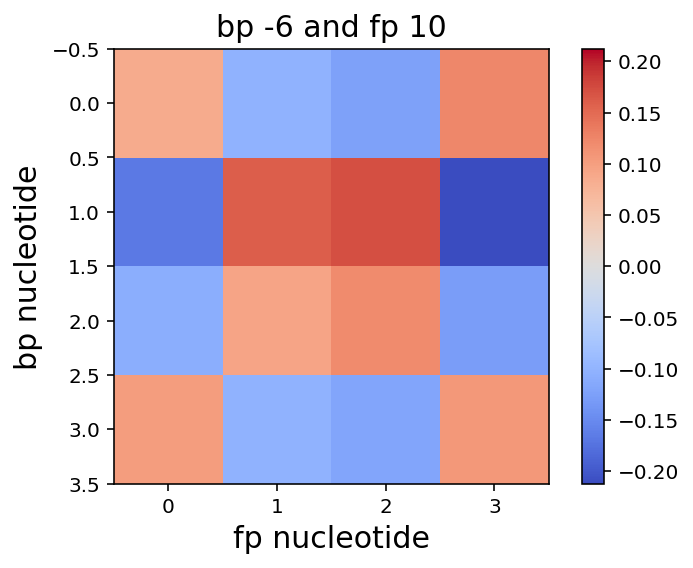

0.00560376076589
['0.23', '0.20', '0.21', '0.34']
['0.22', '0.24', '0.25', '0.27']


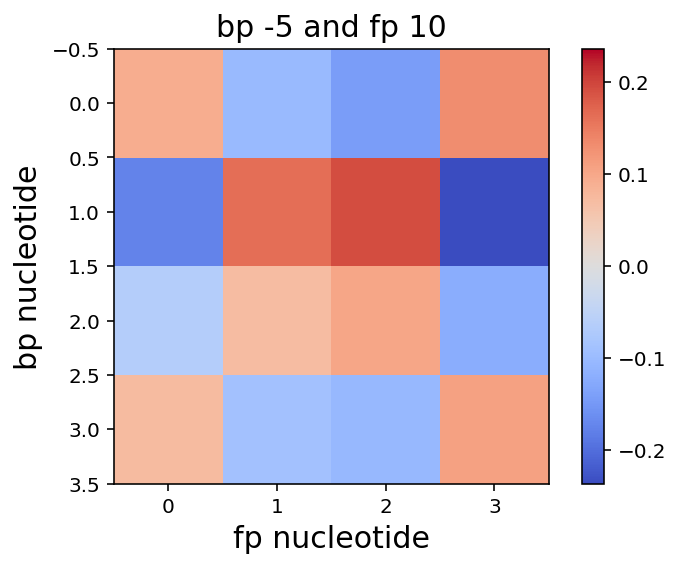

0.00606459564079
['0.27', '0.21', '0.19', '0.30']
['0.22', '0.24', '0.25', '0.27']


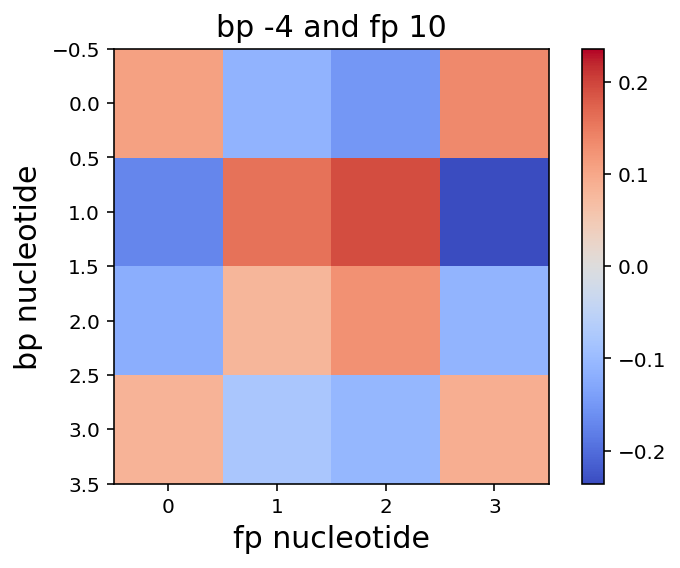

0.00588251514485
['0.09', '0.46', '0.11', '0.33']
['0.22', '0.24', '0.25', '0.27']


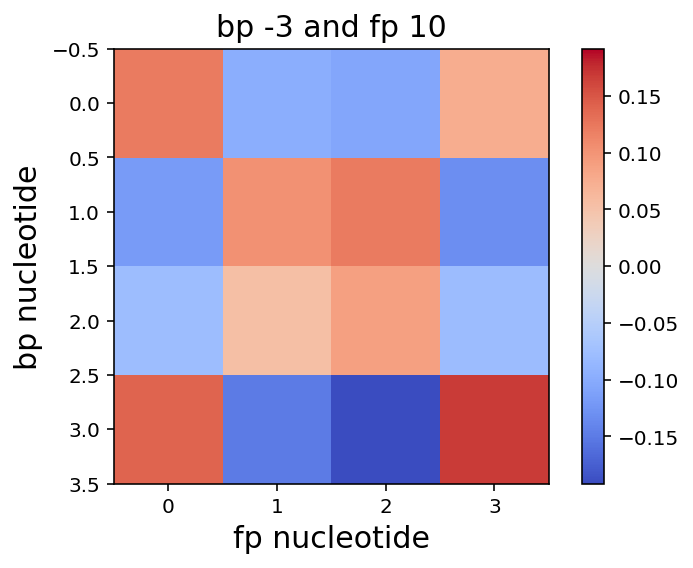

0.00185936023279
['0.06', '0.07', '0.05', '0.81']
['0.22', '0.24', '0.25', '0.27']


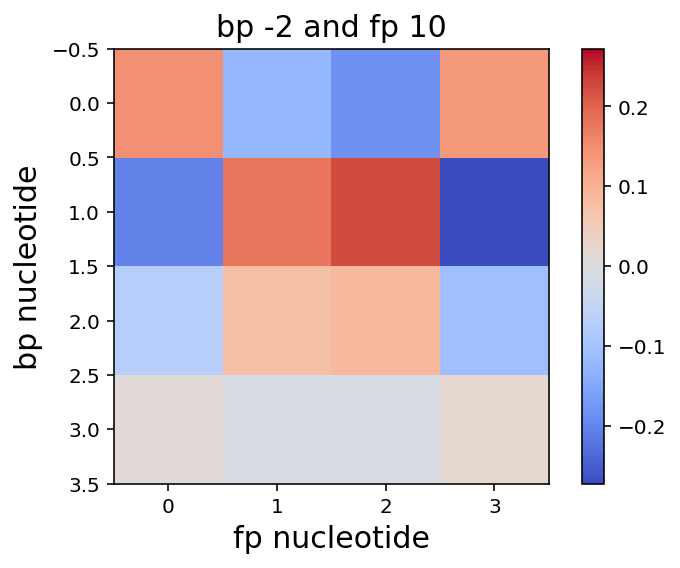

0.00800169384225
['0.24', '0.31', '0.26', '0.17']
['0.22', '0.24', '0.25', '0.27']


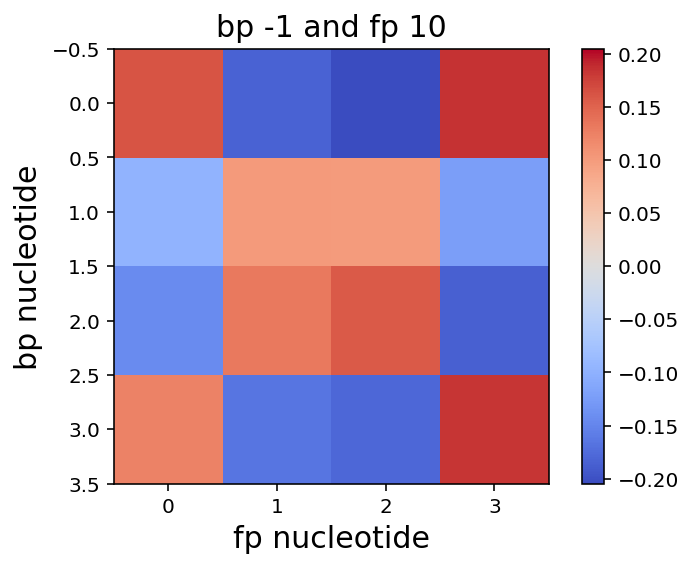

0.000728535356922
['0.98', '0.01', '0.00', '0.00']
['0.22', '0.24', '0.25', '0.27']


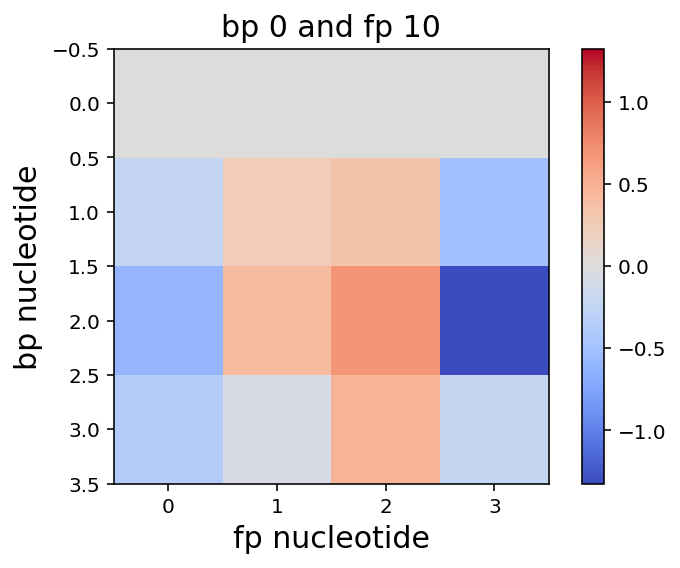

0.00713511387937
['0.18', '0.35', '0.14', '0.31']
['0.22', '0.24', '0.25', '0.27']


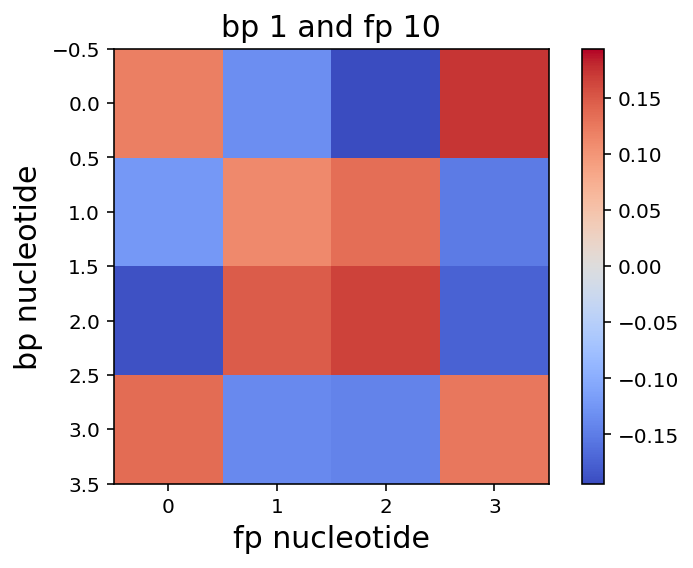

0.00568104936823
['0.23', '0.28', '0.16', '0.31']
['0.22', '0.24', '0.25', '0.27']


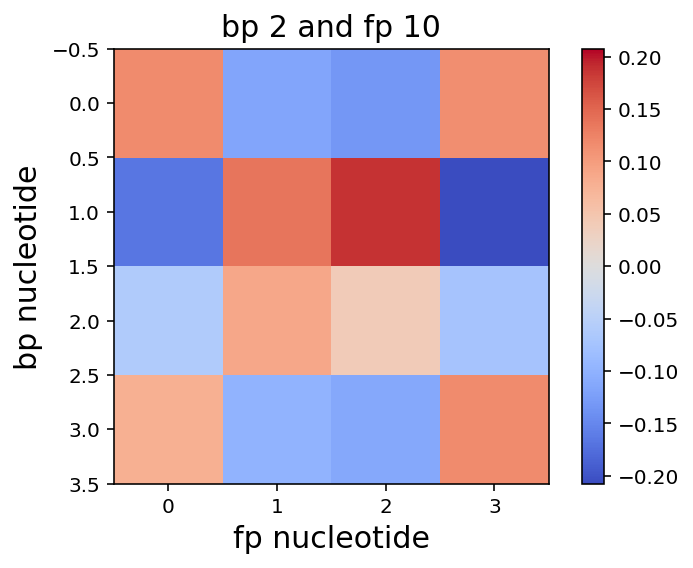

0.00493322861601
['0.22', '0.24', '0.20', '0.32']
['0.22', '0.24', '0.25', '0.27']


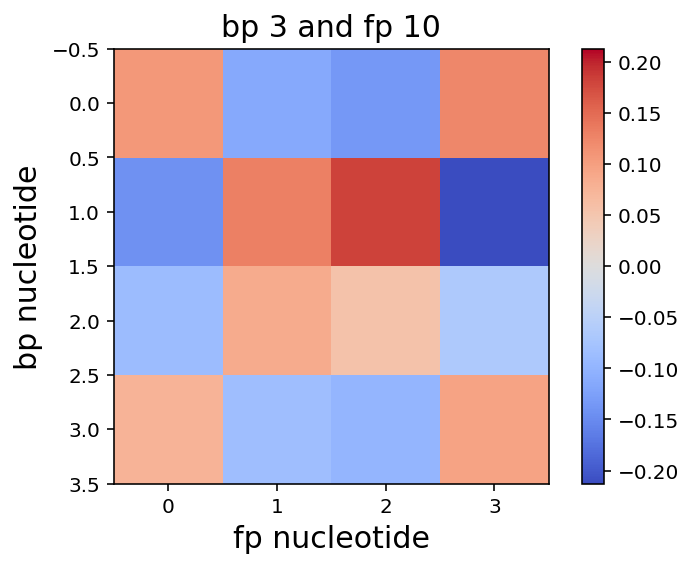

0.00570965573793
['0.20', '0.23', '0.18', '0.36']
['0.22', '0.24', '0.25', '0.27']


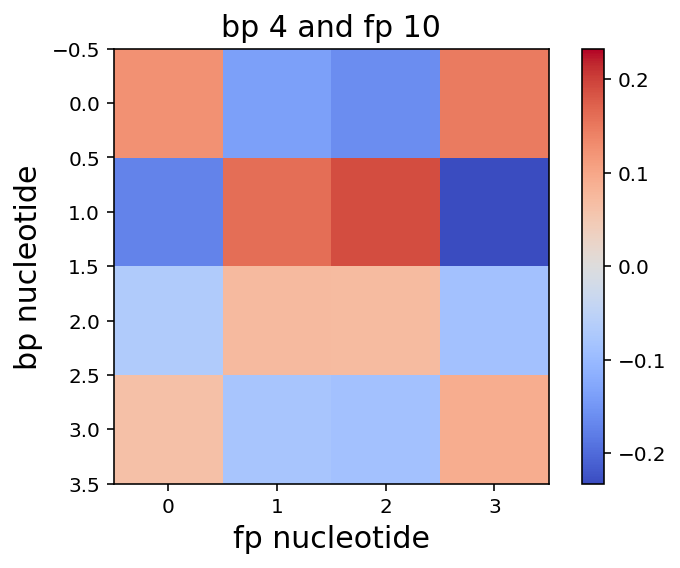

0.00517331391779
['0.19', '0.24', '0.19', '0.36']
['0.22', '0.24', '0.25', '0.27']


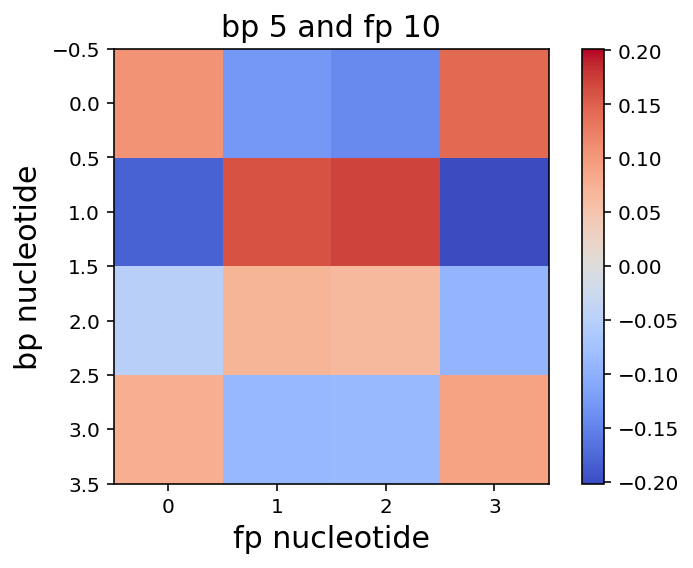

0.0050631118049
['0.18', '0.24', '0.18', '0.39']
['0.22', '0.24', '0.25', '0.27']


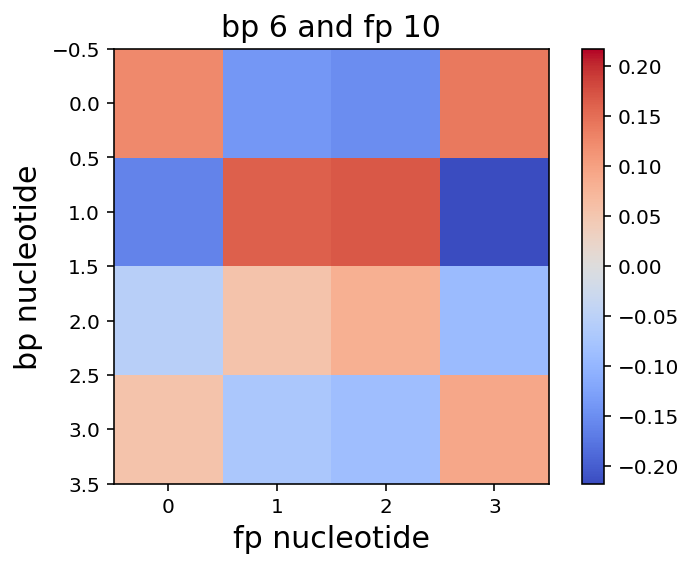

0.00531314086492
['0.15', '0.26', '0.15', '0.42']
['0.22', '0.24', '0.25', '0.27']


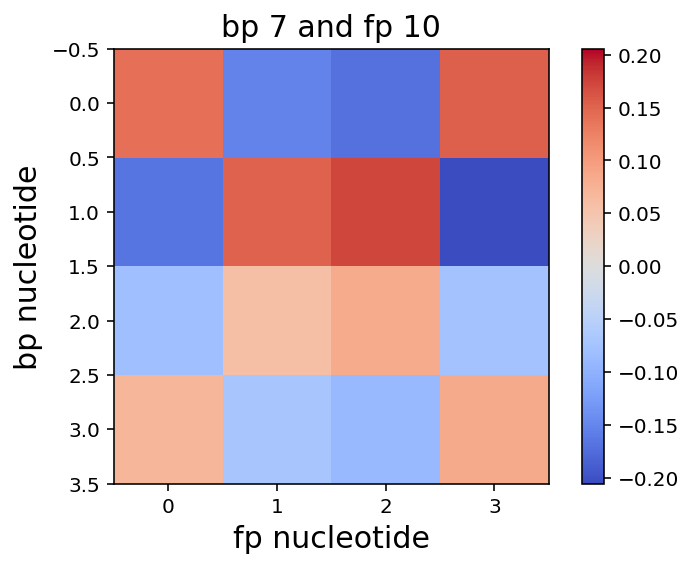

0.00592576078634
['0.13', '0.27', '0.12', '0.45']
['0.22', '0.24', '0.25', '0.27']


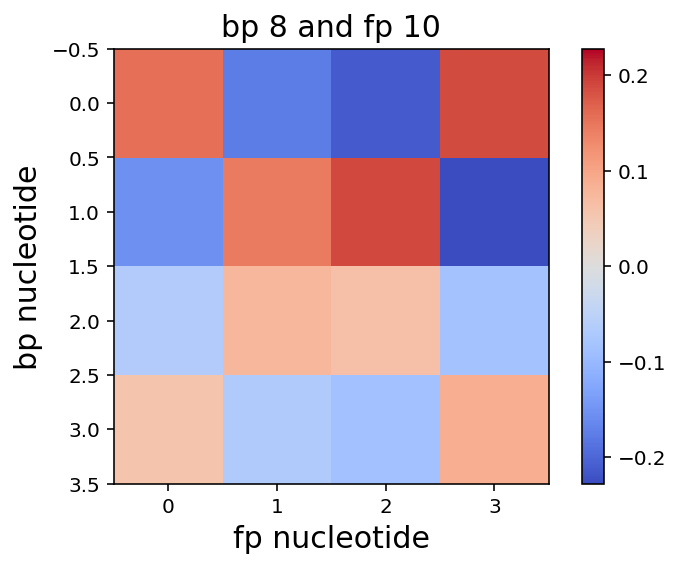

0.00596990453022
['0.12', '0.27', '0.11', '0.49']
['0.22', '0.24', '0.25', '0.27']


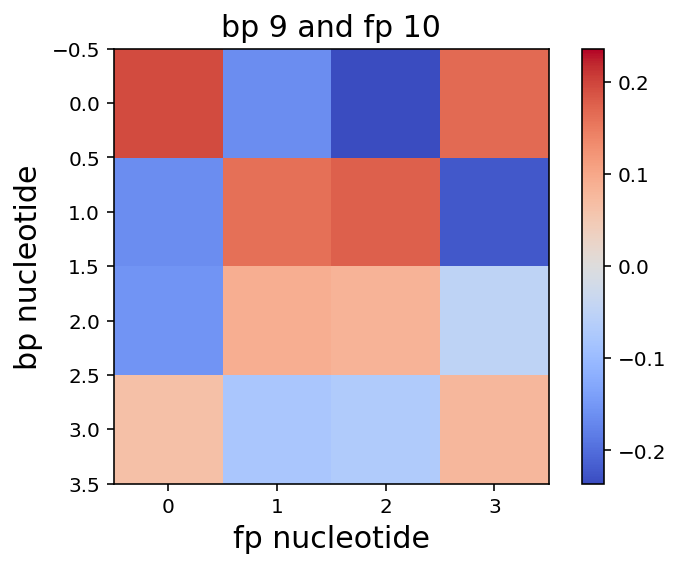

0.00542328380952
['0.11', '0.27', '0.11', '0.50']
['0.22', '0.24', '0.25', '0.27']


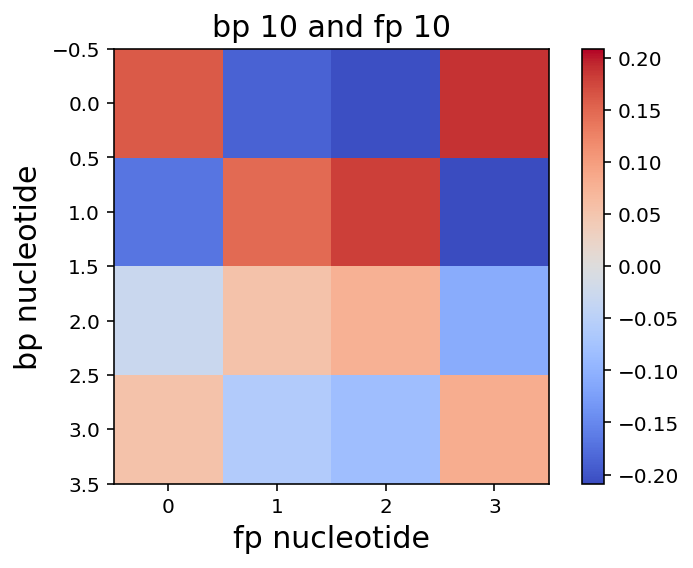

0.00479722336197
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.24', '0.25', '0.27']


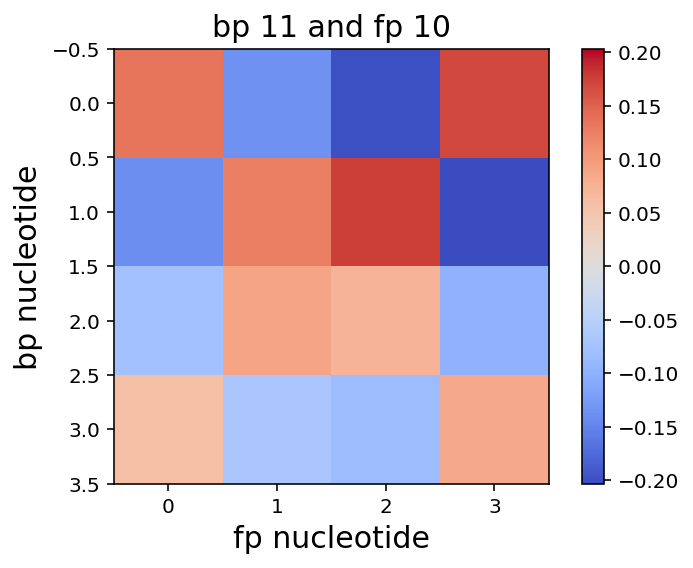

0.00391827670898
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.24', '0.25', '0.27']


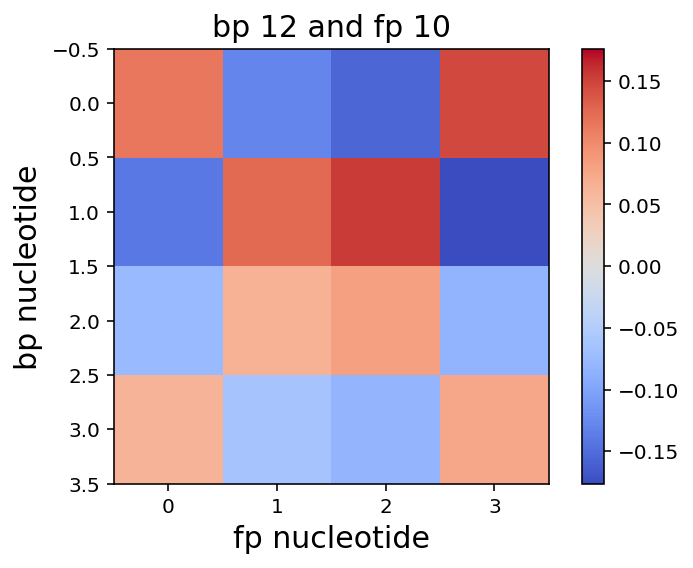

0.00454004281659
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.24', '0.25', '0.27']


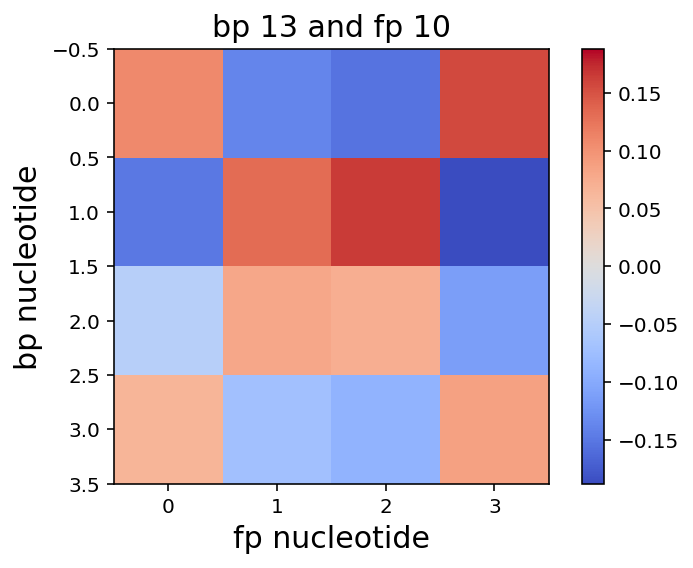

0.00537844107679
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.24', '0.25', '0.27']


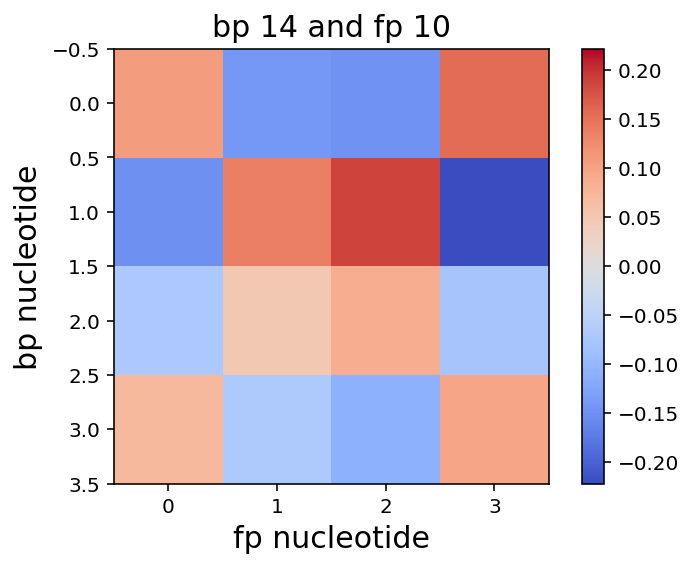

0.00554913028311
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.24', '0.25', '0.28']


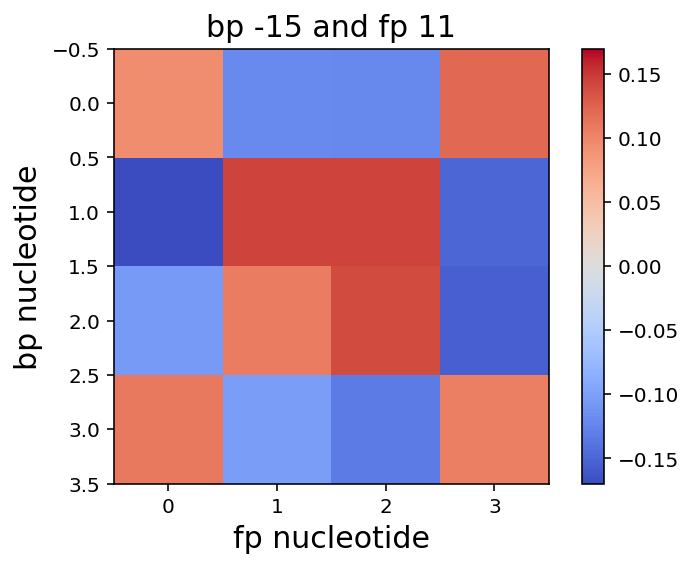

0.00514754622956
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.24', '0.25', '0.28']


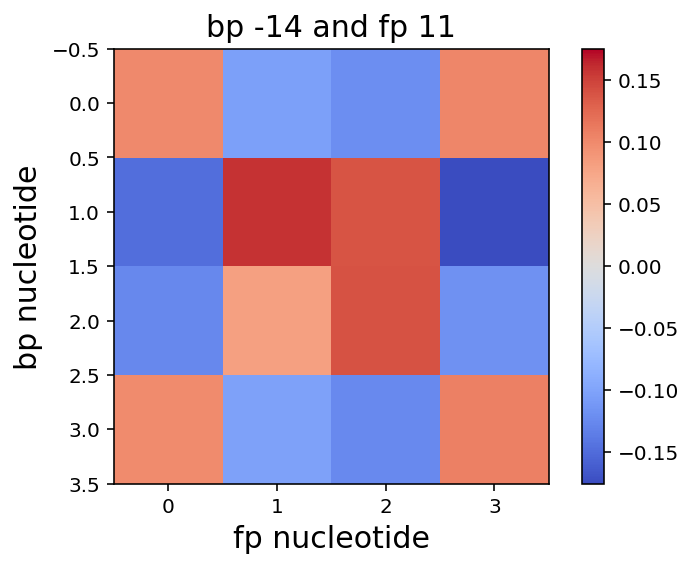

0.00513901772922
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.24', '0.25', '0.28']


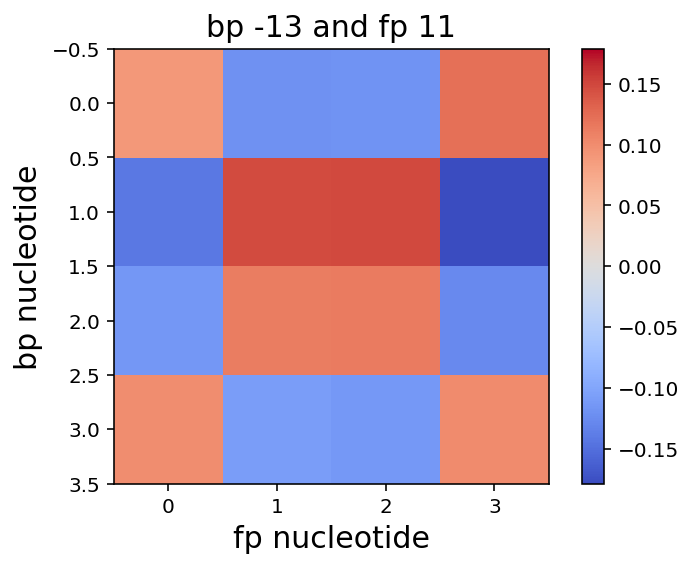

0.0046831474498
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.24', '0.25', '0.28']


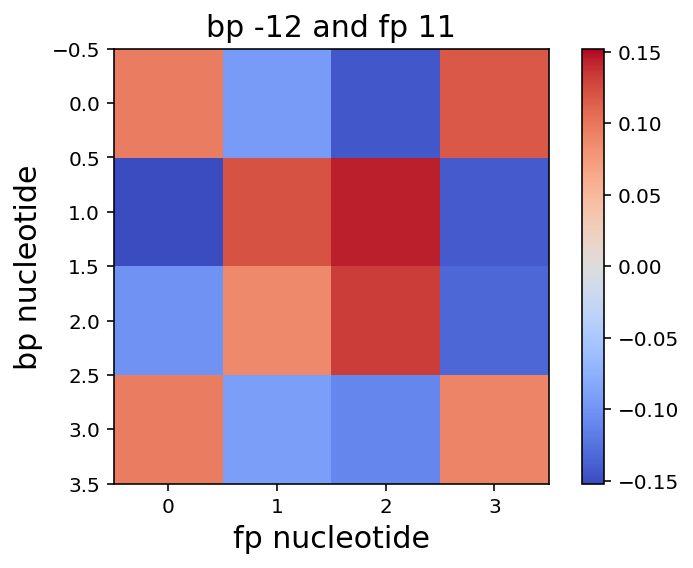

0.00436700886161
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.24', '0.25', '0.28']


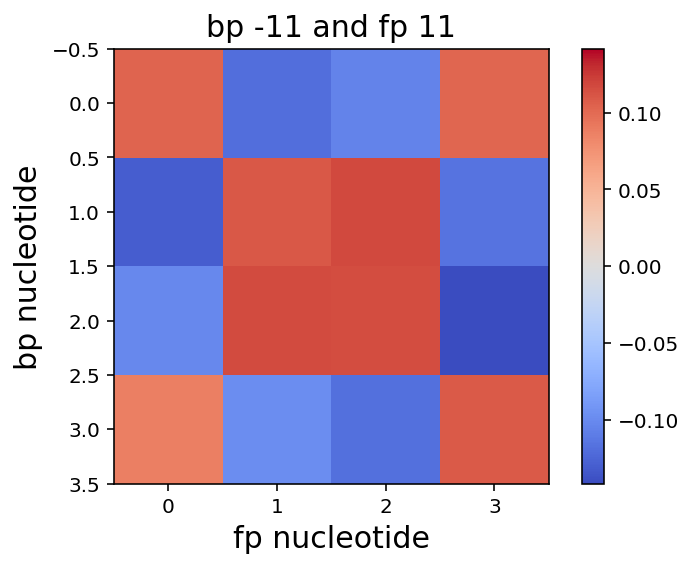

0.00493146749673
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.24', '0.25', '0.28']


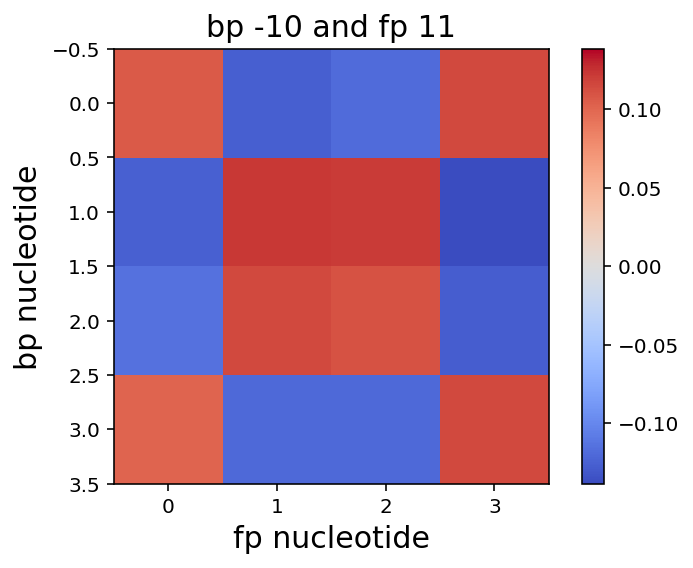

0.00407505125066
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.24', '0.25', '0.28']


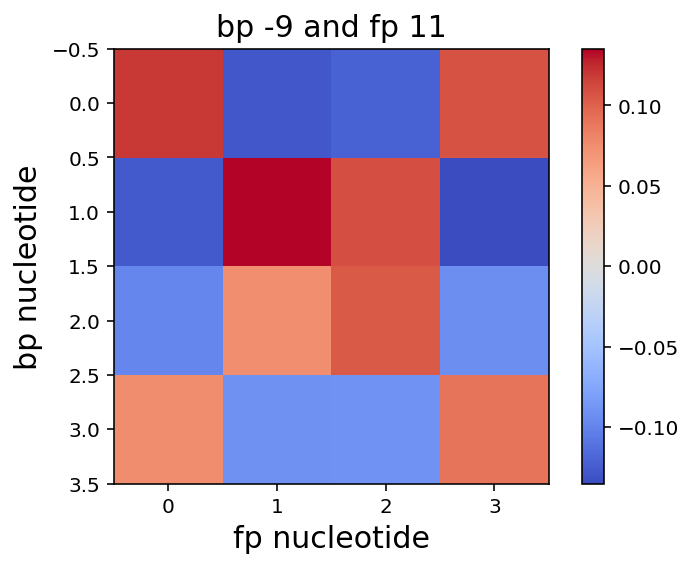

0.0050826909377
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.24', '0.25', '0.28']


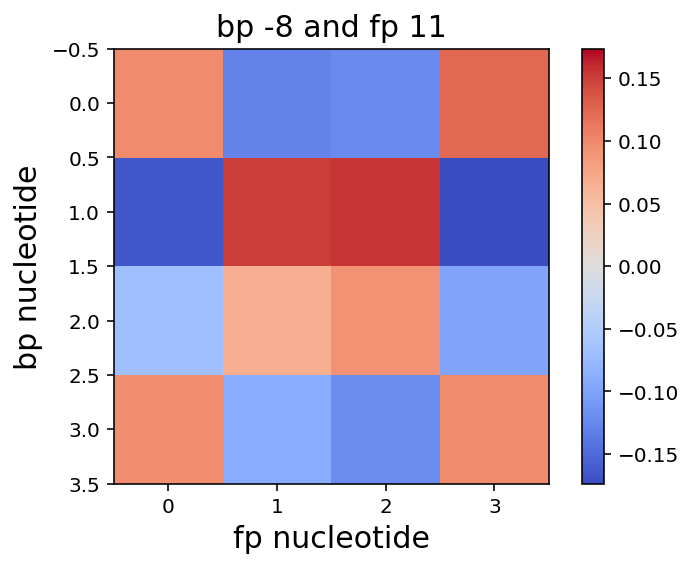

0.00518099548
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.24', '0.25', '0.28']


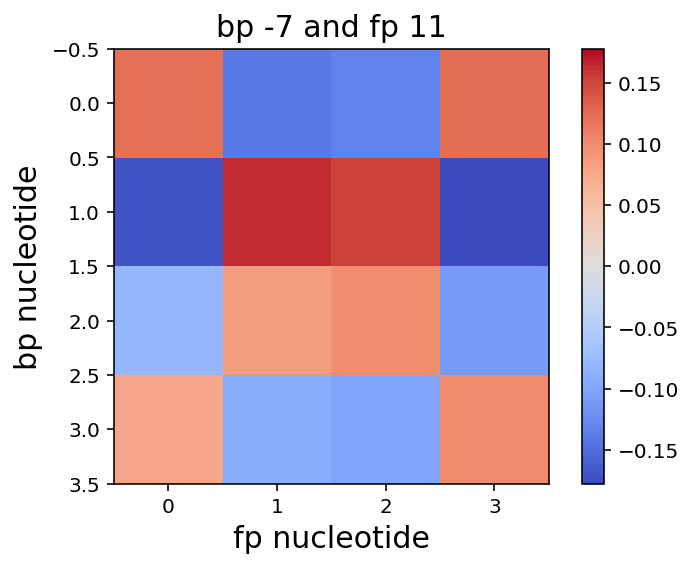

0.00509855250152
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.24', '0.25', '0.28']


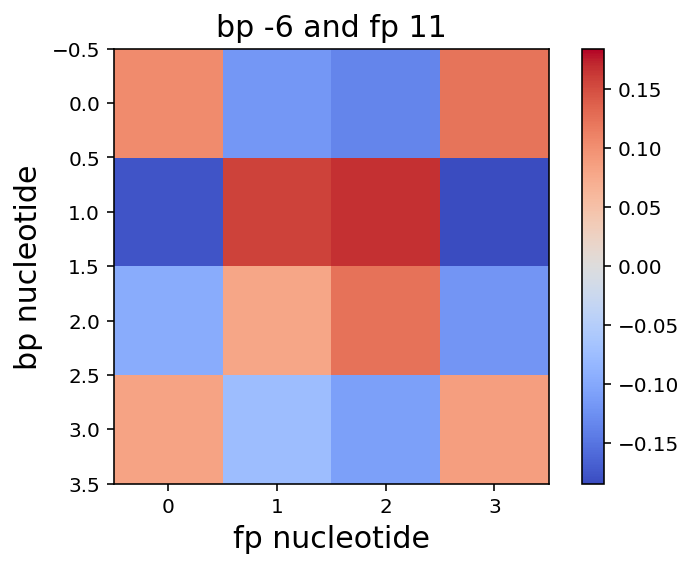

0.00597890647699
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.24', '0.25', '0.28']


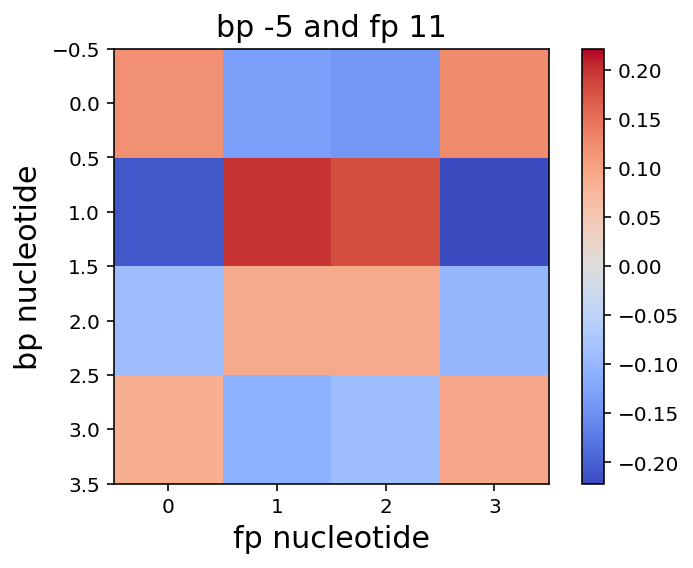

0.00540274646427
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.24', '0.25', '0.28']


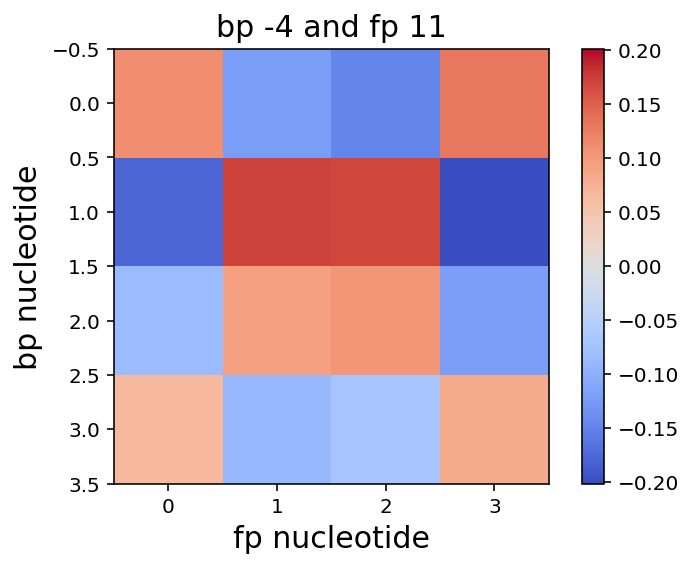

0.00635822479053
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.24', '0.25', '0.28']


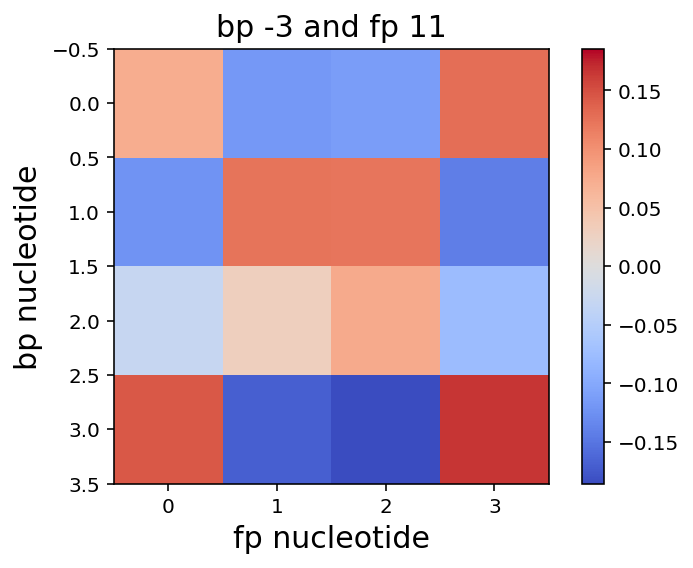

0.00185018416273
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.24', '0.25', '0.28']


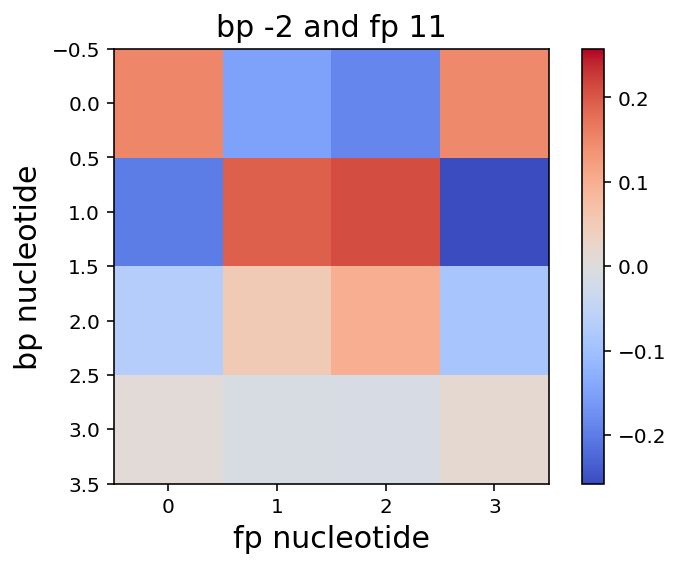

0.00739693074882
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.24', '0.25', '0.28']


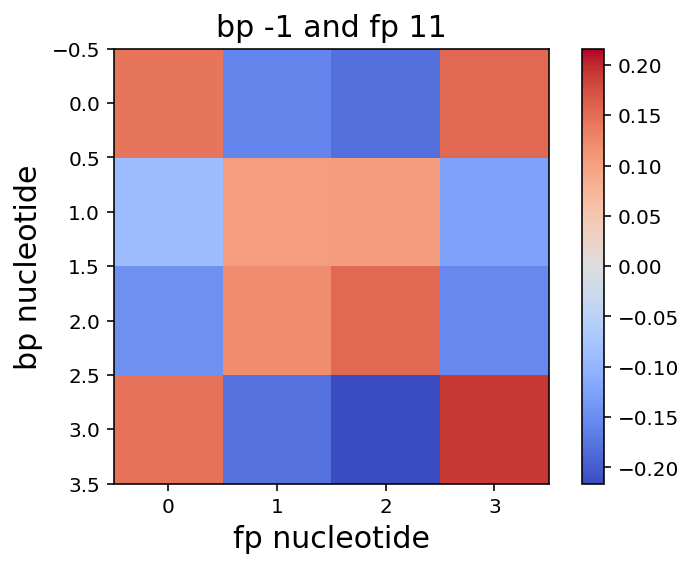

0.000735437276046
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.24', '0.25', '0.28']


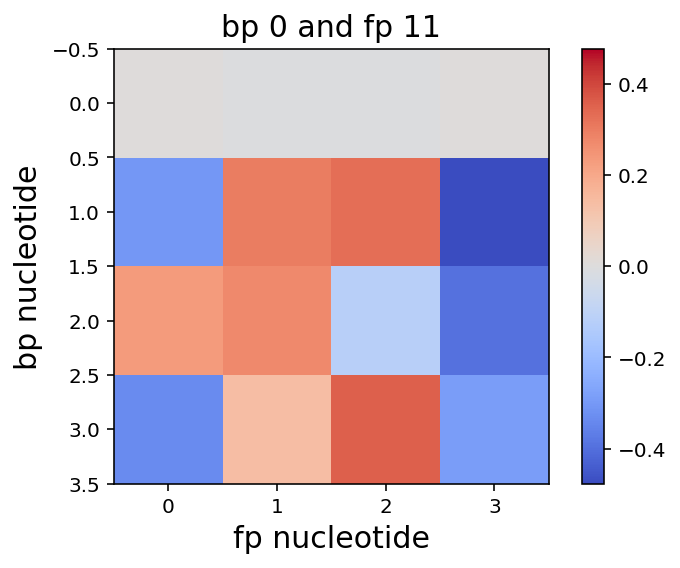

0.00742946690964
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.24', '0.25', '0.28']


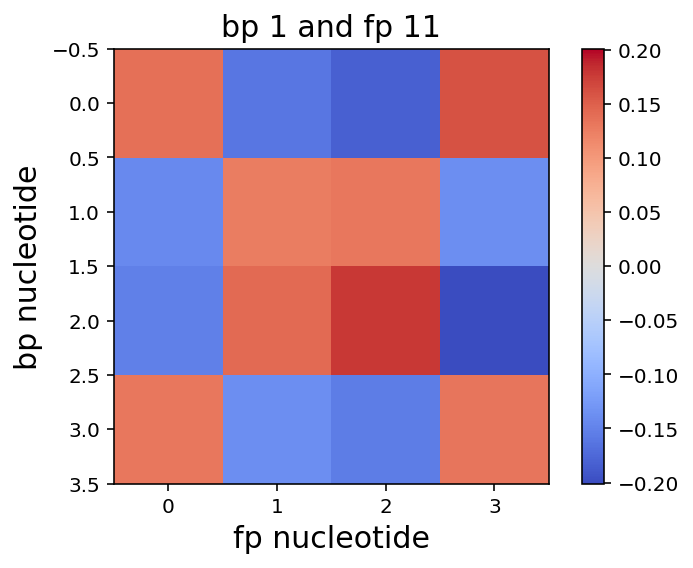

0.0053736234936
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.24', '0.25', '0.28']


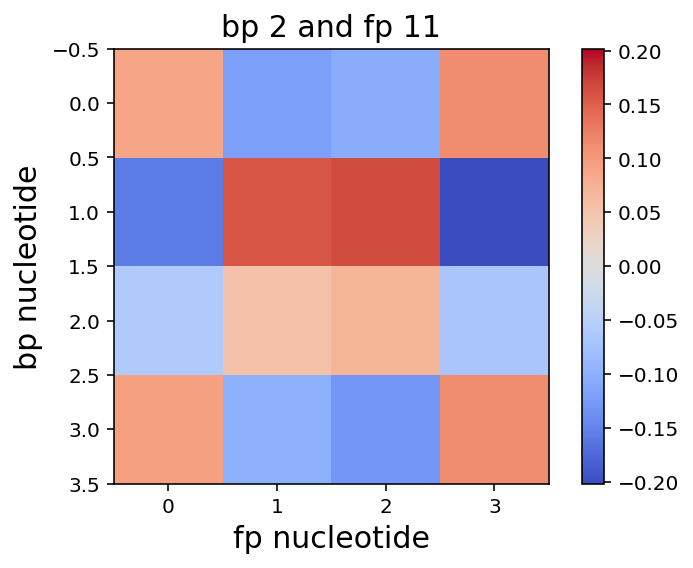

0.00524849632013
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.24', '0.25', '0.28']


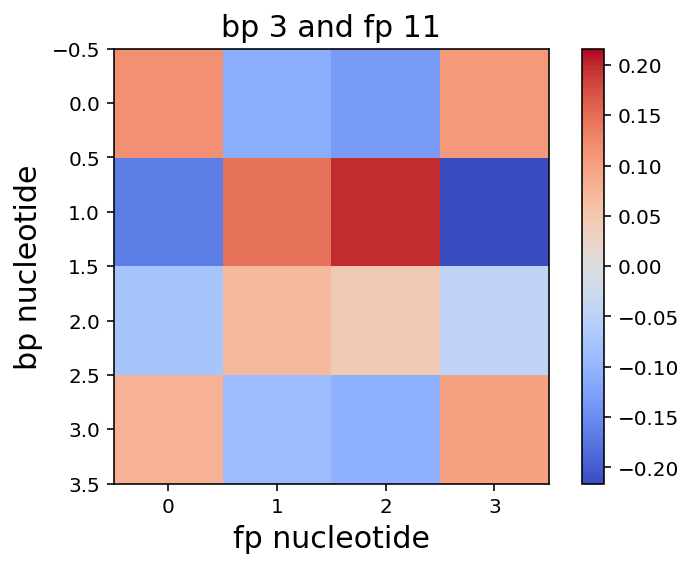

0.00520363545192
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.24', '0.25', '0.28']


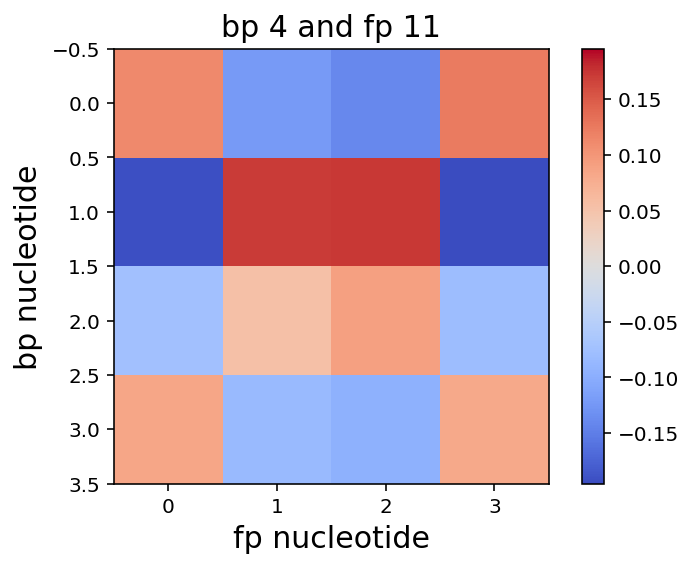

0.00540043285259
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.24', '0.25', '0.28']


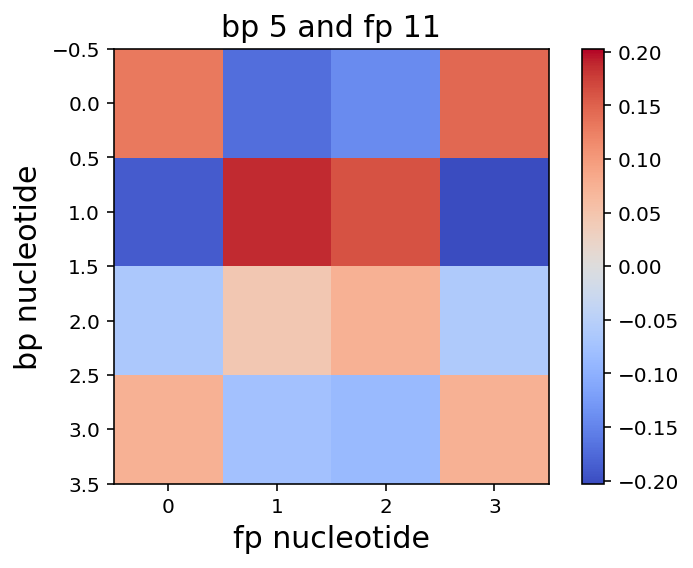

0.00530360685045
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.24', '0.25', '0.28']


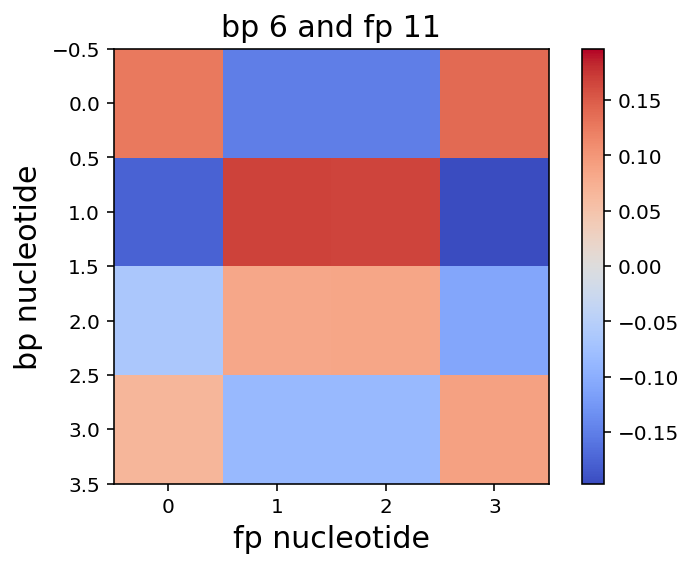

0.00529556551732
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.24', '0.25', '0.28']


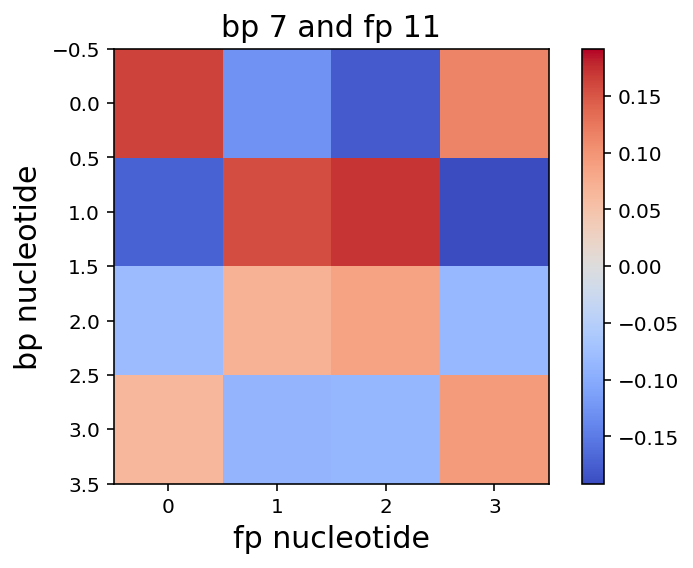

0.00510600592229
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.24', '0.25', '0.28']


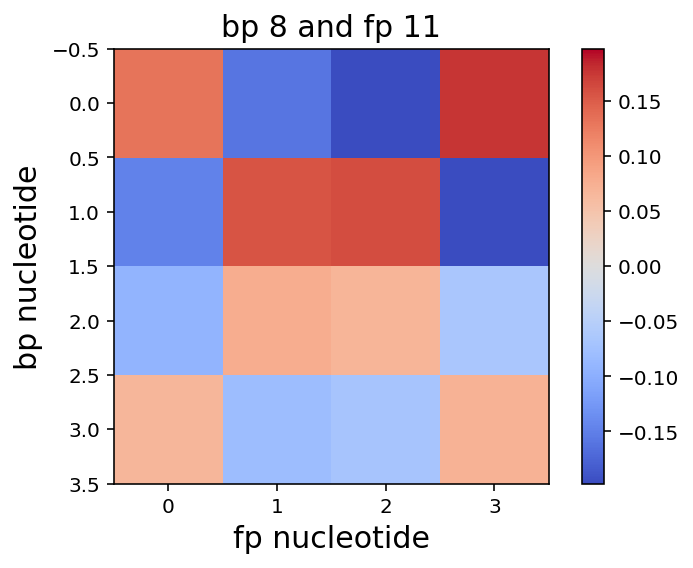

0.00535683375541
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.24', '0.25', '0.28']


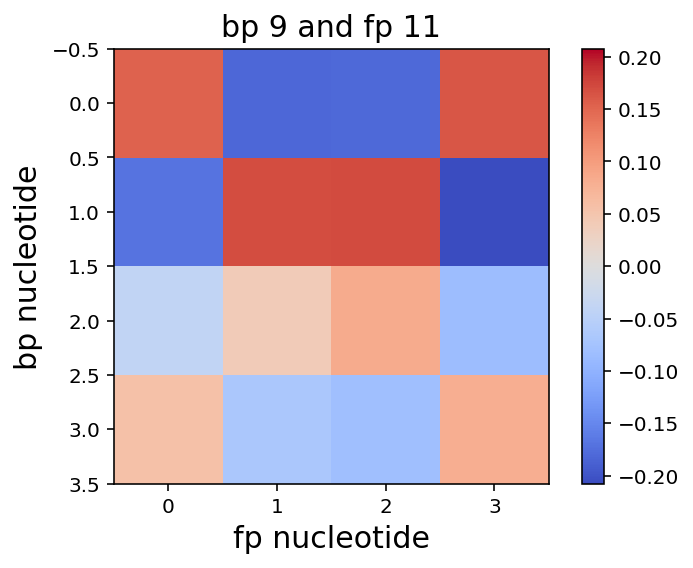

0.00474447313141
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.24', '0.25', '0.28']


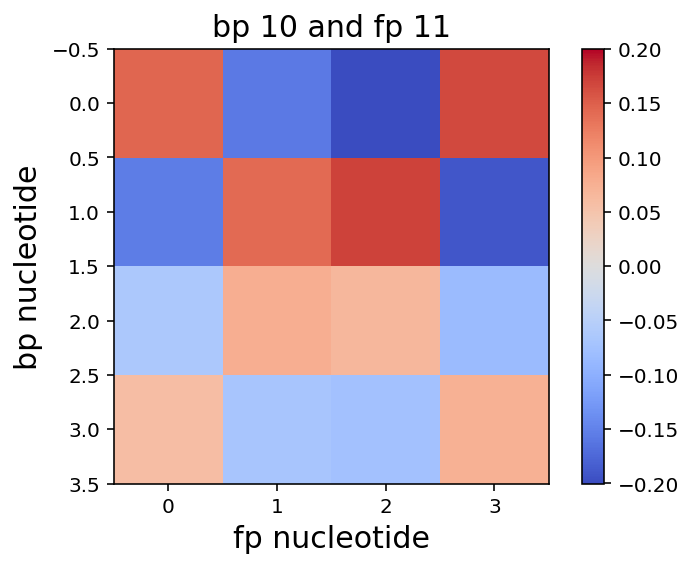

0.00475747112844
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.25', '0.28']


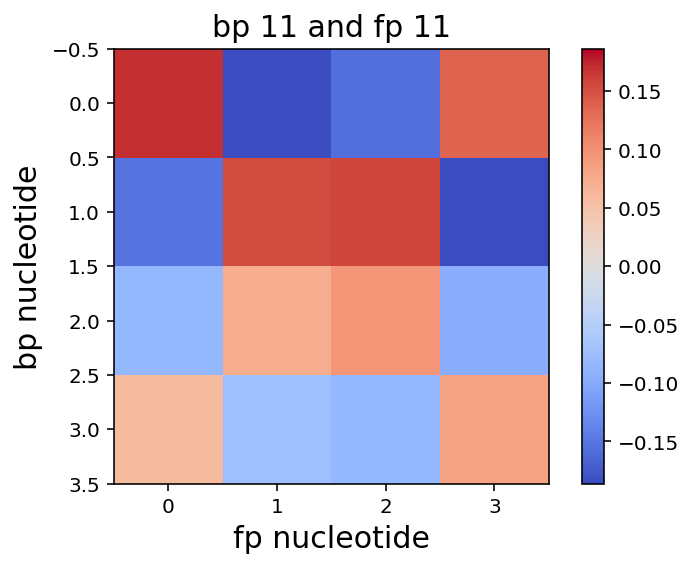

0.00448568838409
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.25', '0.28']


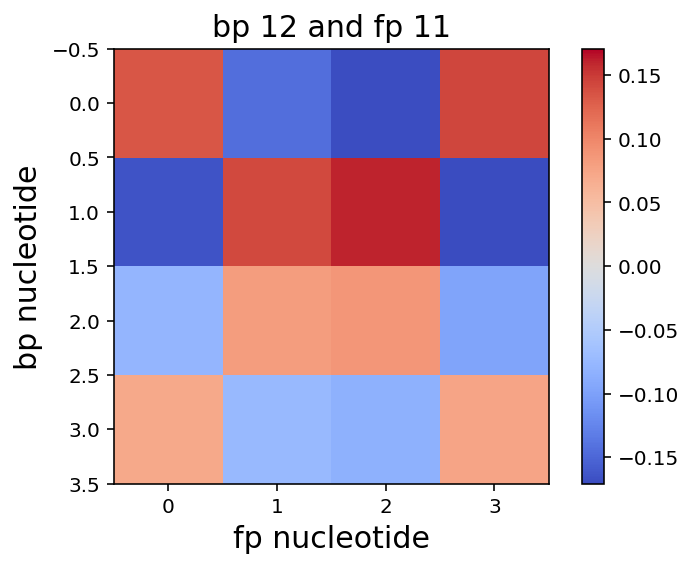

0.00474265471741
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.25', '0.28']


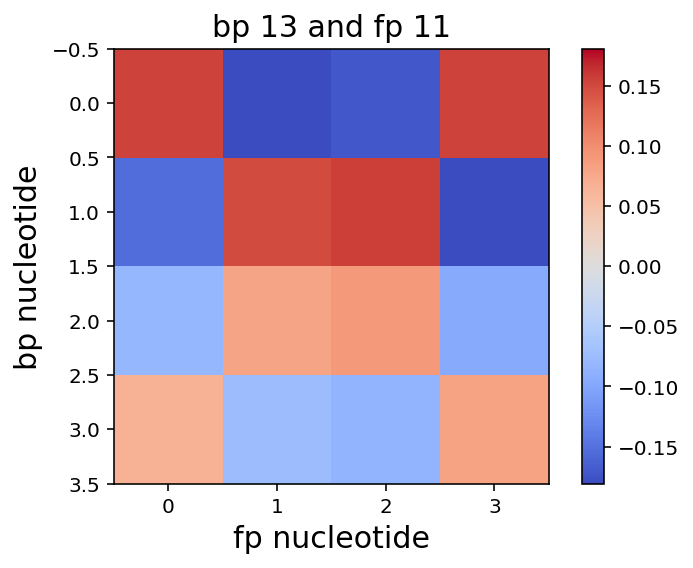

0.00480447260563
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.25', '0.28']


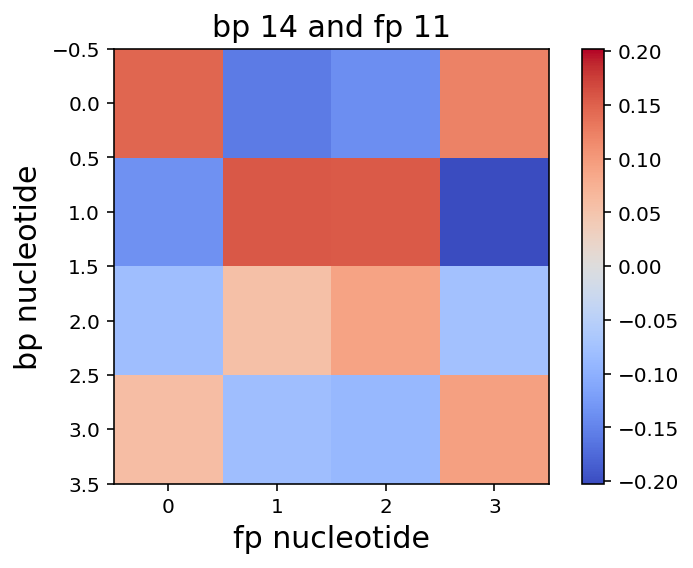

0.00506982680251
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.24', '0.25', '0.28']


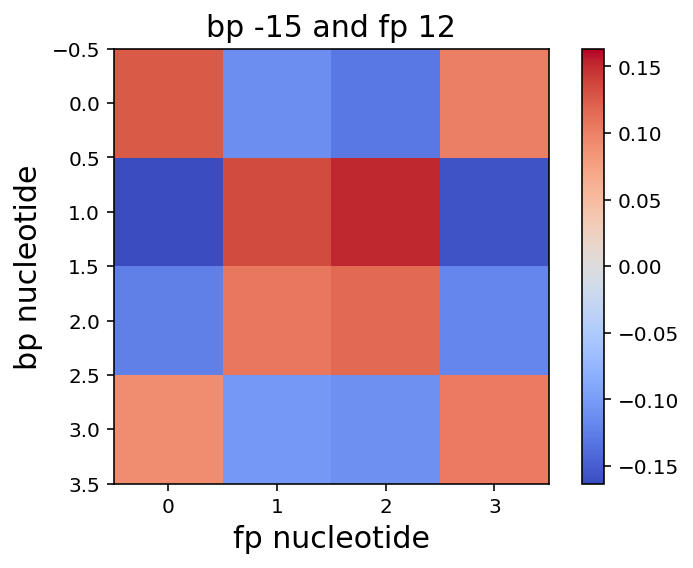

0.00441745811383
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.24', '0.25', '0.28']


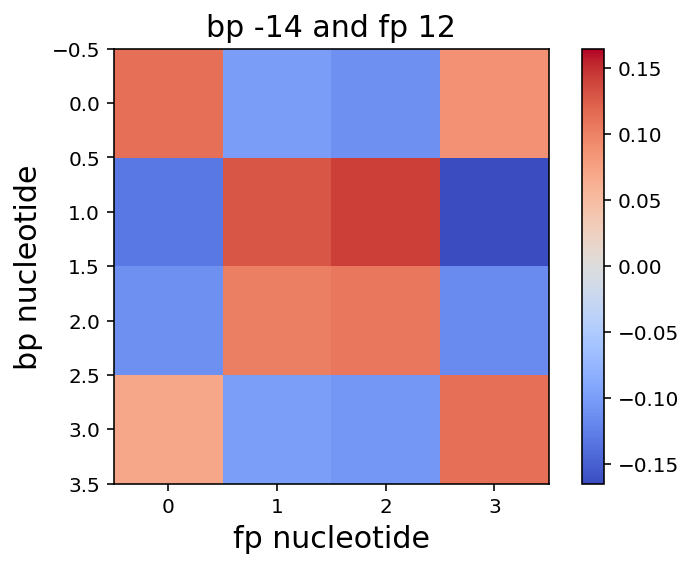

0.00548686557539
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.24', '0.25', '0.28']


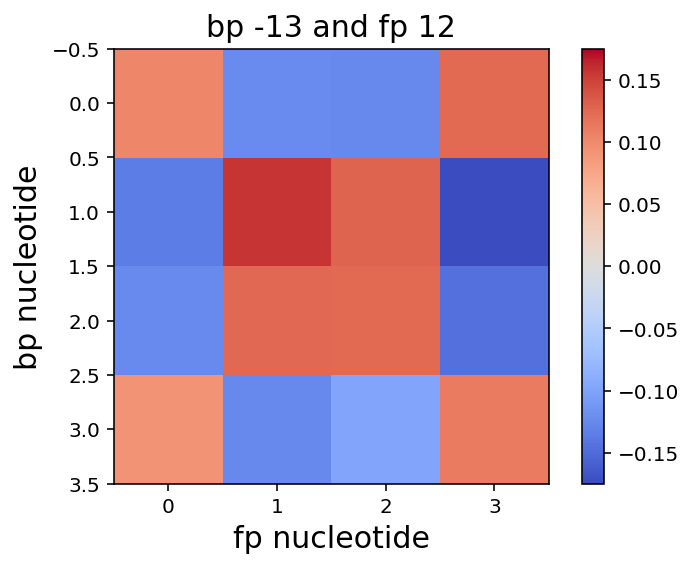

0.00536662141287
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.24', '0.25', '0.28']


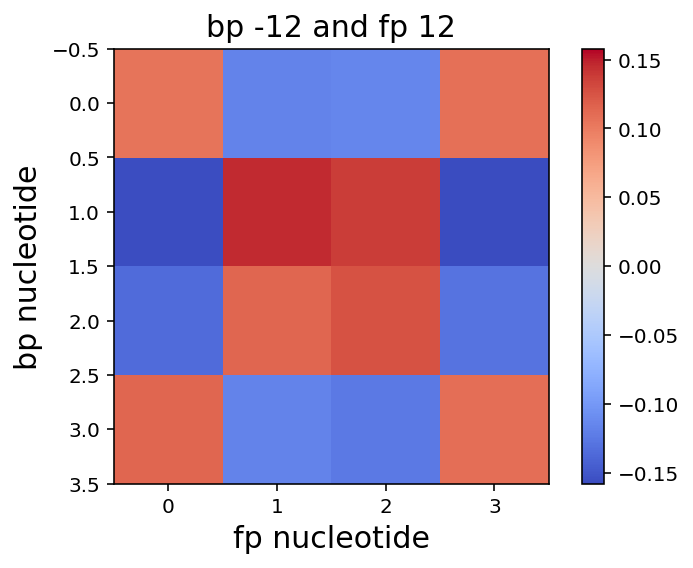

0.00453185791738
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.24', '0.25', '0.28']


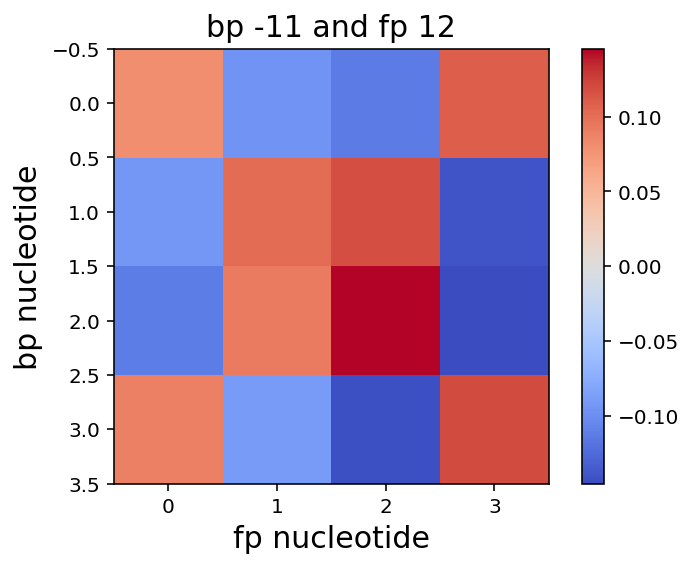

0.00502590253233
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.24', '0.25', '0.28']


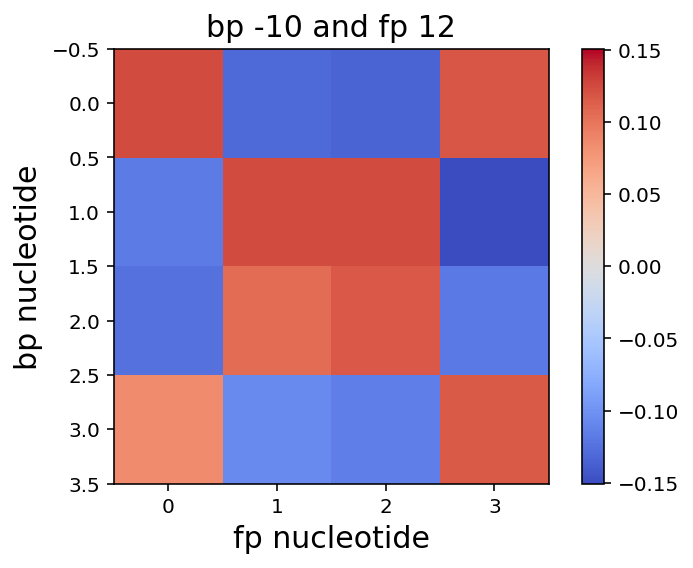

0.00434467861843
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.24', '0.25', '0.28']


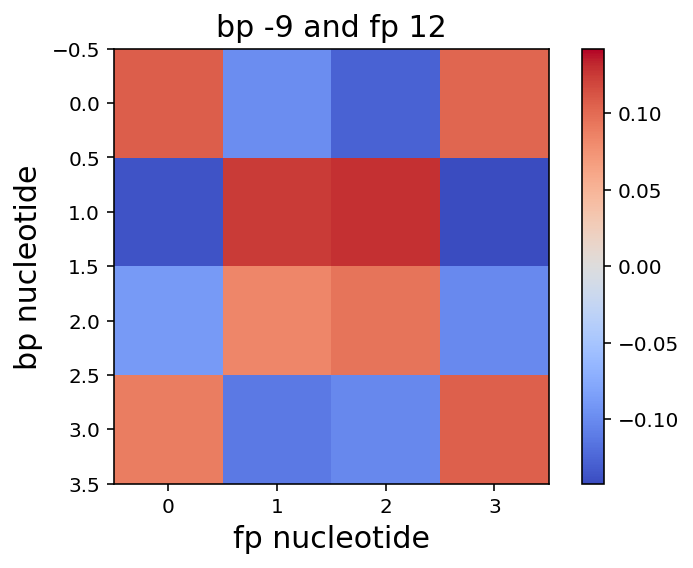

0.00485849687316
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.24', '0.25', '0.28']


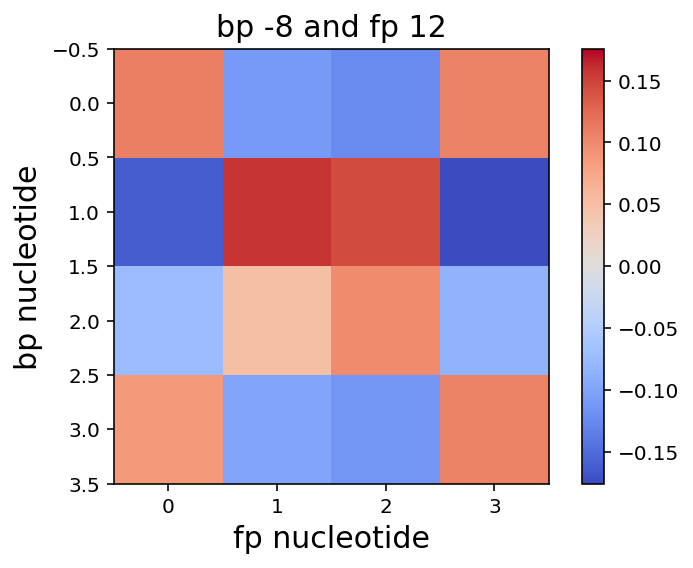

0.00506196970709
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.24', '0.25', '0.28']


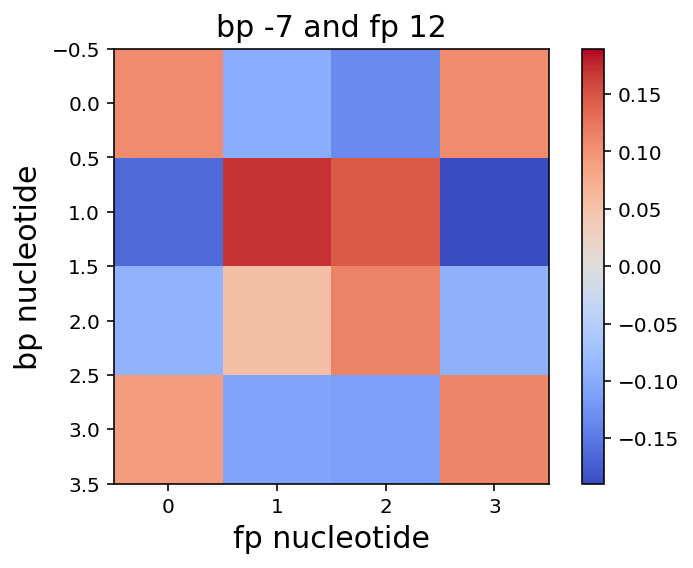

0.00617862165411
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.24', '0.25', '0.28']


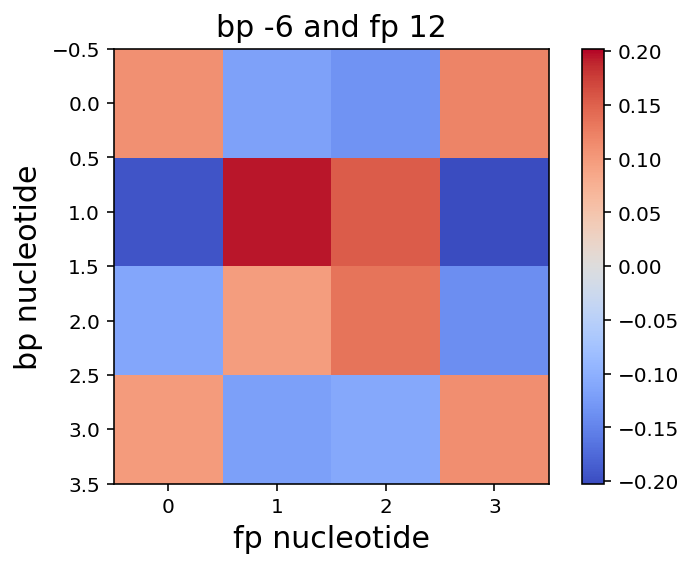

0.00533162911419
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.24', '0.25', '0.28']


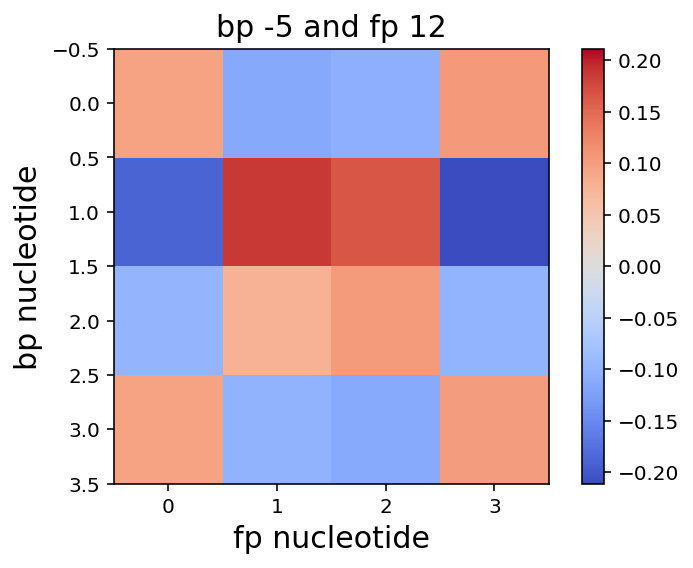

0.00538195118097
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.24', '0.25', '0.28']


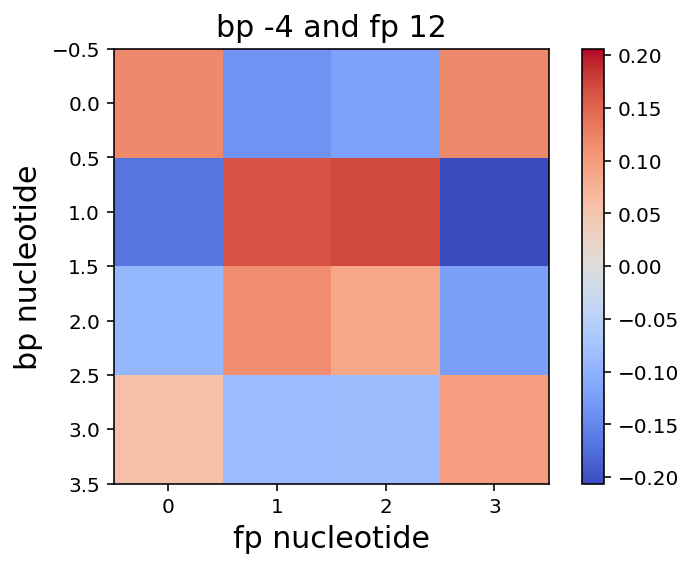

0.00655410103087
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.24', '0.25', '0.28']


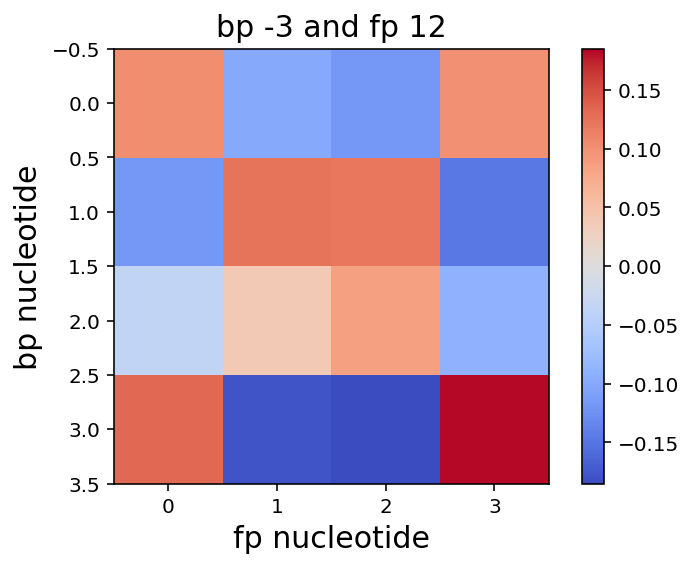

0.0018106355232
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.24', '0.25', '0.28']


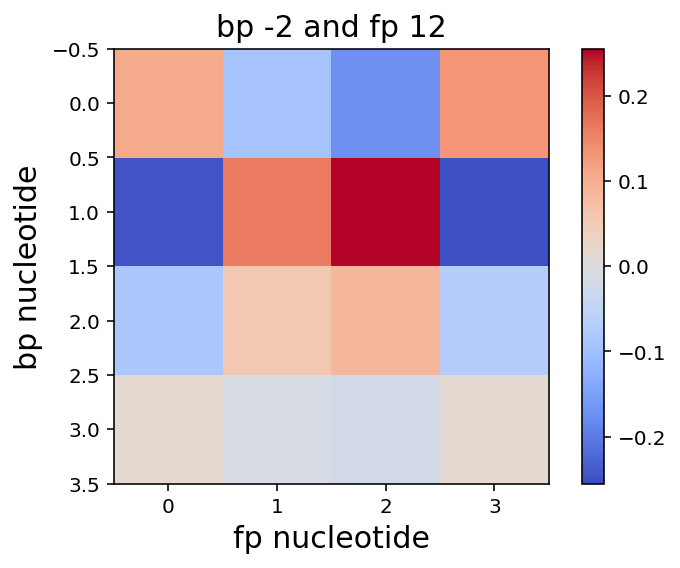

0.00773261304589
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.24', '0.25', '0.28']


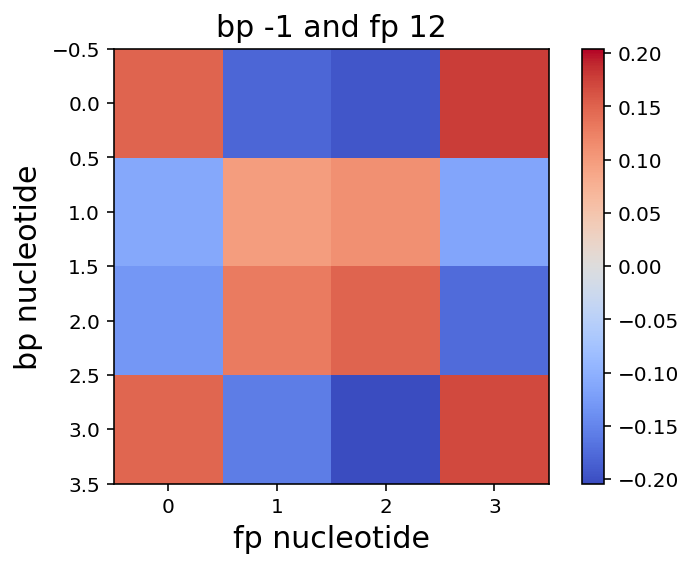

0.000596764988298
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.24', '0.25', '0.28']


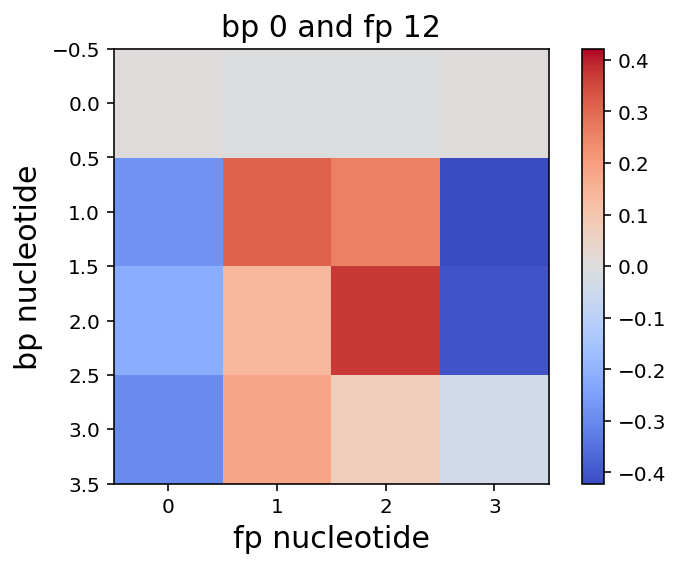

0.00697057721754
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.24', '0.25', '0.28']


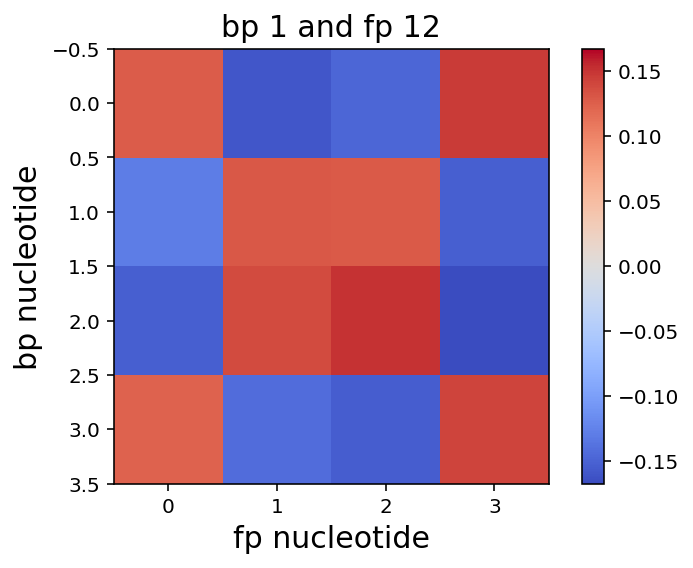

0.00482594254346
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.24', '0.25', '0.28']


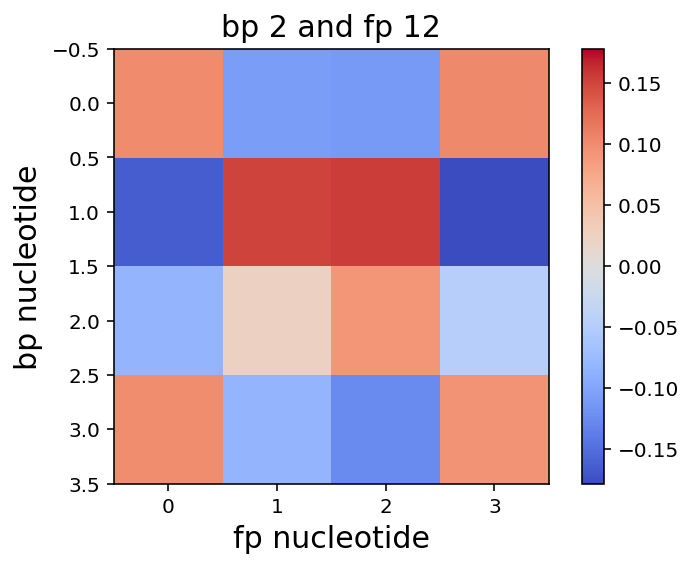

0.0045938992282
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.24', '0.25', '0.28']


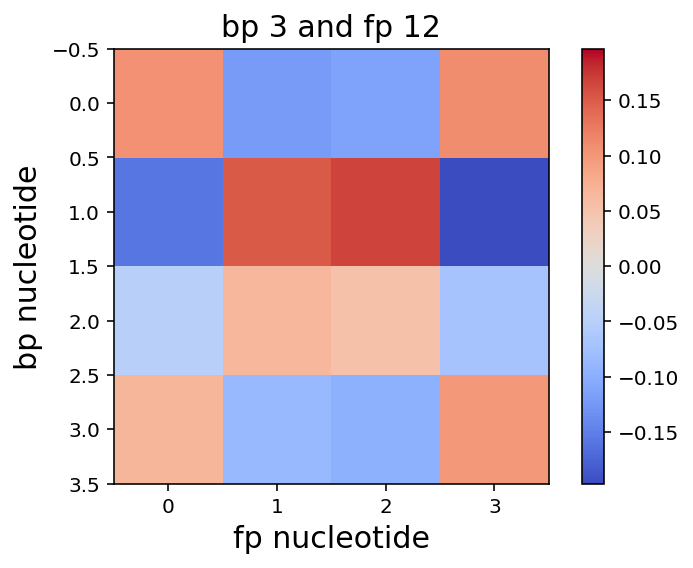

0.00533592618419
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.24', '0.25', '0.28']


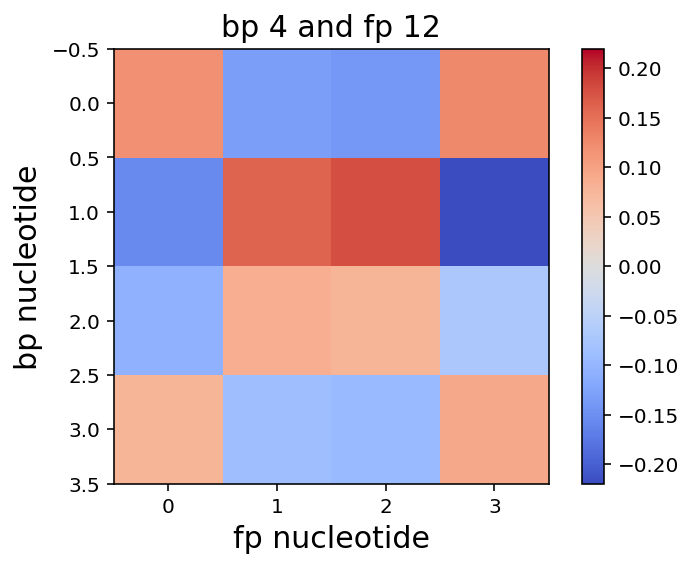

0.00576166689197
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.24', '0.25', '0.28']


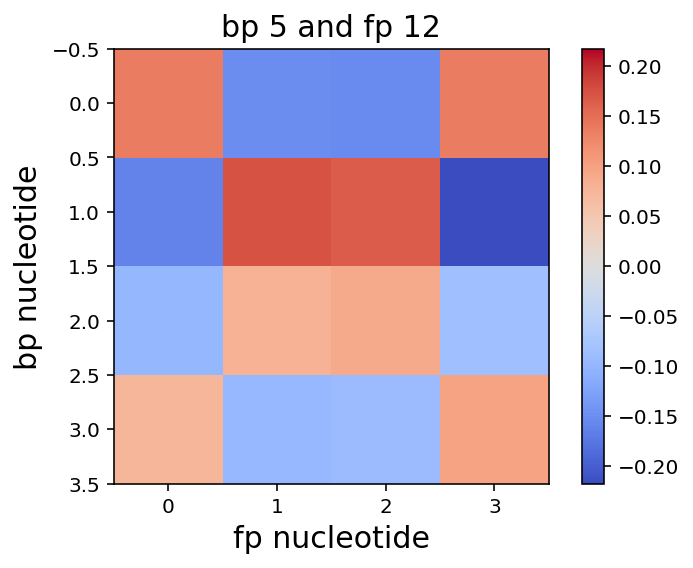

0.00541595312925
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.24', '0.25', '0.28']


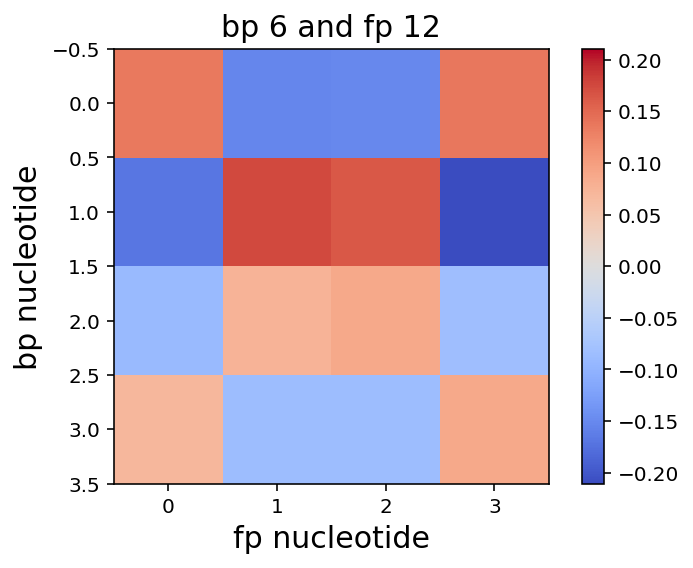

0.00571515771945
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.24', '0.25', '0.28']


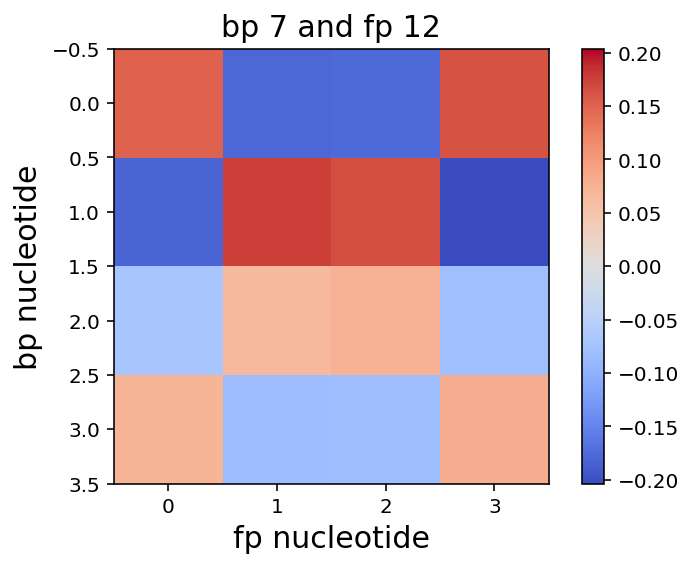

0.00552320746381
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.24', '0.25', '0.28']


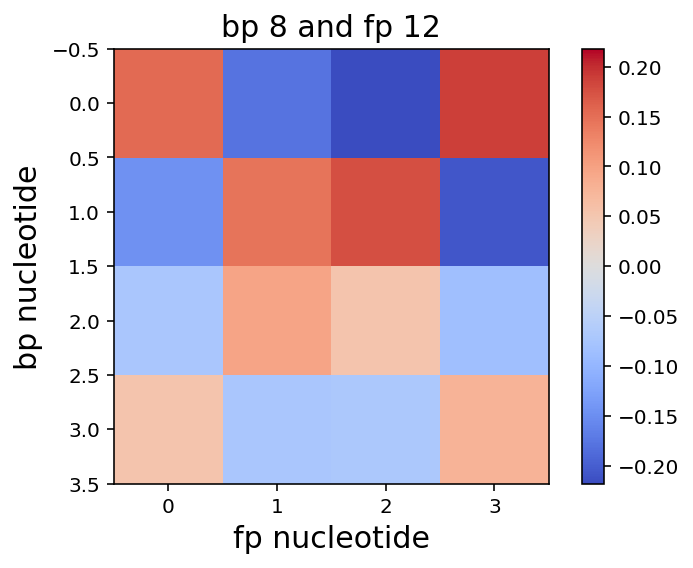

0.00567465942341
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.24', '0.25', '0.28']


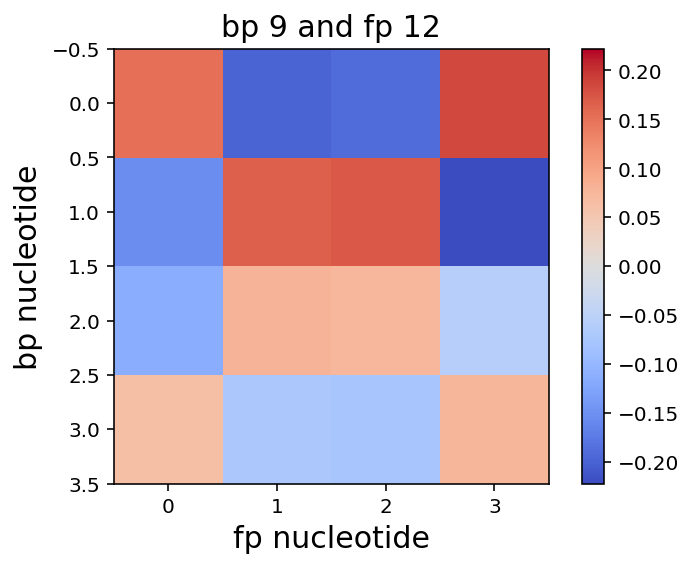

0.00489880662635
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.24', '0.25', '0.28']


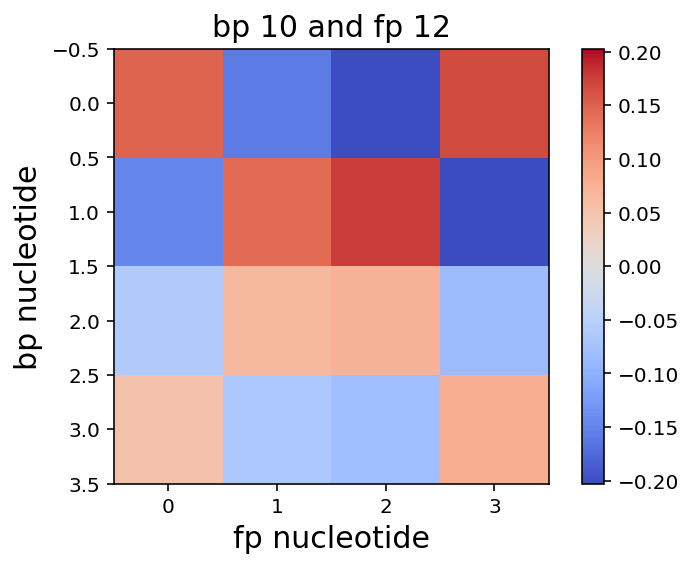

0.00546812109069
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.25', '0.28']


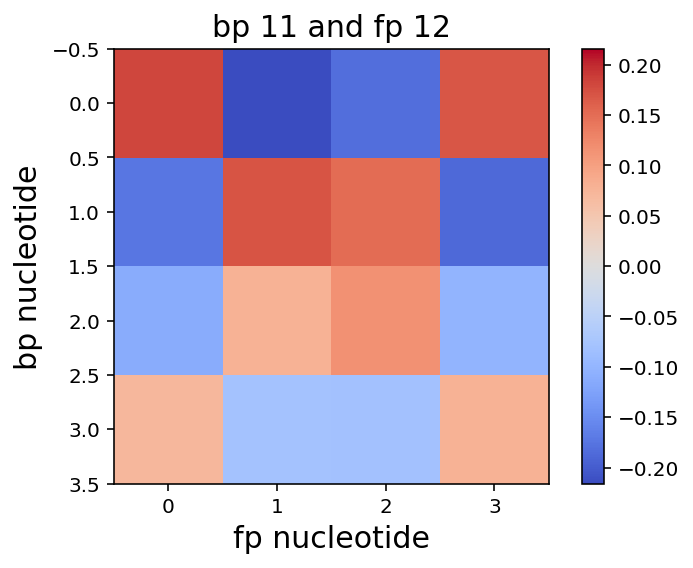

0.00453129912163
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.25', '0.28']


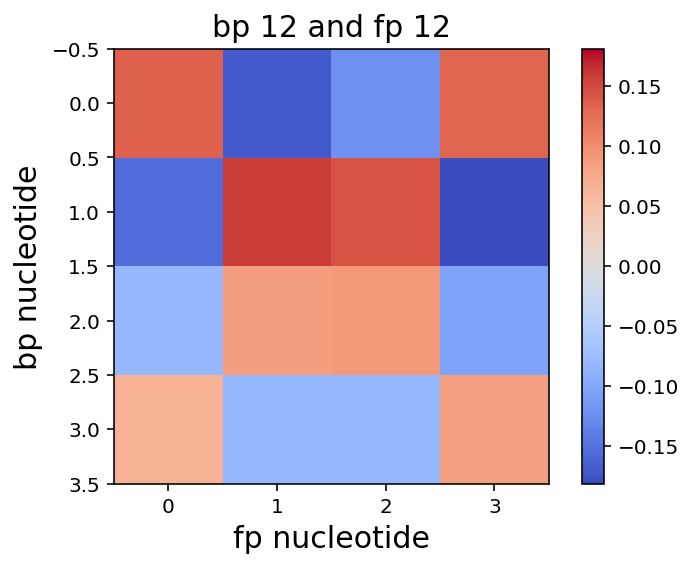

0.00463026883793
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.25', '0.28']


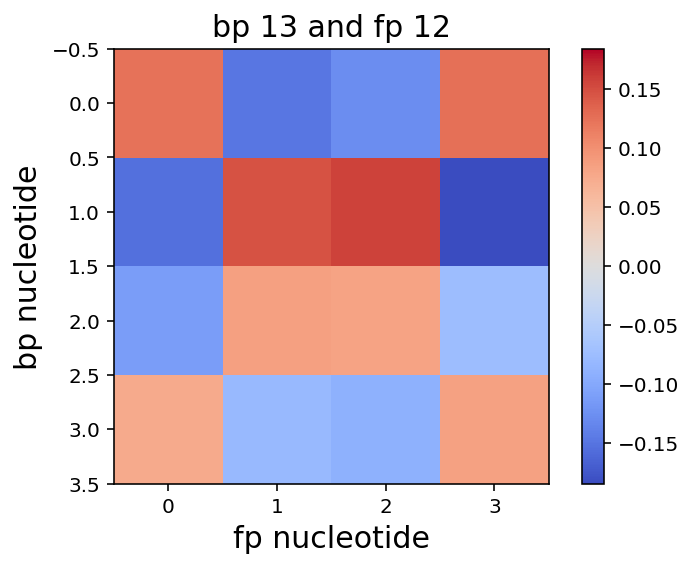

0.00526195865426
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.25', '0.28']


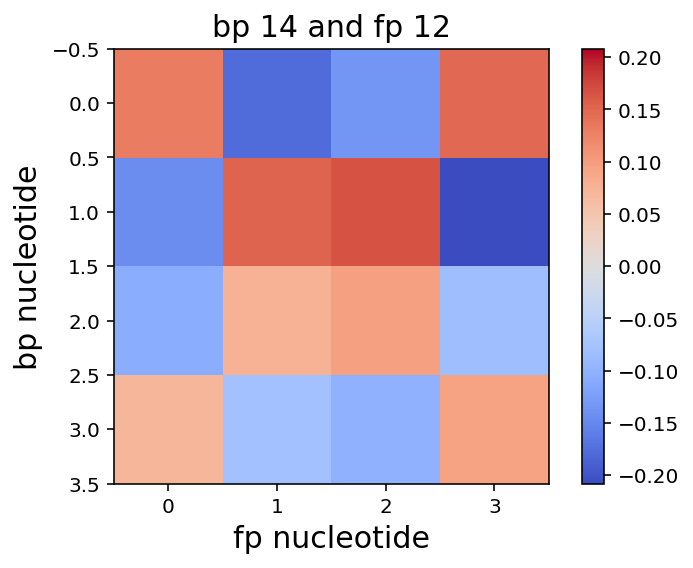

0.00589986650107
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.24', '0.24', '0.29']


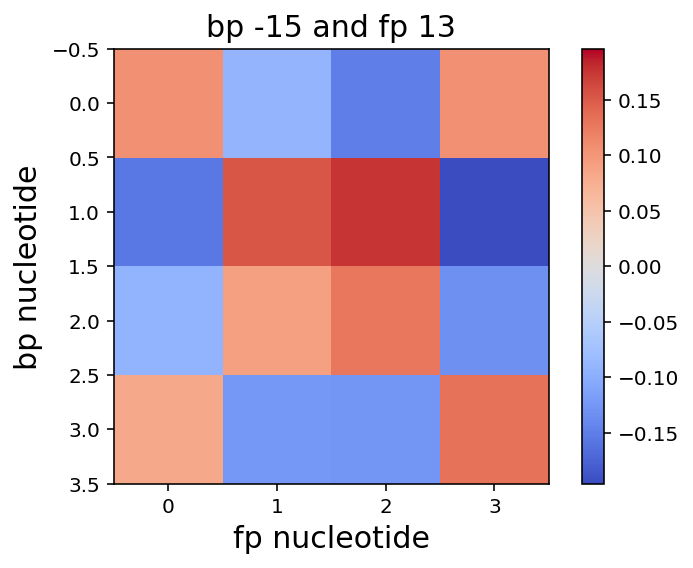

0.00489911862623
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.24', '0.24', '0.29']


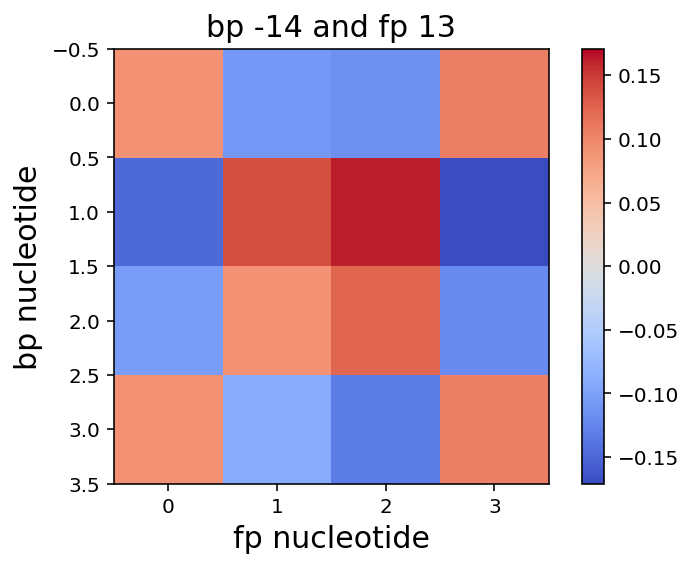

0.00514909733259
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.24', '0.24', '0.29']


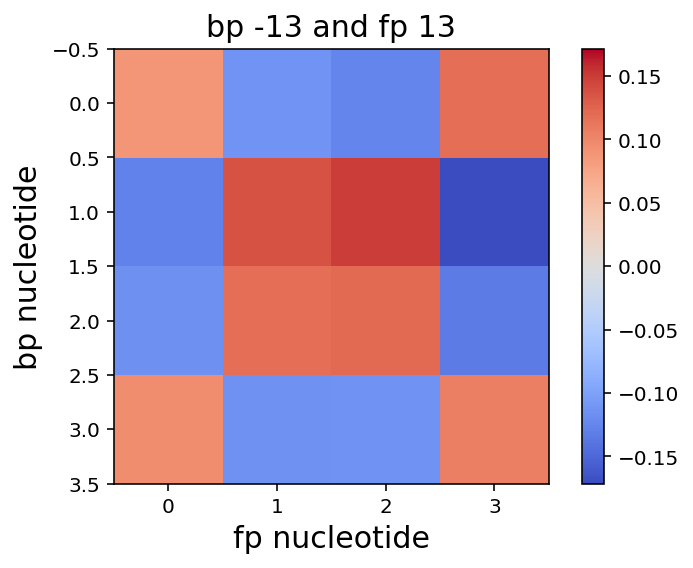

0.00446308490608
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.24', '0.24', '0.29']


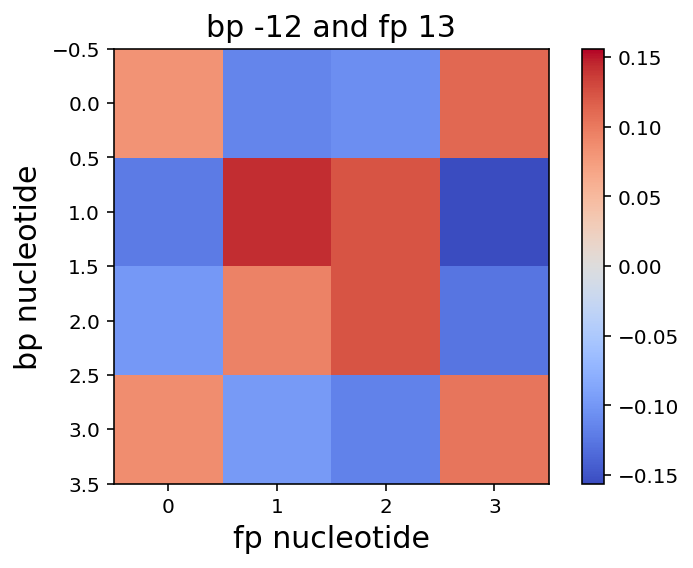

0.00497686856521
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.24', '0.24', '0.29']


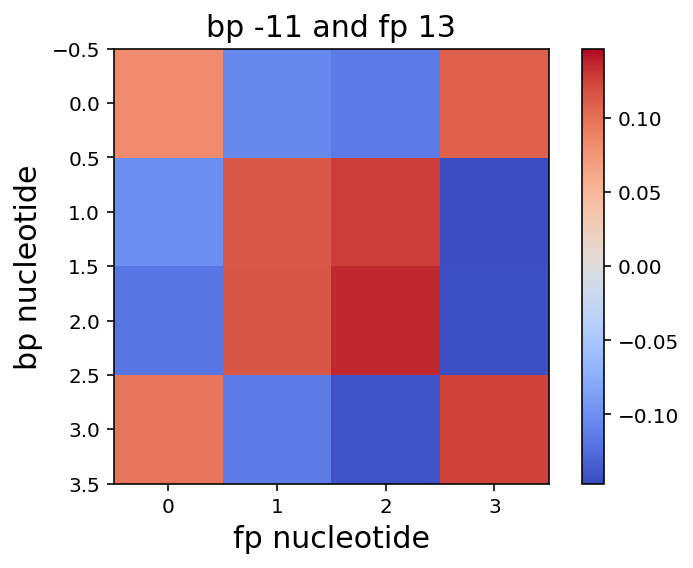

0.00419296376467
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.24', '0.24', '0.29']


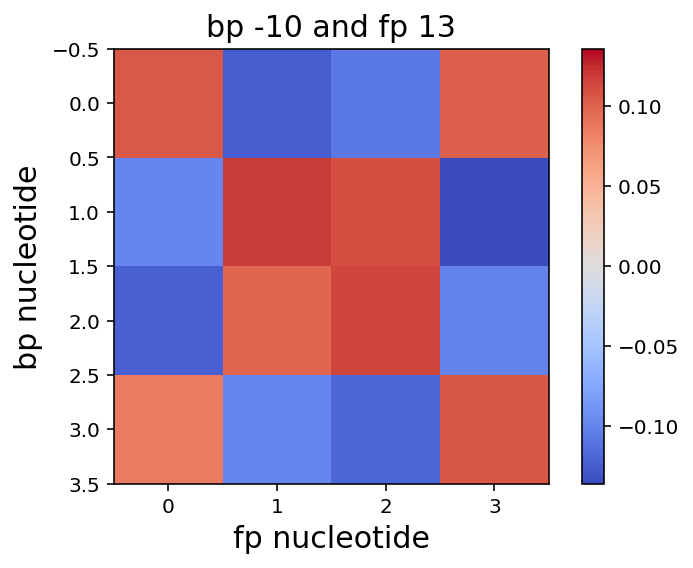

0.00476208449388
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.24', '0.24', '0.29']


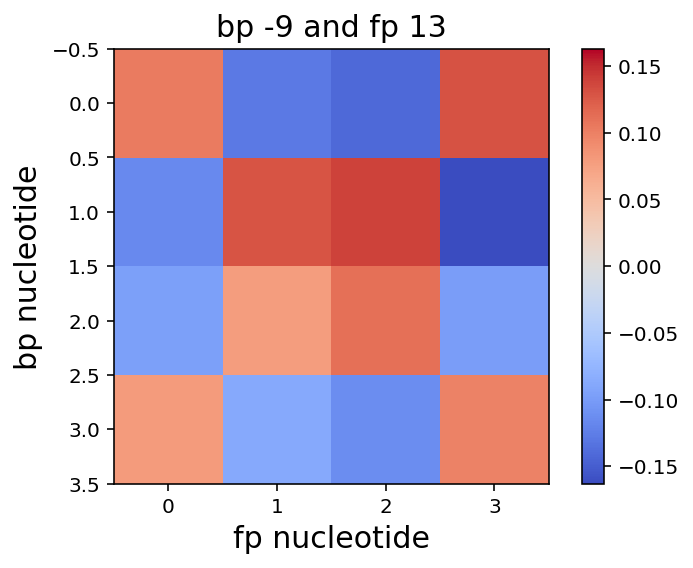

0.00525024061987
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.24', '0.24', '0.29']


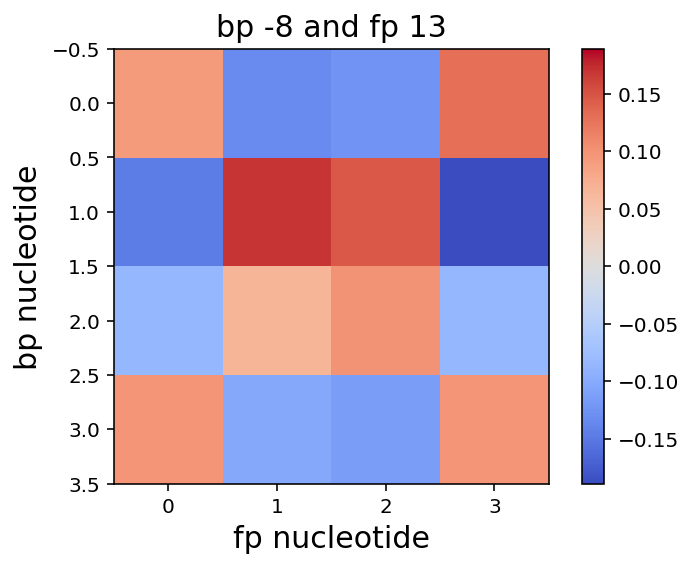

0.00525917611991
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.24', '0.24', '0.29']


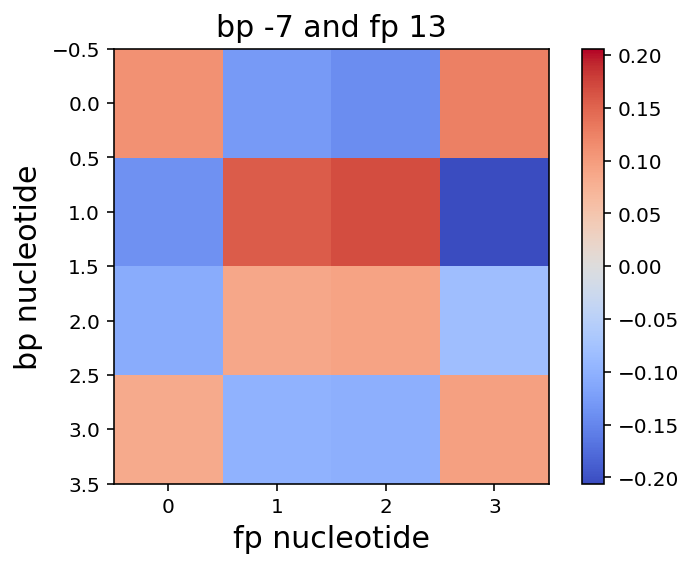

0.0052898732328
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.24', '0.24', '0.29']


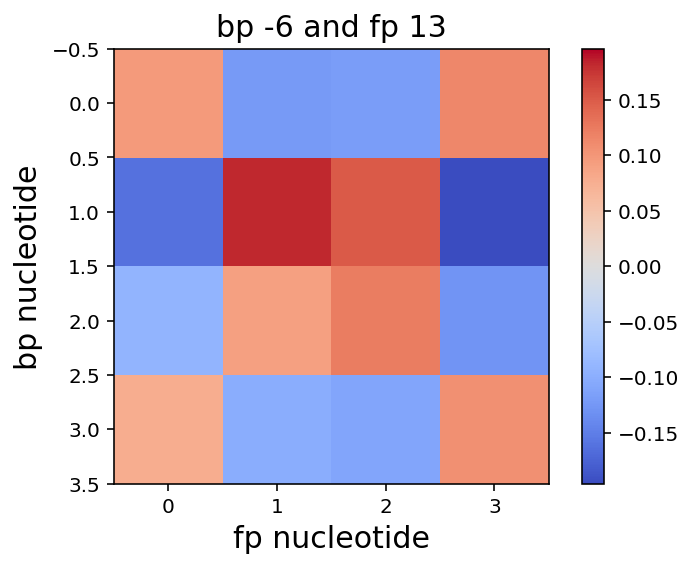

0.00608781251441
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.24', '0.24', '0.29']


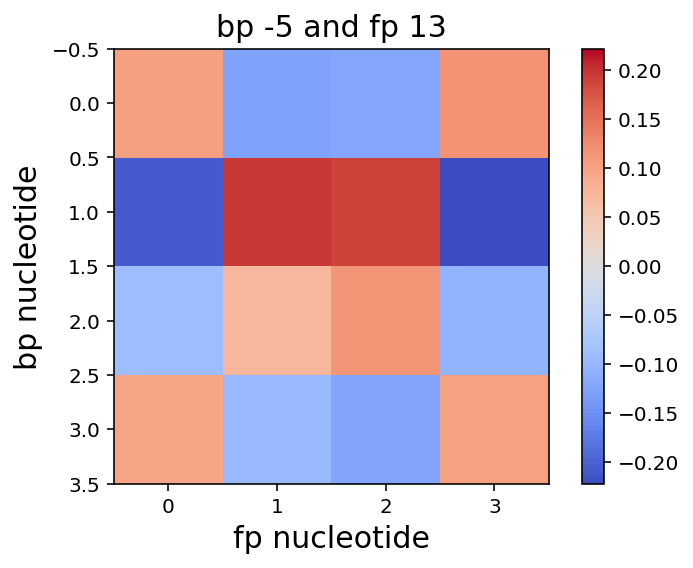

0.00515791214851
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.24', '0.24', '0.29']


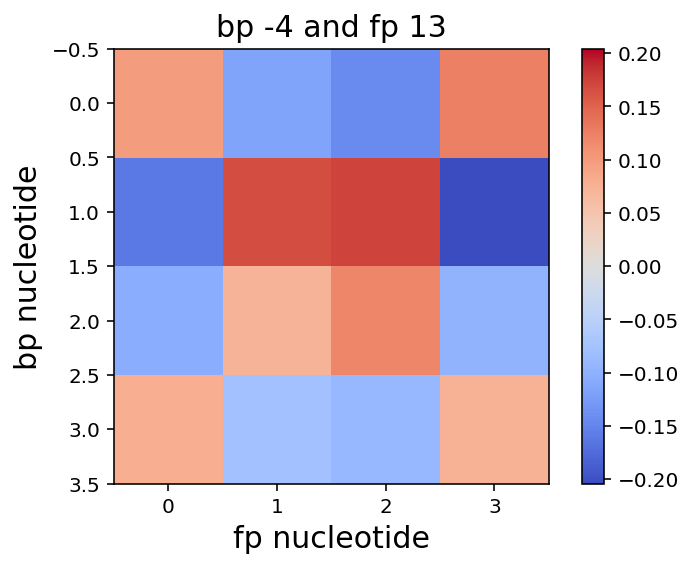

0.00580674940422
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.24', '0.24', '0.29']


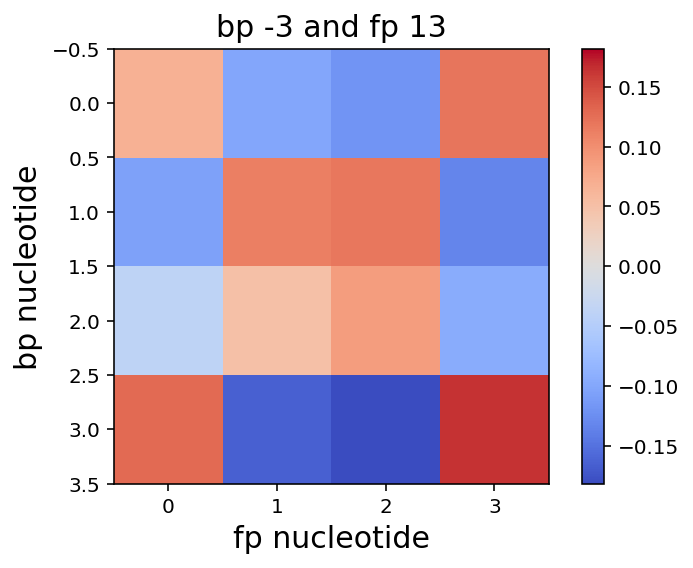

0.00204171175002
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.24', '0.24', '0.29']


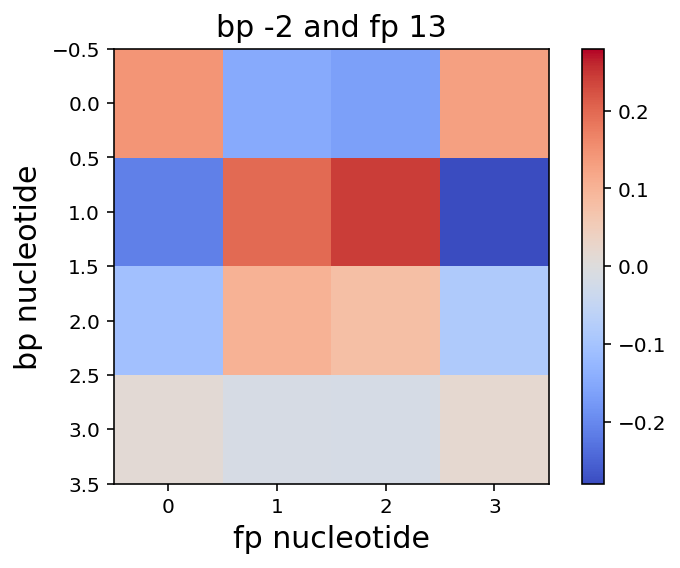

0.00830659803348
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.24', '0.24', '0.29']


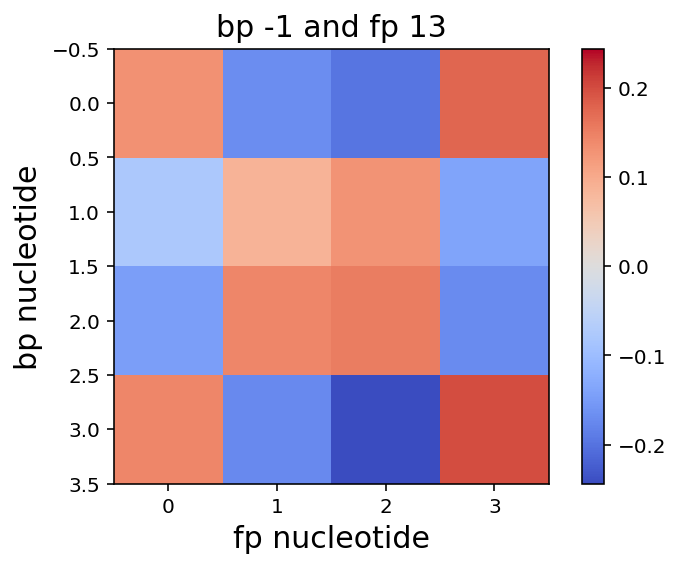

0.000549438227
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.24', '0.24', '0.29']


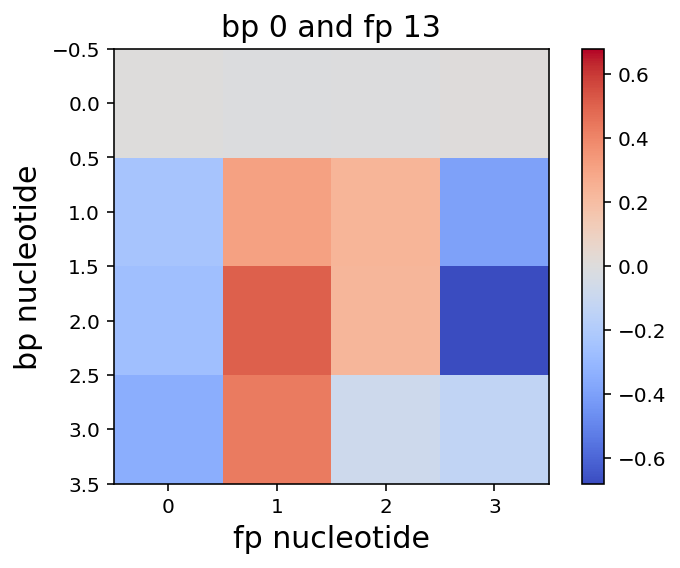

0.00680366161876
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.24', '0.24', '0.29']


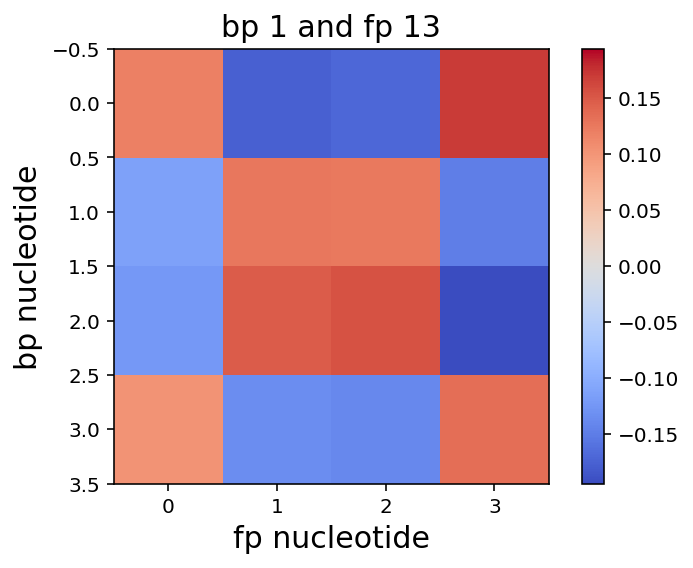

0.00521916386473
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.24', '0.24', '0.29']


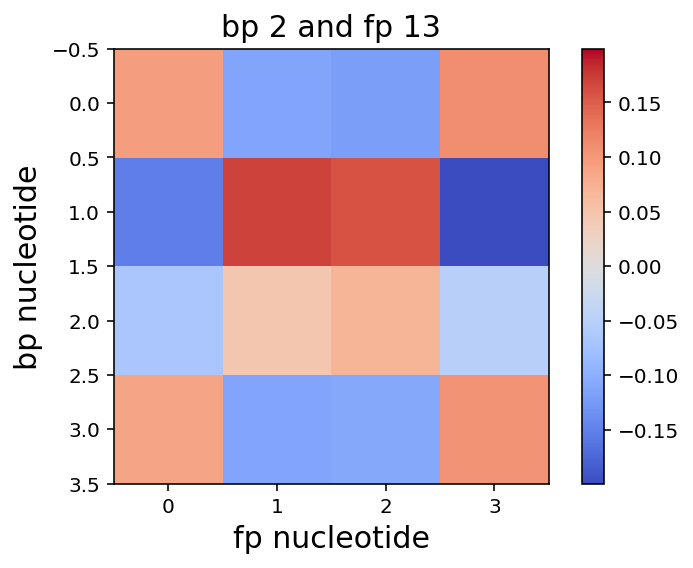

0.0041875332333
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.24', '0.24', '0.29']


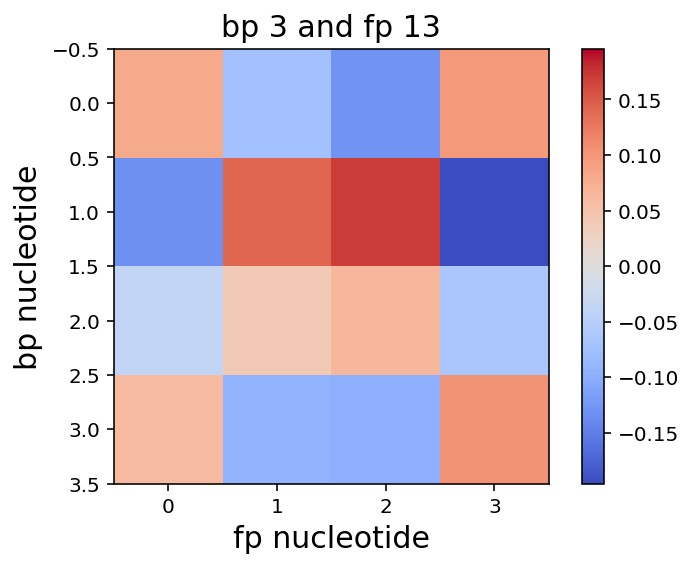

0.00516503543498
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.24', '0.24', '0.29']


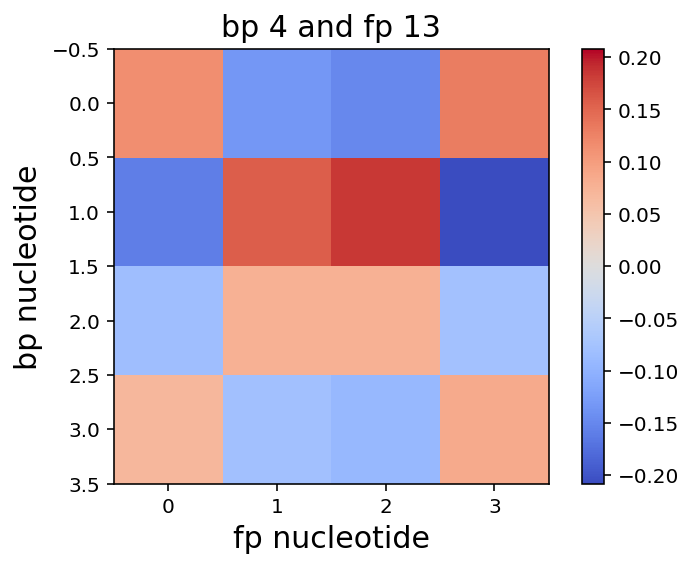

0.00542074722101
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.24', '0.24', '0.29']


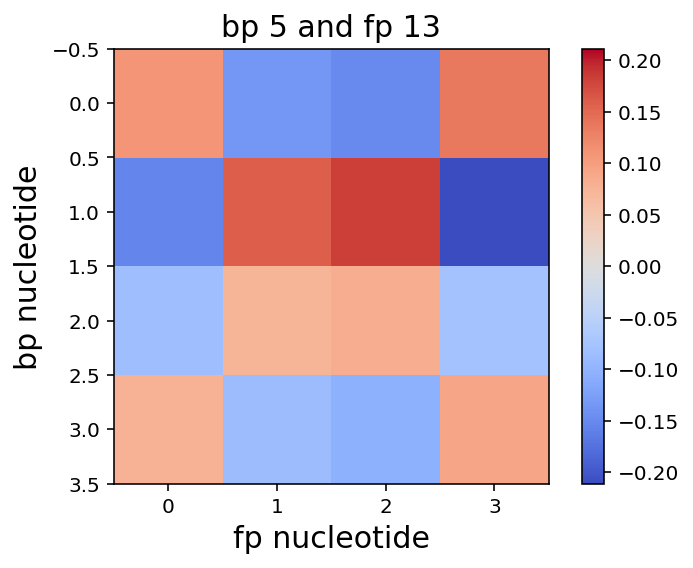

0.00483724469146
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.24', '0.24', '0.29']


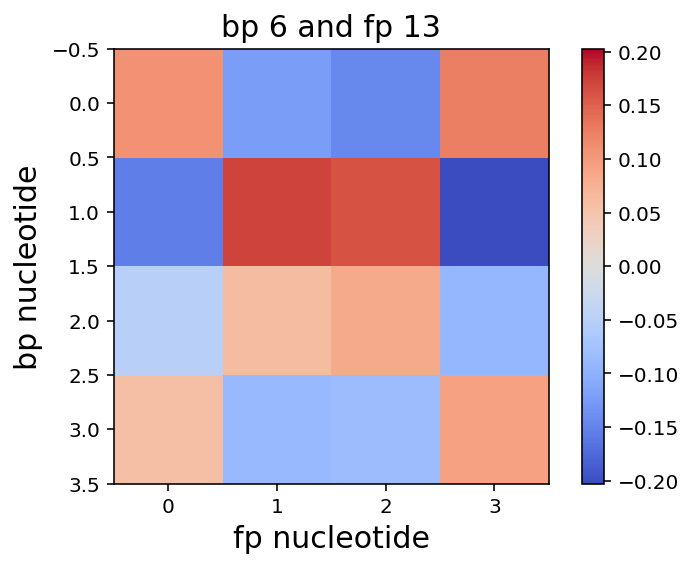

0.00544654393434
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.24', '0.24', '0.29']


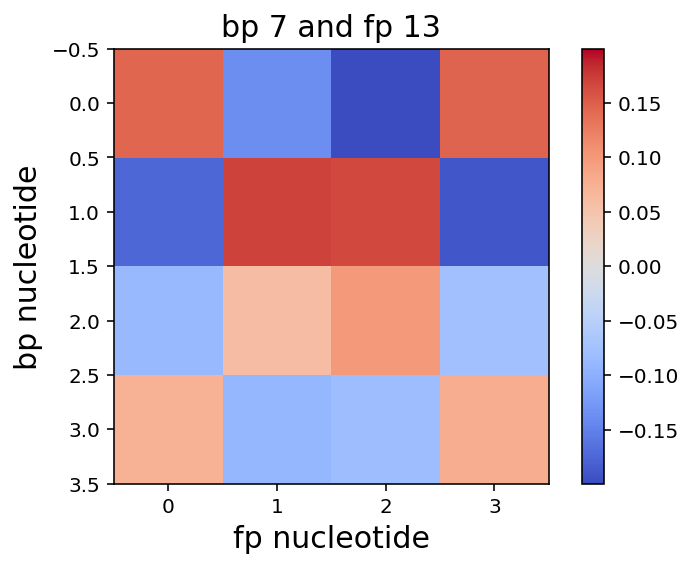

0.00535155411228
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.24', '0.24', '0.29']


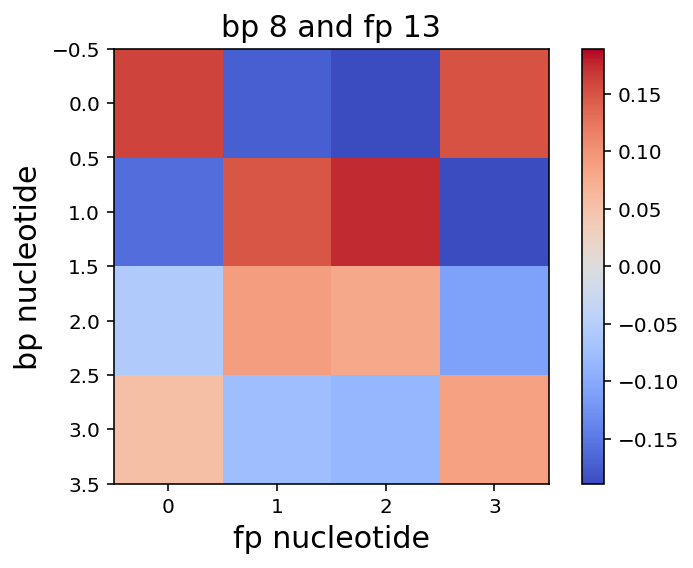

0.00494759358533
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.24', '0.24', '0.29']


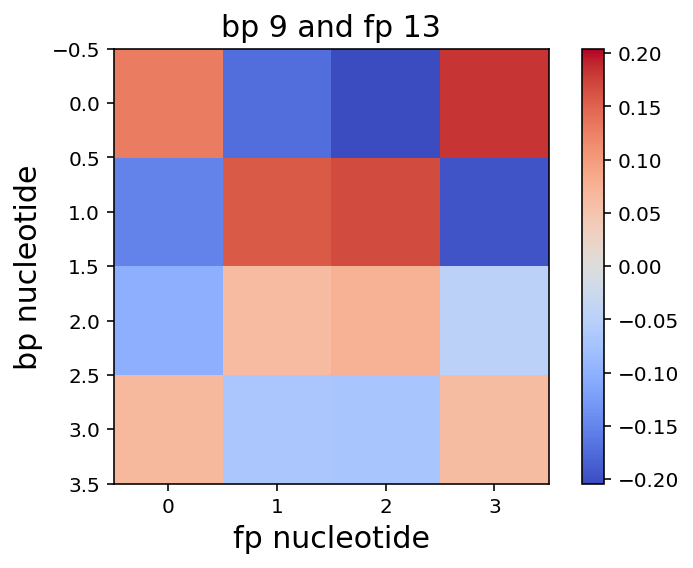

0.00493530502611
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.24', '0.24', '0.29']


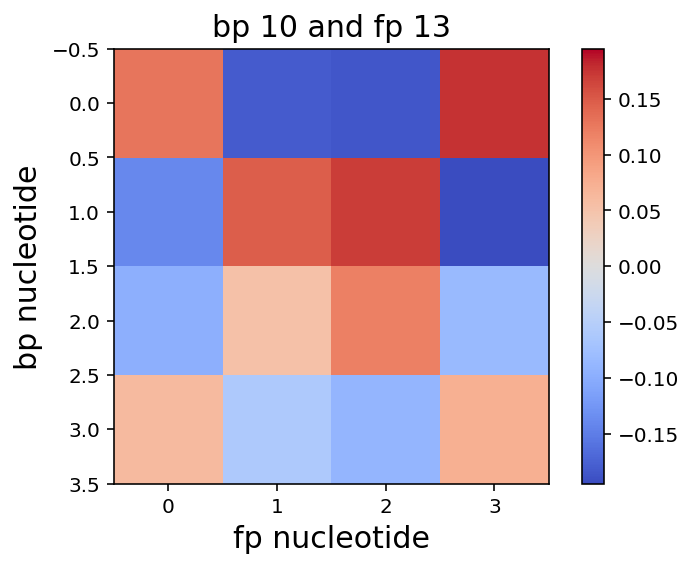

0.0047106416021
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.24', '0.29']


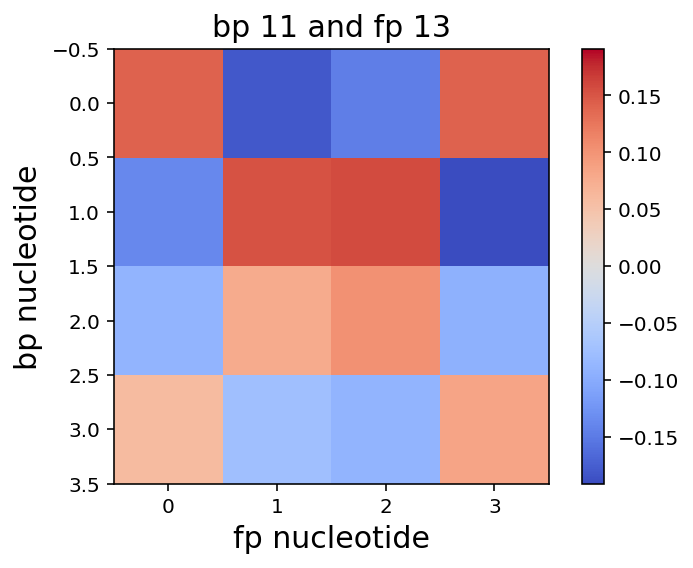

0.0042759275939
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.24', '0.29']


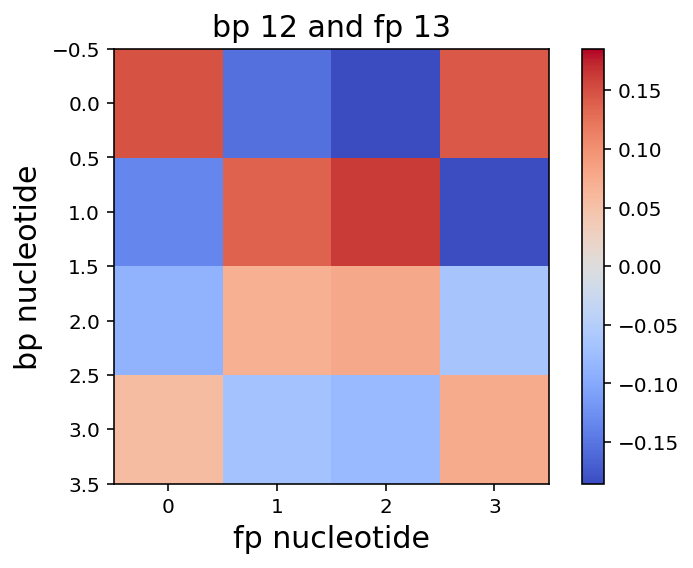

0.00481827108145
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.24', '0.29']


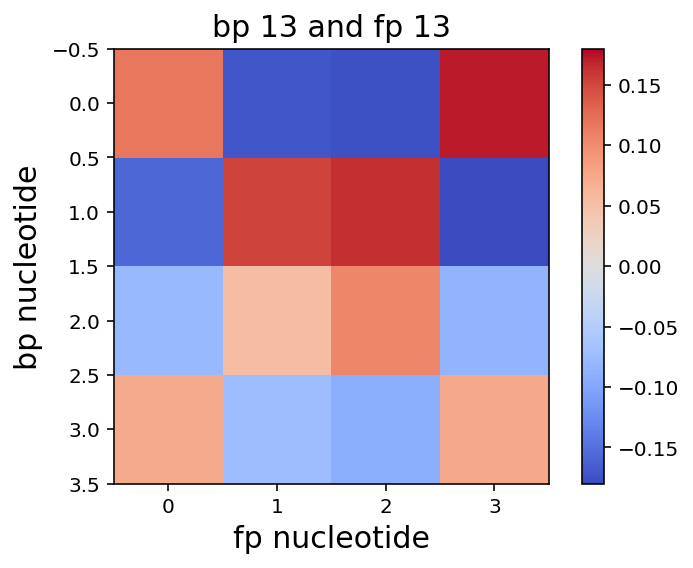

0.00454999099294
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.24', '0.29']


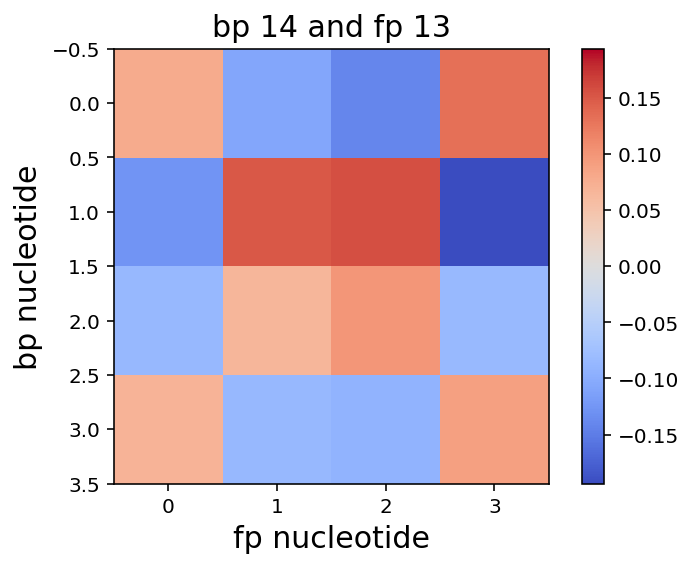

0.00518921603942
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.24', '0.25', '0.28']


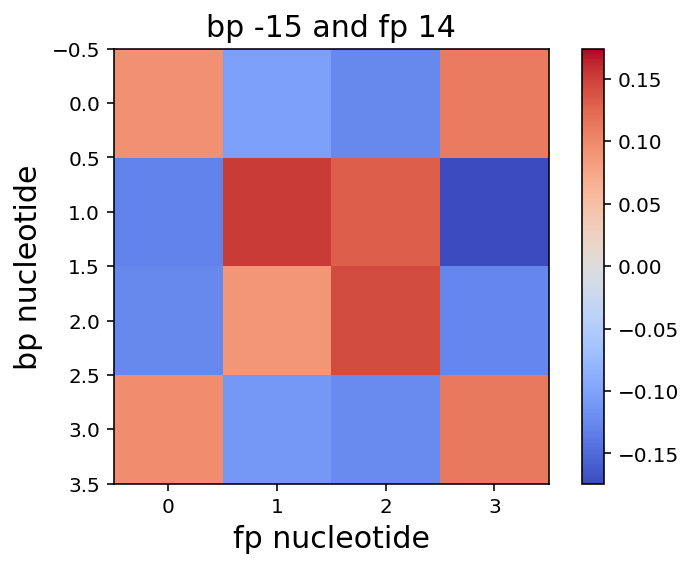

0.00515006090804
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.24', '0.25', '0.28']


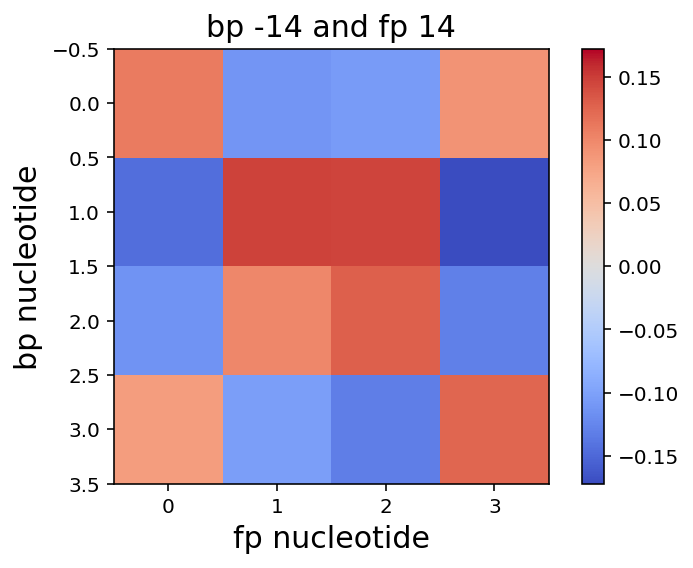

0.00505615255339
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.24', '0.25', '0.28']


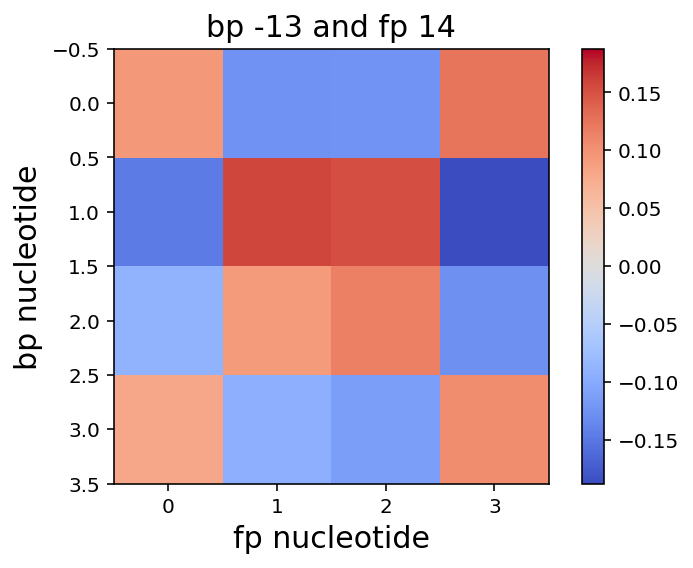

0.00446383584415
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.24', '0.25', '0.28']


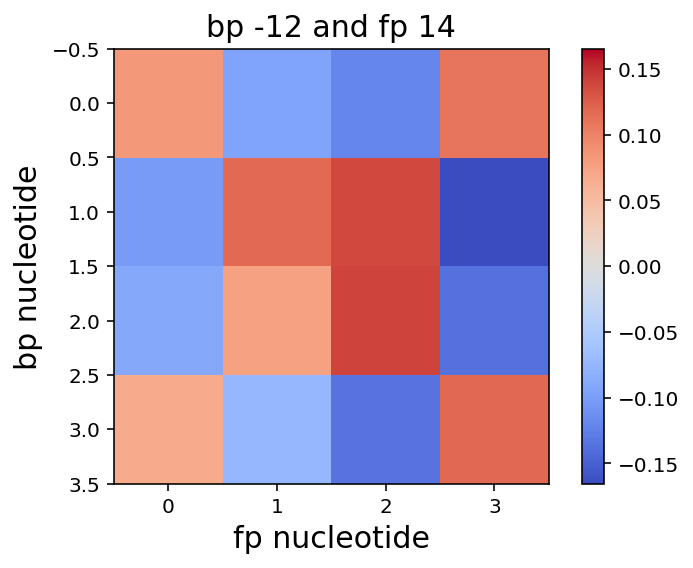

0.00461786301404
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.24', '0.25', '0.28']


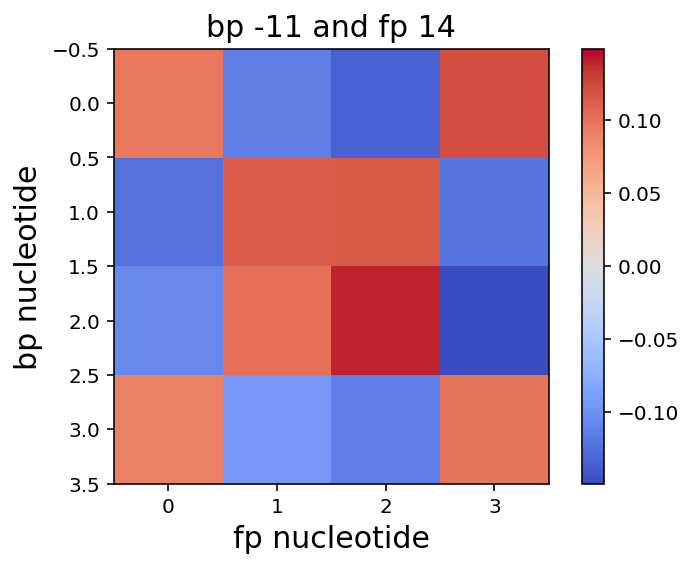

0.00466368501093
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.24', '0.25', '0.28']


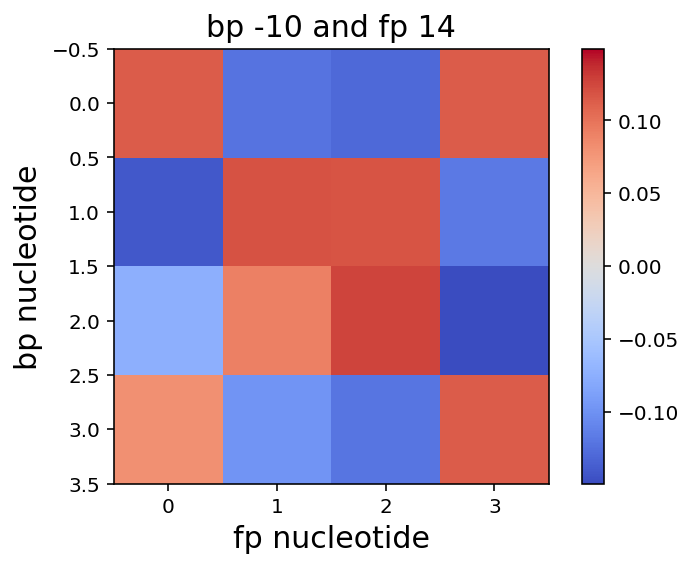

0.00478152012177
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.24', '0.25', '0.28']


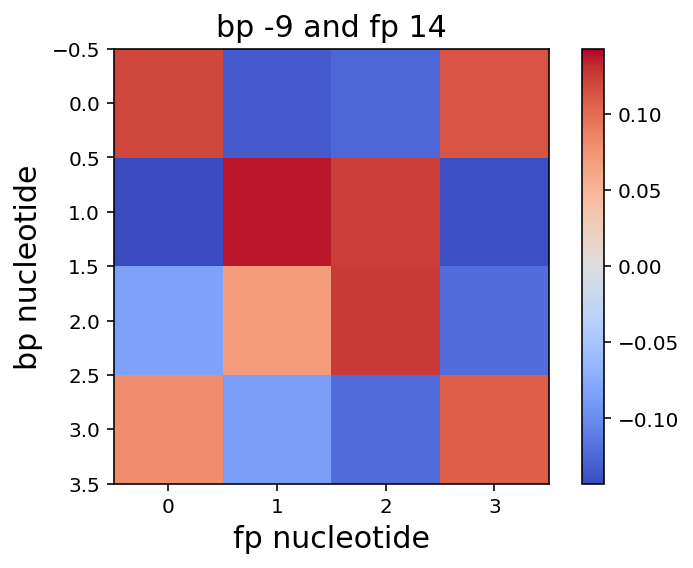

0.004839508891
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.24', '0.25', '0.28']


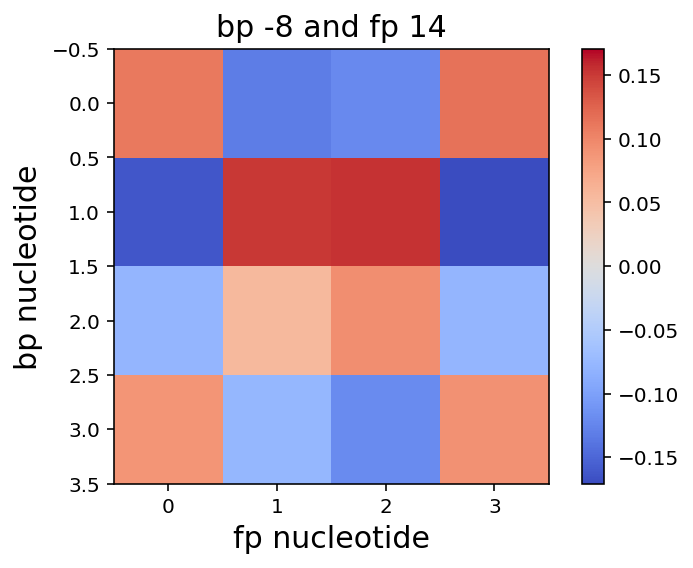

0.00485403422555
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.24', '0.25', '0.28']


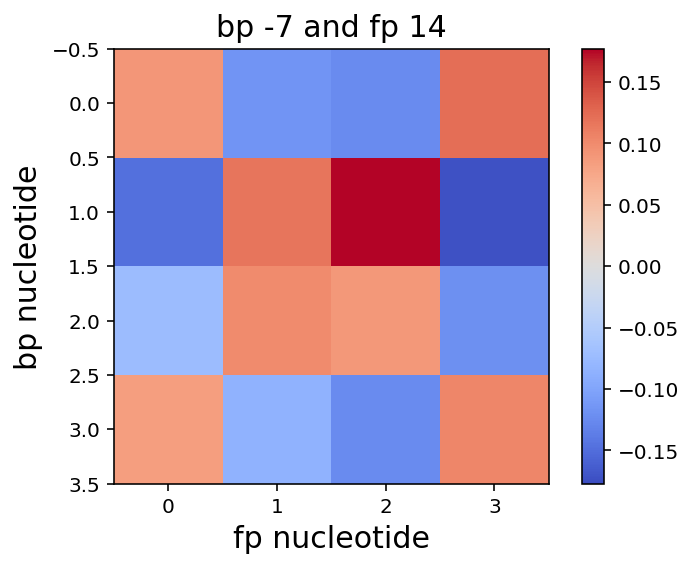

0.00576727527357
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.24', '0.25', '0.28']


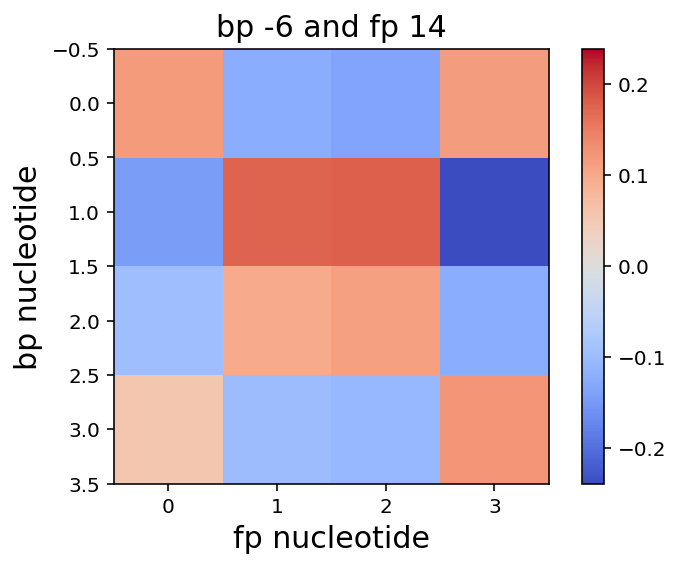

0.00579555365517
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.24', '0.25', '0.28']


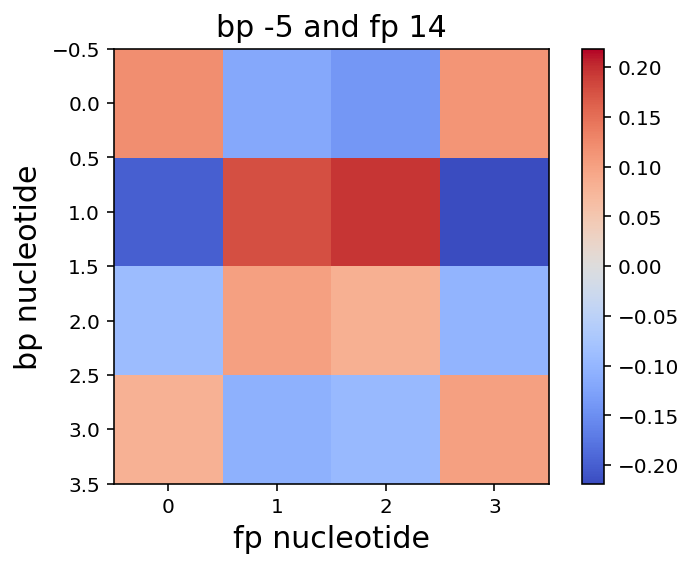

0.00547455853766
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.24', '0.25', '0.28']


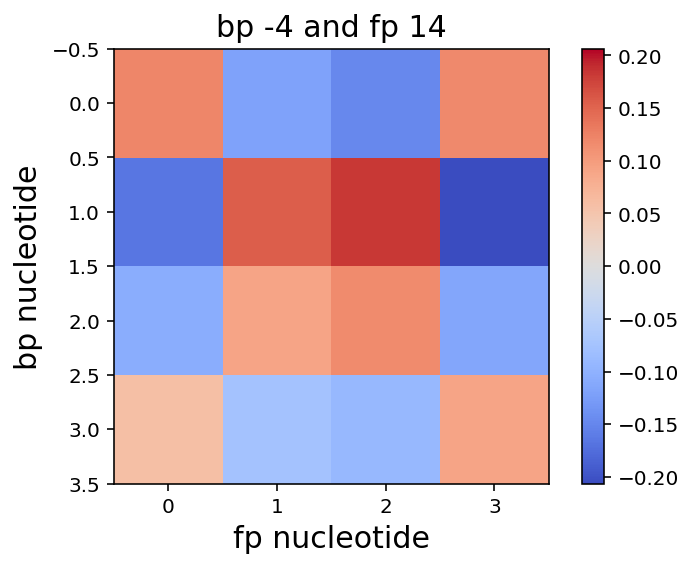

0.00608974784288
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.24', '0.25', '0.28']


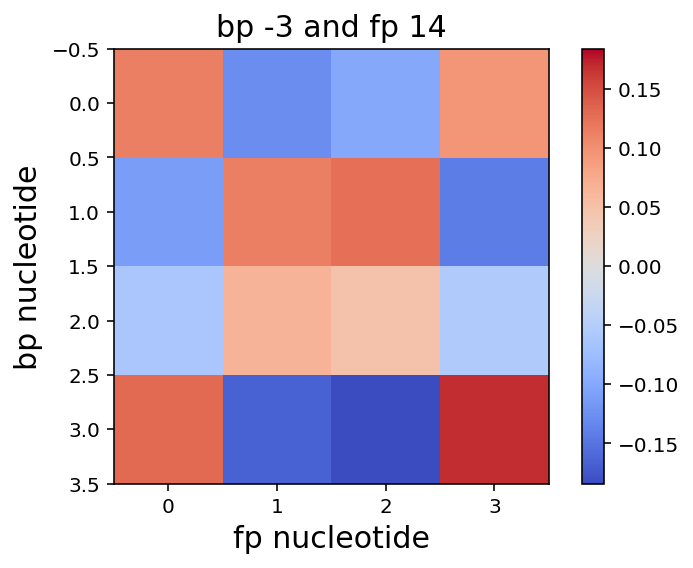

0.0018650048013
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.24', '0.25', '0.28']


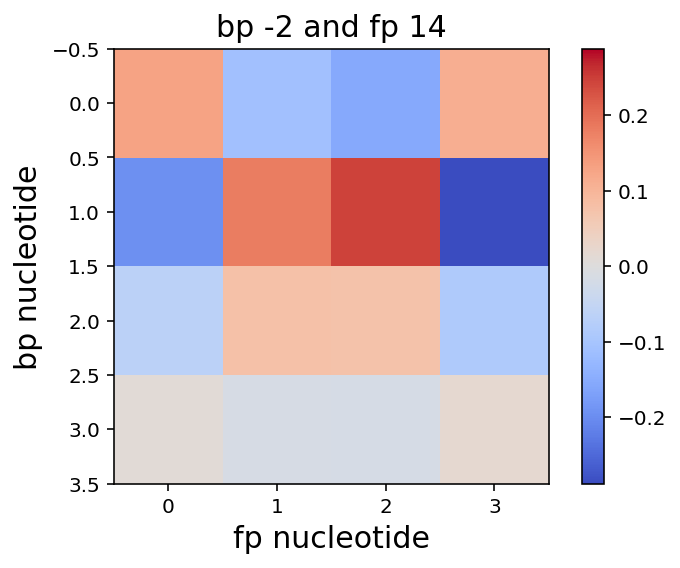

0.00760483859245
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.24', '0.25', '0.28']


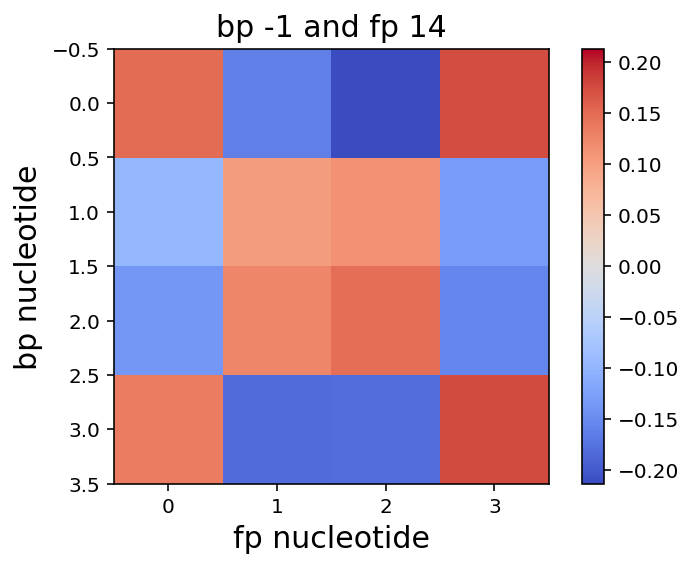

0.000627880193353
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.24', '0.25', '0.28']


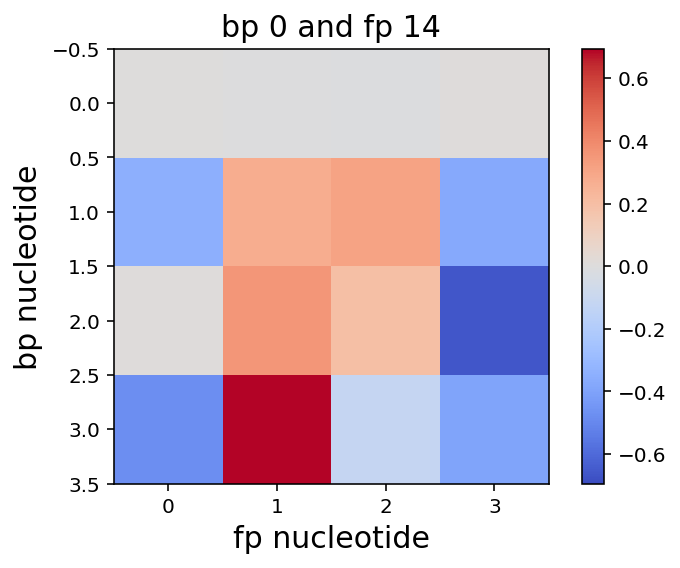

0.00710407882241
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.24', '0.25', '0.28']


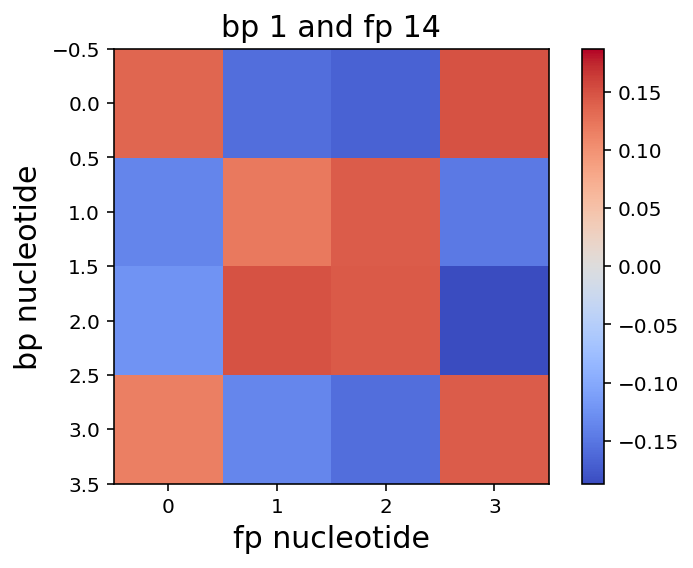

0.00486539435589
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.24', '0.25', '0.28']


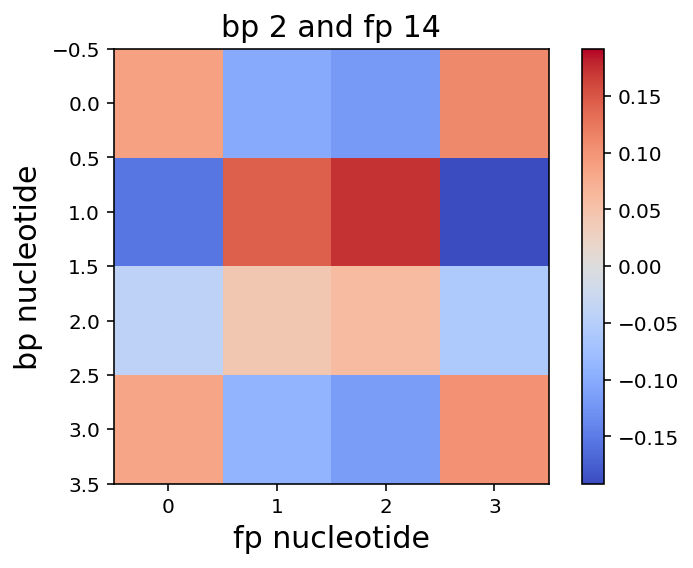

0.00480492303677
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.24', '0.25', '0.28']


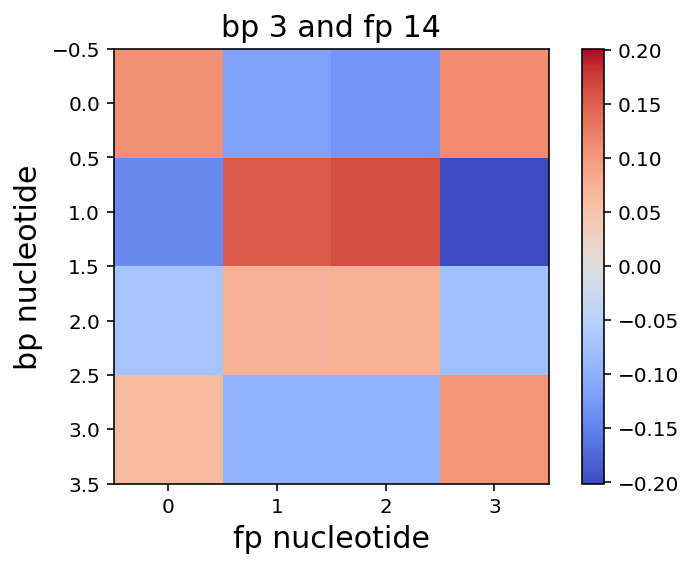

0.00501386811725
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.24', '0.25', '0.28']


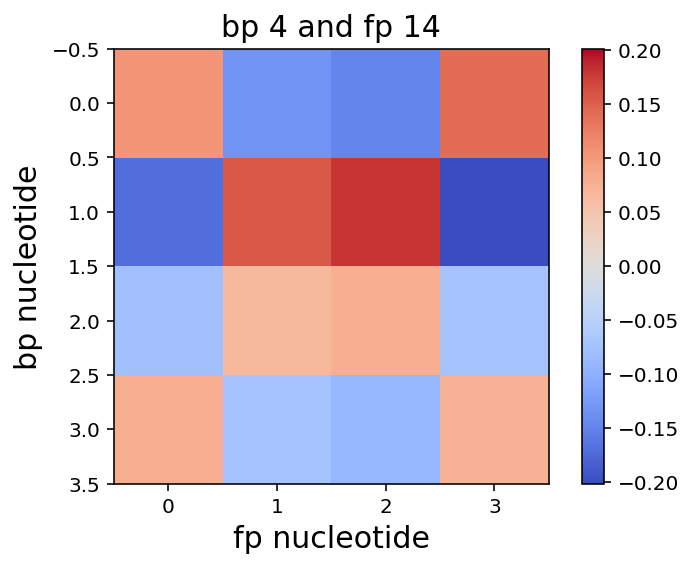

0.00563797361393
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.24', '0.25', '0.28']


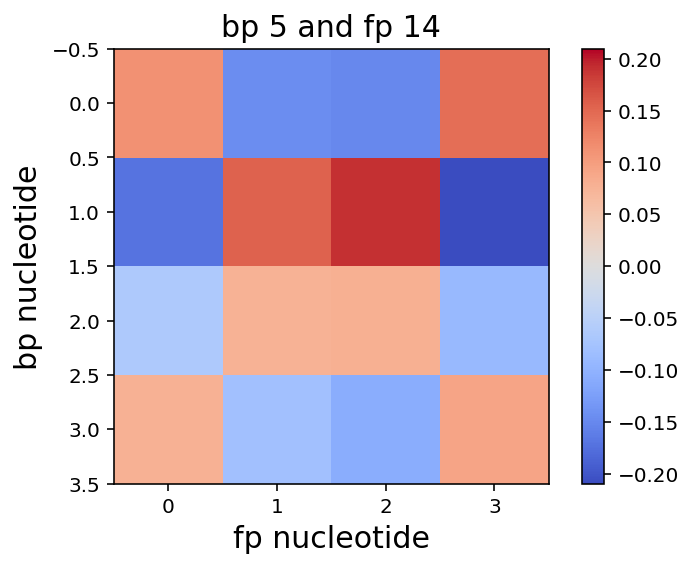

0.00545823999664
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.24', '0.25', '0.28']


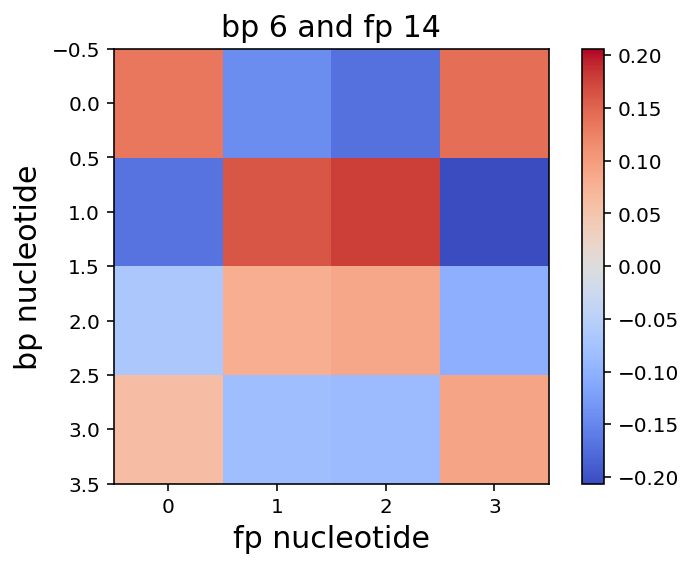

0.00557323708948
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.24', '0.25', '0.28']


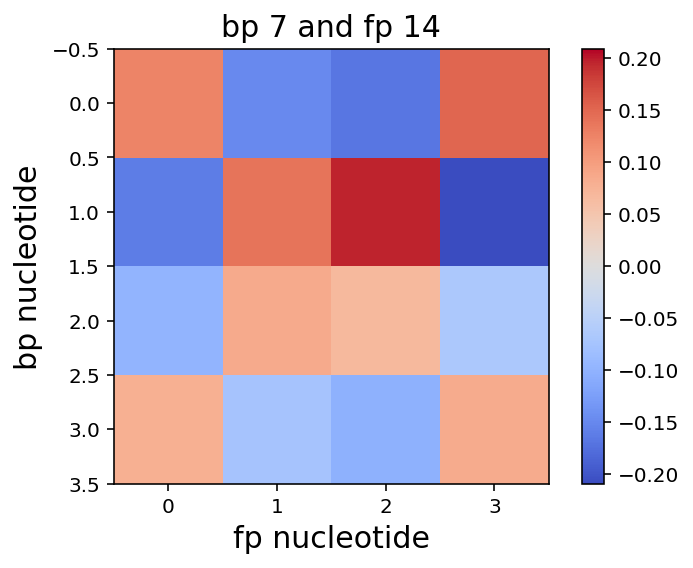

0.00606736515387
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.24', '0.25', '0.28']


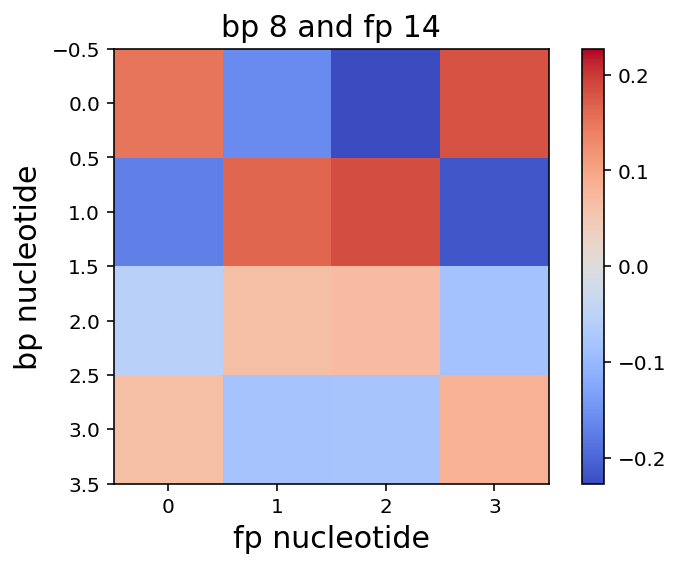

0.00513736724172
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.24', '0.25', '0.28']


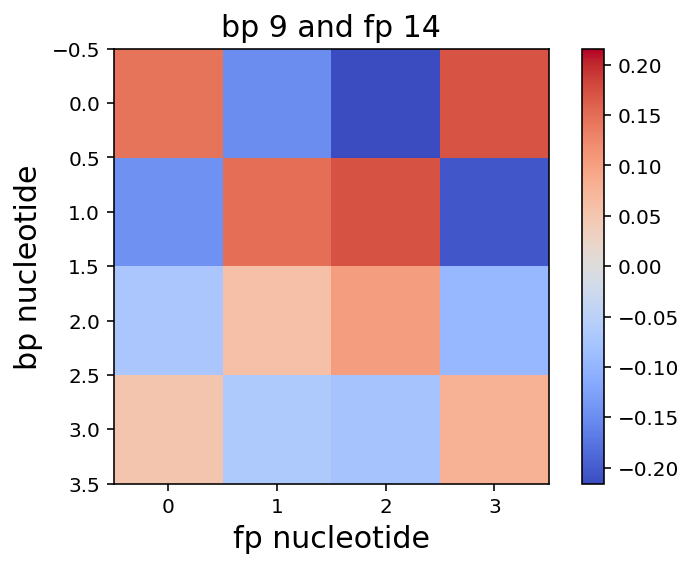

0.00511524977094
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.24', '0.25', '0.28']


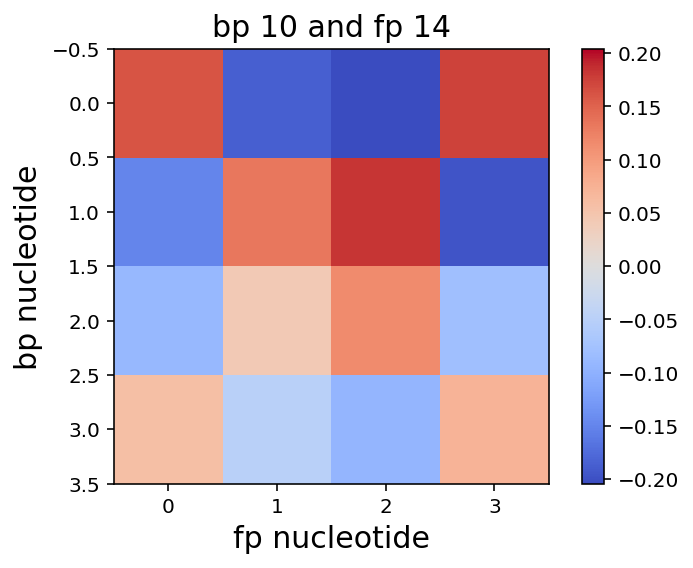

0.00496498099187
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.25', '0.28']


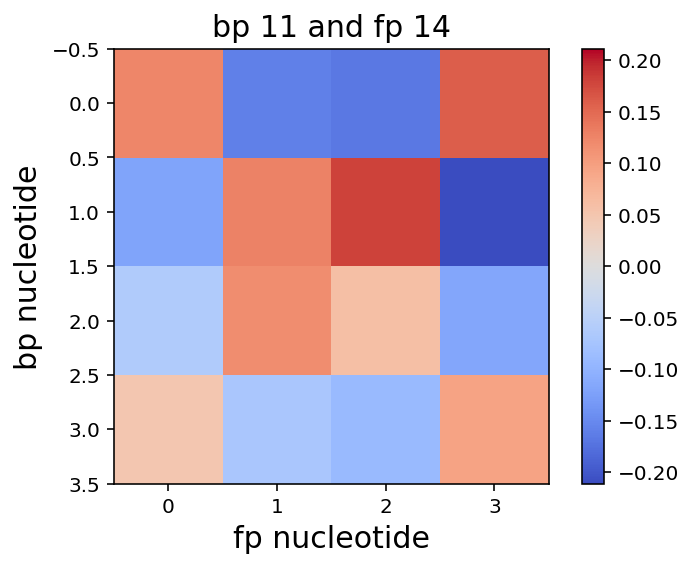

0.00453340917656
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.24', '0.25', '0.28']


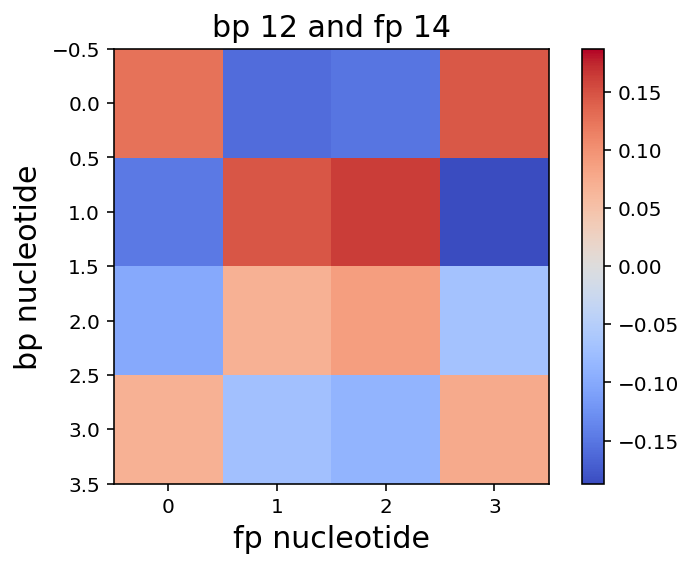

0.00484263220272
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.25', '0.28']


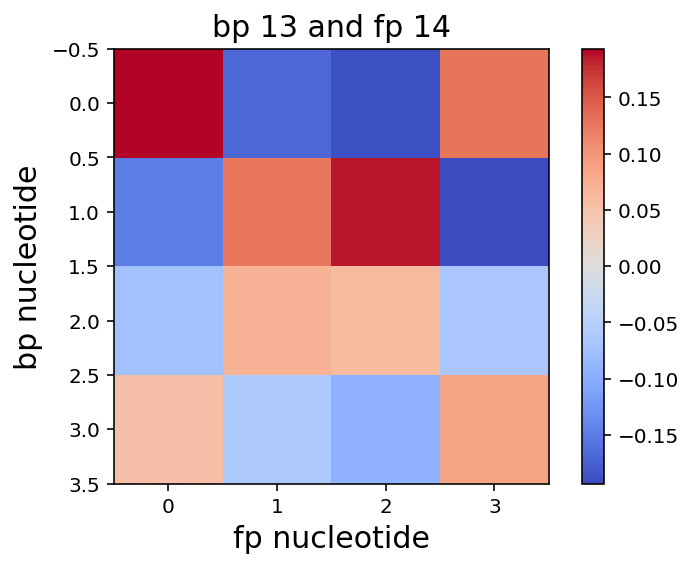

0.00505132825074
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.24', '0.25', '0.28']


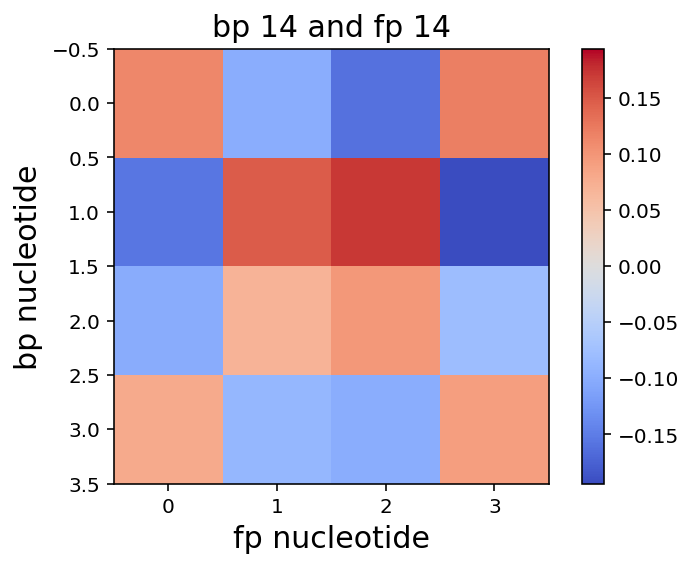

0.00530642460645
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.23', '0.25', '0.29']


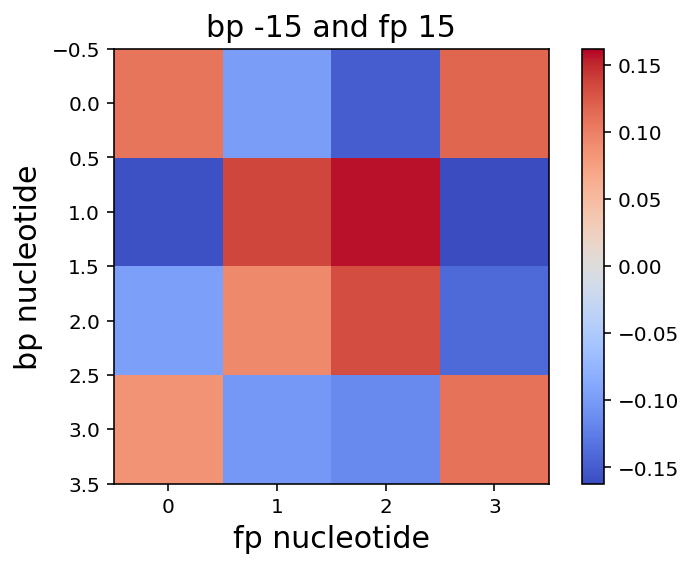

0.00444193791482
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.23', '0.25', '0.29']


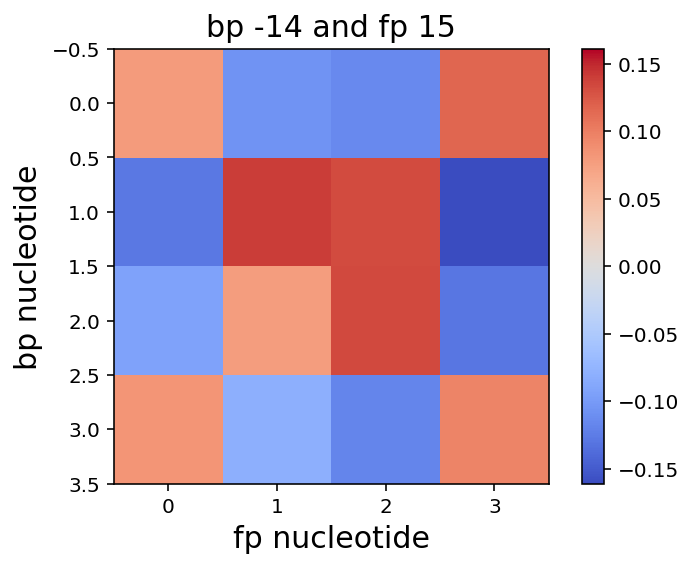

0.00506735441388
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.23', '0.25', '0.29']


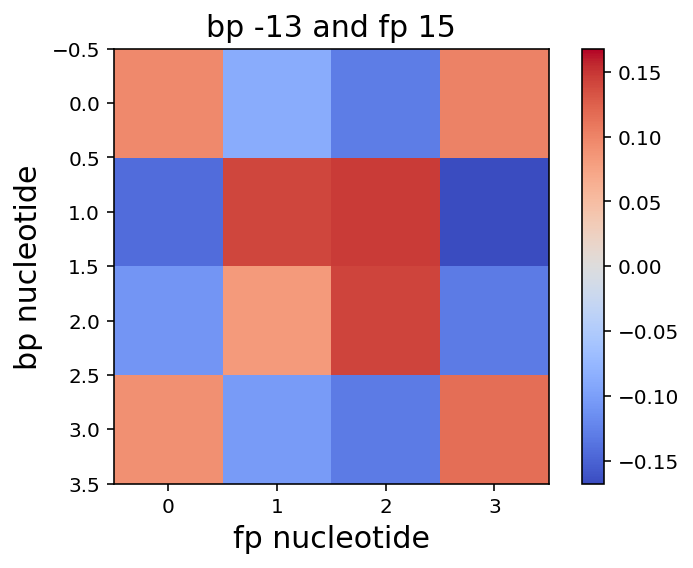

0.00420329455593
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.23', '0.25', '0.29']


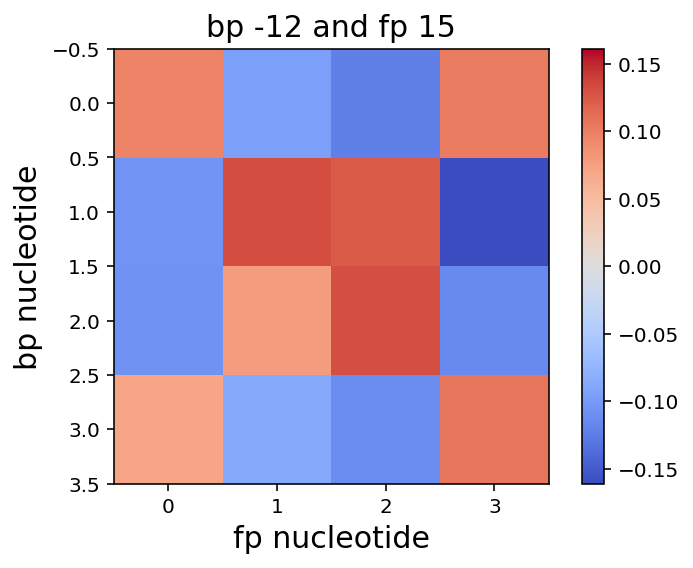

0.00450556177275
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.23', '0.25', '0.29']


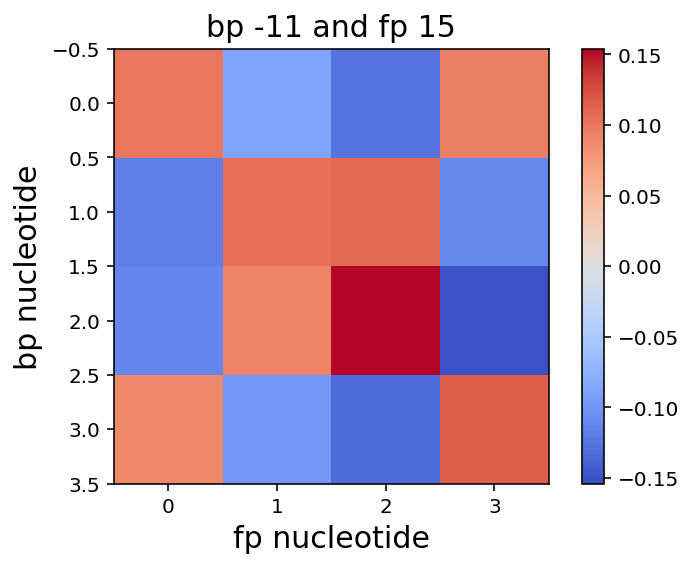

0.00451244400541
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.23', '0.25', '0.29']


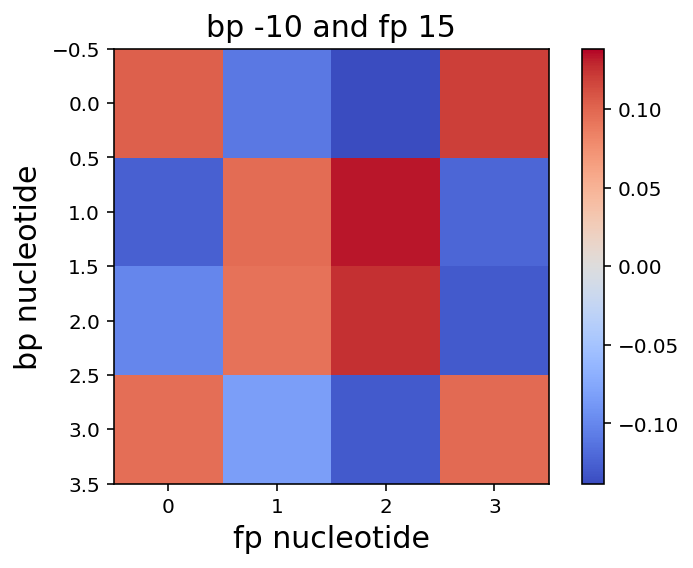

0.00410959358569
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.23', '0.25', '0.29']


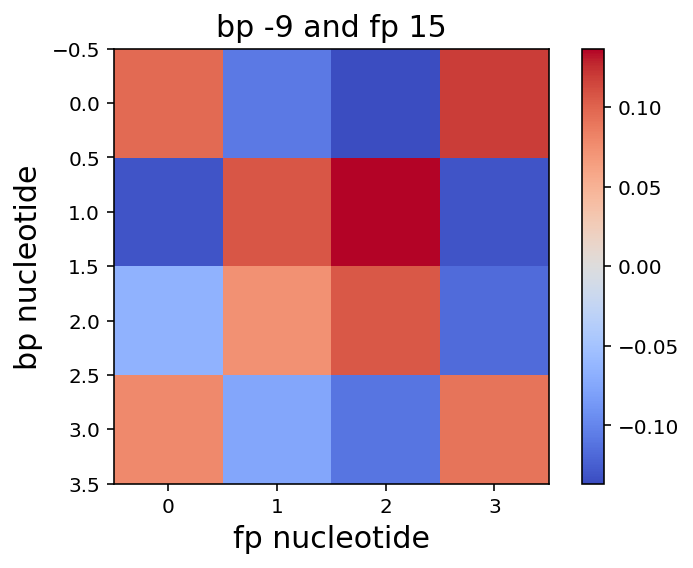

0.00435530686481
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.23', '0.25', '0.29']


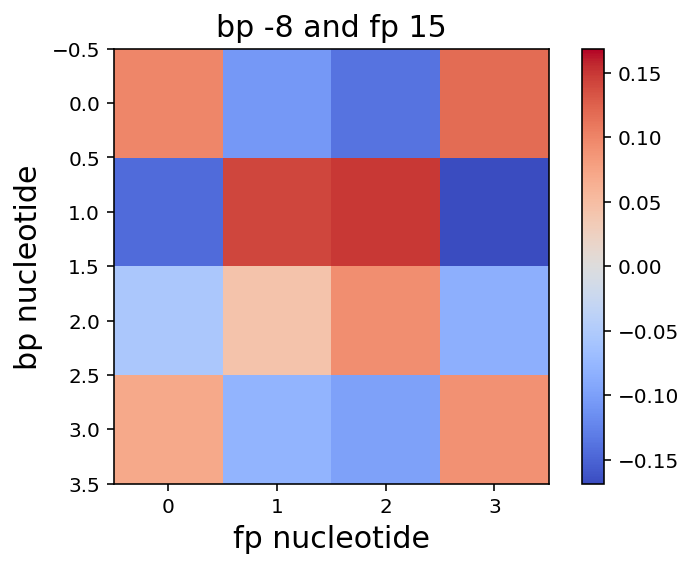

0.00471495670463
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.23', '0.25', '0.29']


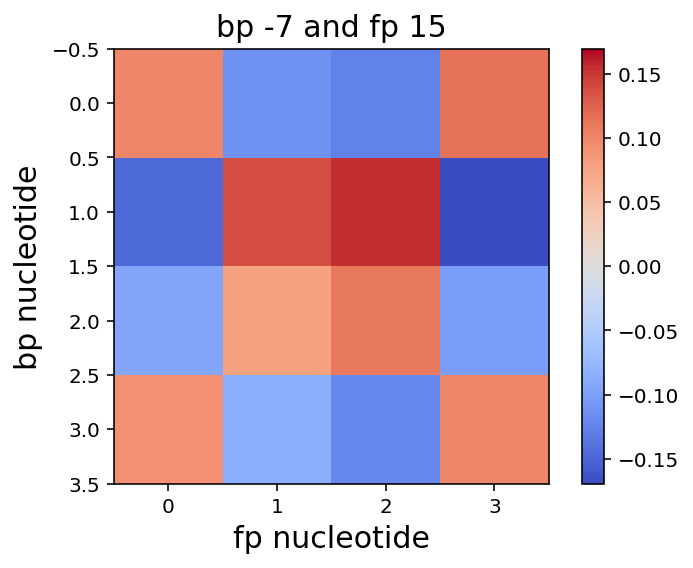

0.00498931758449
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.23', '0.25', '0.29']


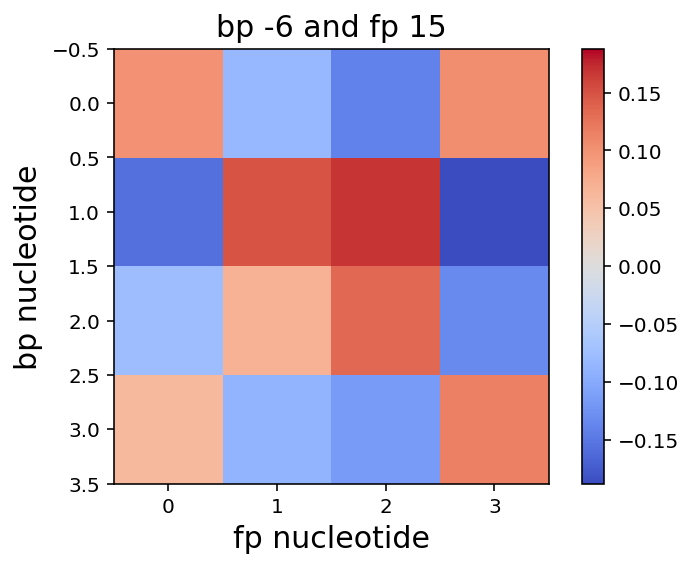

0.00510671495418
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.23', '0.25', '0.29']


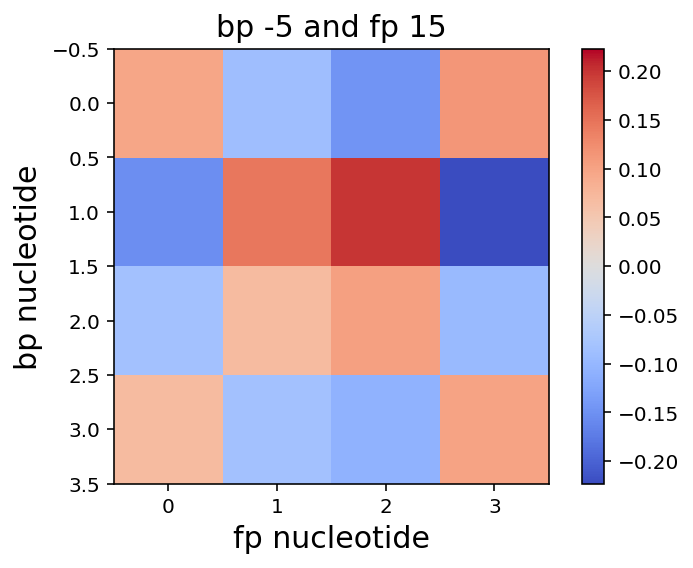

0.00510072957901
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.23', '0.25', '0.29']


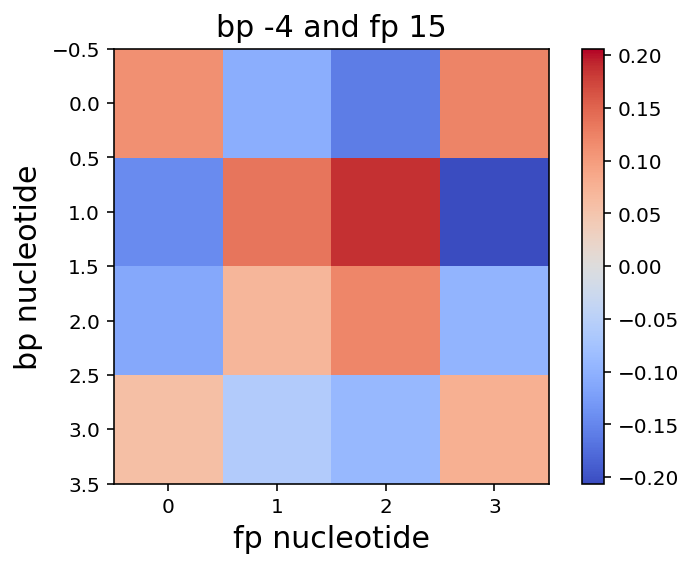

0.0054448981115
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.23', '0.25', '0.29']


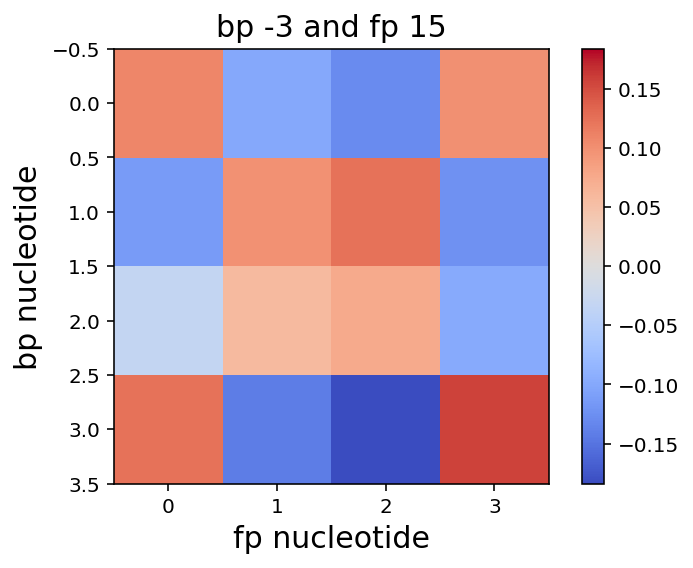

0.00184128164962
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.23', '0.25', '0.29']


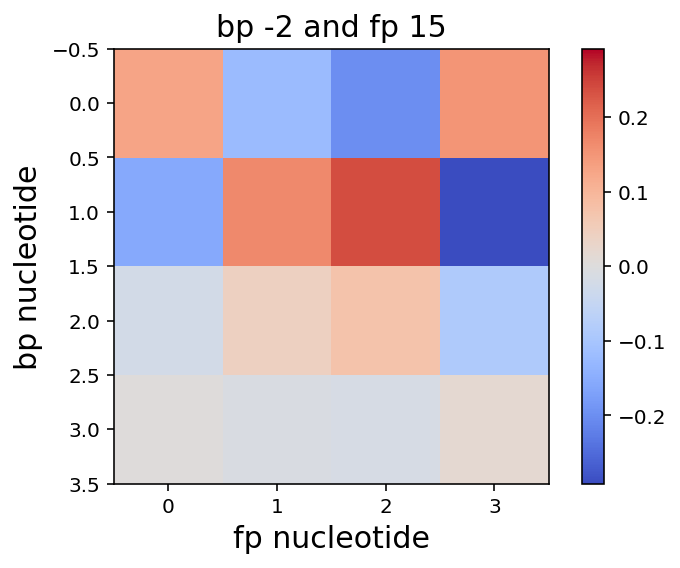

0.00743429501671
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.23', '0.25', '0.29']


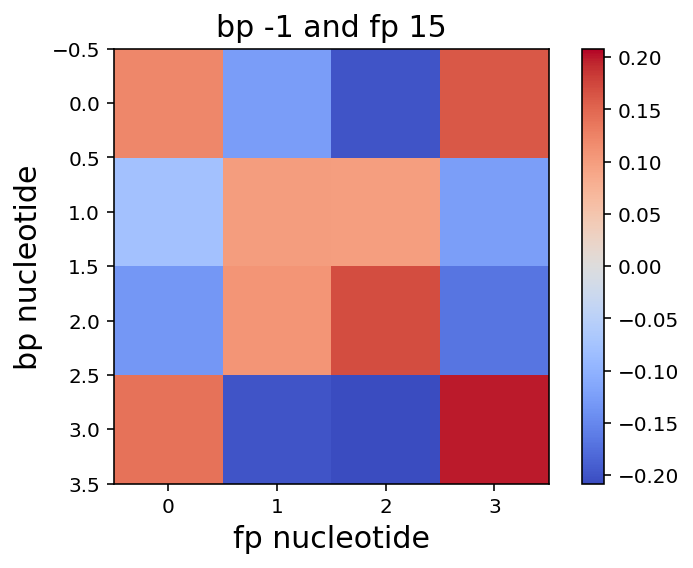

0.000688118707821
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.23', '0.25', '0.29']


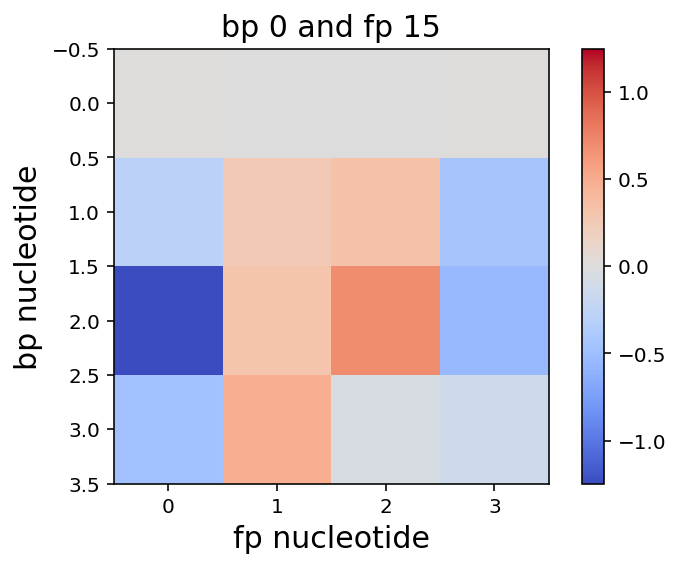

0.00680192386471
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.23', '0.25', '0.29']


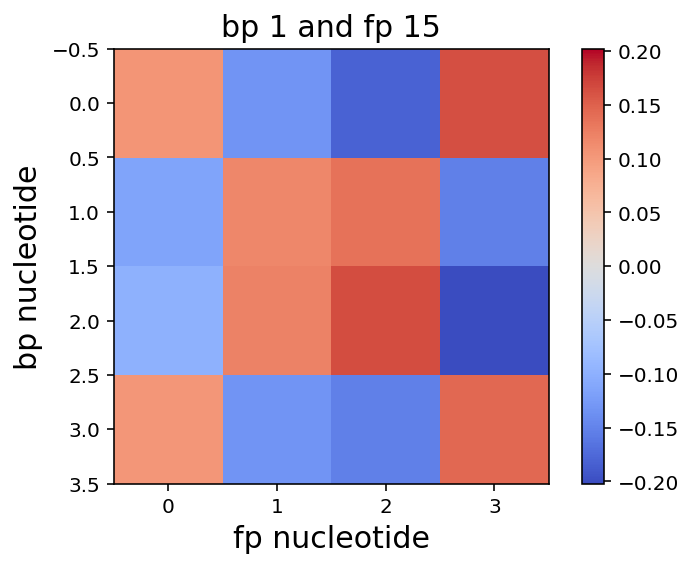

0.00490958570966
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.23', '0.25', '0.29']


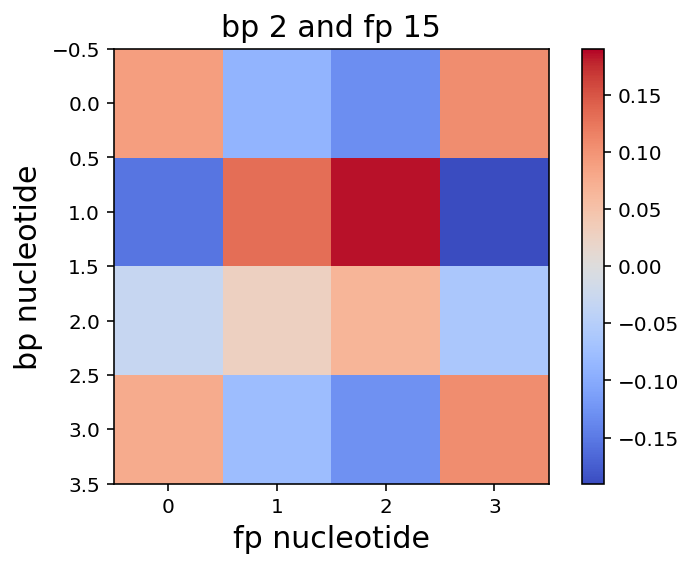

0.00431768901905
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.23', '0.25', '0.29']


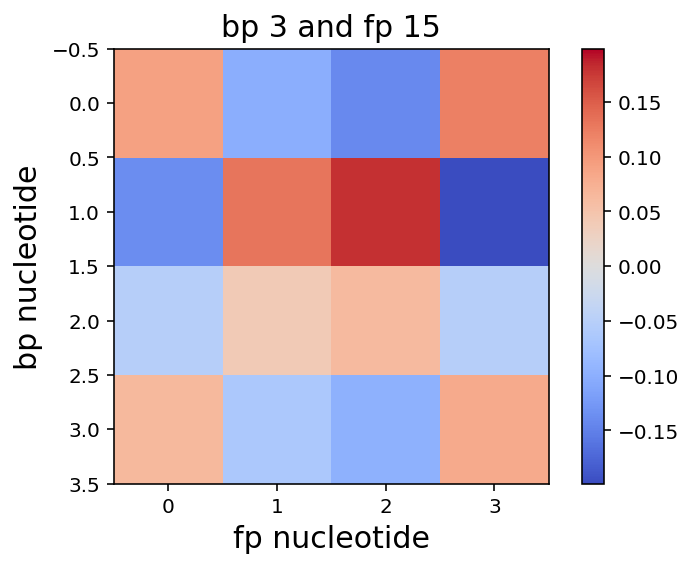

0.00526893907168
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.23', '0.25', '0.29']


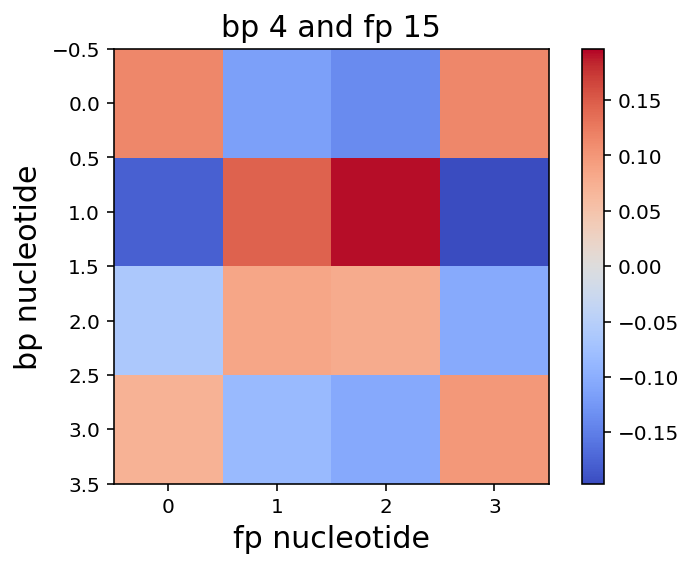

0.00473071091857
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.23', '0.25', '0.29']


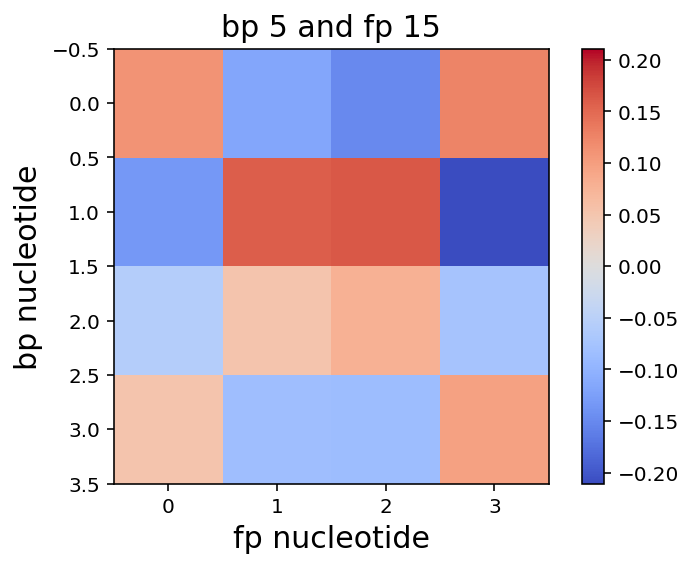

0.0044190794633
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.23', '0.25', '0.29']


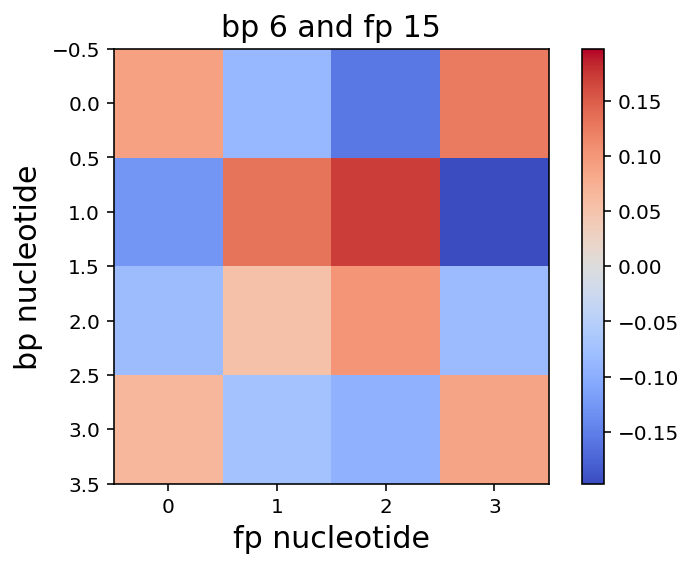

0.0047472835429
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.23', '0.25', '0.29']


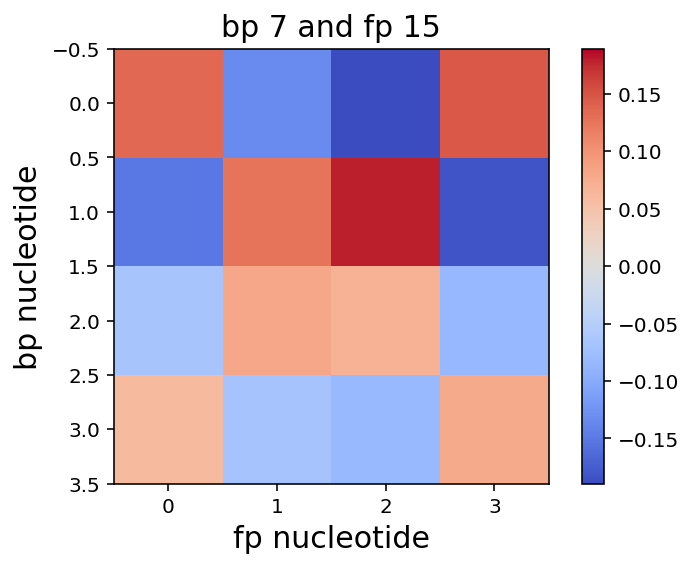

0.00540908501932
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.23', '0.25', '0.29']


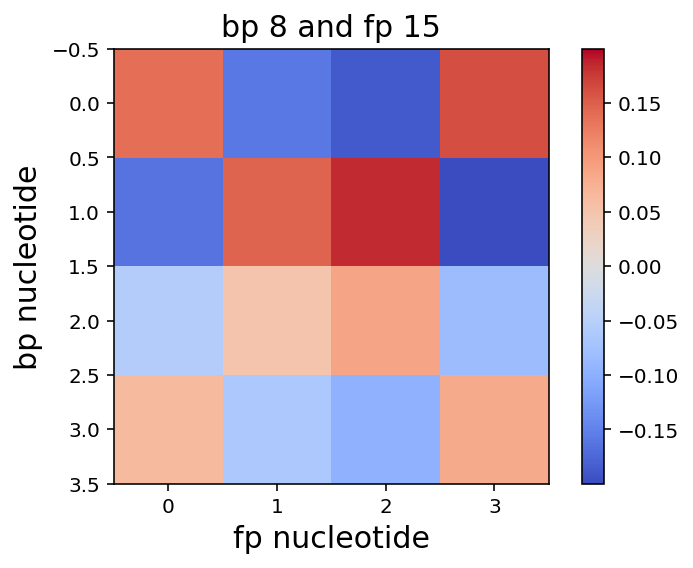

0.00470895856574
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.23', '0.25', '0.29']


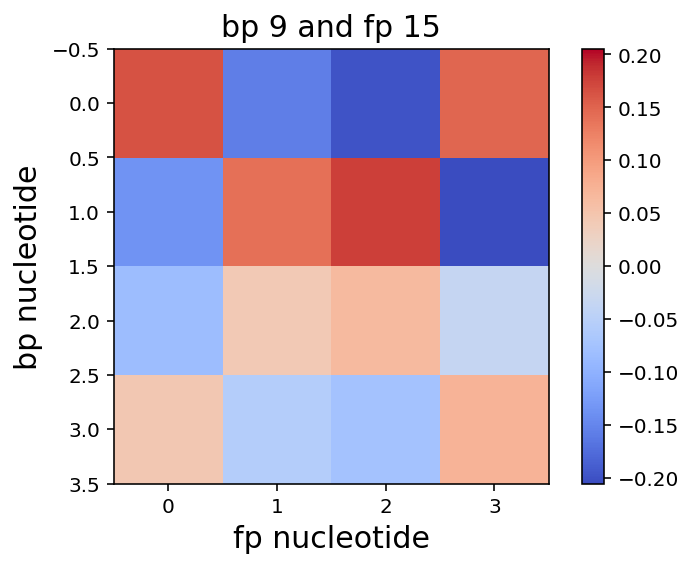

0.00453532609725
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.23', '0.25', '0.29']


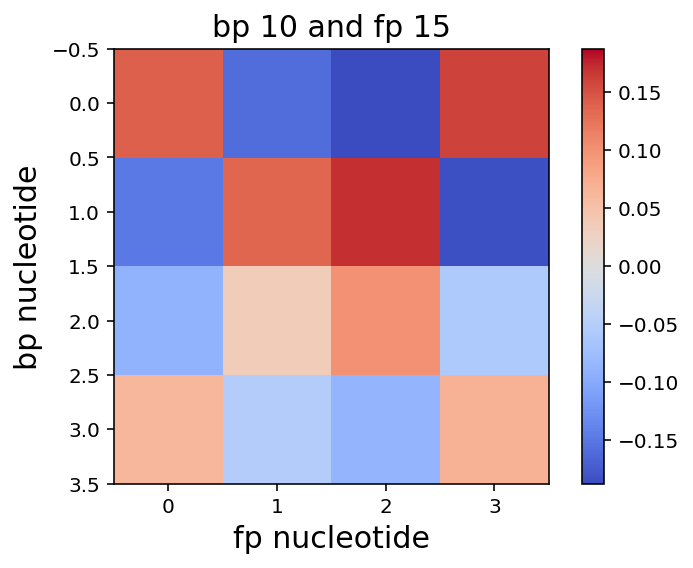

0.00417347336544
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.25', '0.29']


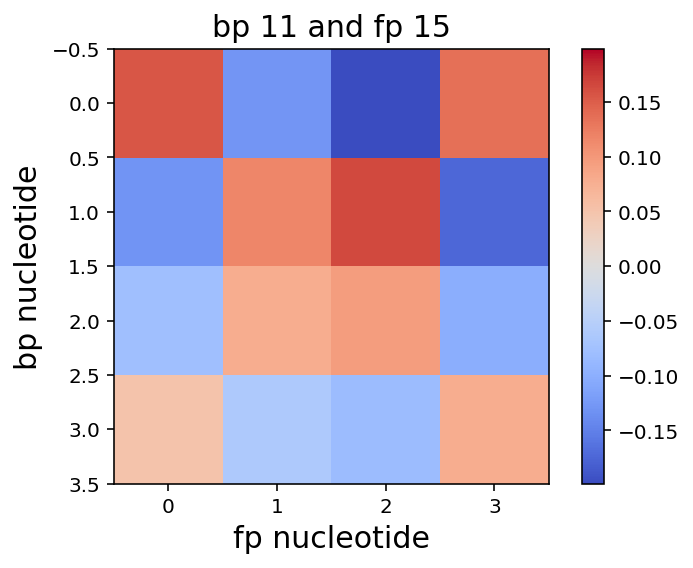

0.00438139887238
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.25', '0.29']


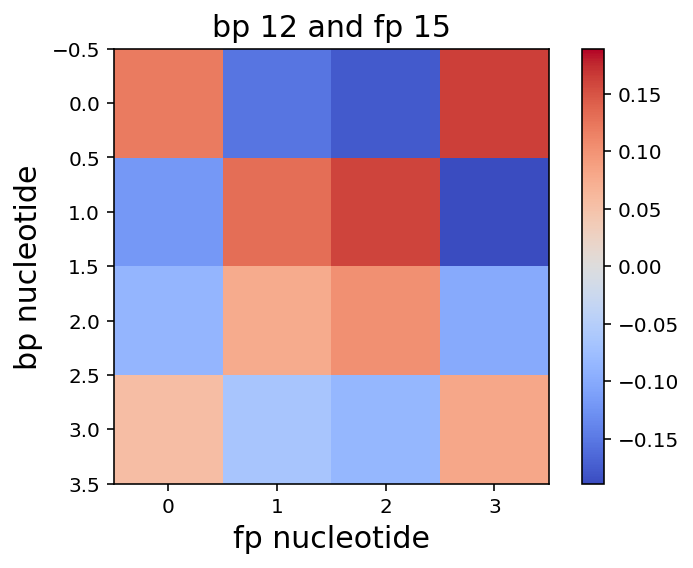

0.00490471549029
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.25', '0.29']


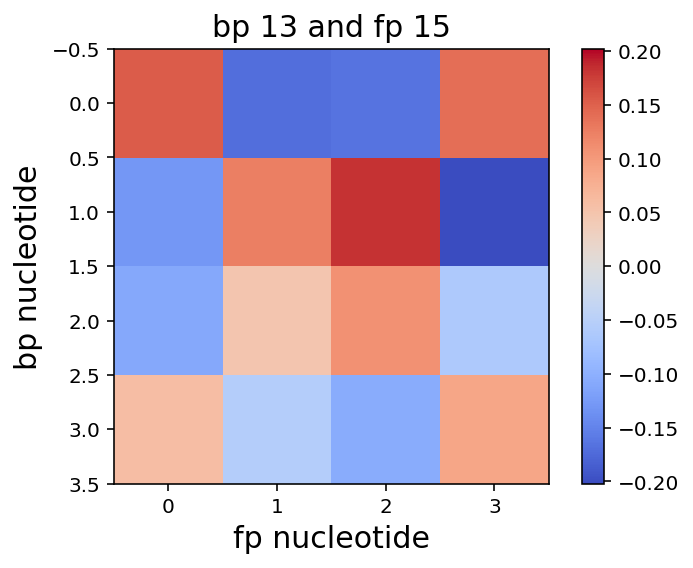

0.0043236400646
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.25', '0.29']


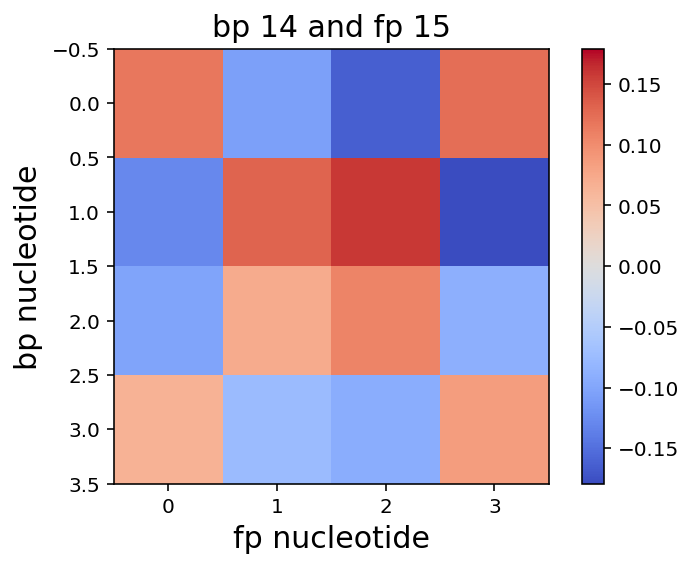

0.00526986325608
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.23', '0.26', '0.28']


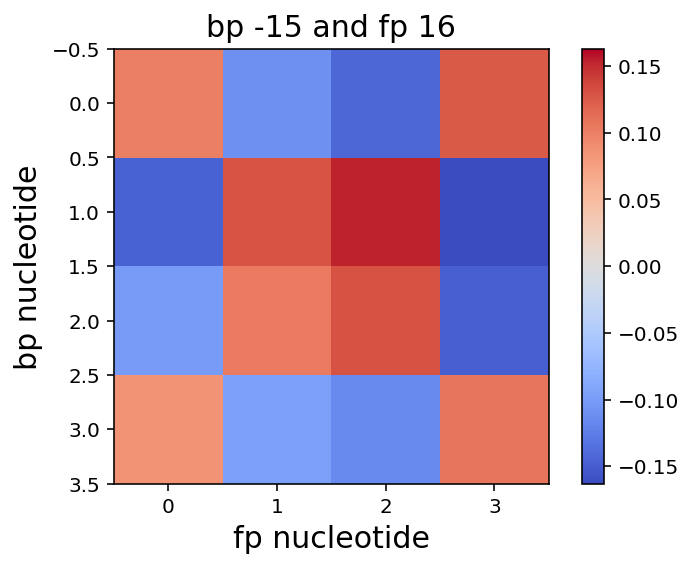

0.00519084864514
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.23', '0.26', '0.28']


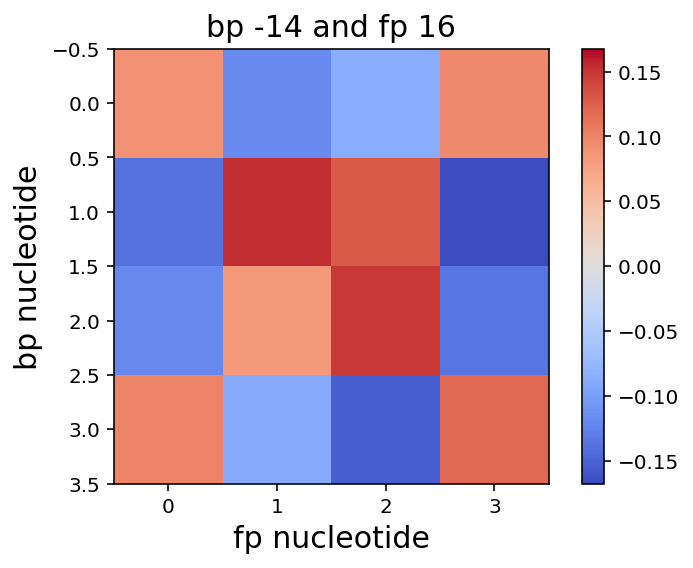

0.00504309303965
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.23', '0.26', '0.28']


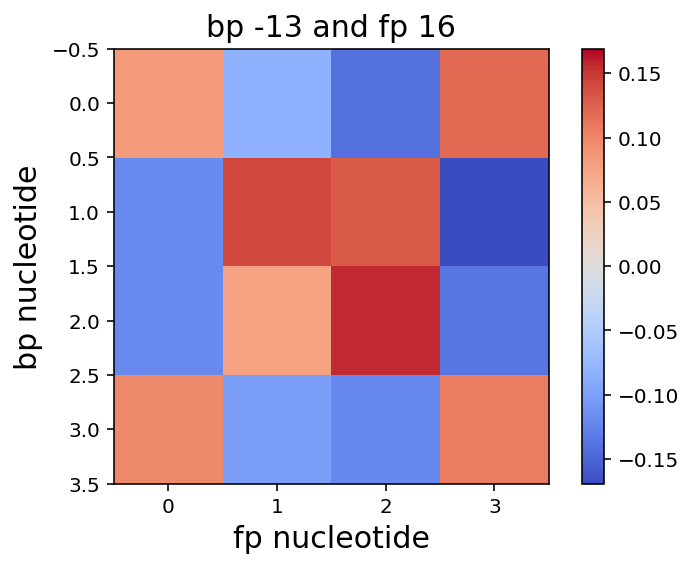

0.00477233494134
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.23', '0.26', '0.28']


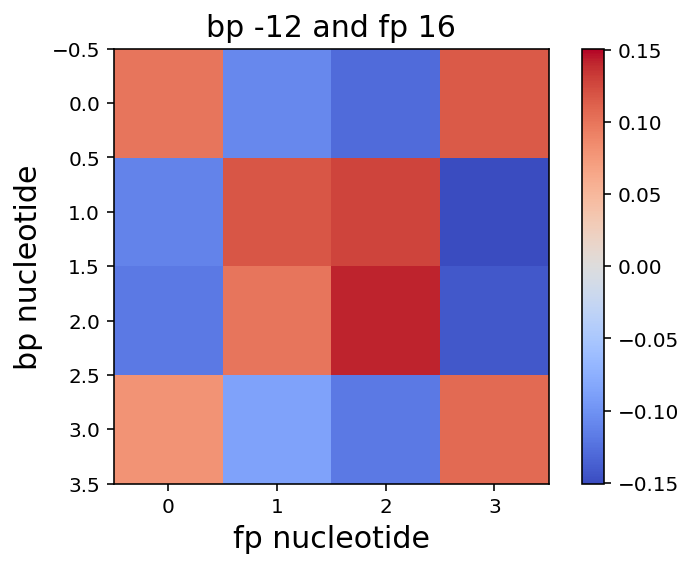

0.00503389031499
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.23', '0.26', '0.28']


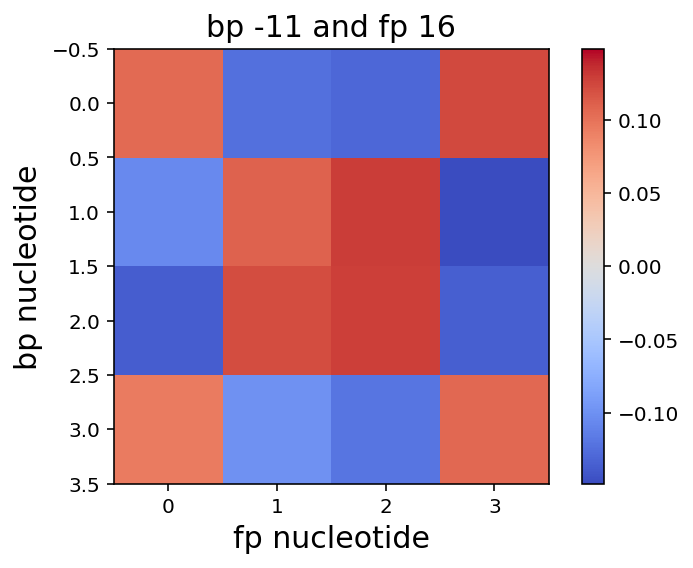

0.005490188089
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.23', '0.26', '0.28']


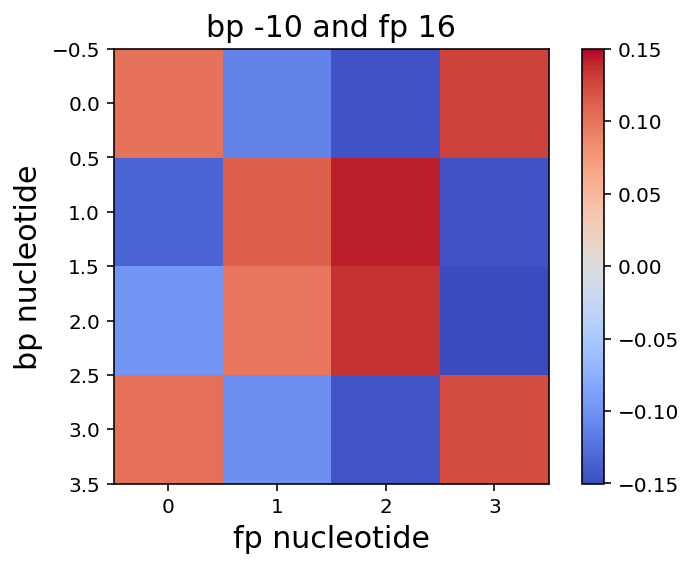

0.00423896384141
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.23', '0.26', '0.28']


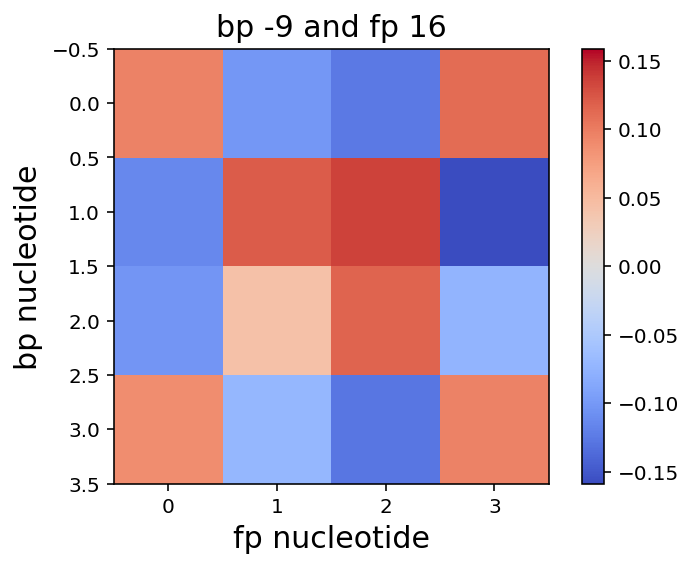

0.00497404972459
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.23', '0.26', '0.28']


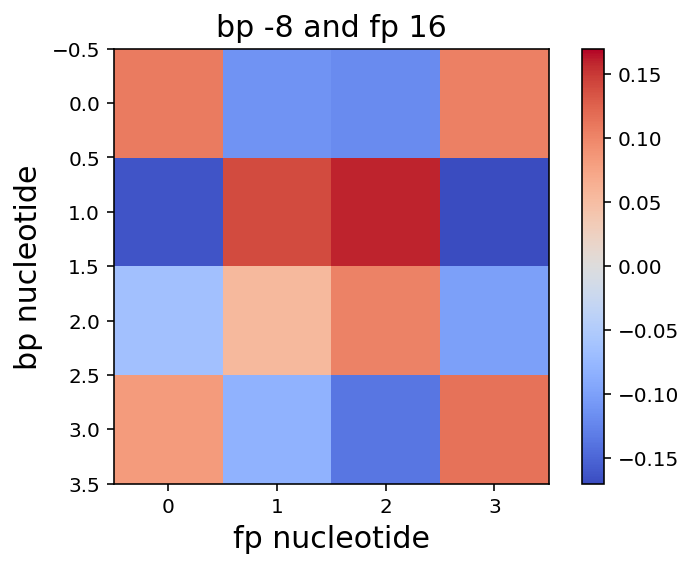

0.00525503775375
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.23', '0.26', '0.28']


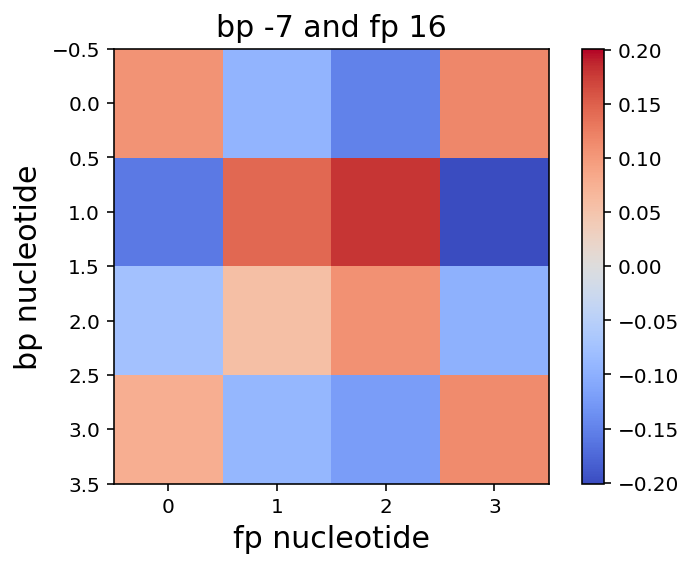

0.00544962519224
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.23', '0.26', '0.28']


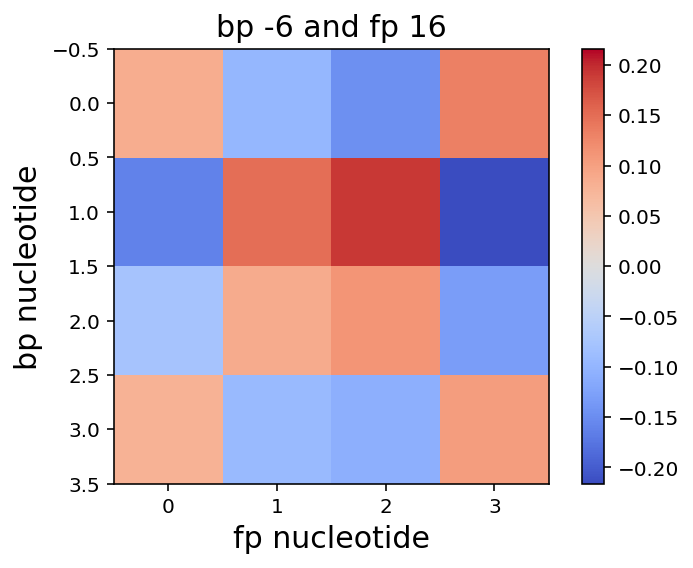

0.00552566582098
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.23', '0.26', '0.28']


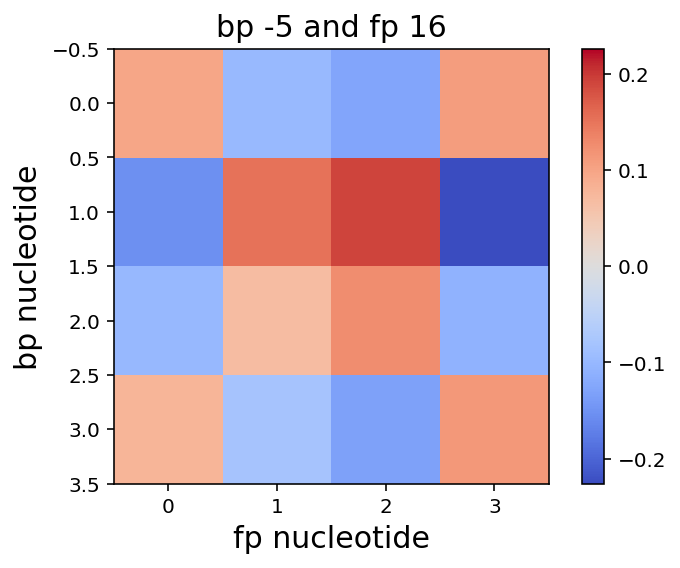

0.0054314996415
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.23', '0.26', '0.28']


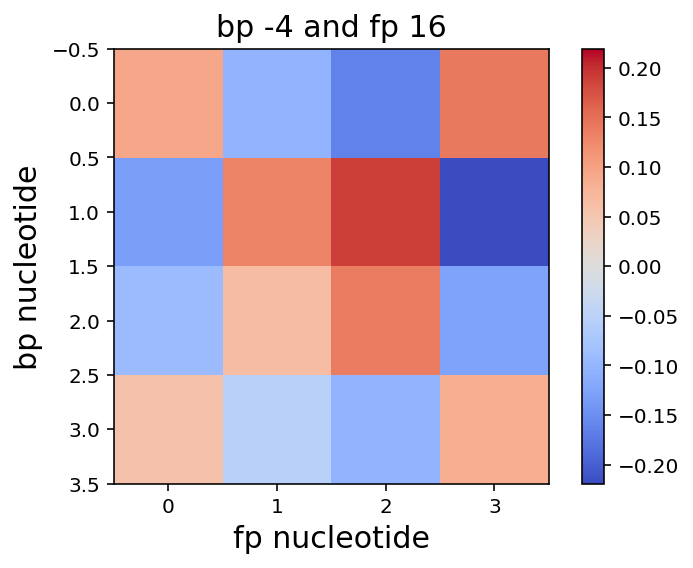

0.00575165944566
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.23', '0.26', '0.28']


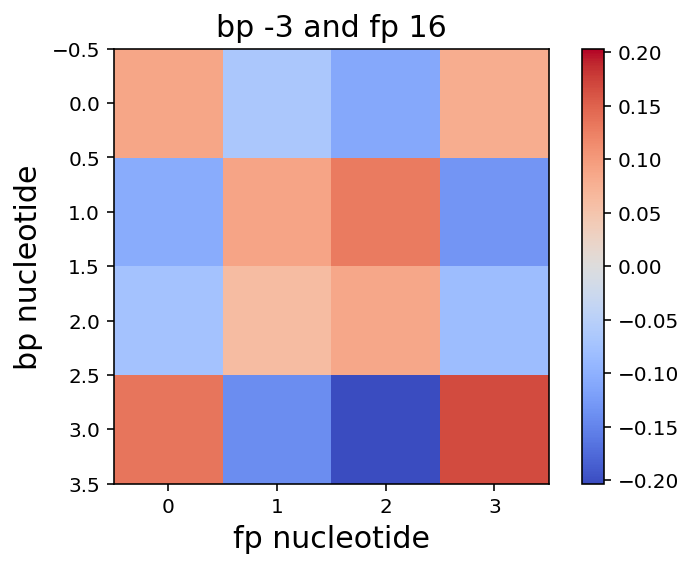

0.00175667000855
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.23', '0.26', '0.28']


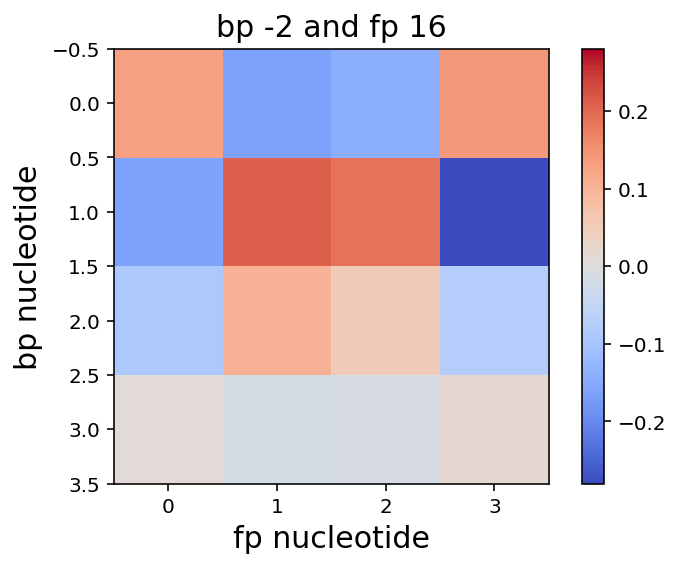

0.00727768378026
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.23', '0.26', '0.28']


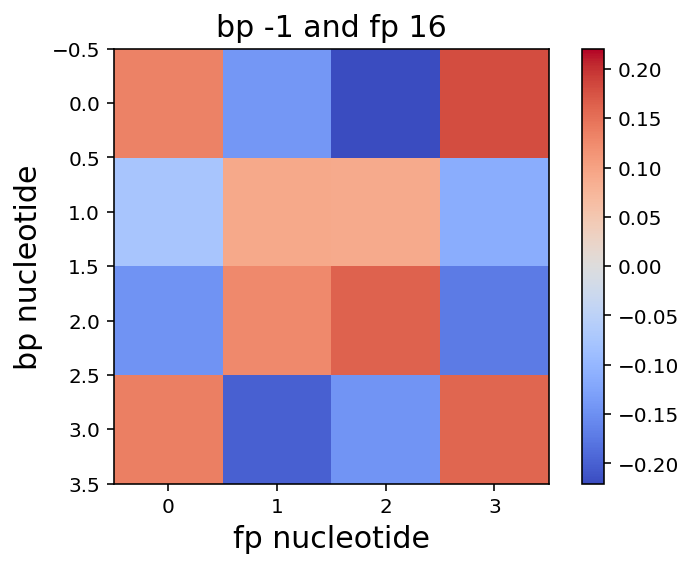

0.000591193832738
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.23', '0.26', '0.28']


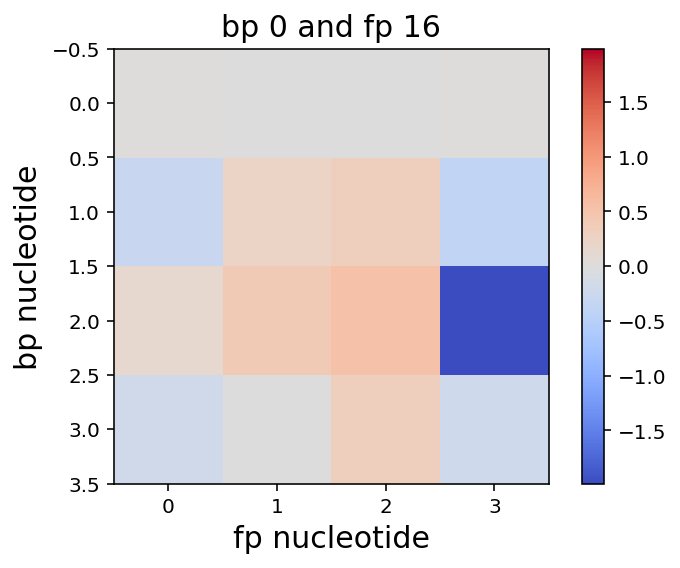

0.0068974131757
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.23', '0.26', '0.28']


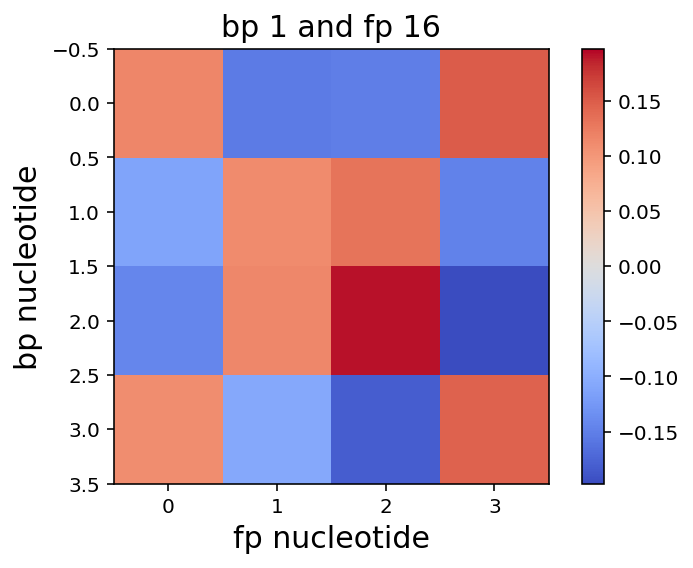

0.00451651120118
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.23', '0.26', '0.28']


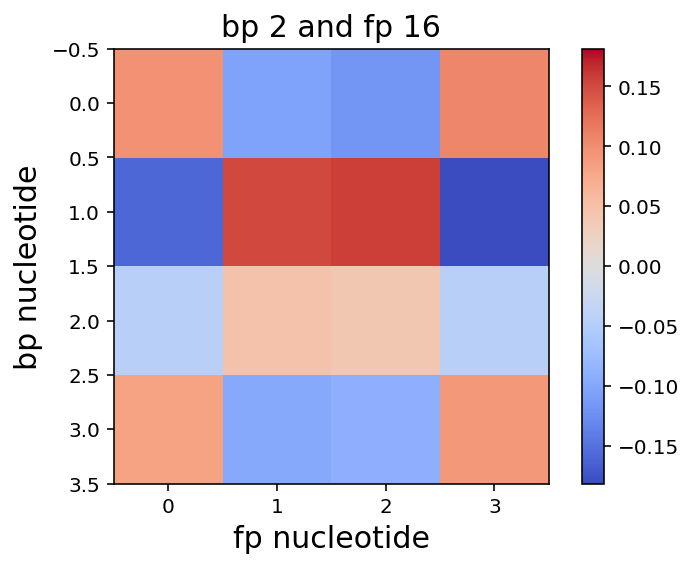

0.00515089286433
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.23', '0.26', '0.28']


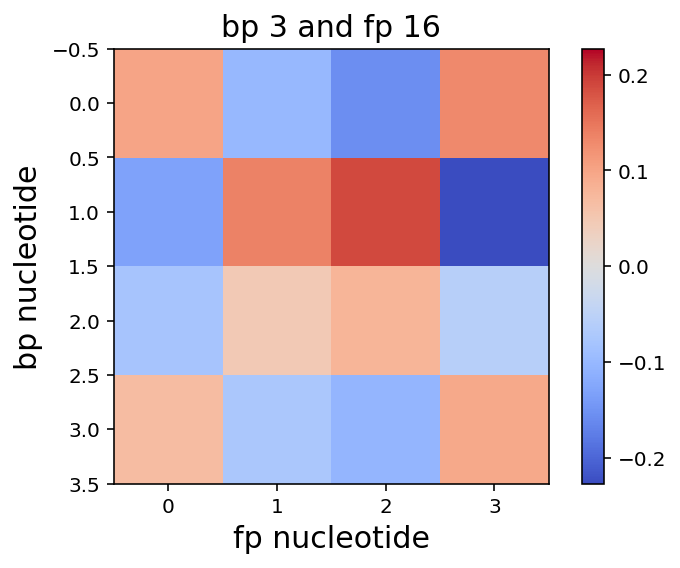

0.00552697403471
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.23', '0.26', '0.28']


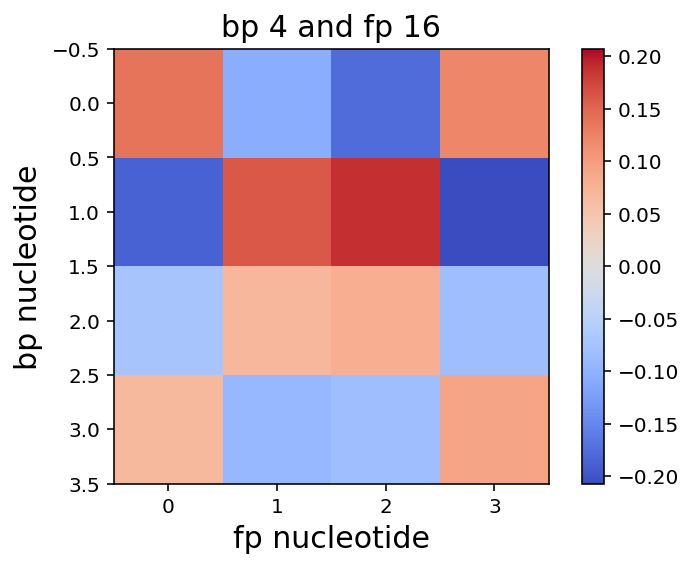

0.00505717531435
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.23', '0.26', '0.28']


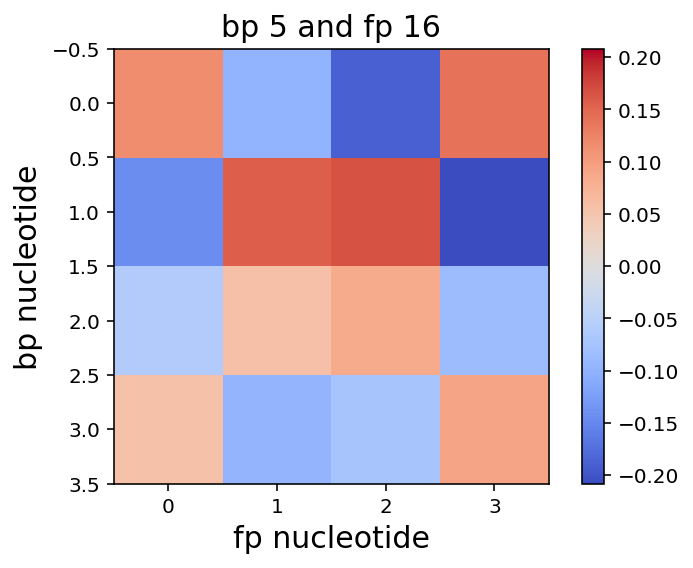

0.00503061119159
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.23', '0.26', '0.28']


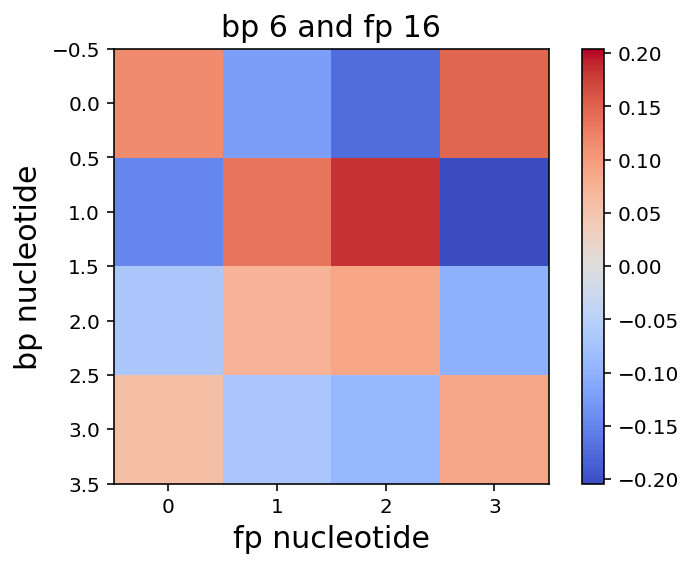

0.00569100673627
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.23', '0.26', '0.28']


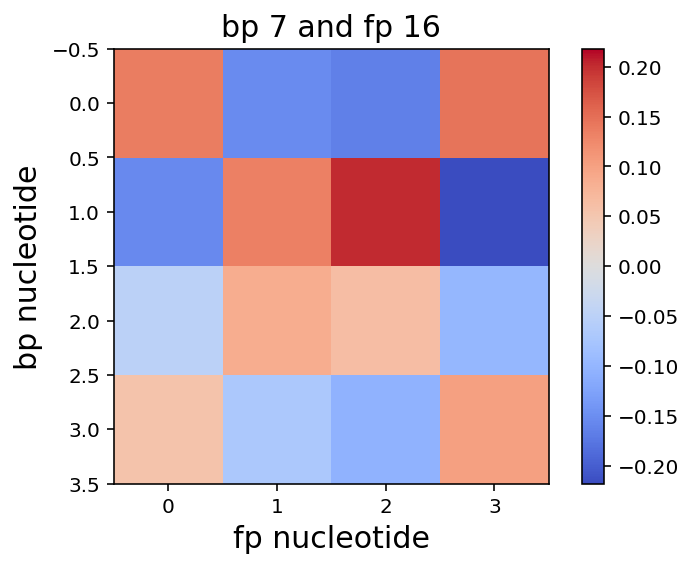

0.00521811626964
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.23', '0.26', '0.28']


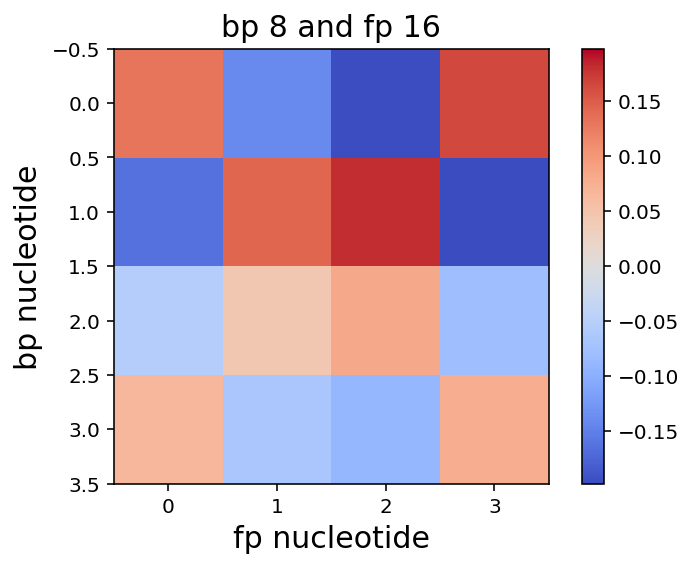

0.00526524757216
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.23', '0.26', '0.28']


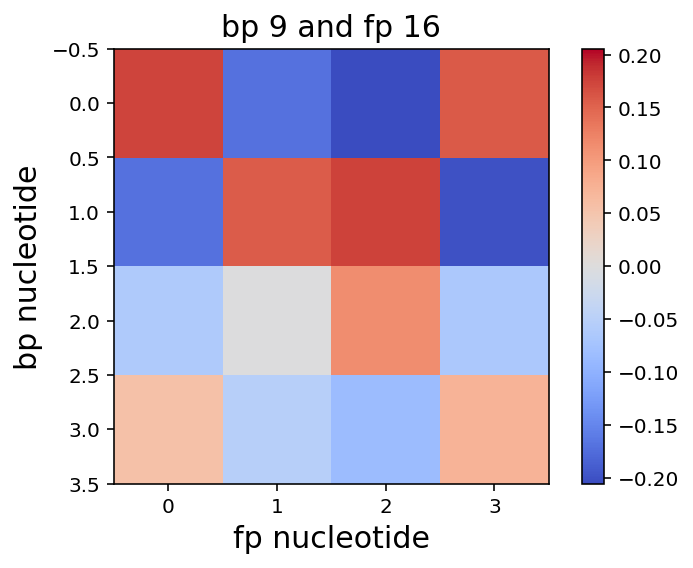

0.00472039683075
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.23', '0.26', '0.28']


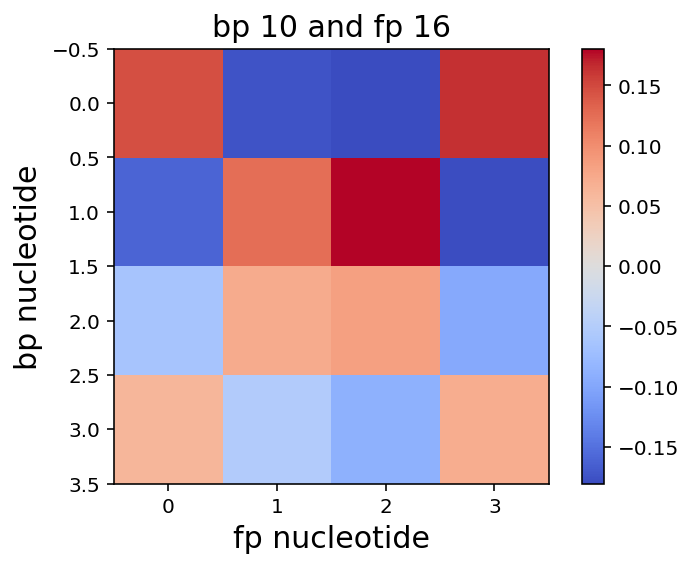

0.00443182819694
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.26', '0.28']


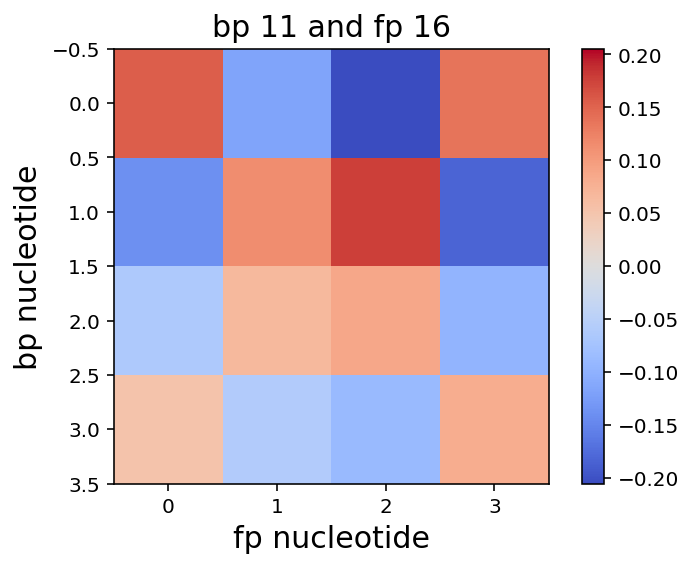

0.00478811920775
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.26', '0.28']


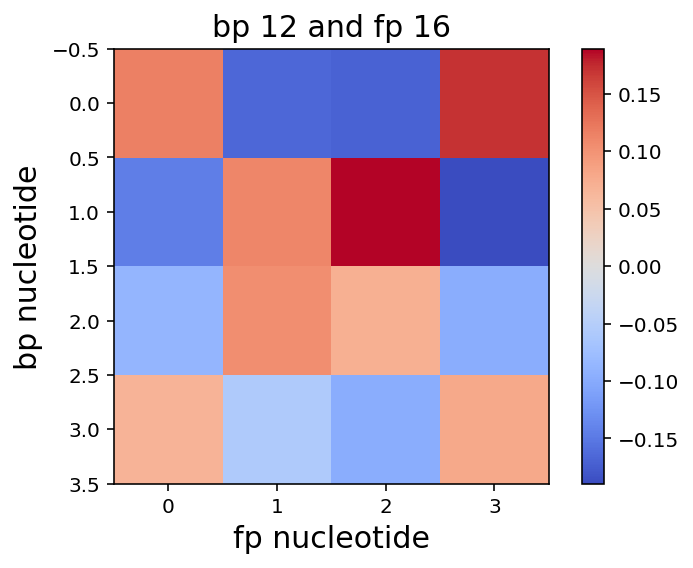

0.0048965420698
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.26', '0.28']


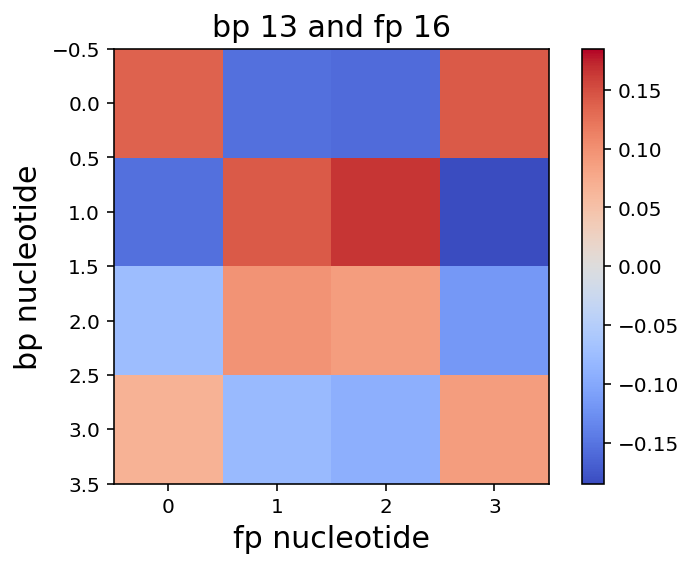

0.00519579489571
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.26', '0.28']


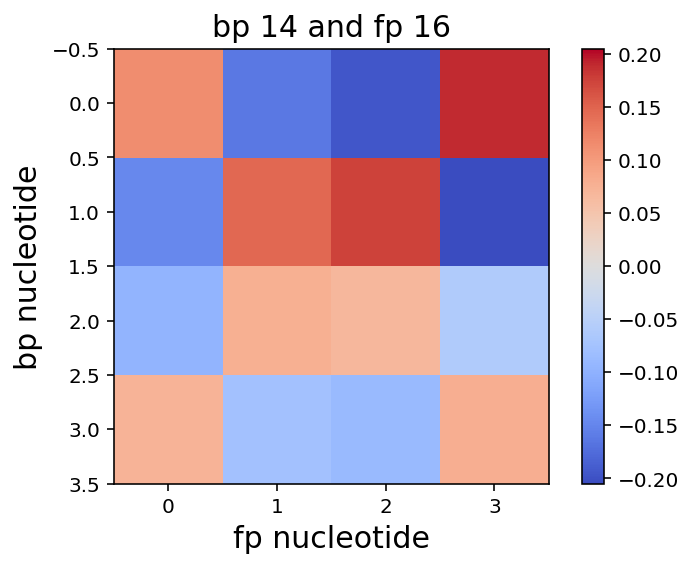

0.00492687987
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.23', '0.25', '0.28']


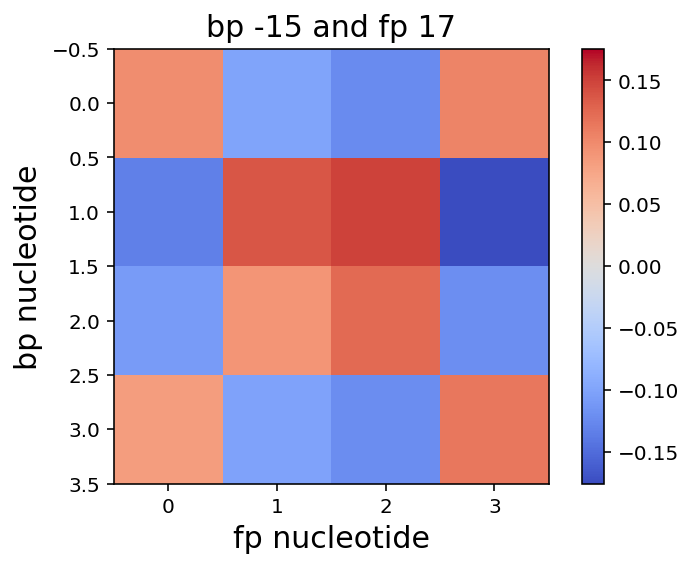

0.00448833406897
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.23', '0.25', '0.28']


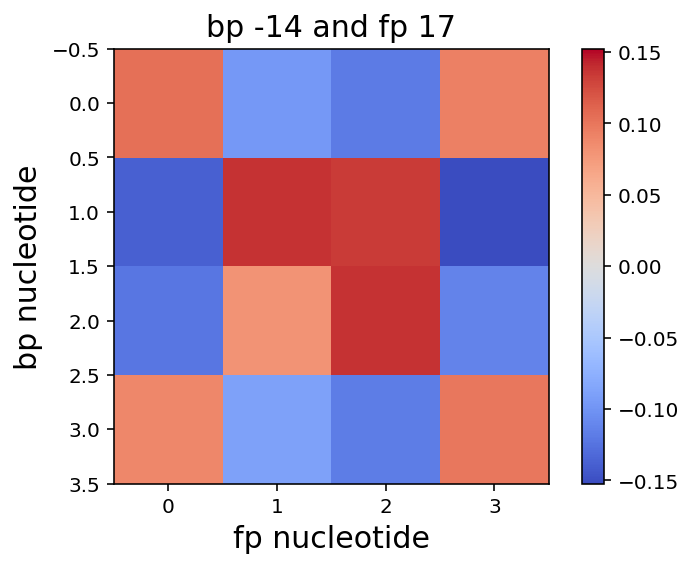

0.00467828047534
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.23', '0.25', '0.28']


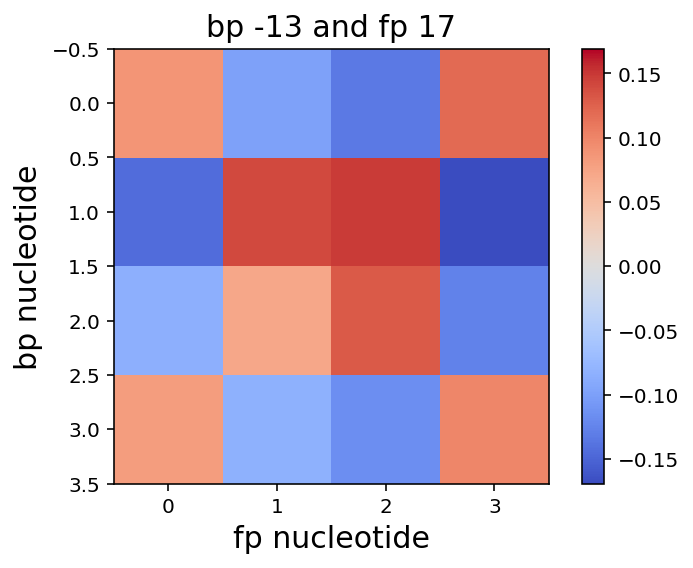

0.00456767551472
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.23', '0.25', '0.28']


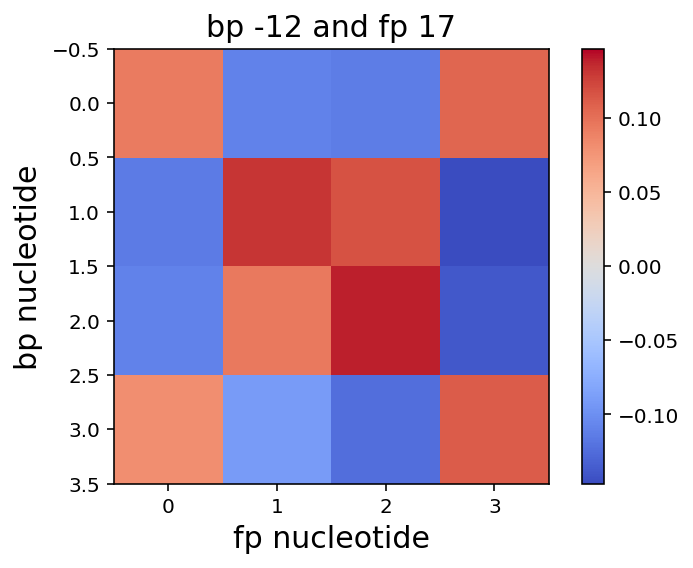

0.00470034952231
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.23', '0.25', '0.28']


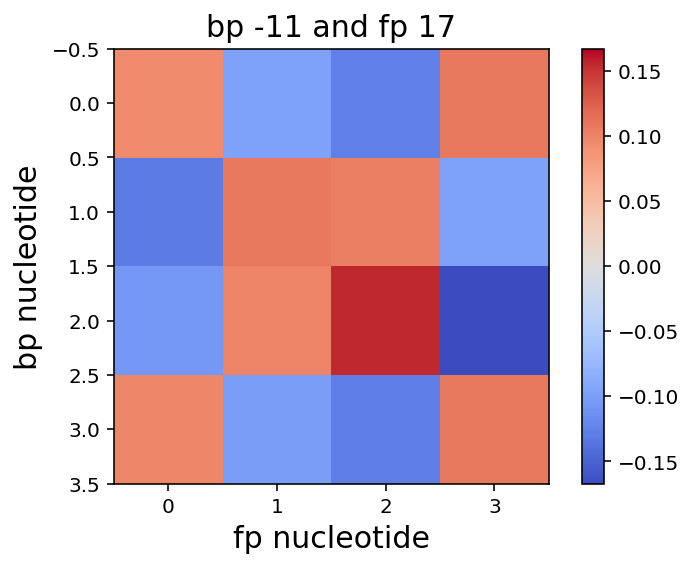

0.00451987488177
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.23', '0.25', '0.28']


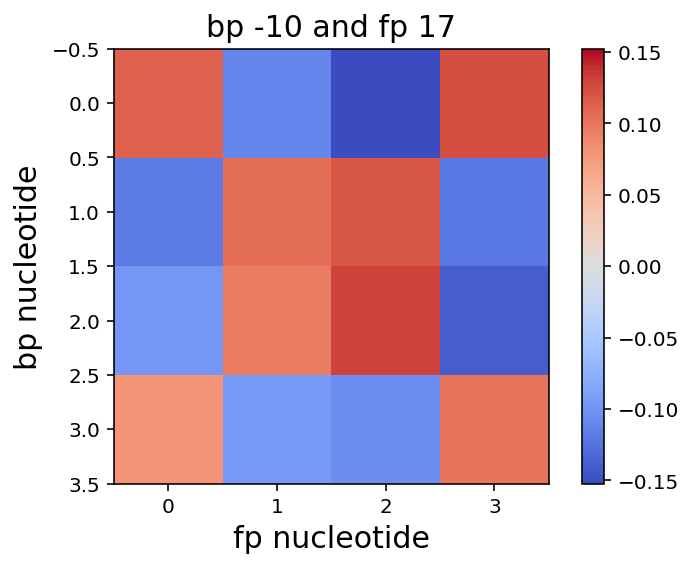

0.00422894608143
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.23', '0.25', '0.28']


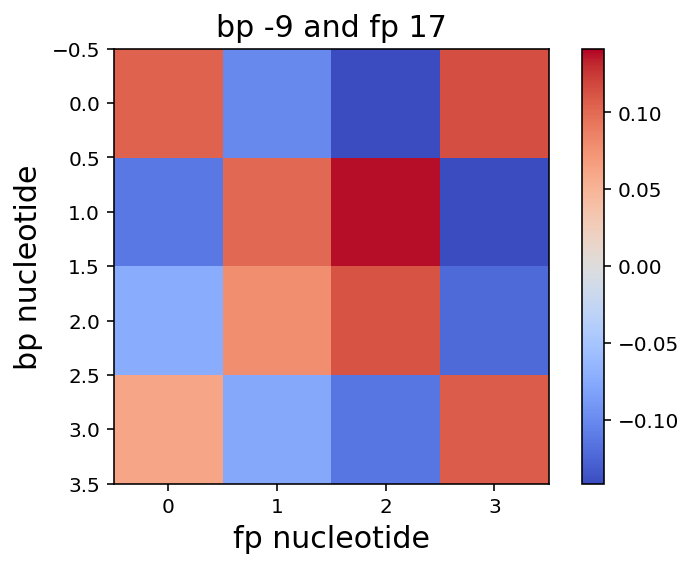

0.00441047759583
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.23', '0.25', '0.28']


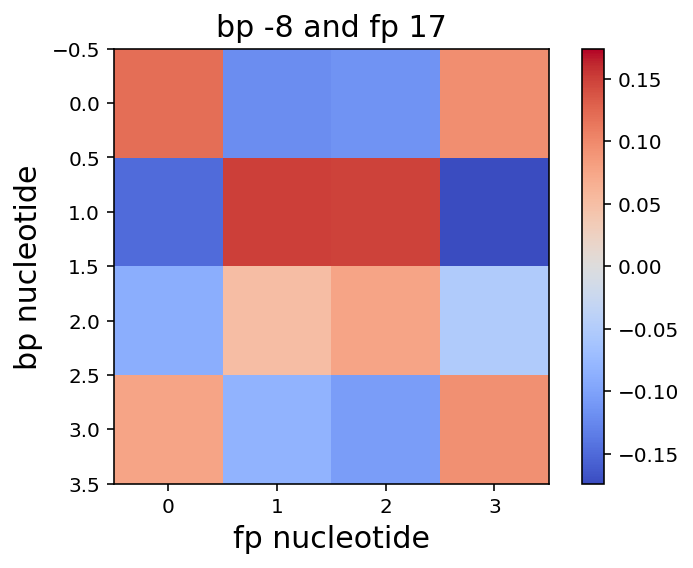

0.00471090446763
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.23', '0.25', '0.28']


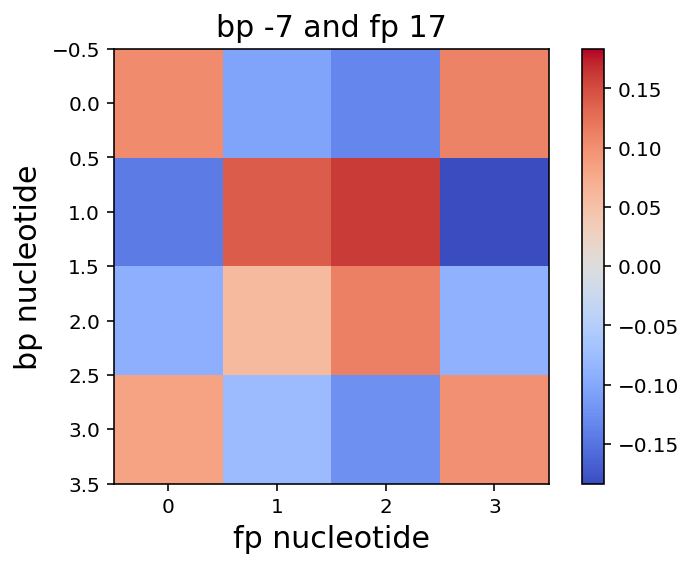

0.00542388038316
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.23', '0.25', '0.28']


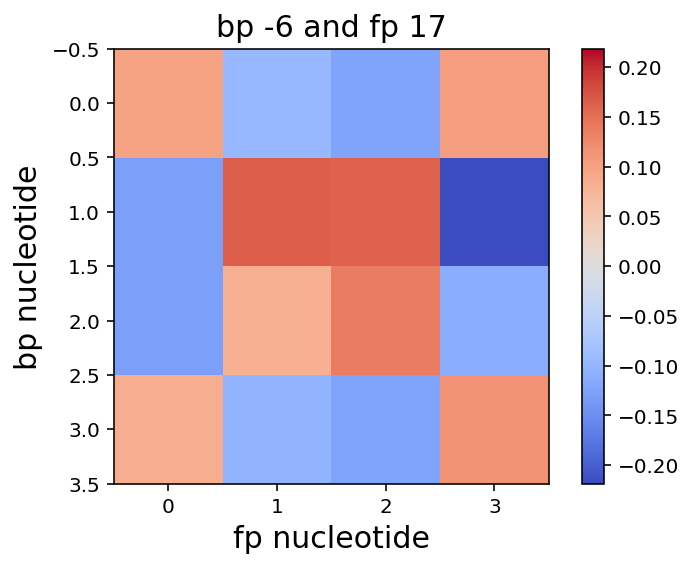

0.00514279600809
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.23', '0.25', '0.28']


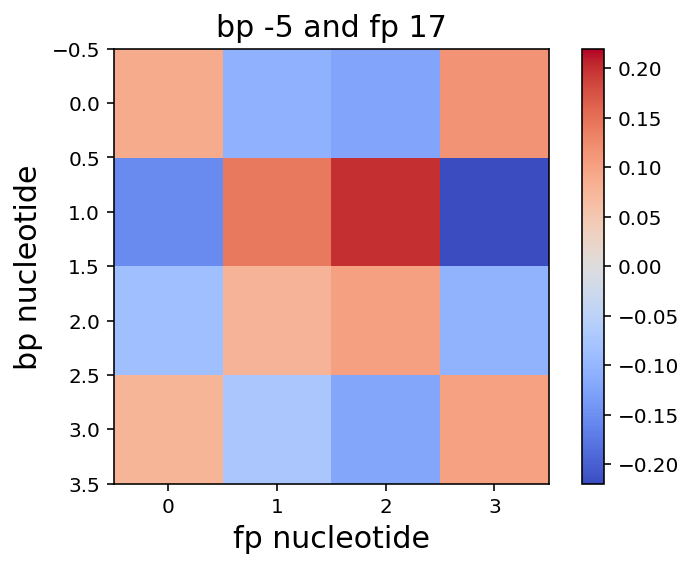

0.00516502354636
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.23', '0.25', '0.28']


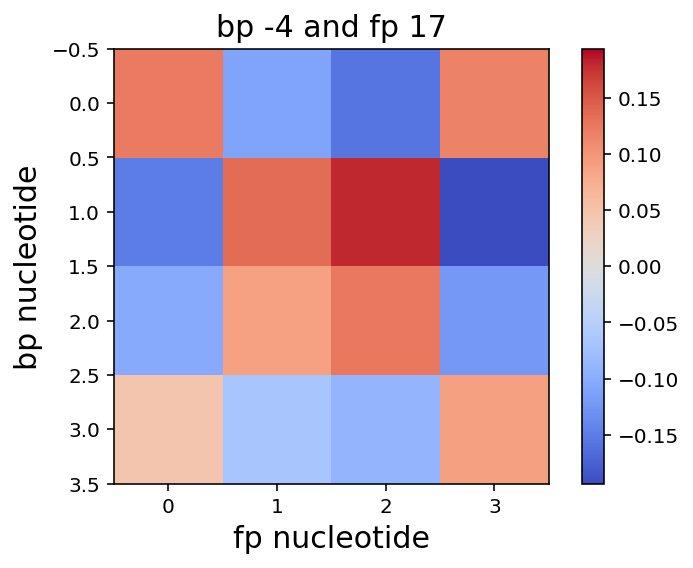

0.00586568674253
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.23', '0.25', '0.28']


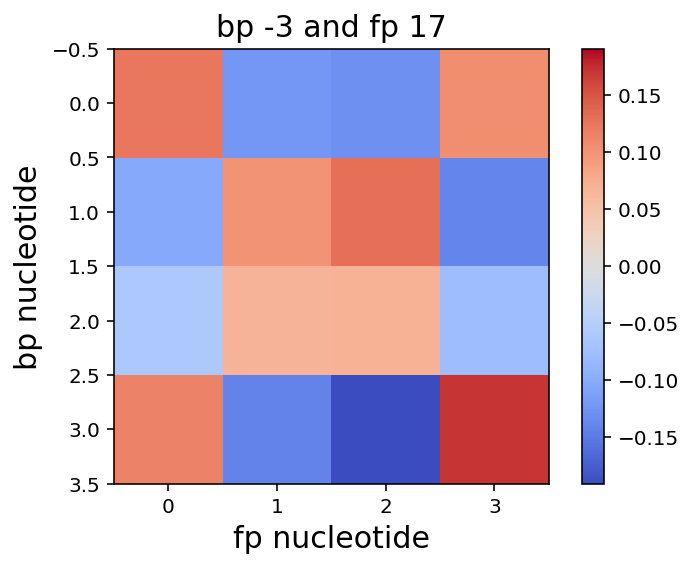

0.00183391760077
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.23', '0.25', '0.28']


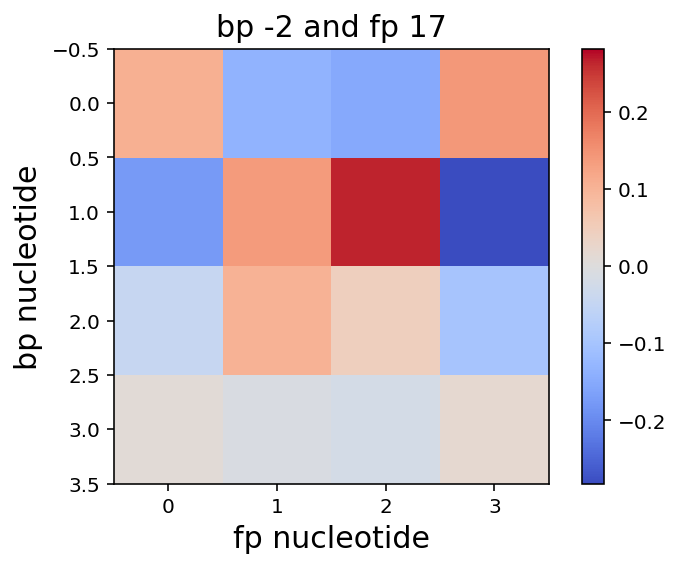

0.0069047411551
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.23', '0.25', '0.28']


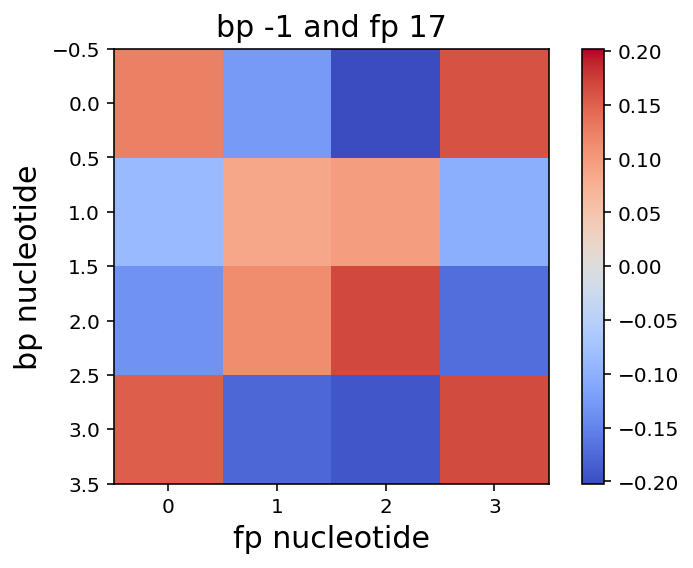

0.000711524823821
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.23', '0.25', '0.28']


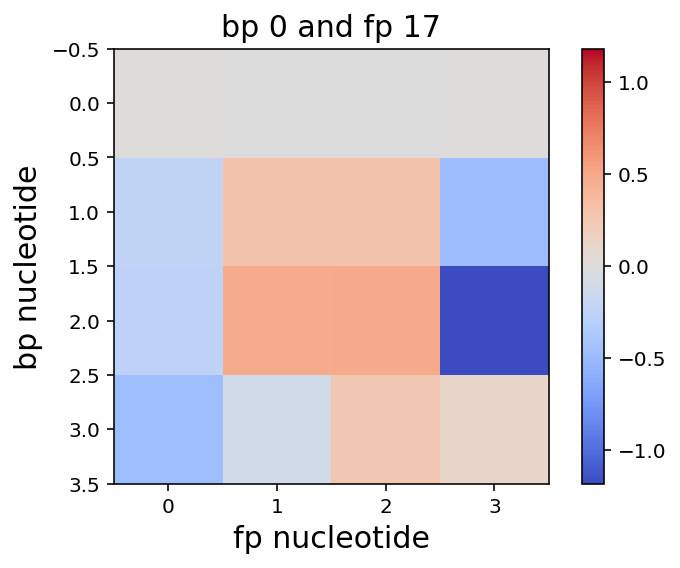

0.00699902932262
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.23', '0.25', '0.28']


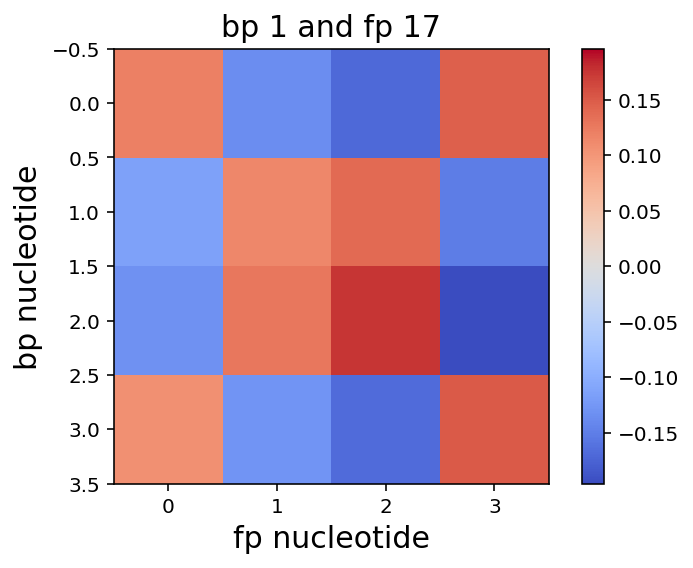

0.00474628469229
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.23', '0.25', '0.28']


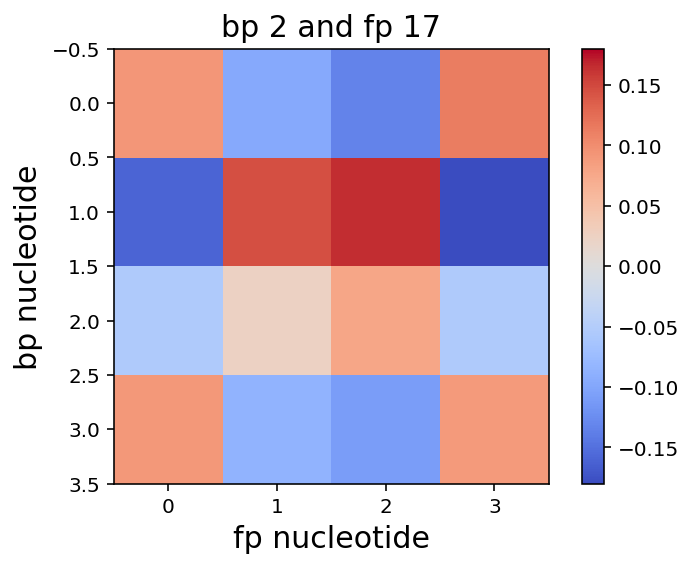

0.00465788752414
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.23', '0.25', '0.28']


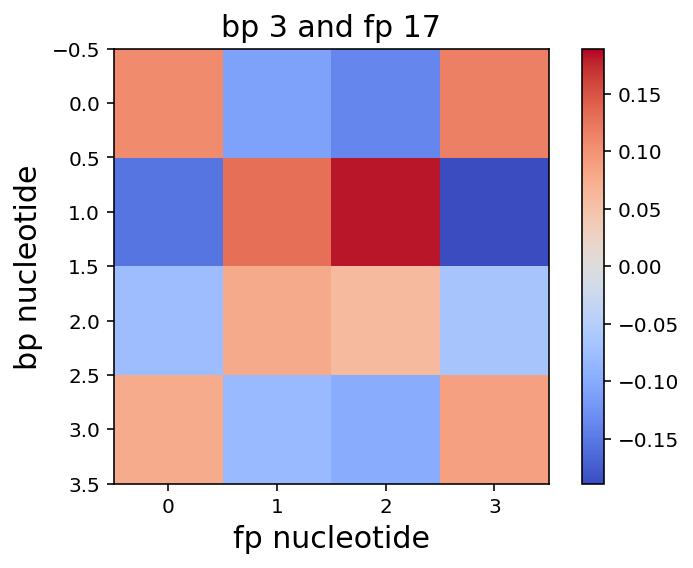

0.00538538442723
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.23', '0.25', '0.28']


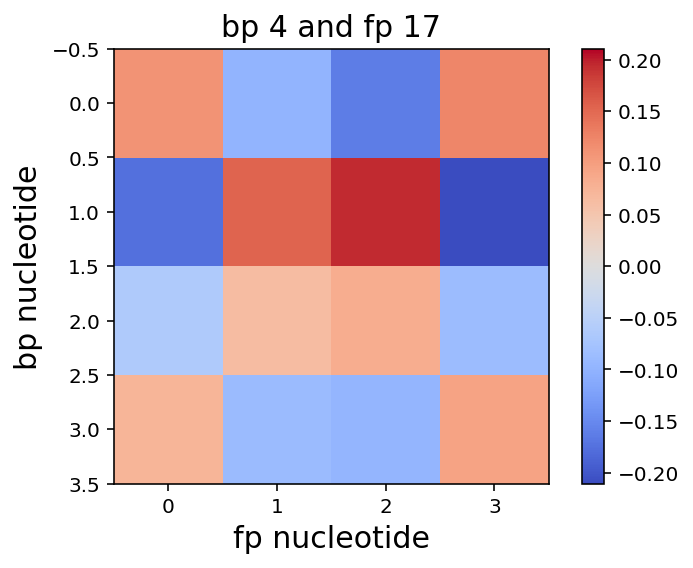

0.00497236883527
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.23', '0.25', '0.28']


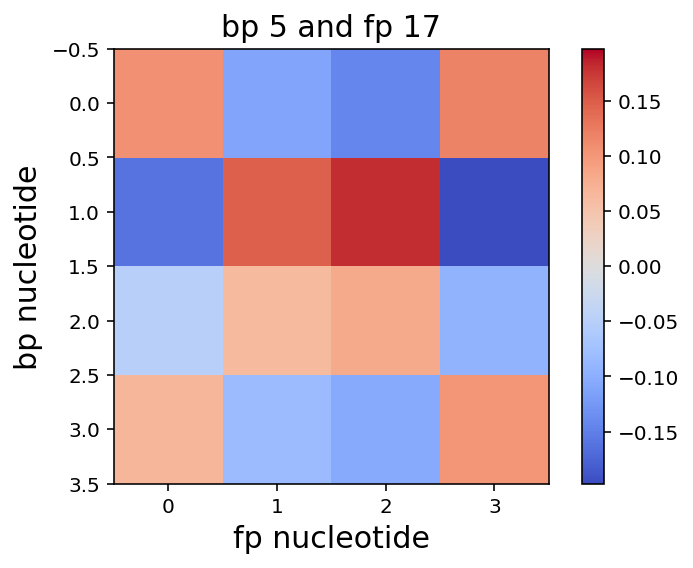

0.00487140103829
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.23', '0.25', '0.28']


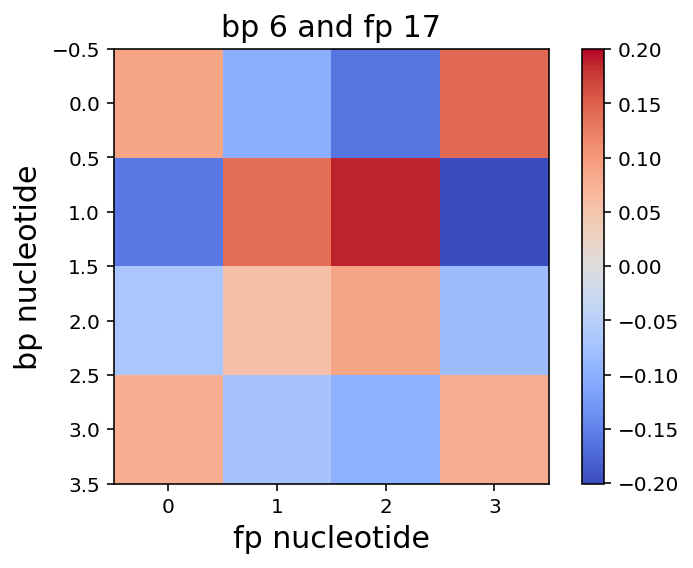

0.00522954507137
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.23', '0.25', '0.28']


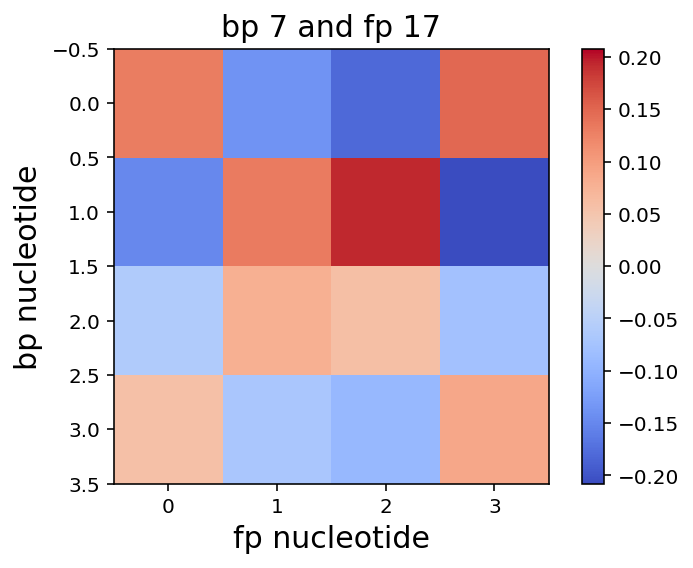

0.00553746835846
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.23', '0.25', '0.28']


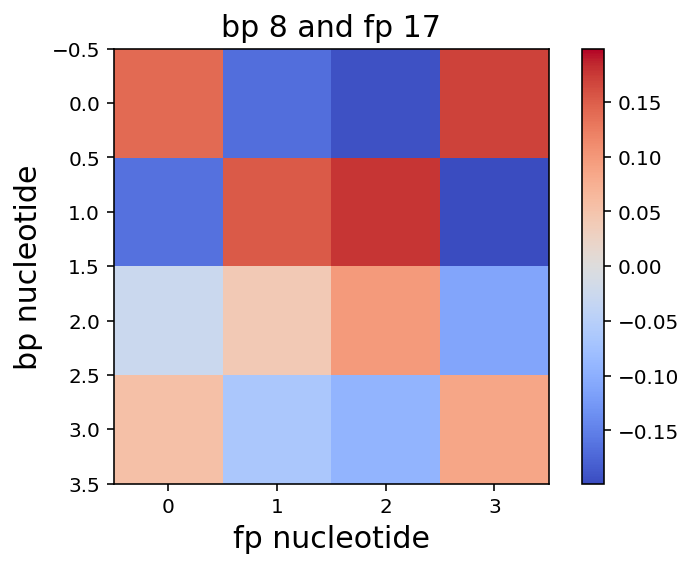

0.00508543267987
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.23', '0.25', '0.28']


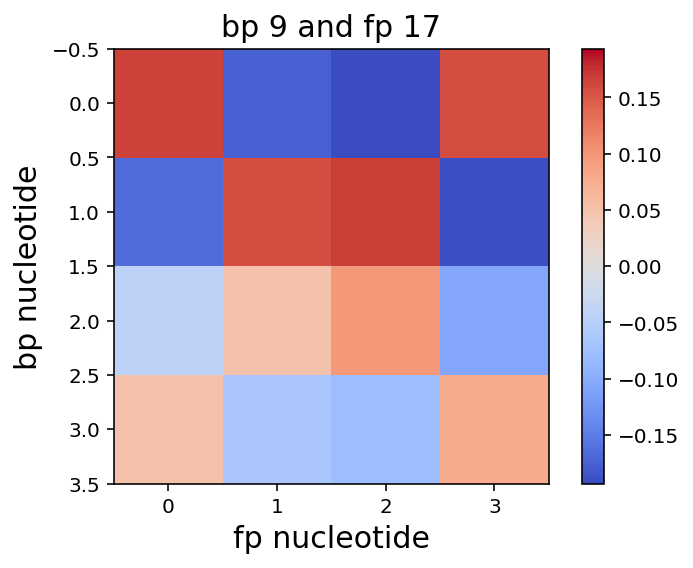

0.00476194156357
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.23', '0.25', '0.28']


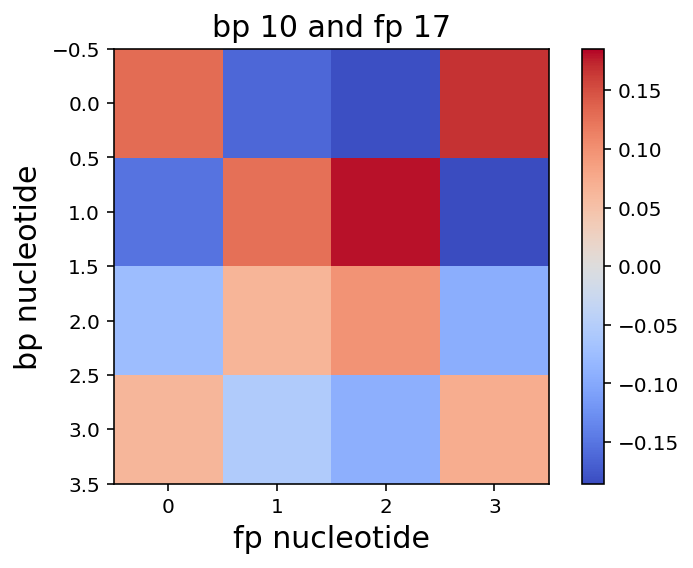

0.00441078364931
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.25', '0.28']


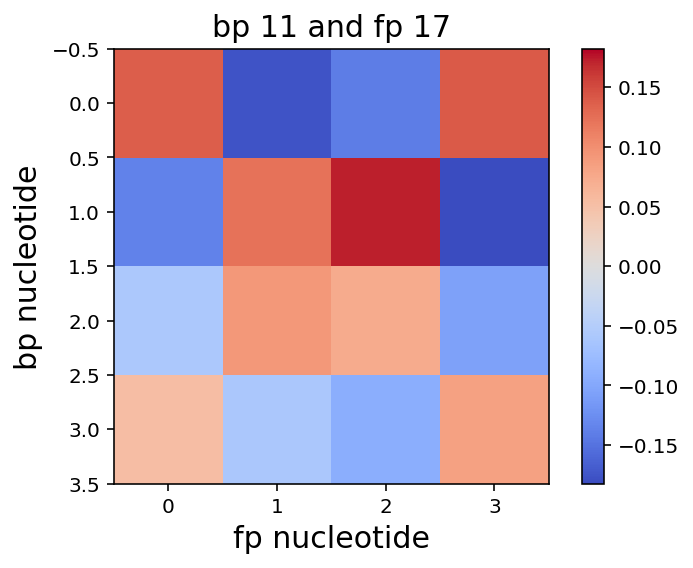

0.00404818839395
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.25', '0.28']


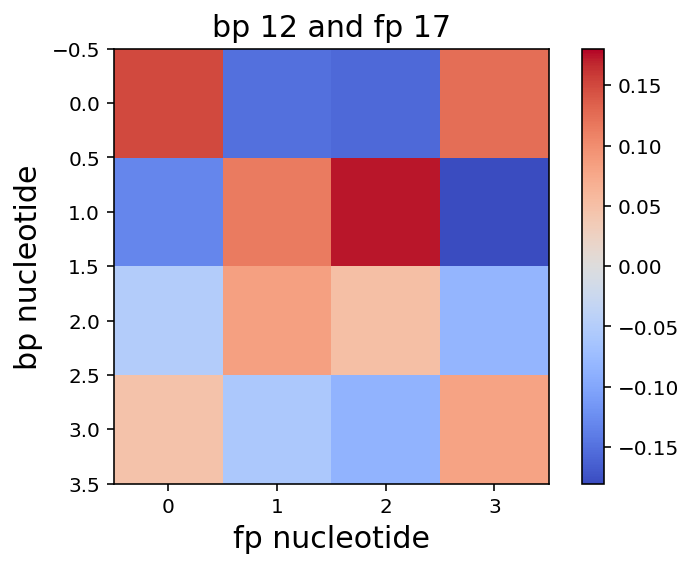

0.00407483399518
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.25', '0.28']


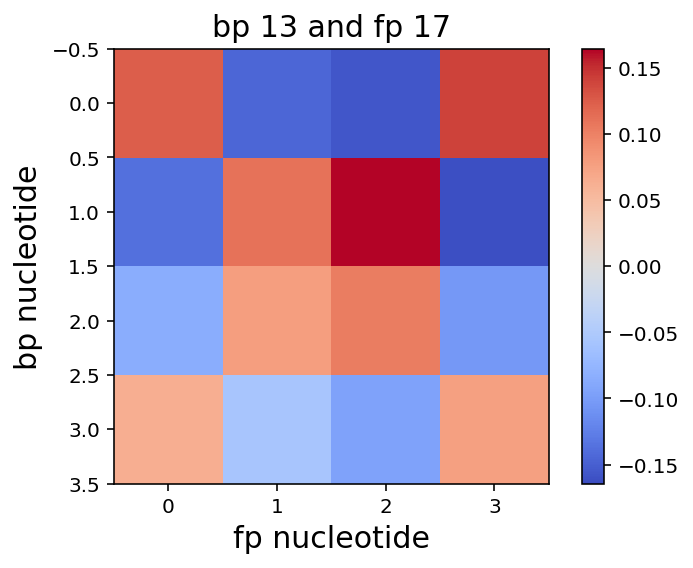

0.00481411093097
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.25', '0.28']


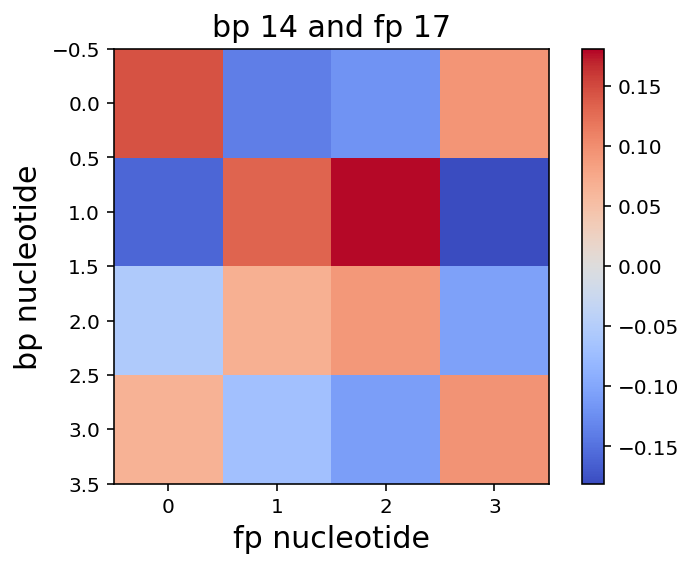

0.00577348415078
['0.24', '0.22', '0.22', '0.30']
['0.21', '0.23', '0.25', '0.28']


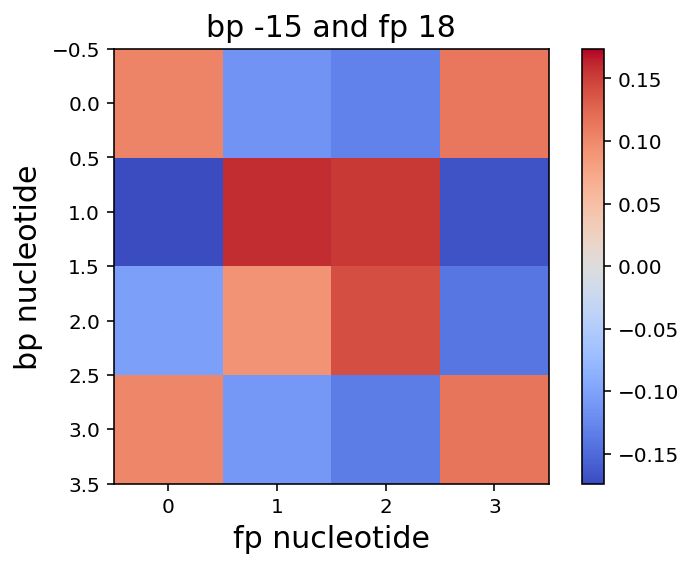

0.00416046455077
['0.25', '0.21', '0.23', '0.30']
['0.21', '0.23', '0.25', '0.28']


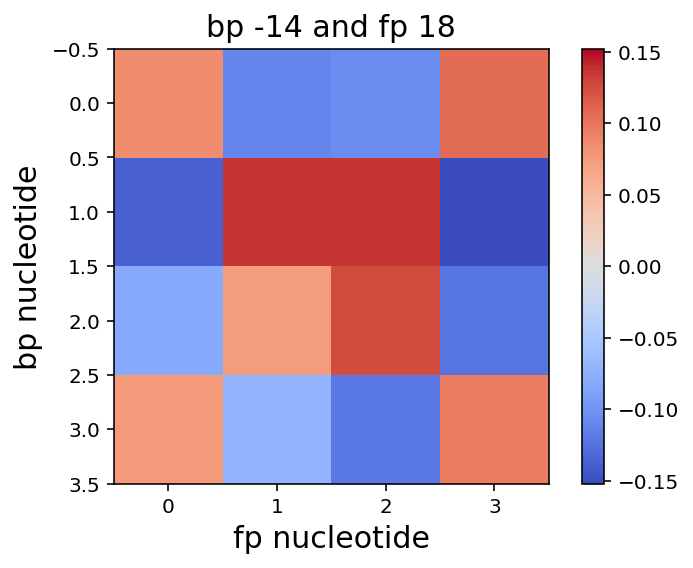

0.00506352347559
['0.25', '0.19', '0.24', '0.29']
['0.21', '0.23', '0.25', '0.28']


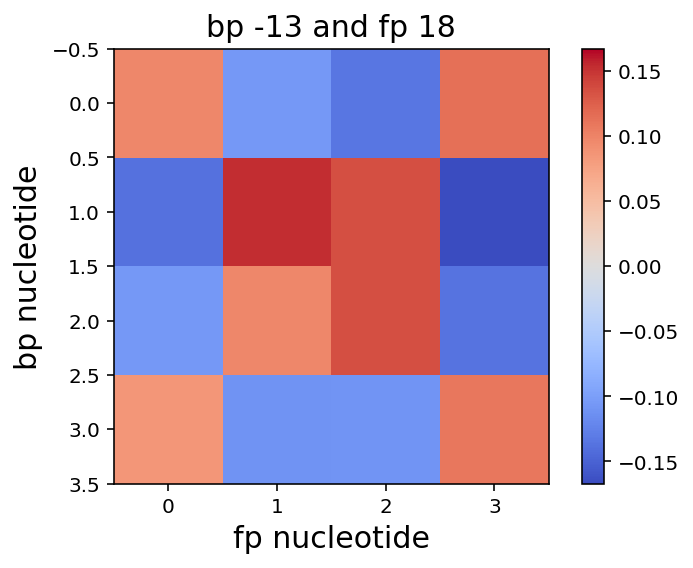

0.00413289314074
['0.26', '0.20', '0.25', '0.28']
['0.21', '0.23', '0.25', '0.28']


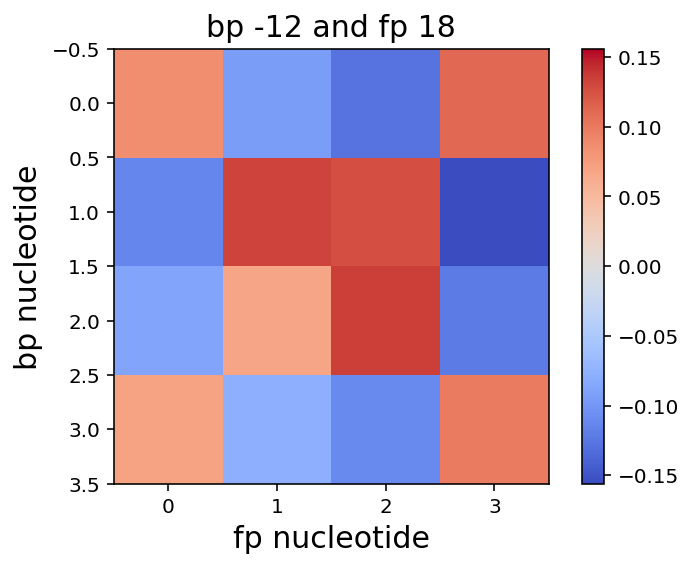

0.00529829624787
['0.25', '0.23', '0.23', '0.27']
['0.21', '0.23', '0.25', '0.28']


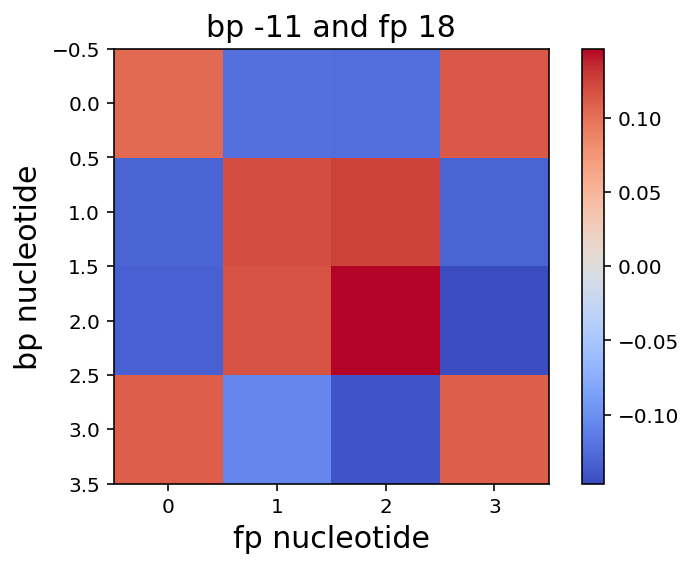

0.00450174250499
['0.24', '0.27', '0.21', '0.26']
['0.21', '0.23', '0.25', '0.28']


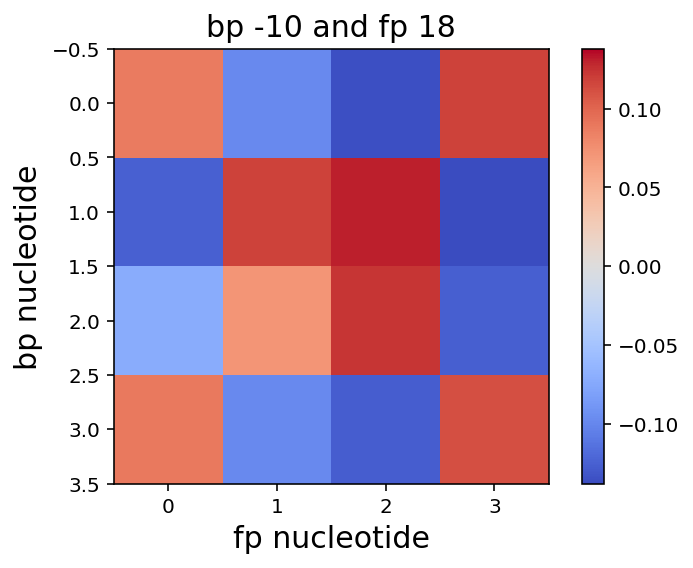

0.00495566497233
['0.24', '0.27', '0.19', '0.27']
['0.21', '0.23', '0.25', '0.28']


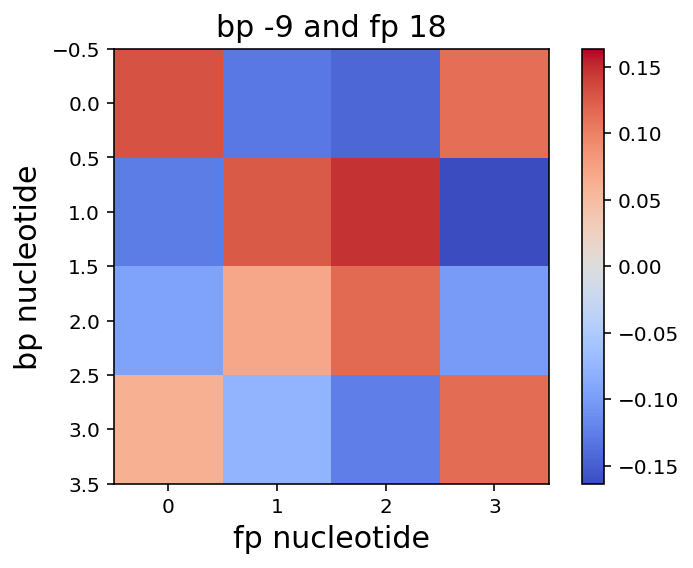

0.00465602022824
['0.25', '0.25', '0.20', '0.28']
['0.21', '0.23', '0.25', '0.28']


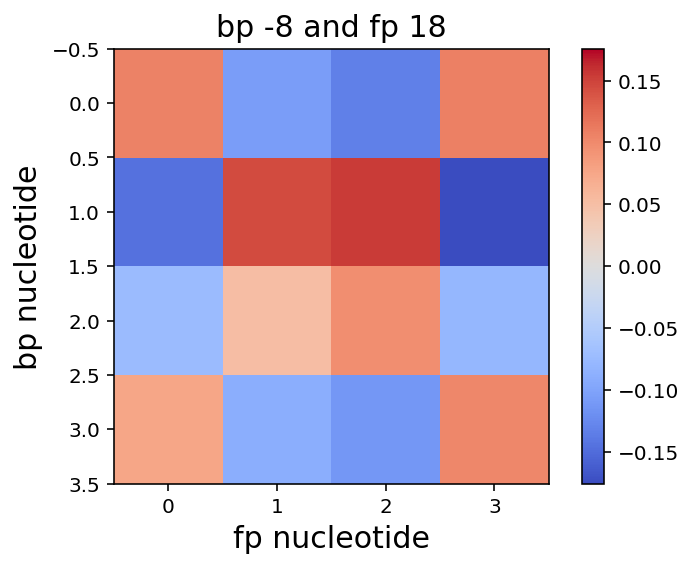

0.00561010698589
['0.25', '0.22', '0.23', '0.28']
['0.21', '0.23', '0.25', '0.28']


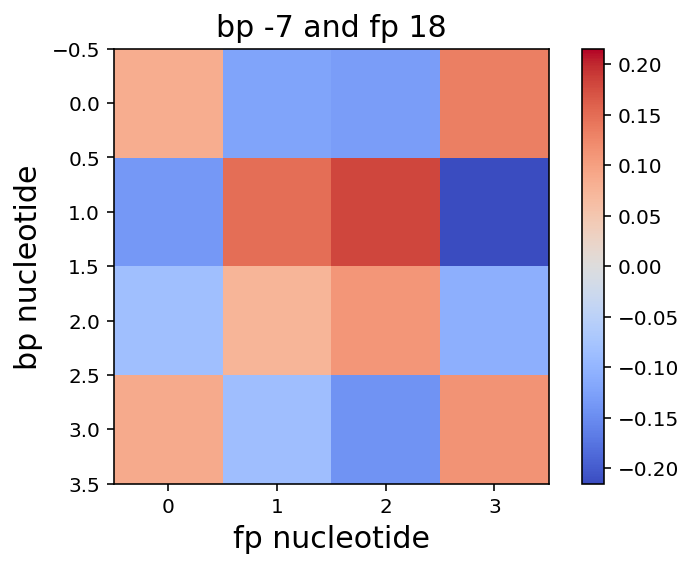

0.00505284514919
['0.26', '0.19', '0.24', '0.30']
['0.21', '0.23', '0.25', '0.28']


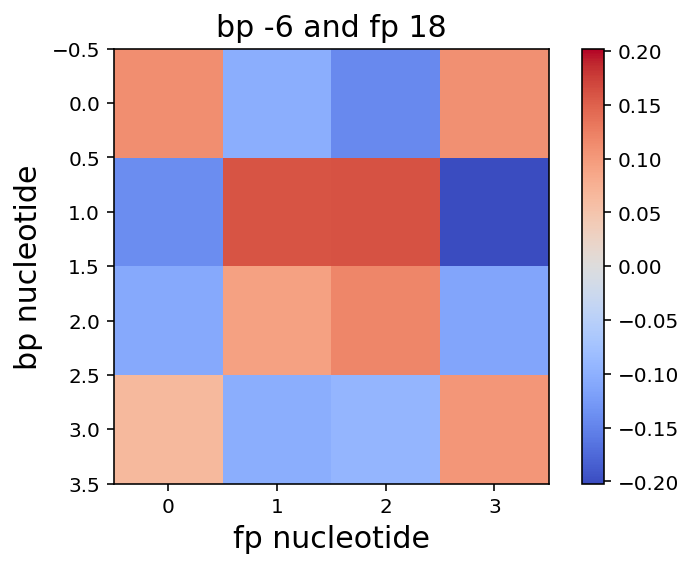

0.00527098698078
['0.23', '0.20', '0.21', '0.34']
['0.21', '0.23', '0.25', '0.28']


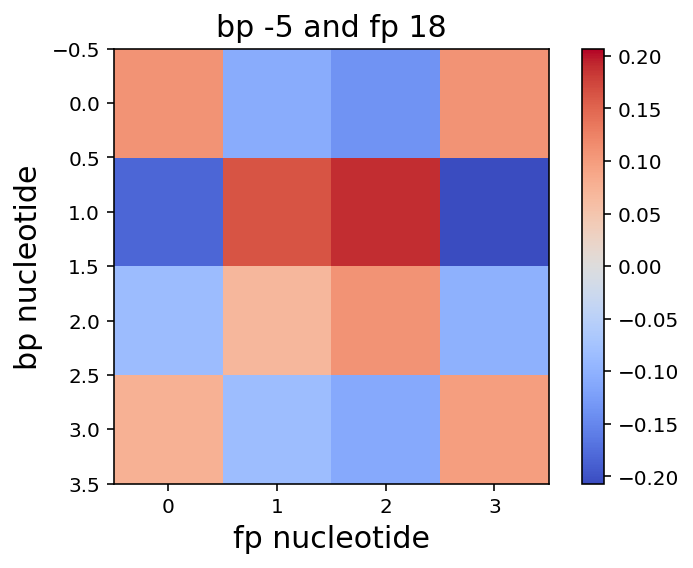

0.00558959182697
['0.27', '0.21', '0.19', '0.30']
['0.21', '0.23', '0.25', '0.28']


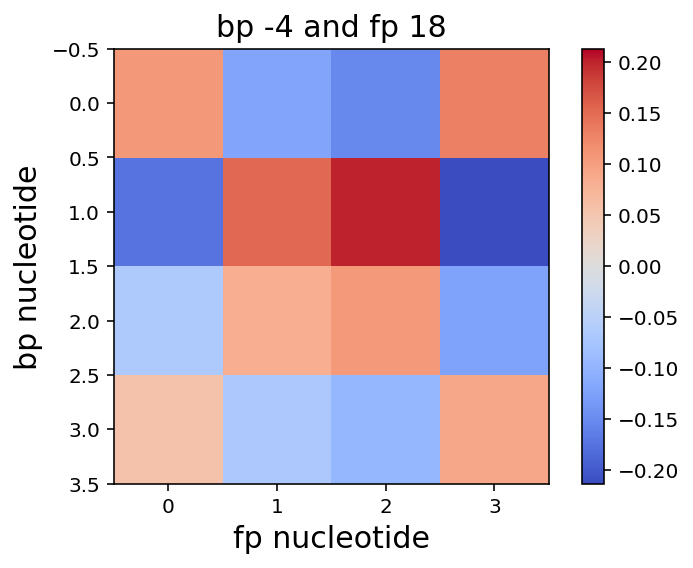

0.00507386830957
['0.09', '0.46', '0.11', '0.33']
['0.21', '0.23', '0.25', '0.28']


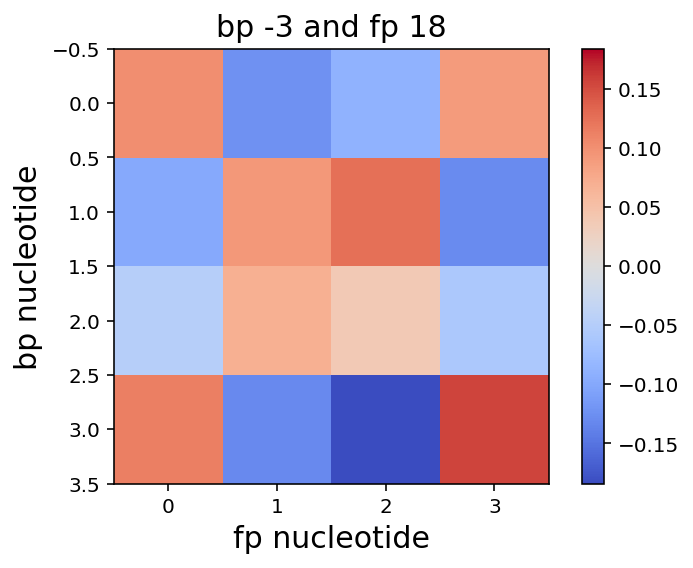

0.00190042910232
['0.06', '0.07', '0.05', '0.81']
['0.21', '0.23', '0.25', '0.28']


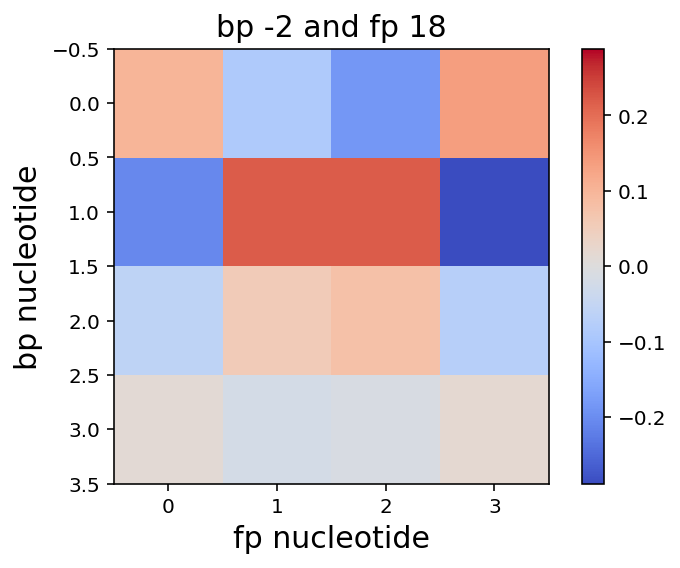

0.00741177498879
['0.24', '0.31', '0.26', '0.17']
['0.21', '0.23', '0.25', '0.28']


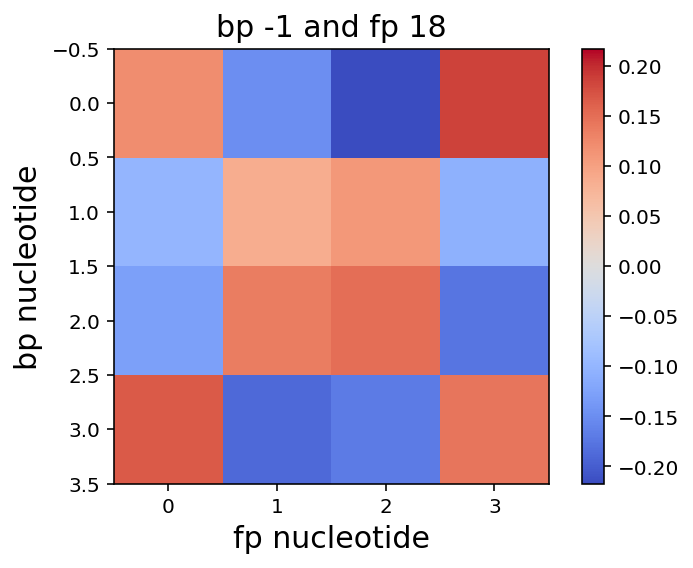

0.000628364292489
['0.98', '0.01', '0.00', '0.00']
['0.21', '0.23', '0.25', '0.28']


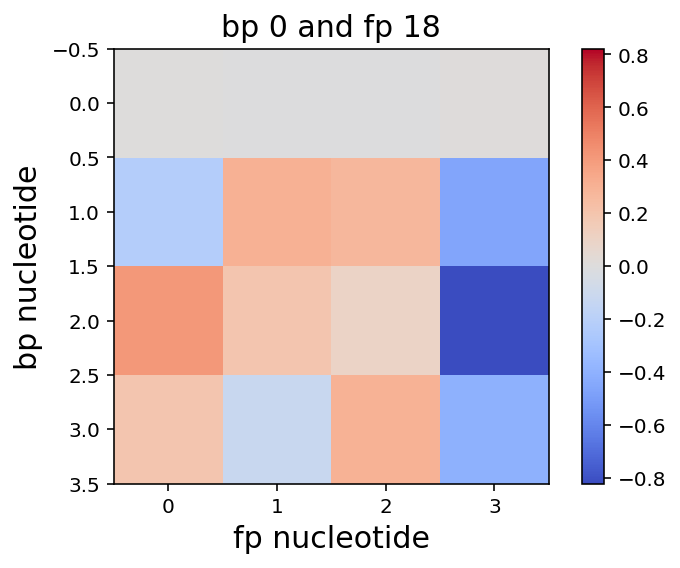

0.00665546174786
['0.18', '0.35', '0.14', '0.31']
['0.21', '0.23', '0.25', '0.28']


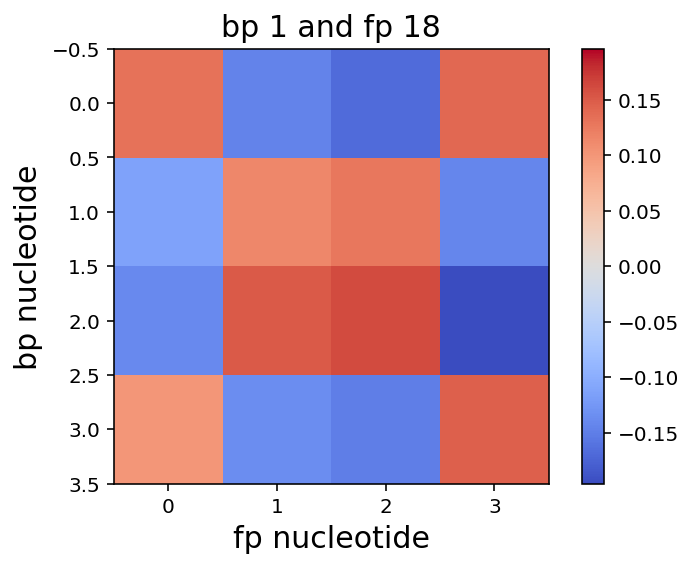

0.00504449749314
['0.23', '0.28', '0.16', '0.31']
['0.21', '0.23', '0.25', '0.28']


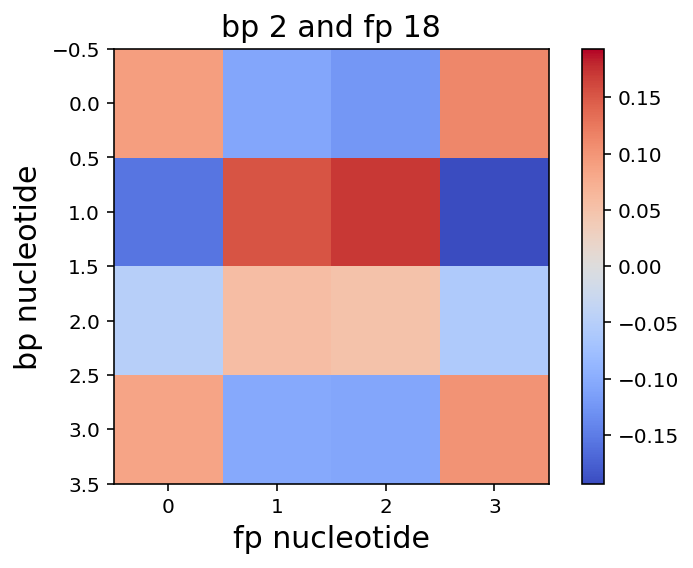

0.00474046690705
['0.22', '0.24', '0.20', '0.32']
['0.21', '0.23', '0.25', '0.28']


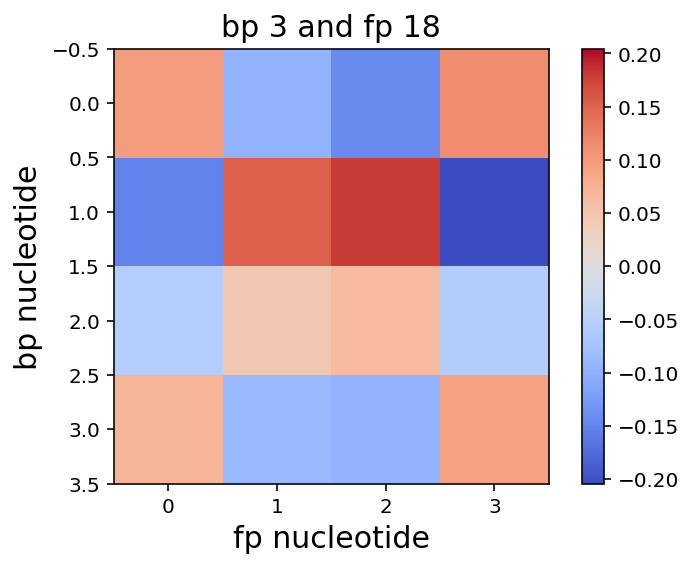

0.00503161546646
['0.20', '0.23', '0.18', '0.36']
['0.21', '0.23', '0.25', '0.28']


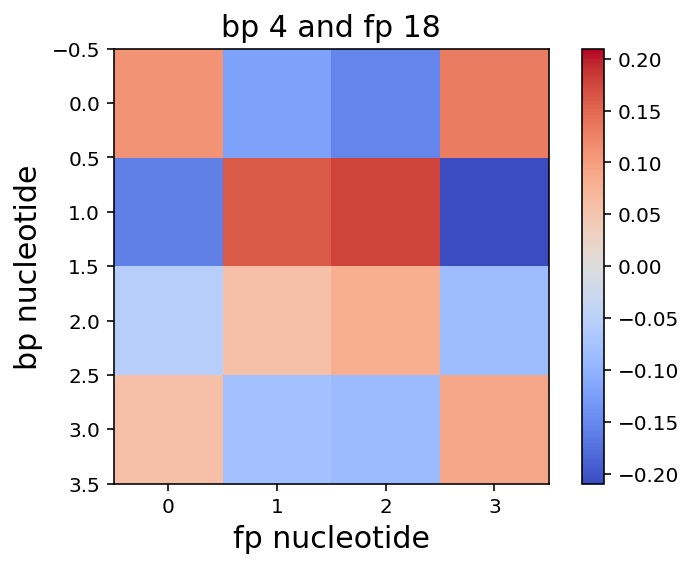

0.00485189626823
['0.19', '0.24', '0.19', '0.36']
['0.21', '0.23', '0.25', '0.28']


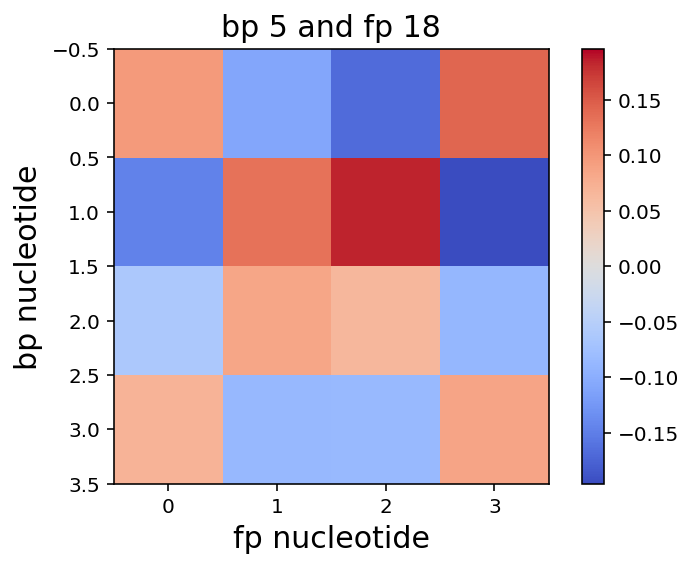

0.00524143358916
['0.18', '0.24', '0.18', '0.39']
['0.21', '0.23', '0.25', '0.28']


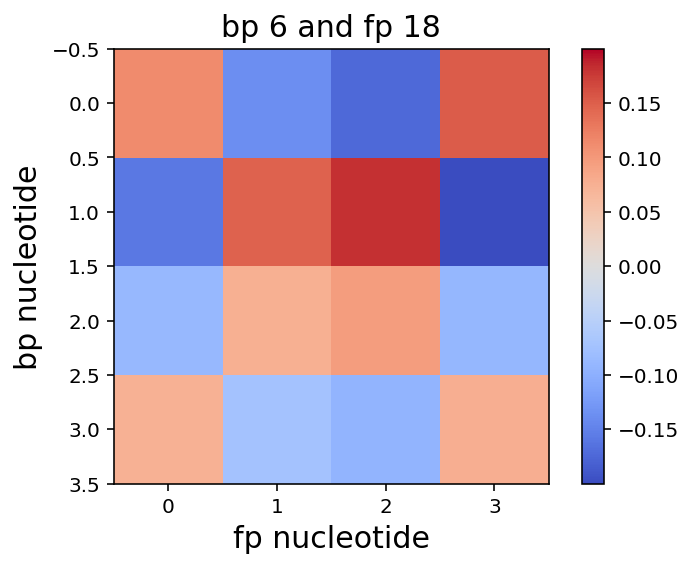

0.00558899715508
['0.15', '0.26', '0.15', '0.42']
['0.21', '0.23', '0.25', '0.28']


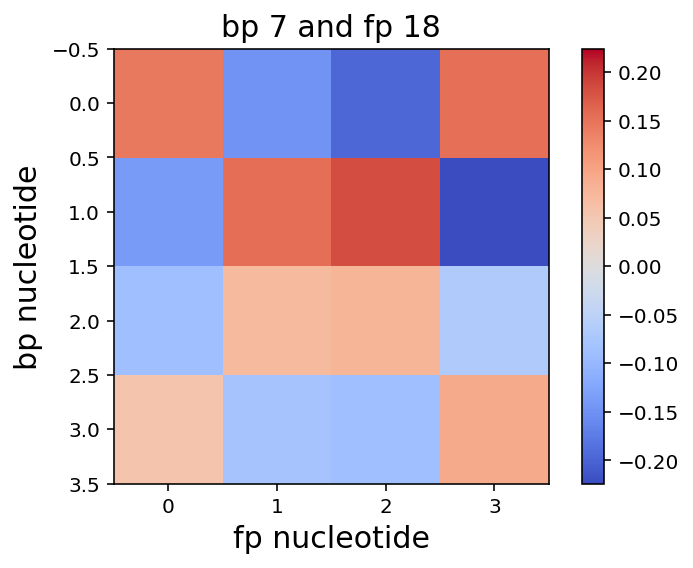

0.0051598039808
['0.13', '0.27', '0.12', '0.45']
['0.21', '0.23', '0.25', '0.28']


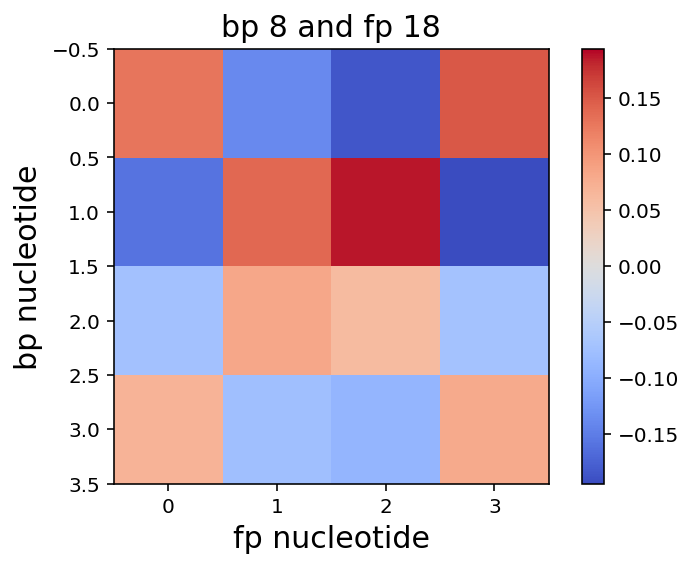

0.00495642319734
['0.12', '0.27', '0.11', '0.49']
['0.21', '0.23', '0.25', '0.28']


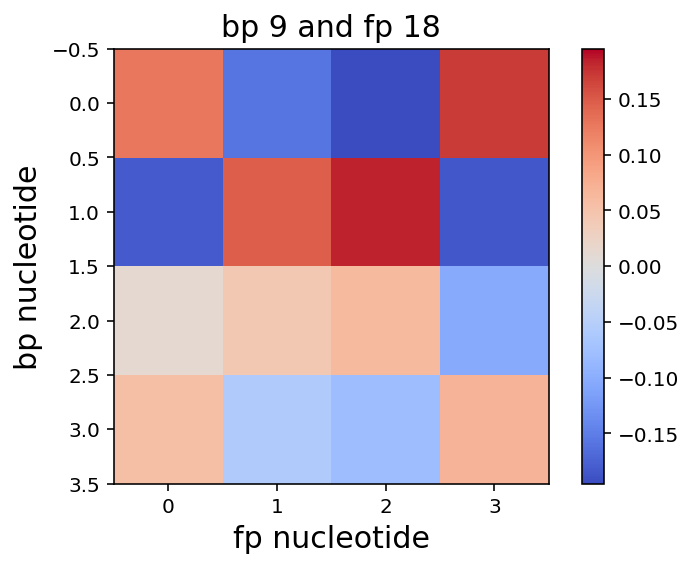

0.00499291420128
['0.11', '0.27', '0.11', '0.50']
['0.21', '0.23', '0.25', '0.28']


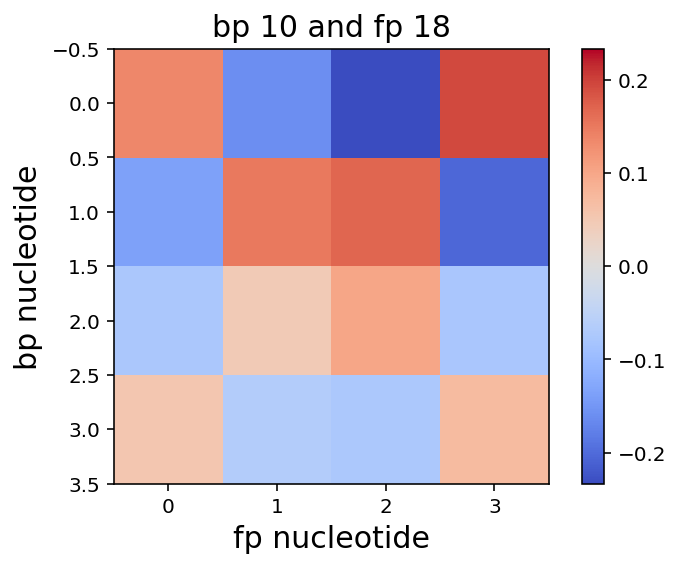

0.00431108681931
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.25', '0.28']


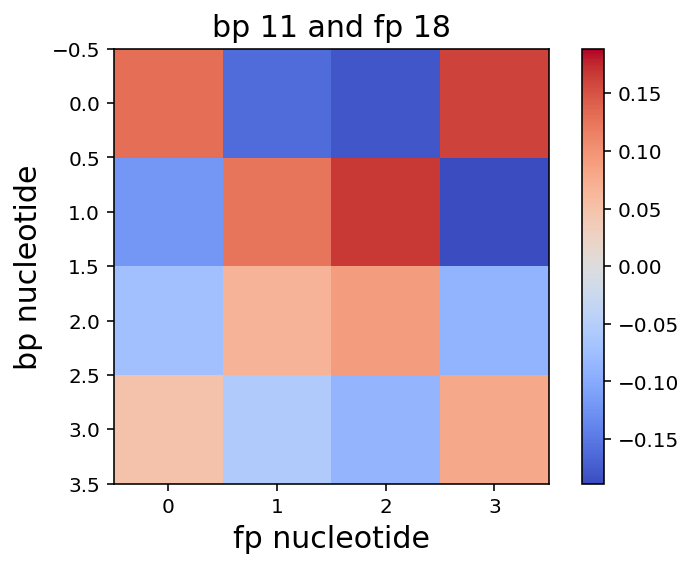

0.00427161883263
['0.09', '0.27', '0.11', '0.51']
['0.21', '0.23', '0.25', '0.28']


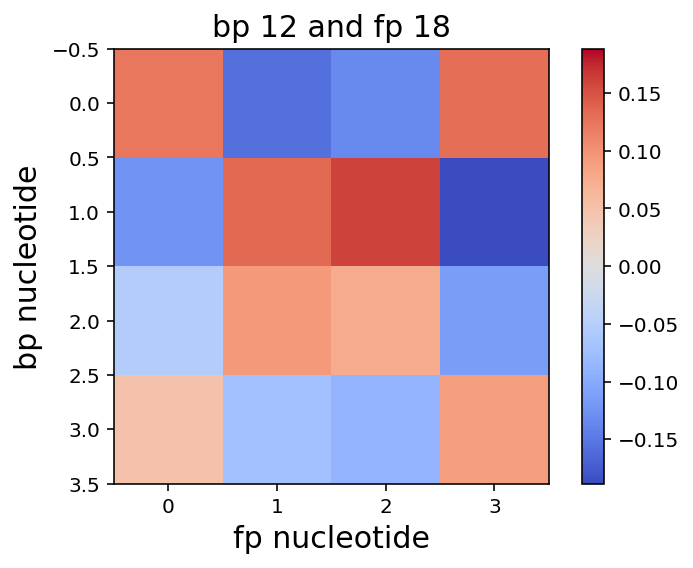

0.00466713476581
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.25', '0.28']


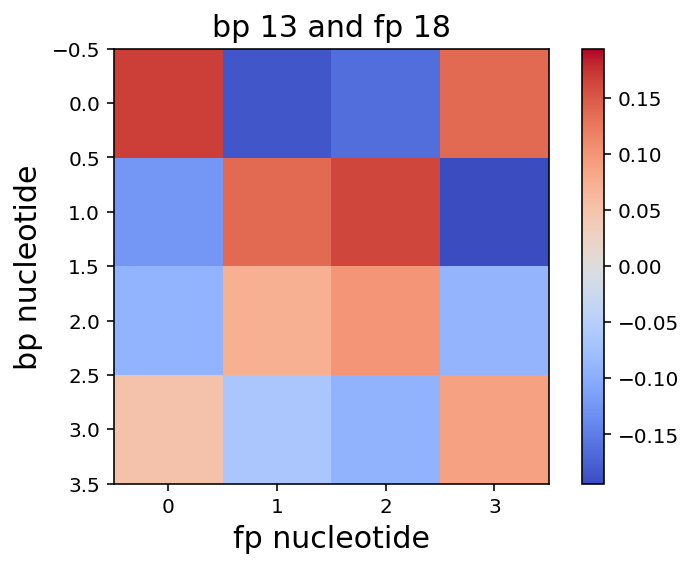

0.00467442555291
['0.09', '0.28', '0.10', '0.51']
['0.21', '0.23', '0.25', '0.28']


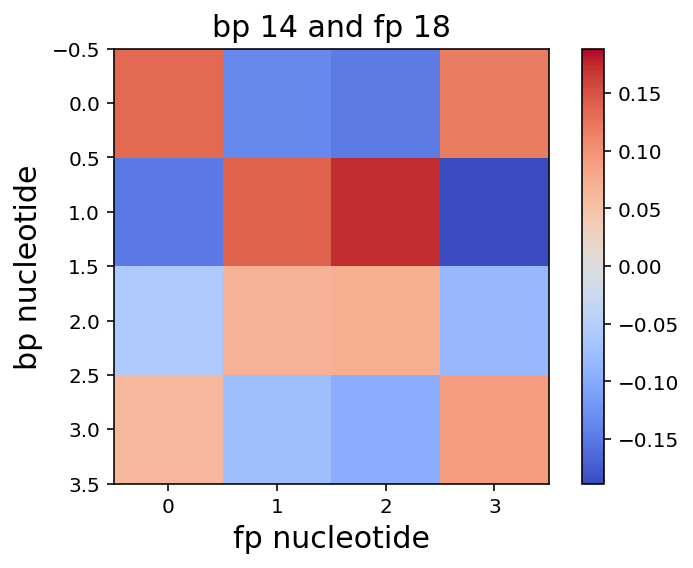

0.00533451328369
['0.24', '0.22', '0.22', '0.30']
['0.22', '0.23', '0.25', '0.28']


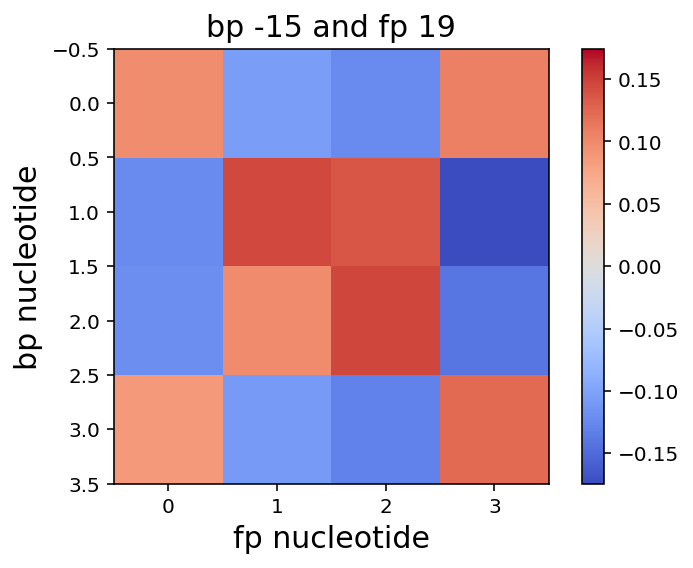

0.0044219789112
['0.25', '0.21', '0.23', '0.30']
['0.22', '0.23', '0.25', '0.28']


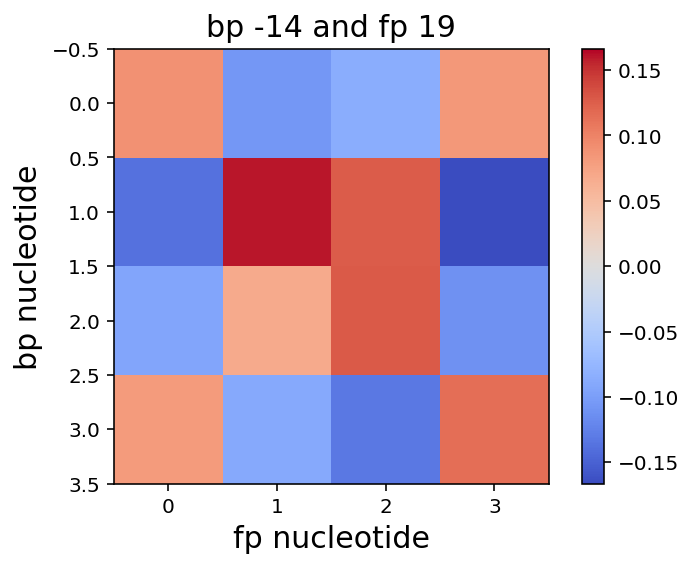

0.00487694886752
['0.25', '0.19', '0.24', '0.29']
['0.22', '0.23', '0.25', '0.28']


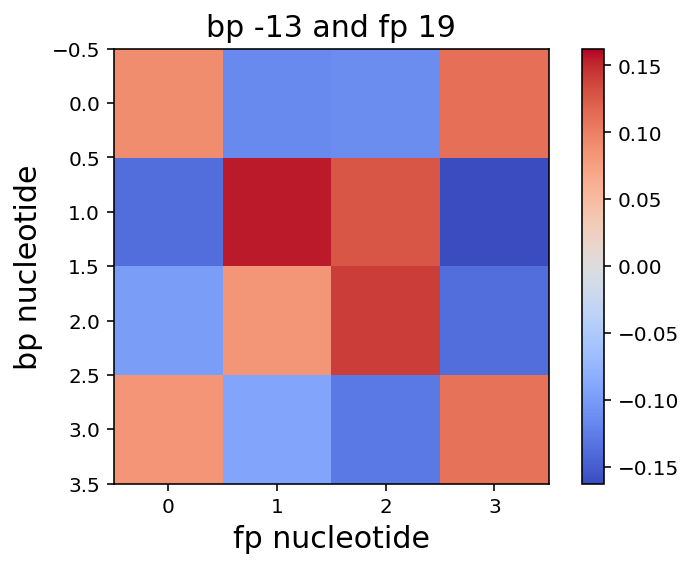

0.00440646400201
['0.26', '0.20', '0.25', '0.28']
['0.22', '0.23', '0.25', '0.28']


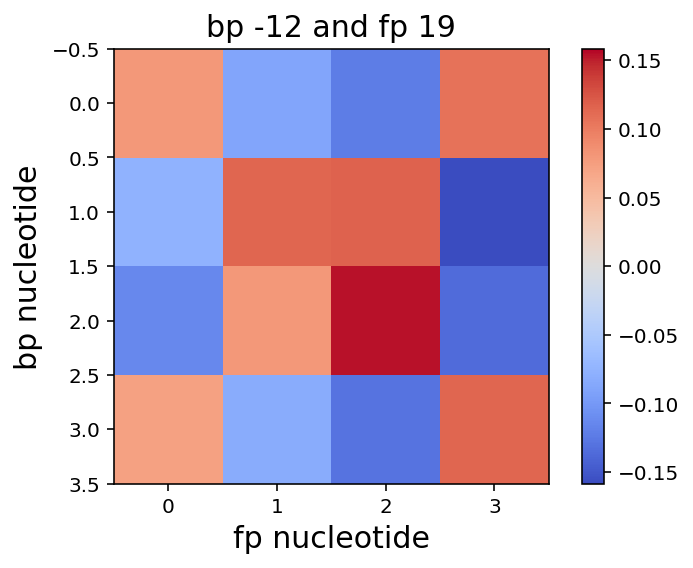

0.00436625800055
['0.25', '0.23', '0.23', '0.27']
['0.22', '0.23', '0.25', '0.28']


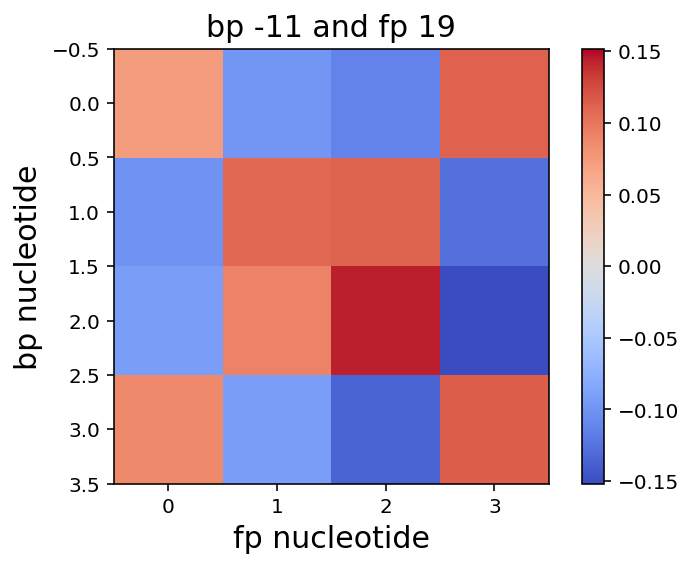

0.00495585802338
['0.24', '0.27', '0.21', '0.26']
['0.22', '0.23', '0.25', '0.28']


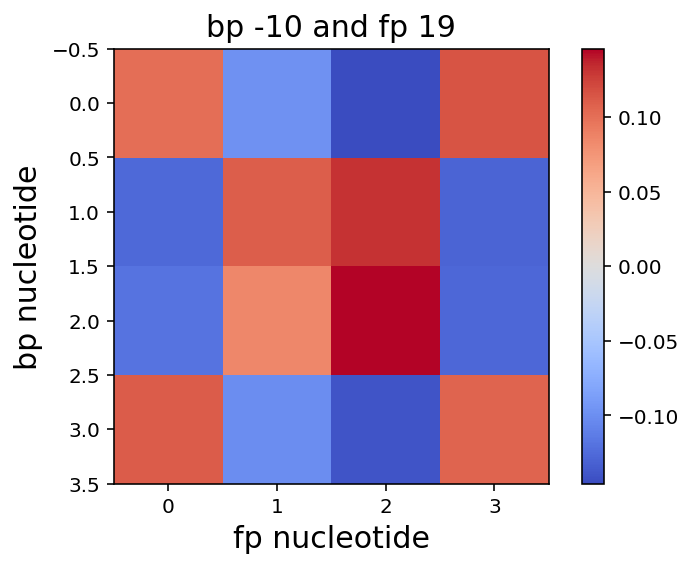

0.0042929080197
['0.24', '0.27', '0.19', '0.27']
['0.22', '0.23', '0.25', '0.28']


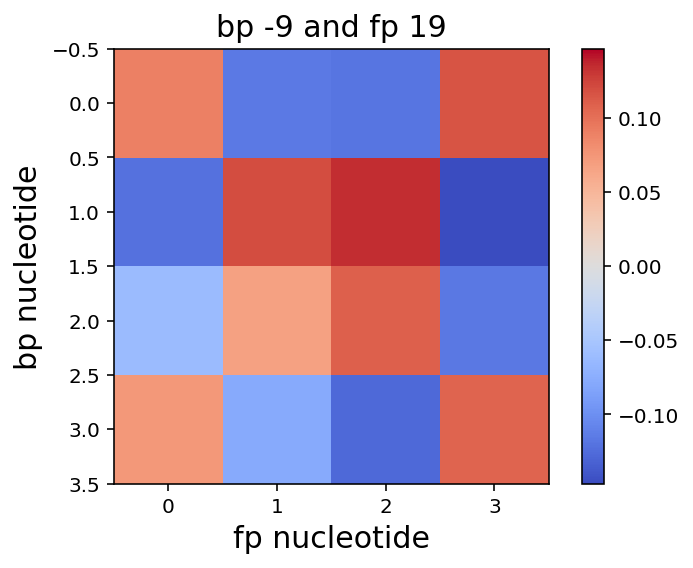

0.00524426999364
['0.25', '0.25', '0.20', '0.28']
['0.22', '0.23', '0.25', '0.28']


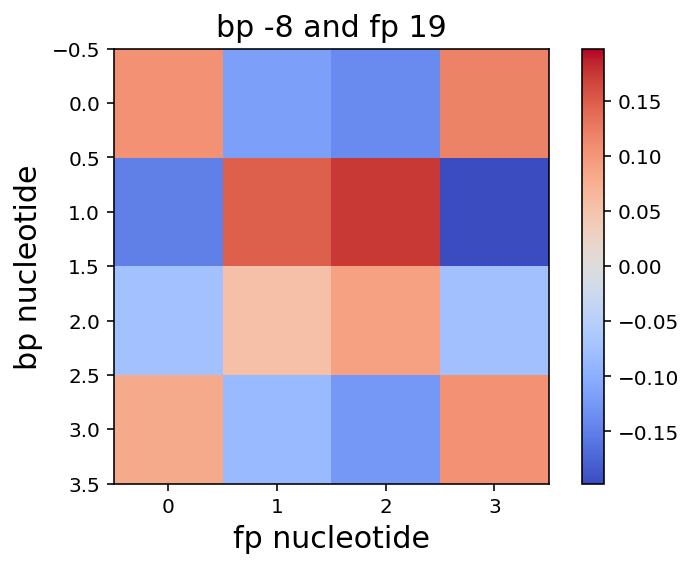

0.0048913542824
['0.25', '0.22', '0.23', '0.28']
['0.22', '0.23', '0.25', '0.28']


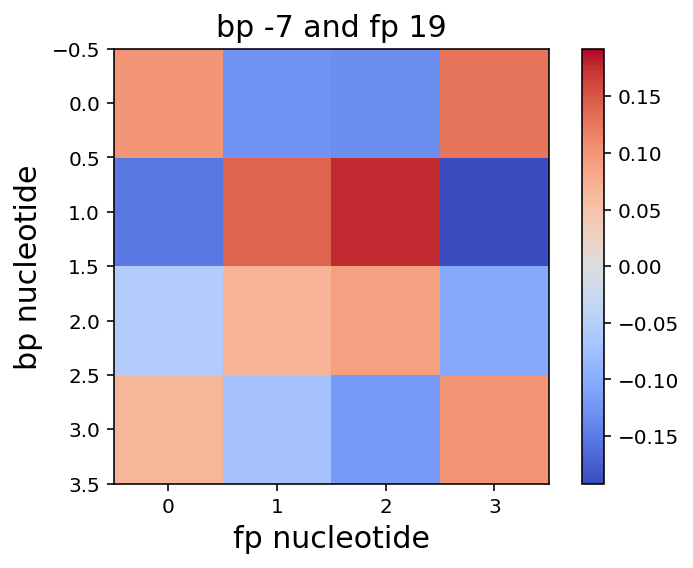

0.00531721490964
['0.26', '0.19', '0.24', '0.30']
['0.22', '0.23', '0.25', '0.28']


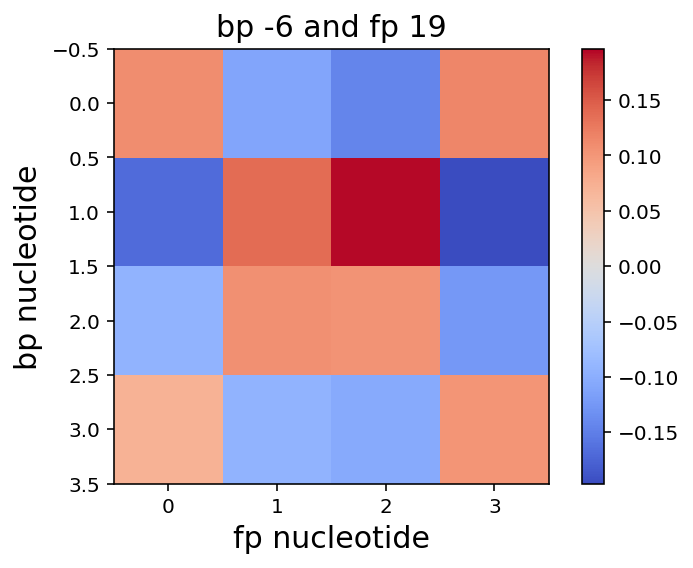

0.00510557669594
['0.23', '0.20', '0.21', '0.34']
['0.22', '0.23', '0.25', '0.28']


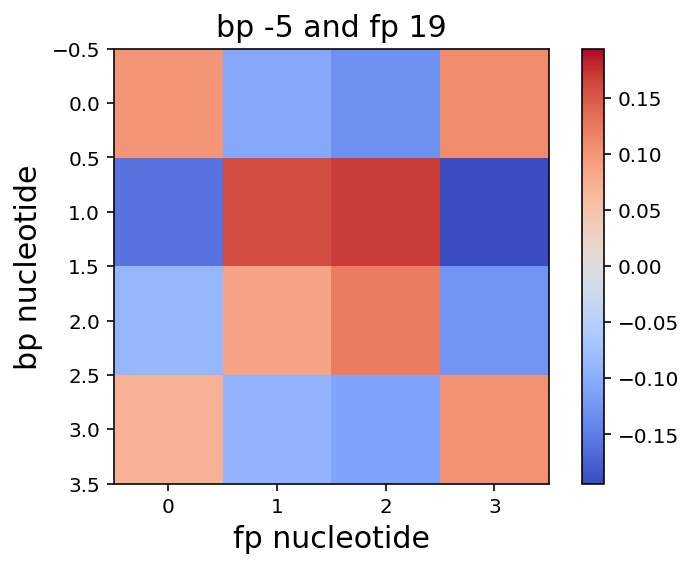

0.00506192948532
['0.27', '0.21', '0.19', '0.30']
['0.22', '0.23', '0.25', '0.28']


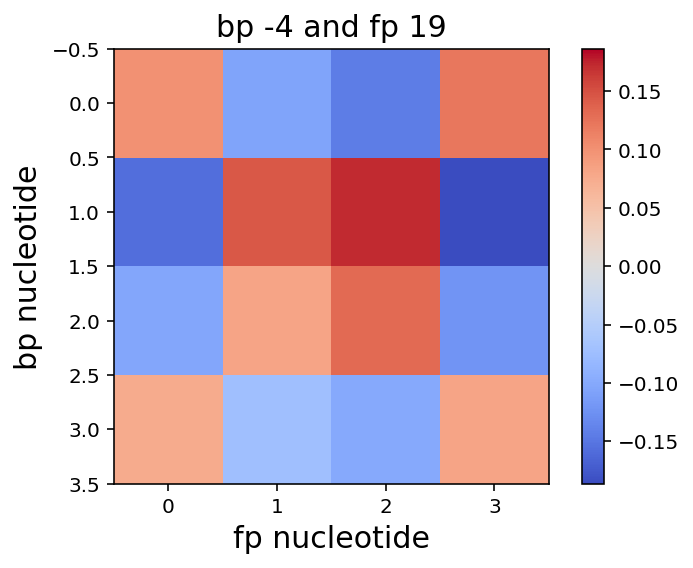

0.0059553014016
['0.09', '0.46', '0.11', '0.33']
['0.22', '0.23', '0.25', '0.28']


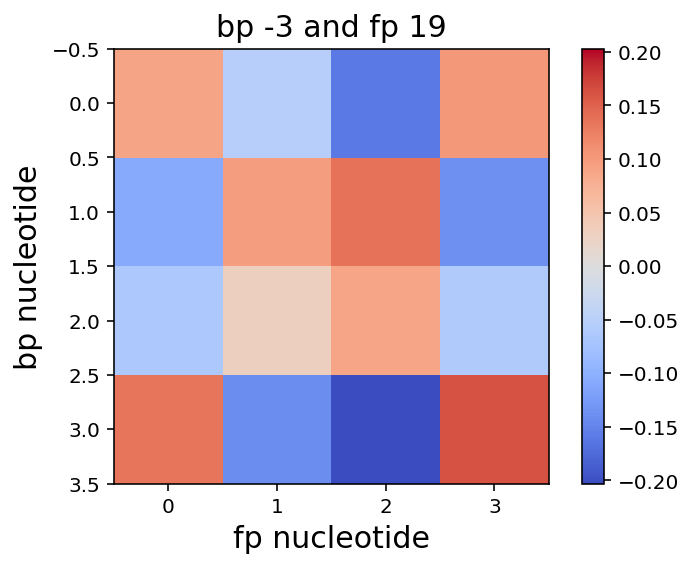

0.00175176871412
['0.06', '0.07', '0.05', '0.81']
['0.22', '0.23', '0.25', '0.28']


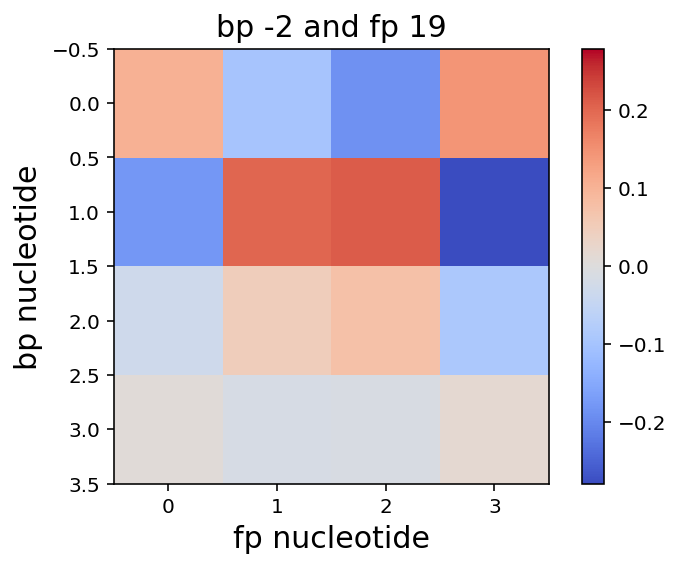

0.00693030988113
['0.24', '0.31', '0.26', '0.17']
['0.22', '0.23', '0.25', '0.28']


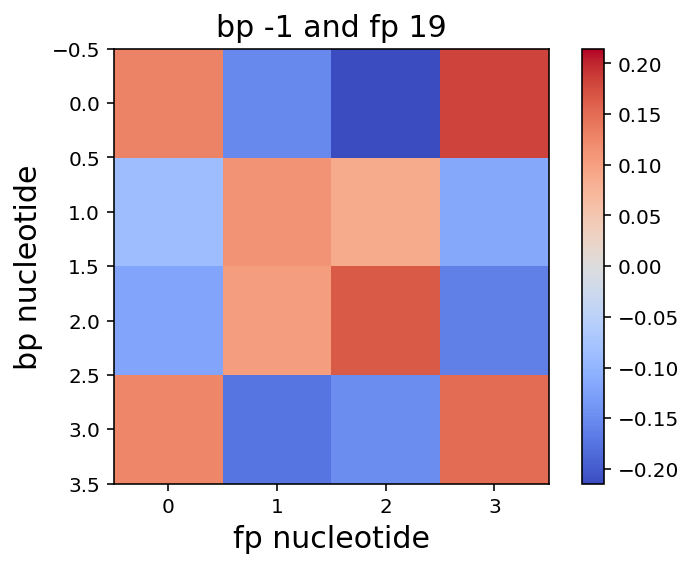

0.00060468190854
['0.98', '0.01', '0.00', '0.00']
['0.22', '0.23', '0.25', '0.28']


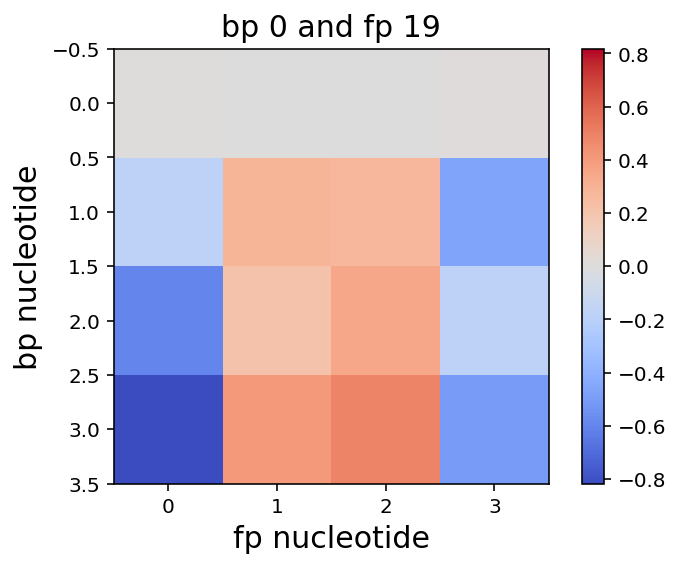

0.00580122201381
['0.18', '0.35', '0.14', '0.31']
['0.22', '0.23', '0.25', '0.28']


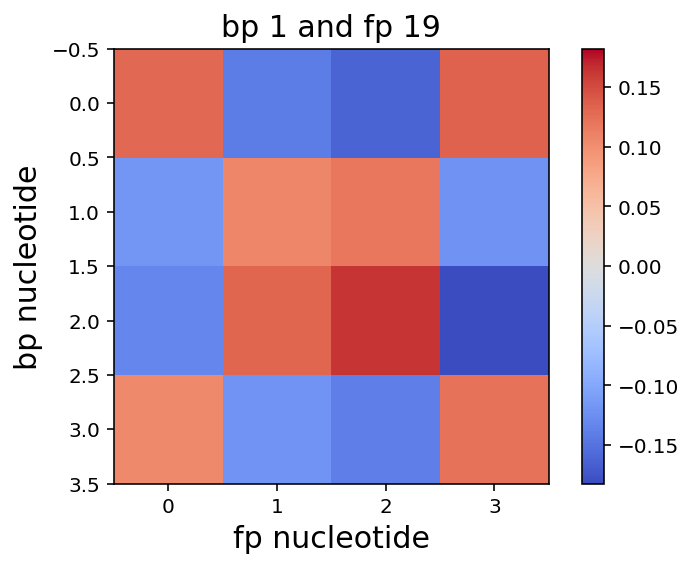

0.00468722278019
['0.23', '0.28', '0.16', '0.31']
['0.22', '0.23', '0.25', '0.28']


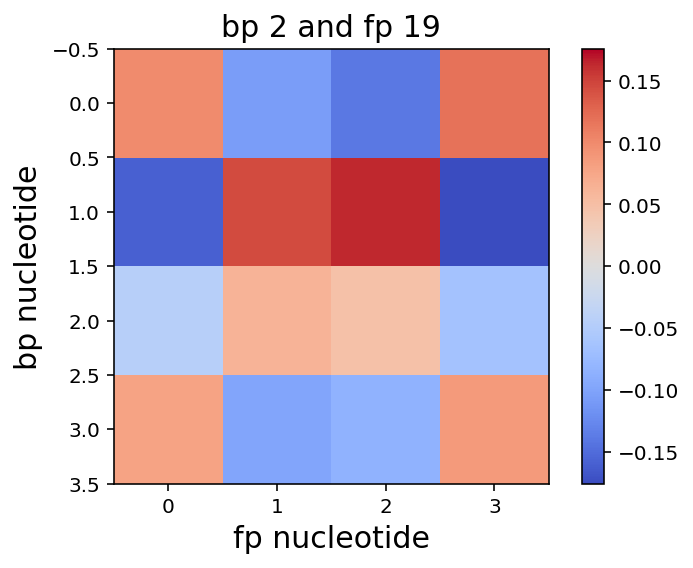

0.004022888068
['0.22', '0.24', '0.20', '0.32']
['0.22', '0.23', '0.25', '0.28']


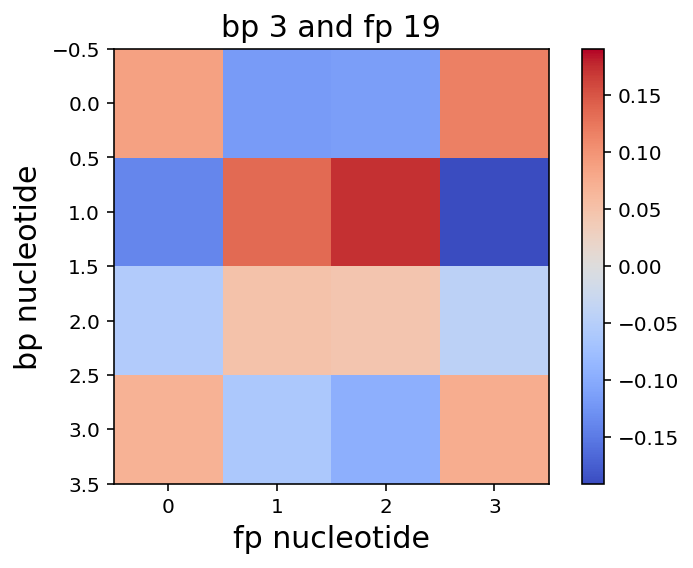

0.00489793460439
['0.20', '0.23', '0.18', '0.36']
['0.22', '0.23', '0.25', '0.28']


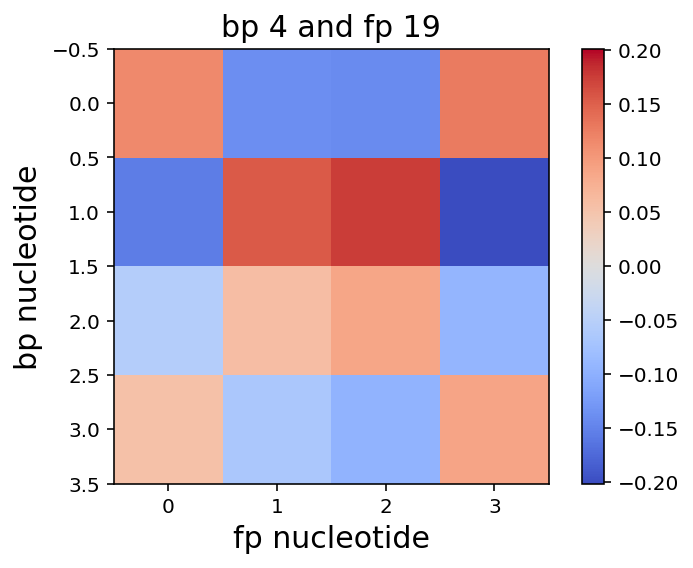

0.00468824063441
['0.19', '0.24', '0.19', '0.36']
['0.22', '0.23', '0.25', '0.28']


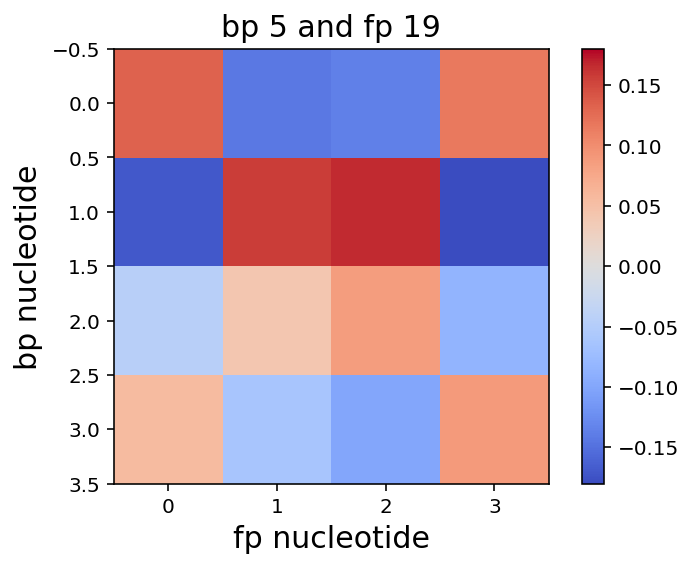

0.00483786448207
['0.18', '0.24', '0.18', '0.39']
['0.22', '0.23', '0.25', '0.28']


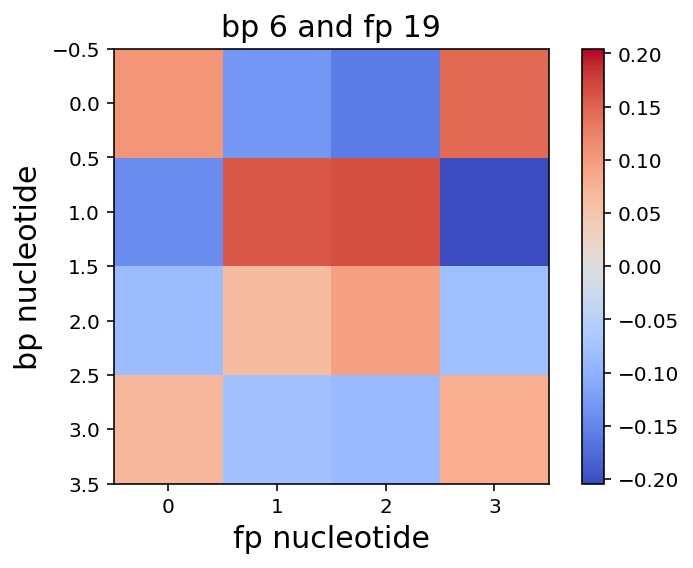

0.00516476872087
['0.15', '0.26', '0.15', '0.42']
['0.22', '0.23', '0.25', '0.28']


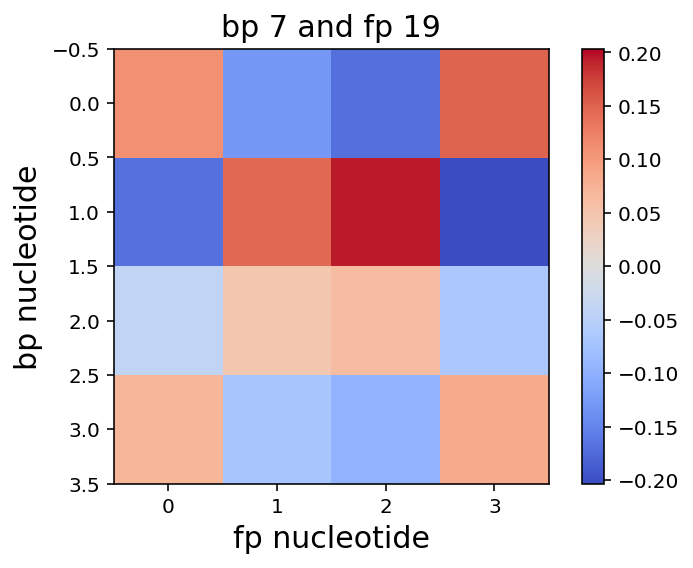

0.00503811678028
['0.13', '0.27', '0.12', '0.45']
['0.22', '0.23', '0.25', '0.28']


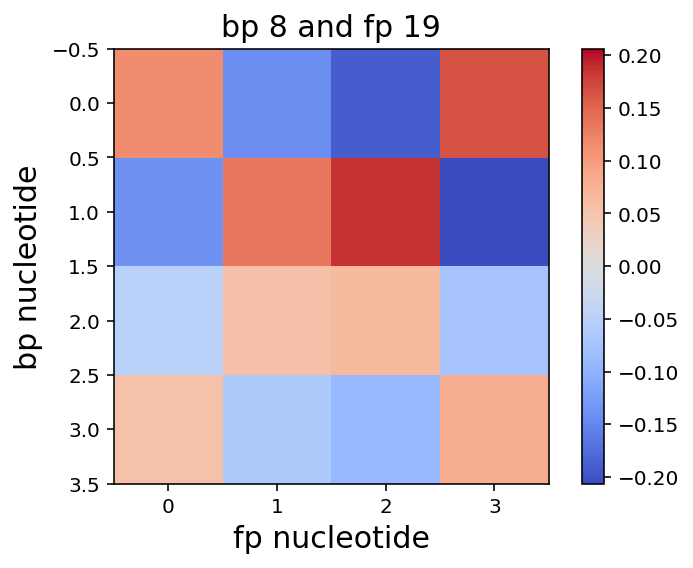

0.00498712247057
['0.12', '0.27', '0.11', '0.49']
['0.22', '0.23', '0.25', '0.28']


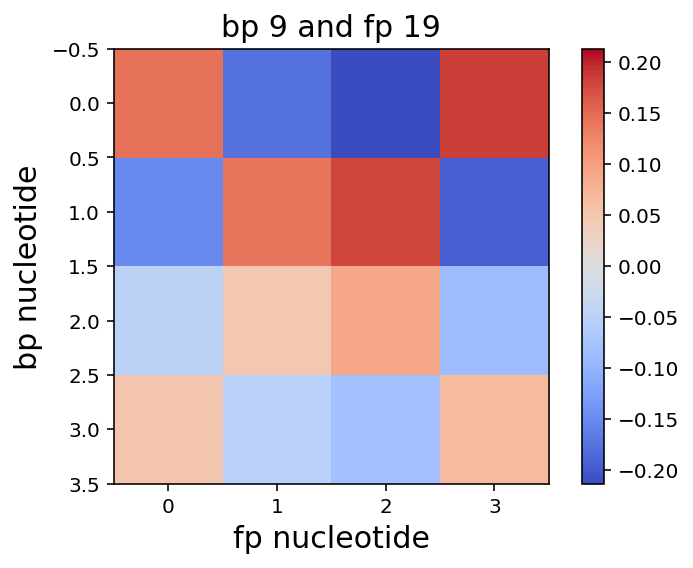

0.00452339445088
['0.11', '0.27', '0.11', '0.50']
['0.22', '0.23', '0.25', '0.28']


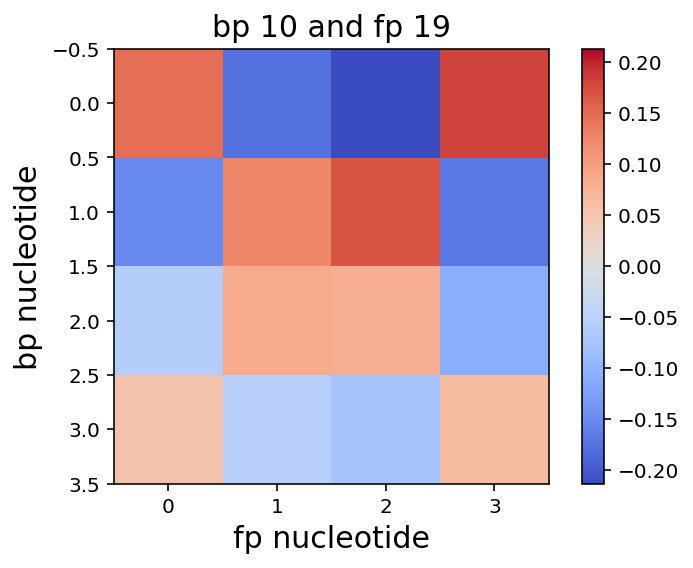

0.0047846539833
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.23', '0.25', '0.28']


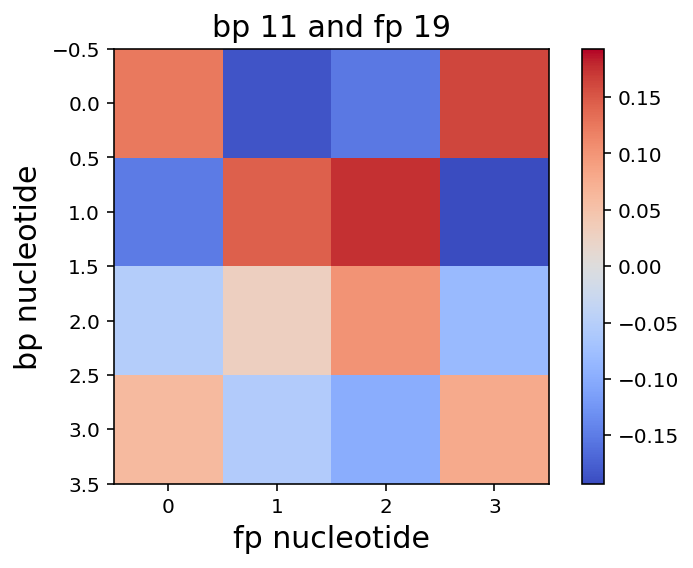

0.00408350223302
['0.09', '0.27', '0.11', '0.51']
['0.22', '0.23', '0.25', '0.28']


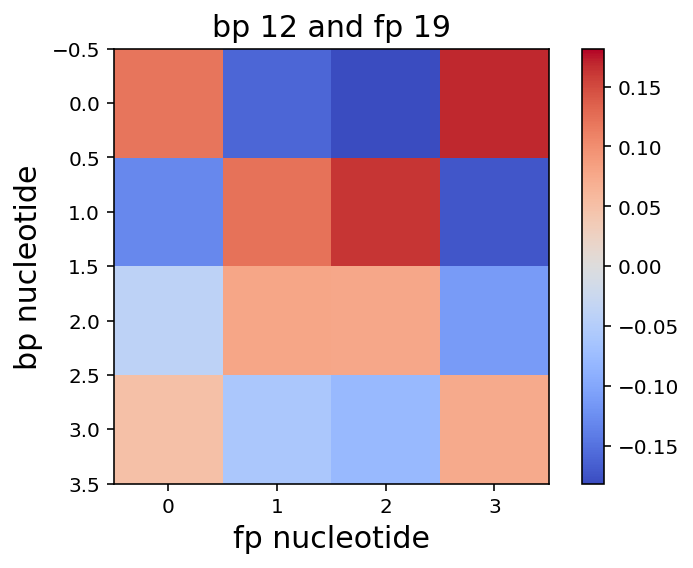

0.00451319896165
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.23', '0.25', '0.28']


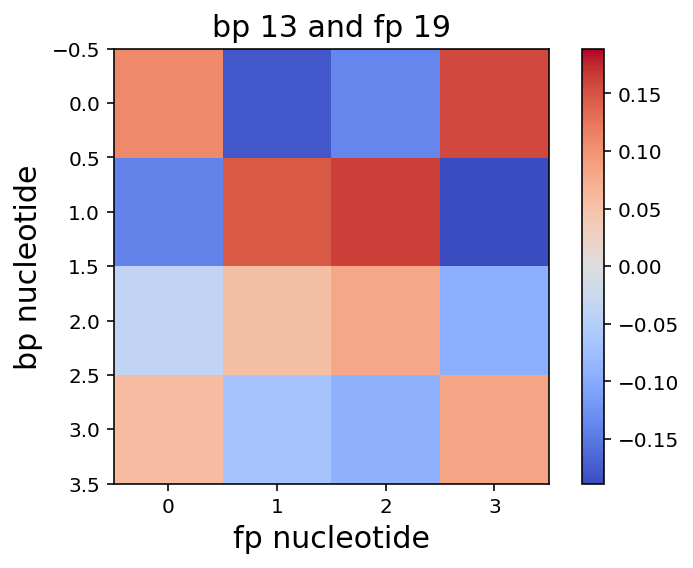

0.00435256379946
['0.09', '0.28', '0.10', '0.51']
['0.22', '0.23', '0.25', '0.28']


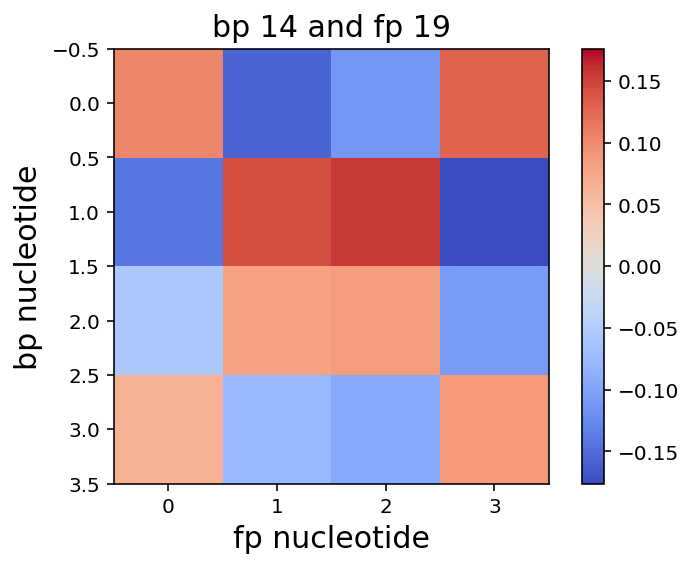

In [17]:
for i in range(fp_l, fp_seqs.shape[1]):
    for j in range(bp_seqs.shape[1]):
        X = np.zeros((4, 4))
        mi = 0
        bp, fp = [], []
        for bp_base in range(4): 
            for fp_base in range(4):
                p_fp = np.mean(fp_seqs[:, i, fp_base])
                p_bp = np.mean(bp_seqs[:, j, bp_base])
                p_fp_bp = np.mean(fp_seqs[:, i, fp_base]*bp_seqs[:, j, bp_base])
                X[bp_base, fp_base] = np.log2(p_fp_bp) - np.log2(p_fp) - np.log2(p_bp)
                mi += p_fp_bp * (np.log2(p_fp_bp) - np.log2(p_fp) - np.log2(p_bp))
                if not fp_base: bp += [p_bp]
                if not bp_base: fp += [p_fp]
        print mi
        print map(lambda x: str(x)[:4], bp)
        print map(lambda x: str(x)[:4], fp)
        plt.imshow(X, vmin=-np.max(np.abs(X)), vmax=np.max(np.abs(X)), cmap = 'coolwarm')
        plt.title('bp {} and fp {}'.format(-(bp_l-j), -(fp_l-i)))
        plt.xlabel('fp nucleotide')
        plt.ylabel('bp nucleotide')
        plt.colorbar()
        plt.show()

0.00765767305928
['0.24', '0.22', '0.22', '0.30']
['0.60', '0.02', '0.34', '0.02']


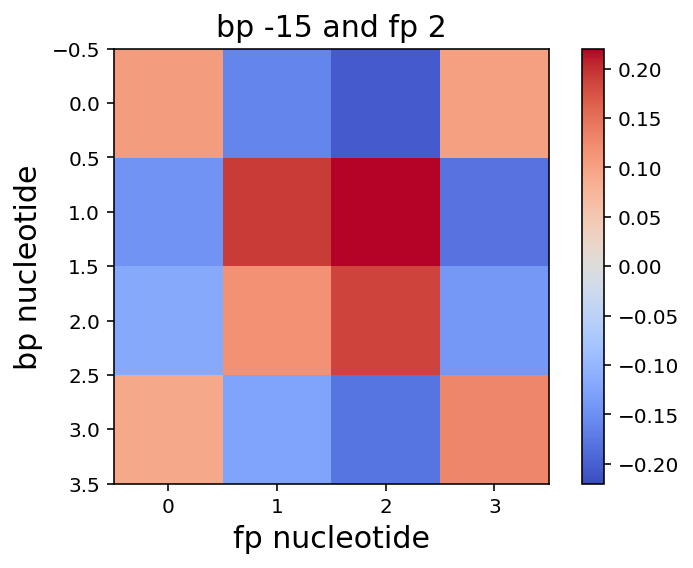

0.00765767305928
-0.0991288421759


In [18]:
for i in range(fp_l+2, fp_seqs.shape[1]):
    for j in range(bp_seqs.shape[1]):
        X = np.zeros((4, 4))
        mi = 0
        bp, fp = [], []
        for bp_base in range(4): 
            for fp_base in range(4):
                p_fp = np.mean(fp_seqs[:, i, fp_base])
                p_bp = np.mean(bp_seqs[:, j, bp_base])
                p_fp_bp = np.mean(fp_seqs[:, i, fp_base]*bp_seqs[:, j, bp_base])
                X[bp_base, fp_base] = np.log2(p_fp_bp) - np.log2(p_fp) - np.log2(p_bp)
                mi += p_fp_bp * (np.log2(p_fp_bp) - np.log2(p_fp) - np.log2(p_bp))
                if not fp_base: bp += [p_bp]
                if not bp_base: fp += [p_fp]
        print mi
        print map(lambda x: str(x)[:4], bp)
        print map(lambda x: str(x)[:4], fp)
        plt.imshow(X, vmin=-np.max(np.abs(X)), vmax=np.max(np.abs(X)), cmap = 'coolwarm')
        plt.title('bp {} and fp {}'.format(-(bp_l-j), -(fp_l-i)))
        plt.xlabel('fp nucleotide')
        plt.ylabel('bp nucleotide')
        plt.colorbar()
        plt.show()
        print mi
        print np.sum(X)
        break
    break

In [163]:
def mutual_information(seqs1, seqs2):
    X = np.zeros((seqs1.shape[1], seqs2.shape[1]))
    for idx1 in range(seqs1.shape[1]):
        for idx2 in range(seqs2.shape[1]):
            for base1 in range(4):
                for base2 in range(4):
                    p1  = np.mean(seqs1[:, idx1, base1])
                    p2  = np.mean(seqs2[:, idx2, base2])
                    p12 = np.mean(seqs1[:, idx1, base1]*seqs2[:, idx2, base2])
                    X[idx1, idx2] += p12 * (np.log2(p12) - np.log2(p1) - np.log2(p2))
    return X

def mutual_information_GC(seqs1, seqs2):
    X = np.zeros((seqs1.shape[1], seqs2.shape[1]))
    for idx1 in range(seqs1.shape[1]):
        for idx2 in range(seqs2.shape[1]):
            for base in [[0, 3], [1, 2]]:
                p1  = np.mean(seqs1[:, idx1, base].sum(axis = 1))
                p2  = np.mean(seqs2[:, idx2, base].sum(axis = 1))
                p12 = np.mean(seqs1[:, idx1, base].sum(axis = 1)*seqs2[:, idx2, base].sum(axis = 1))
                X[idx1, idx2] += p12 * (np.log2(p12) - np.log2(p1) - np.log2(p2))
    return X

def mutual_information_pair(seqs1, seqs2):
    X = np.zeros((seqs1.shape[1], seqs2.shape[1]))
    for idx1 in range(seqs1.shape[1]):
        for idx2 in range(seqs2.shape[1]):
            for base1, base2 in [[0, 3], [1, 2], [2, 1], [3, 0]]:
                p1  = np.mean(seqs1[:, idx1, base1])
                p2  = np.mean(seqs2[:, idx2, base2])
                p12 = np.mean(seqs1[:, idx1, base1]*seqs2[:, idx2, base2])
                X[idx1, idx2] += p12 * (np.log2(p12) - np.log2(p1) - np.log2(p2))
    return X

def plot_mi(X, seqs1, seqs2, name1, name2):
    X[np.isnan(X)] = 0
    plt.figure(figsize=(12, 10))
    sc = plt.imshow(X, aspect = 'auto',cmap='binary', vmax=0.015)
    plt.colorbar(sc)
    plt.yticks(range(seqs1.shape[1]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs1), axis = 1)])
    plt.xticks(range(seqs2.shape[1]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs2), axis = 1)])
    plt.ylabel(name1)
    plt.xlabel(name2)
    plt.show()
    
    plt.plot(information(pwm(seqs2)))
    plt.xticks(range(X.shape[1]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs2), axis = 1)])
    plt.title(name2)
    plt.ylabel('Information')
    plt.show()

    plt.plot(X.sum(axis = 0))
    plt.xticks(range(X.shape[1]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs2), axis = 1)])
    plt.title(name2)
    plt.ylabel('Total mutual information')
    plt.ylim(0, 0.25)
    plt.show()
    
    plt.plot(X.sum(axis = 0) / (2-information(pwm(seqs2))))
    plt.xticks(range(X.shape[1]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs2), axis = 1)])
    plt.title(name2)
    plt.ylabel('Fraction of total entropy')
    plt.show()
    
    plt.plot(information(pwm(seqs1)))
    plt.xticks(range(X.shape[0]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs1), axis = 1)])
    plt.title(name1)
    plt.ylabel('Information')
    plt.show()

    plt.plot(X.sum(axis = 1))
    plt.xticks(range(X.shape[0]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs1), axis = 1)])
    plt.title(name1)
    plt.ylabel('Total mutual information')
    plt.ylim(0, 0.15)
    plt.show()
    
    plt.plot(X.sum(axis = 1) / (2-information(pwm(seqs1))))
    plt.xticks(range(X.shape[0]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(seqs1), axis = 1)])
    plt.title(name1)
    plt.ylabel('Fraction of total entropy')
    plt.show()

bp_l, bp_r = 15, 15
fp_l, fp_r = 10, 20

(206292, 30, 4) (206292, 20, 4)


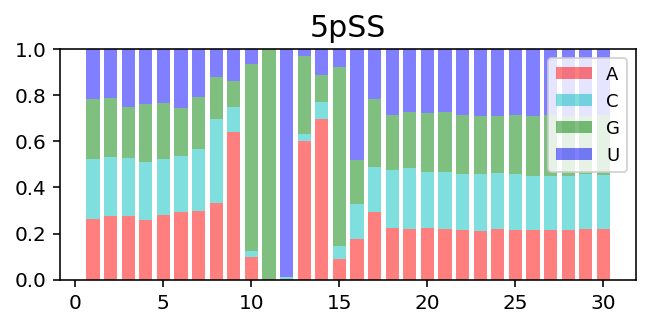

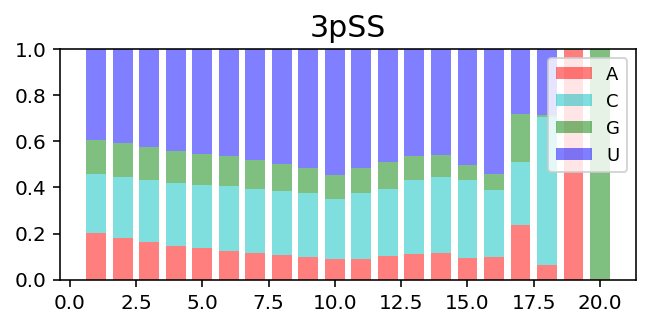

In [20]:
fp_seqs, tp_seqs = [], []
for i in range(X_all.shape[0]):
    fp_seqs += [a_fives[i, 20-fp_l:20+fp_r].reshape(1, -1, 4)]
    tp_seqs += [X_all[i, -20:].reshape(1, -1, 4)]
fp_seqs, tp_seqs = np.vstack(fp_seqs), np.vstack(tp_seqs)
print fp_seqs.shape, tp_seqs.shape
pwm_logo(pwm(fp_seqs), '5pSS')
pwm_logo(pwm(tp_seqs), '3pSS')
X_fp_tp = mutual_information(fp_seqs, tp_seqs)

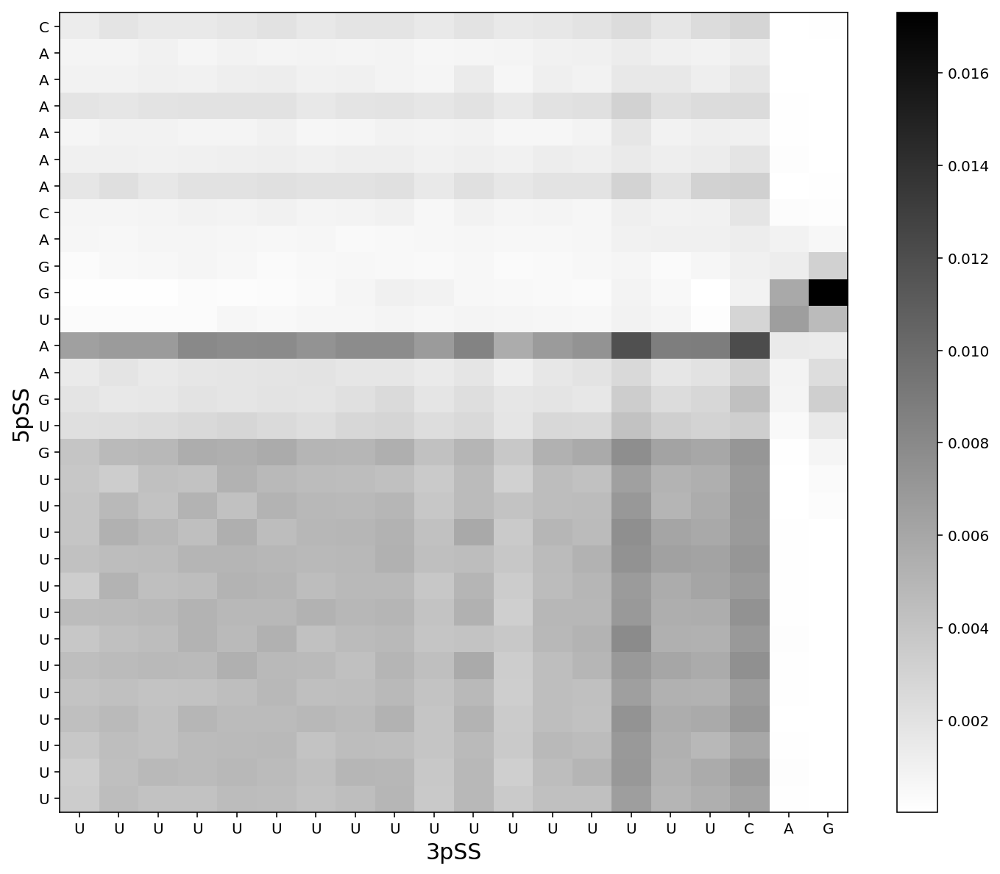

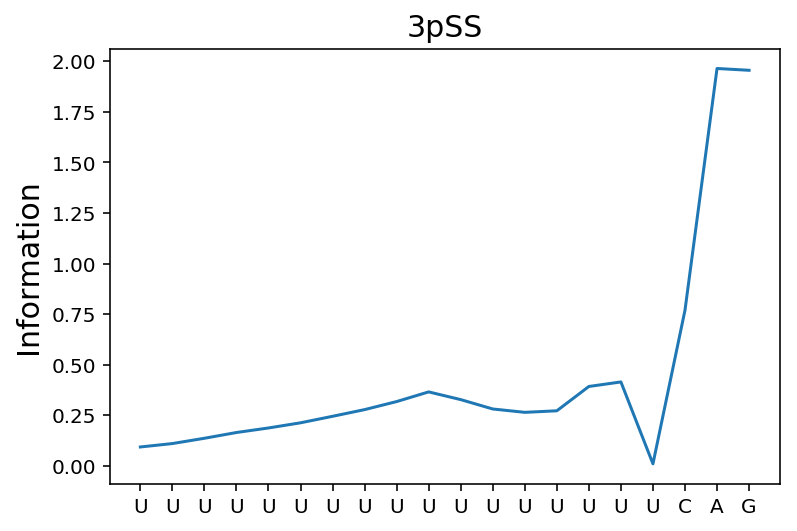

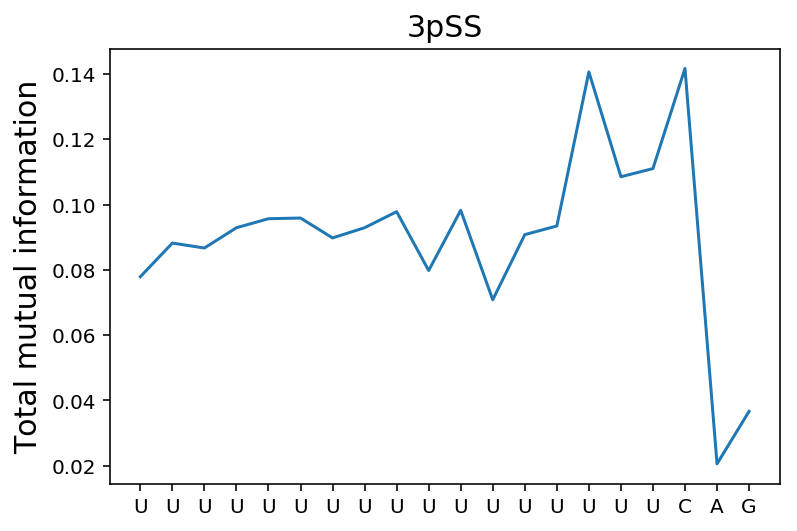

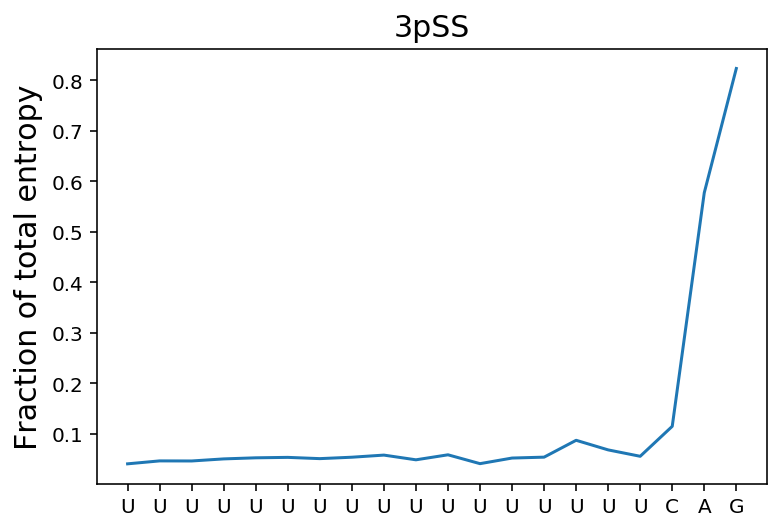

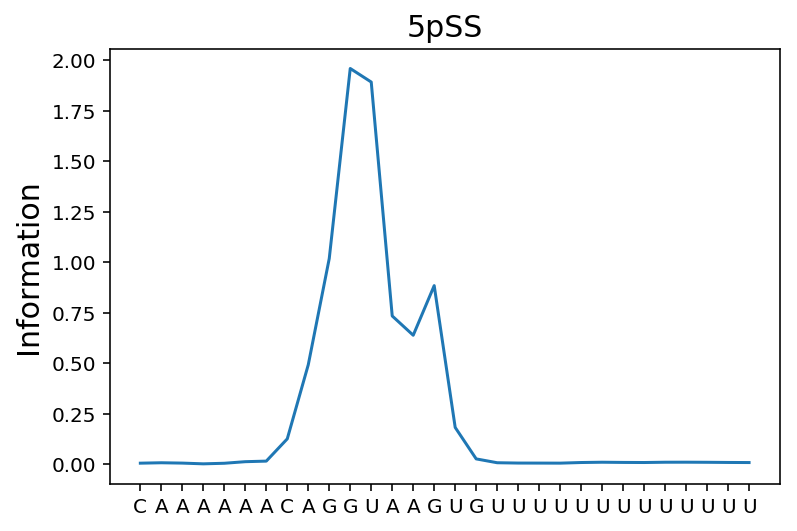

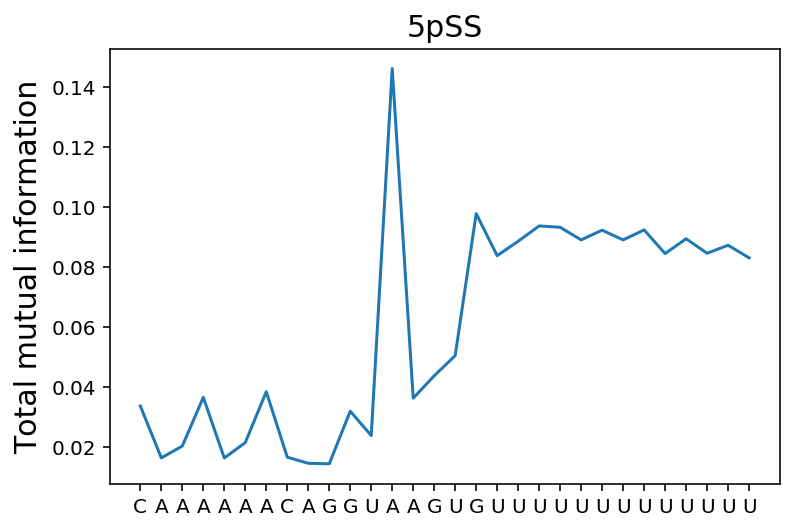

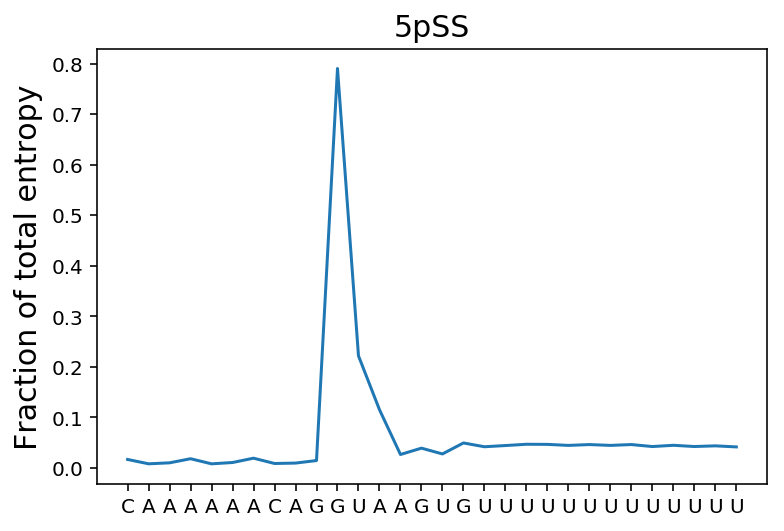

In [21]:
plot_mi(X_fp_tp, fp_seqs, tp_seqs, '5pSS', '3pSS')

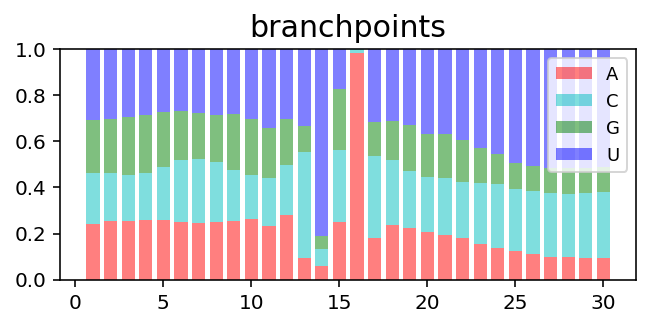

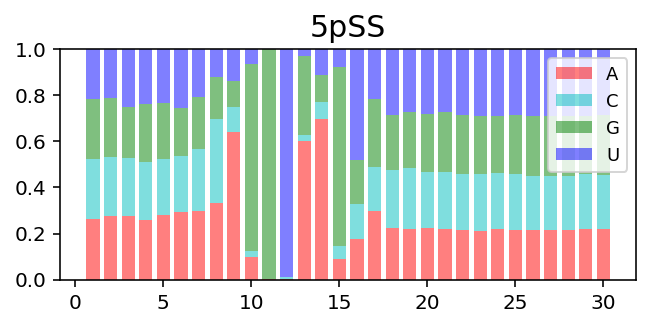

In [22]:
# BP-5'SS
bp_seqs2, fp_seqs2 = [], []
for i in range(X_all.shape[0]):
    bp = np.argmax(y_all[i])
    if bp_l < bp < 70 - bp_r:
        bp_seqs2 += [X_all[i, bp-bp_l:bp+bp_r].reshape(1, -1, 4)]
        fp_seqs2 += [a_fives[i, 20-fp_l:20+fp_r].reshape(1, -1, 4)]
bp_seqs2, fp_seqs2 = np.vstack(bp_seqs2), np.vstack(fp_seqs2)

pwm_logo(pwm(bp_seqs2), 'branchpoints')
pwm_logo(pwm(fp_seqs2), '5pSS')

X_fp_bp = mutual_information(fp_seqs2, bp_seqs2)

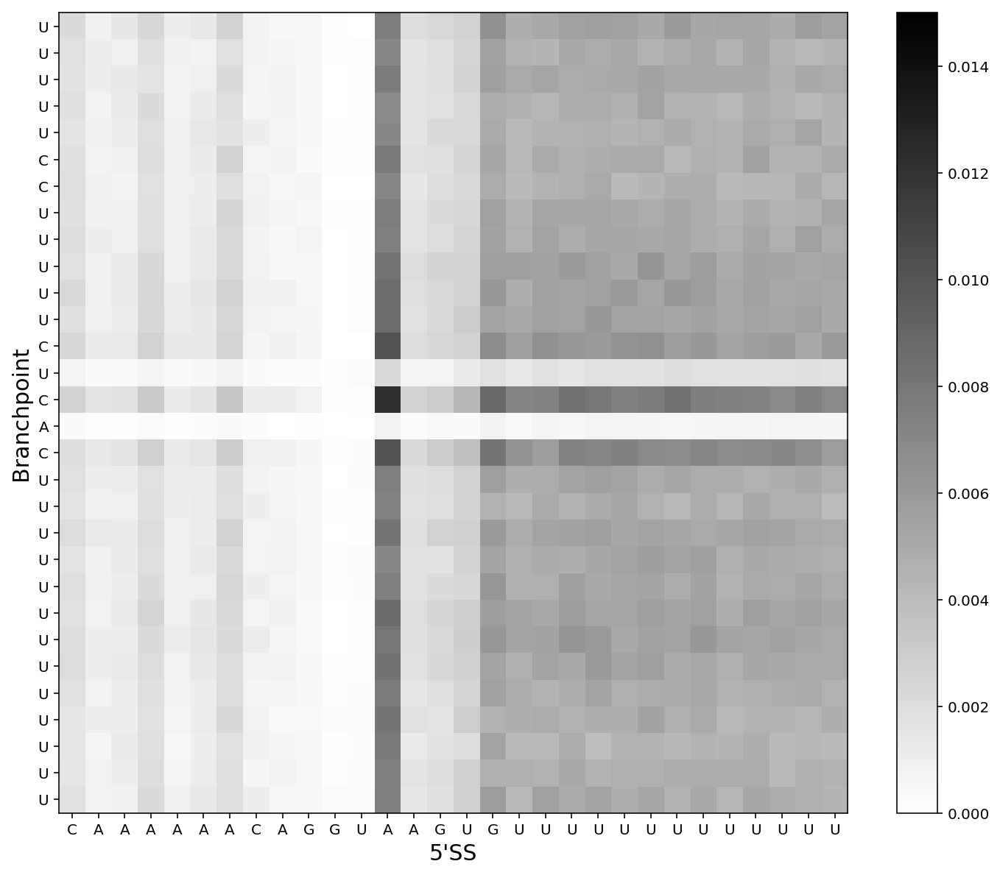

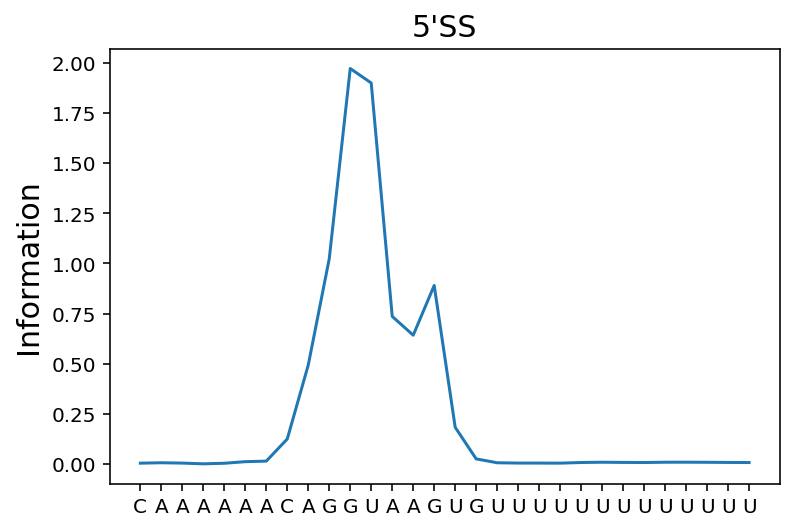

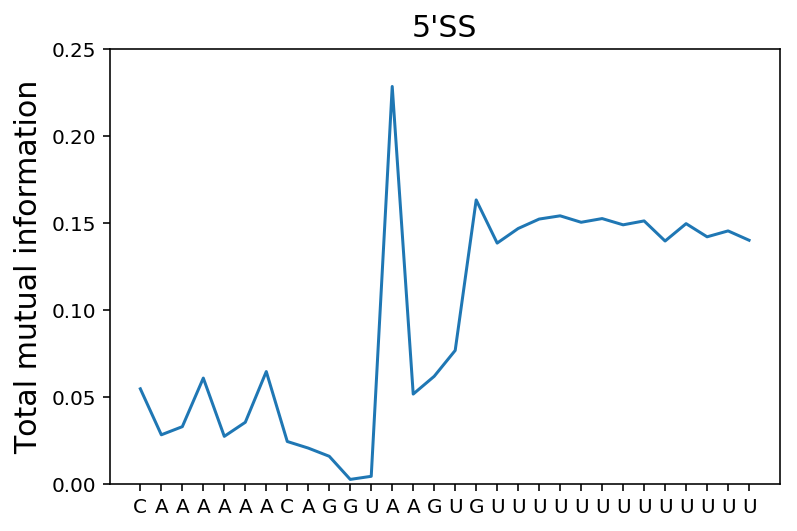

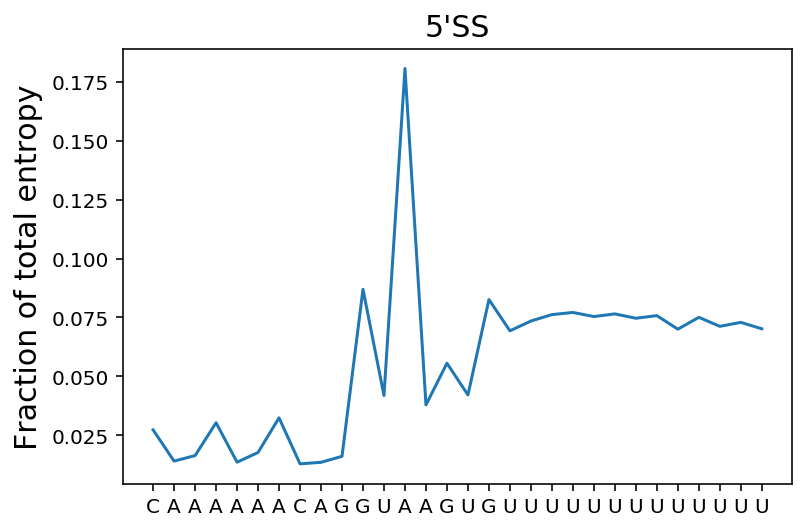

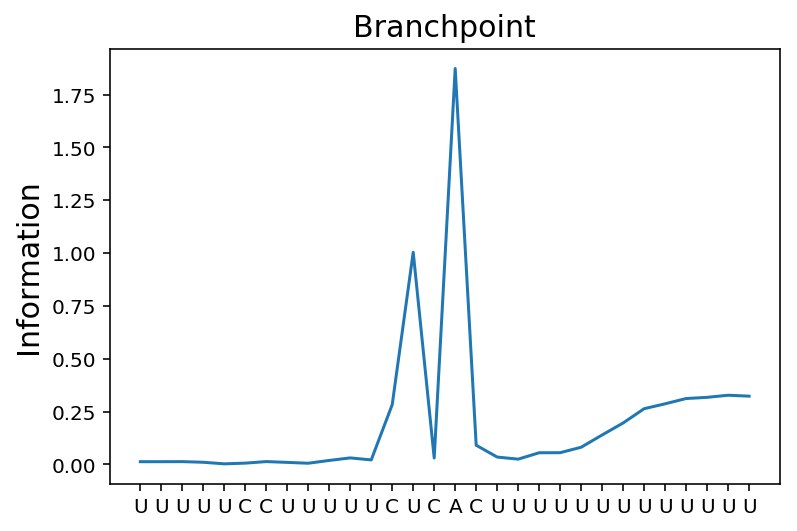

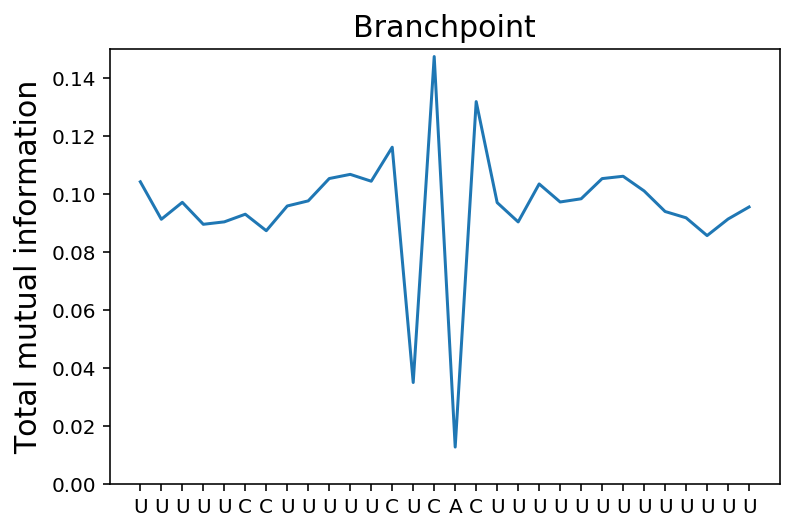

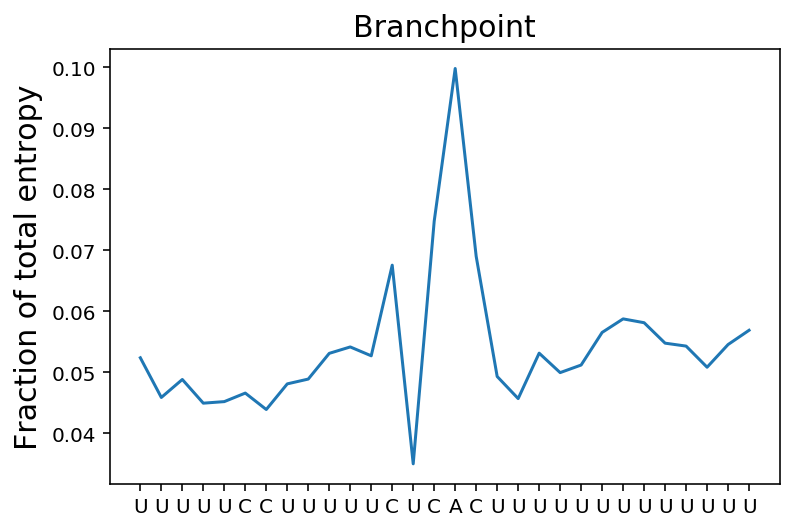

In [164]:
plot_mi(X_fp_bp.T, bp_seqs2, fp_seqs2,'Branchpoint', "5'SS")

(204489, 30, 4) (204489, 20, 4)


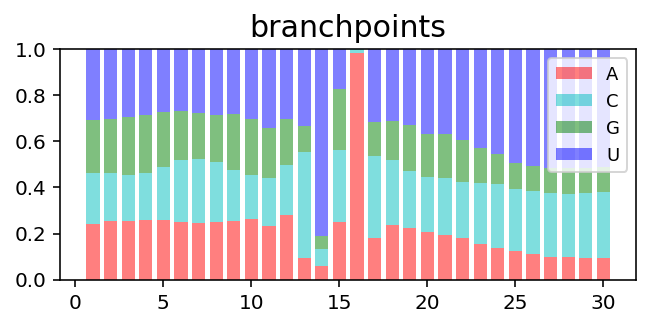

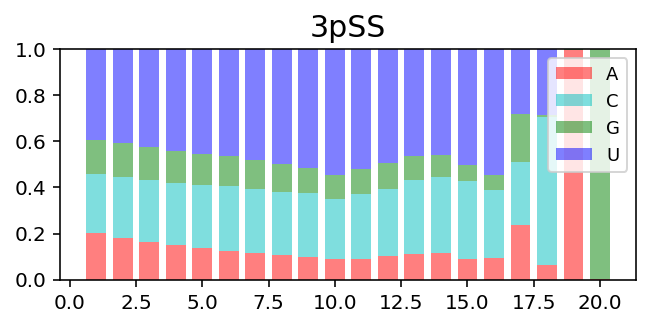

In [24]:
# BP-3'SS
bp_seqs3, tp_seqs3 = [], []
for i in range(X_all.shape[0]):
    bp = np.argmax(y_all[i])
    if bp_l < bp < 70 - bp_r:
        bp_seqs3 += [X_all[i, bp-bp_l:bp+bp_r].reshape(1, -1, 4)]
        tp_seqs3 += [X_all[i, -20:].reshape(1, -1, 4)]
bp_seqs3, tp_seqs3 = np.vstack(bp_seqs3), np.vstack(tp_seqs3)
print bp_seqs3.shape, tp_seqs3.shape
pwm_logo(pwm(bp_seqs3), 'branchpoints')
pwm_logo(pwm(tp_seqs3), '3pSS')

X_tp_bp = mutual_information(tp_seqs3, bp_seqs3)

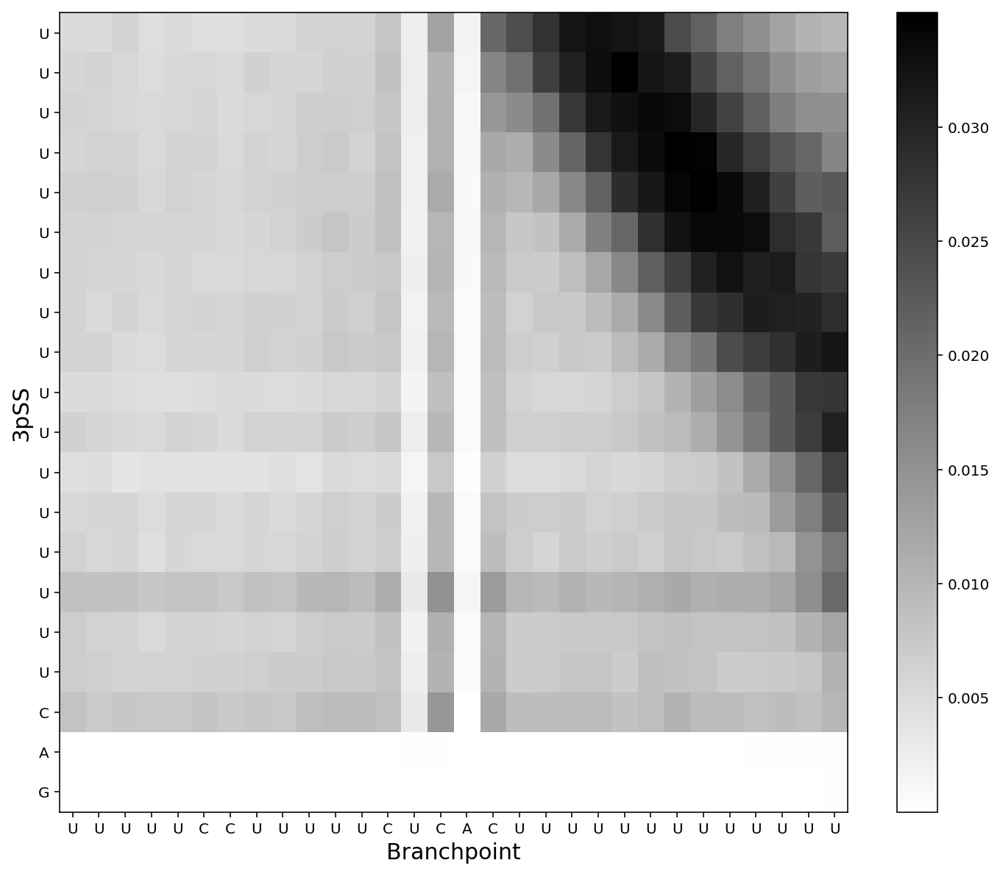

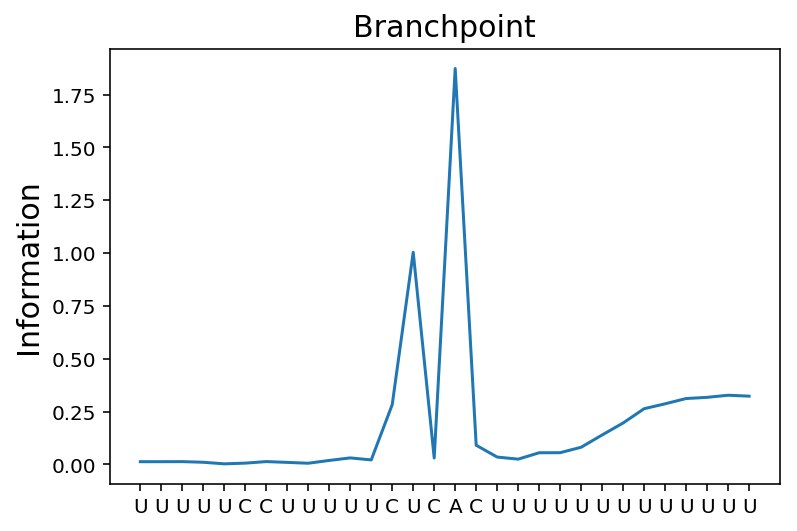

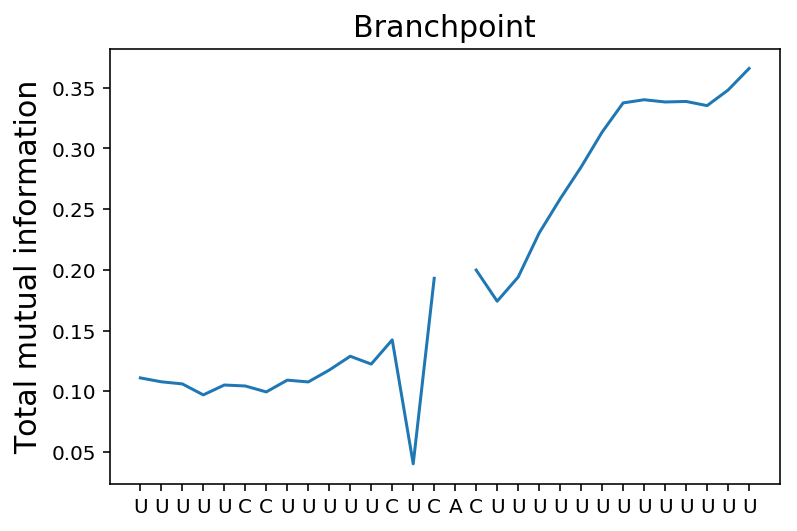

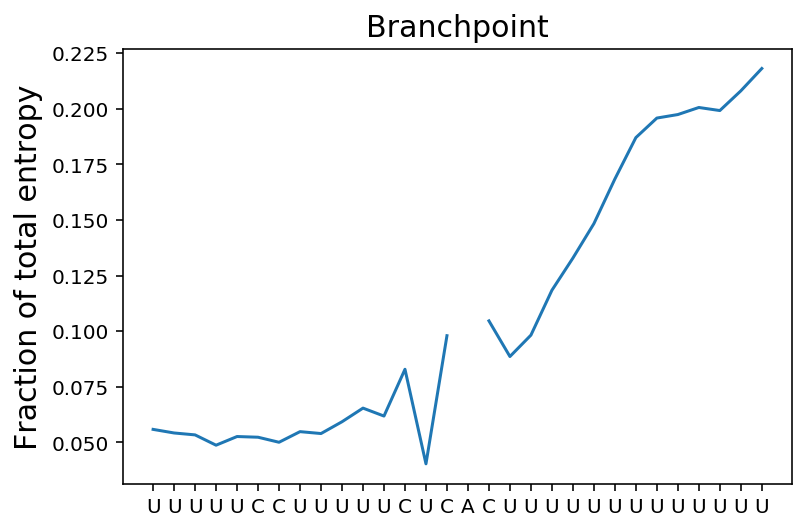

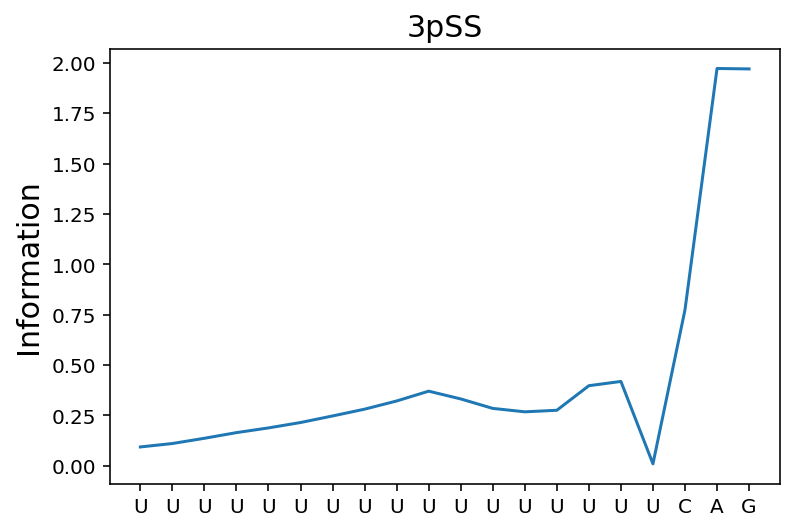

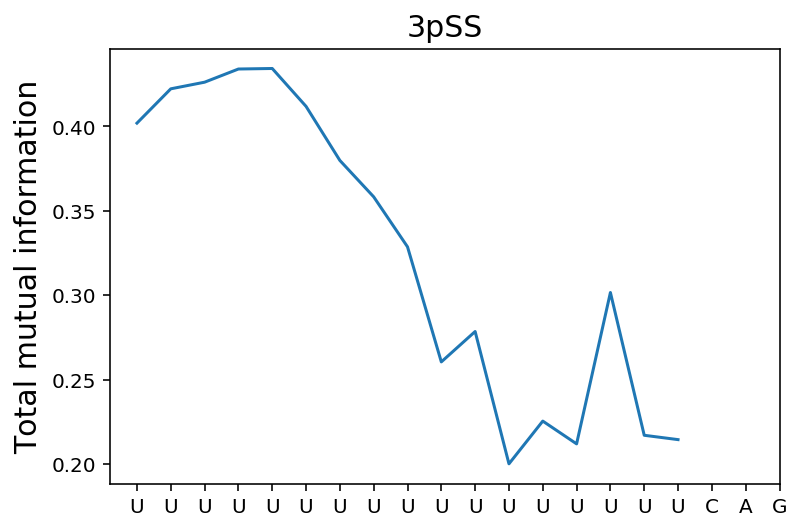

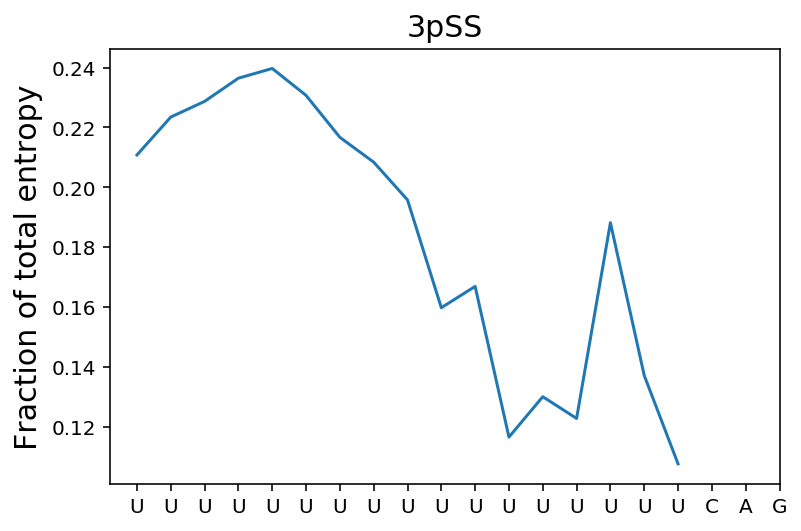

In [25]:
plot_mi(X_tp_bp, tp_seqs3, bp_seqs3, '3pSS', 'Branchpoint')

(130650, 30, 4) (130650, 30, 4)


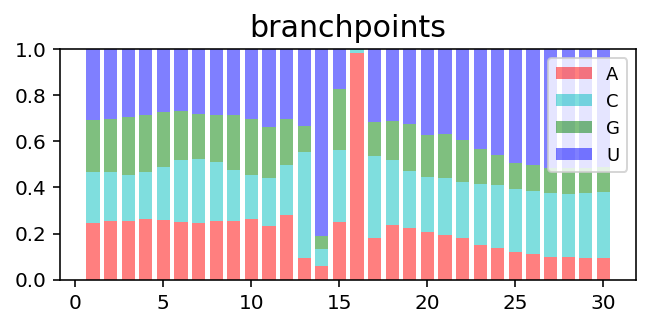

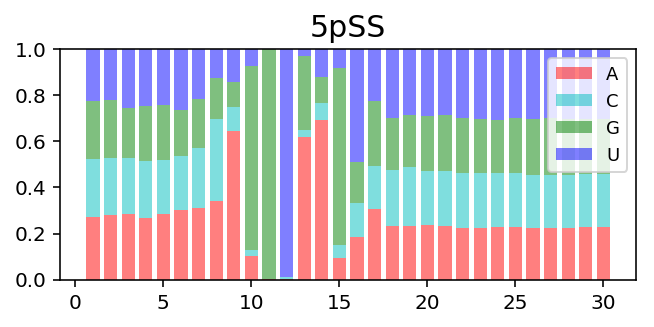

In [26]:
bp_seqs4, fp_seqs4 = [], []
for i in range(X_all.shape[0]):
    bp = np.argmax(y_all[i])
    if down_scan[i] == -15.19: continue
    if bp_l < bp < 70 - bp_r:
        bp_seqs4 += [X_all[i, bp-bp_l:bp+bp_r].reshape(1, -1, 4)]
        fp_seqs4 += [a_down_fives[i, 20-fp_l:20+fp_r].reshape(1, -1, 4)]
bp_seqs4, fp_seqs4 = np.vstack(bp_seqs4), np.vstack(fp_seqs4)
print bp_seqs4.shape, fp_seqs4.shape
pwm_logo(pwm(bp_seqs4), 'branchpoints')
pwm_logo(pwm(fp_seqs4), '5pSS')

X_efp_bp = mutual_information(fp_seqs4, bp_seqs4)

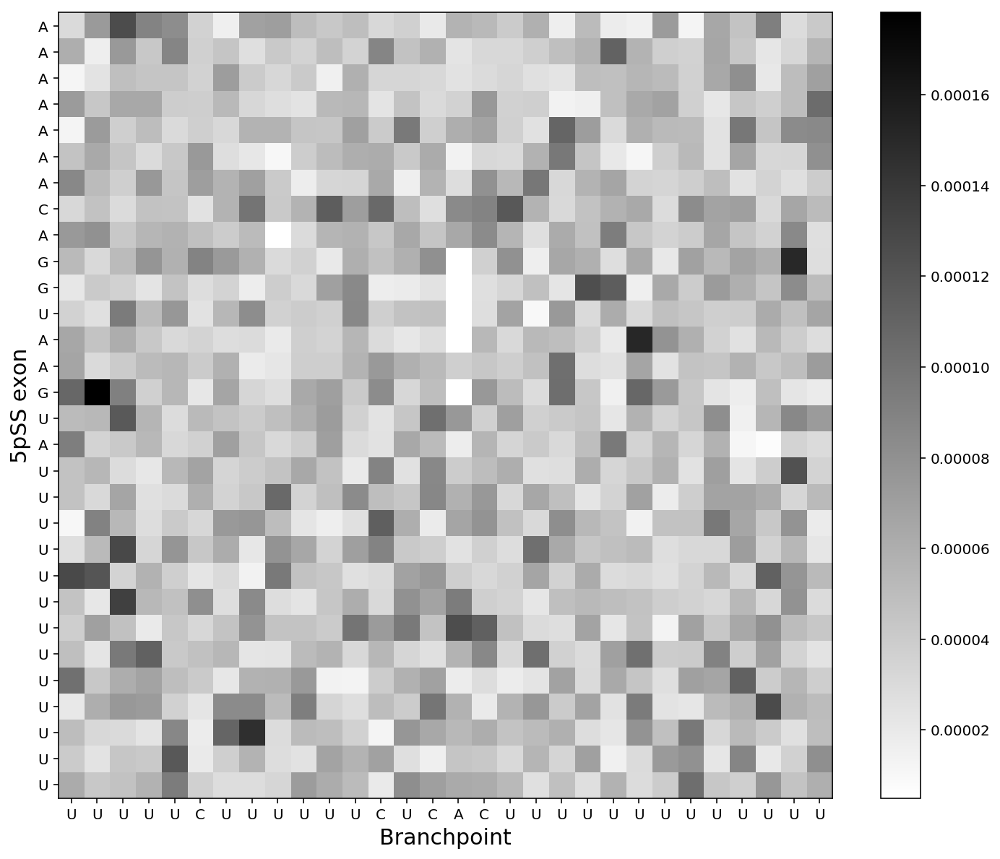

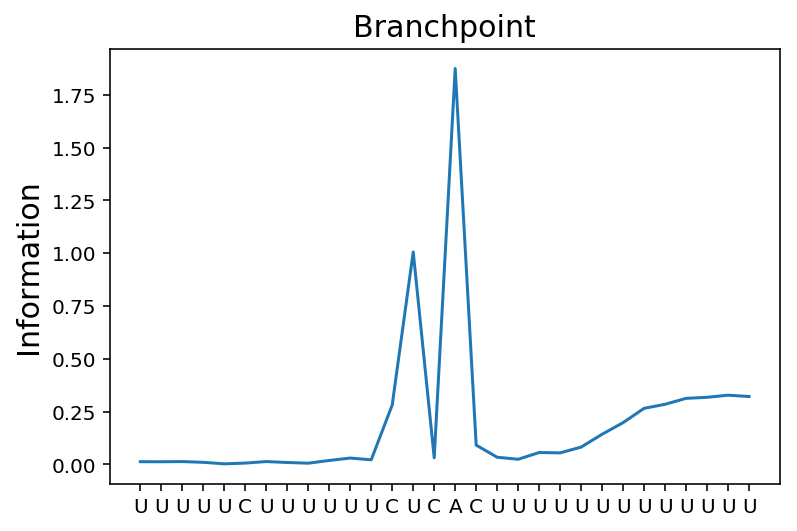

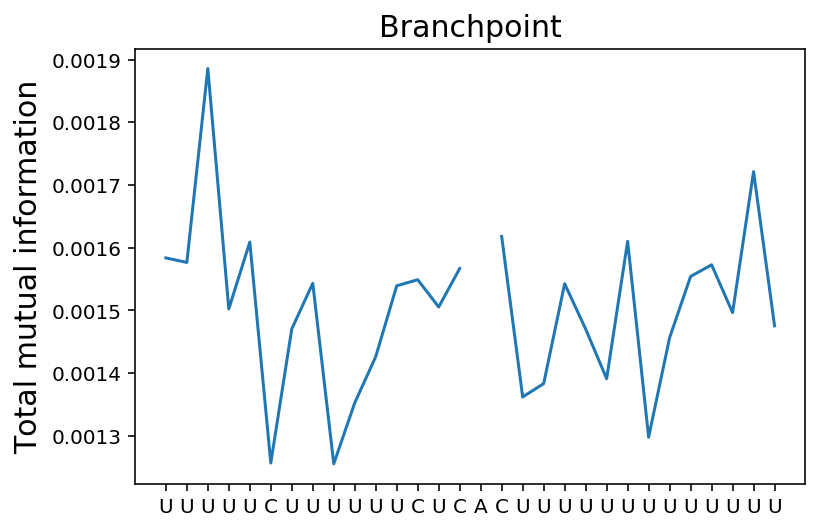

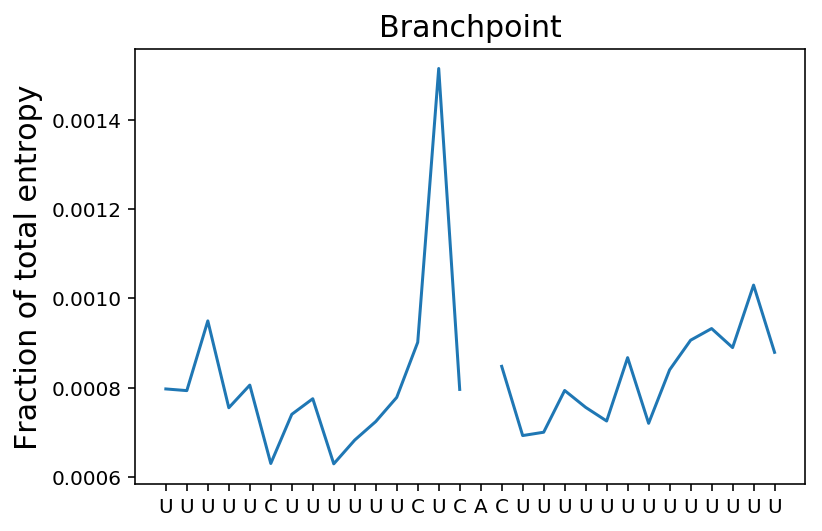

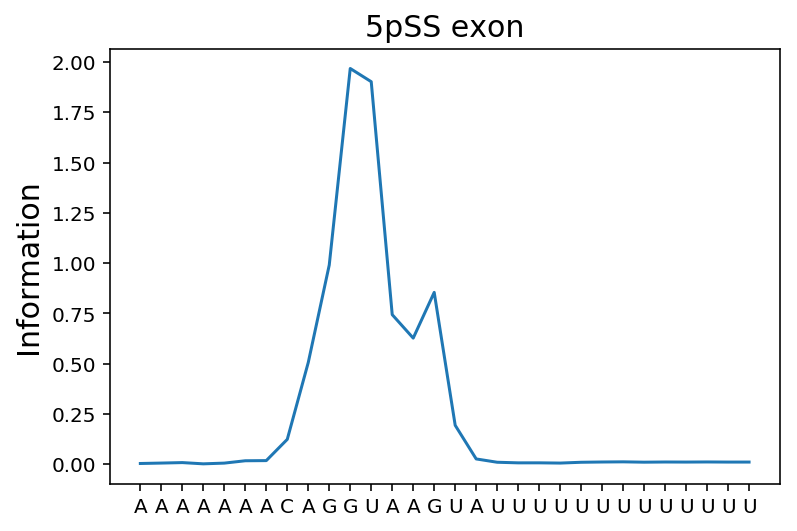

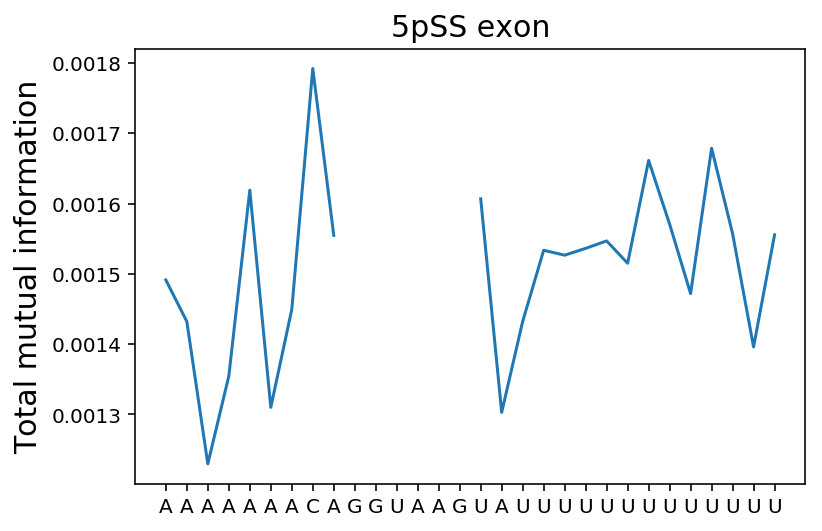

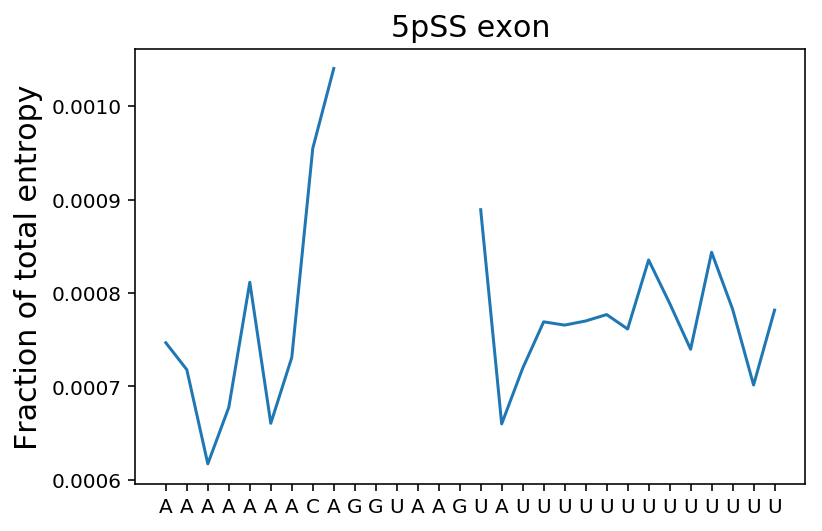

In [27]:
plot_mi(X_efp_bp, fp_seqs4, bp_seqs4, '5pSS exon', 'Branchpoint')

# Generate shuffled 5'SS Branchpoint pairs from matched distance distribution

I am worried that the above correlations are mediated only by intron length.

To address this concern, I here randomly pair branchpoints with 5'SSs from introns that are within 100 nucleotides in length as the branchpoint in question. Thereby, any correlations that are only due to intron length should also appear here.

Potential concerns:
- The intron lengths still don't precisely match... but they should be in the right ball park
- We are likely losing more long introns than short ones.

(204489, 30, 4) (204489, 30, 4) (204489,) (204489,) (204489,) (204489,)


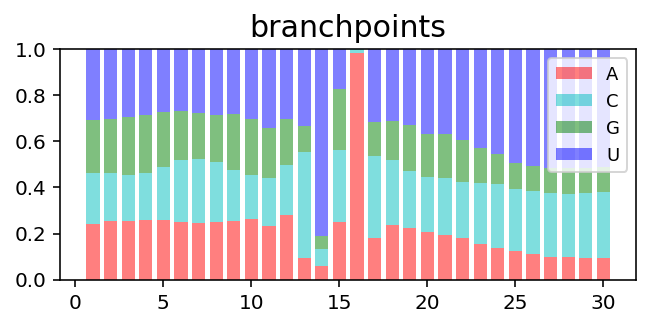

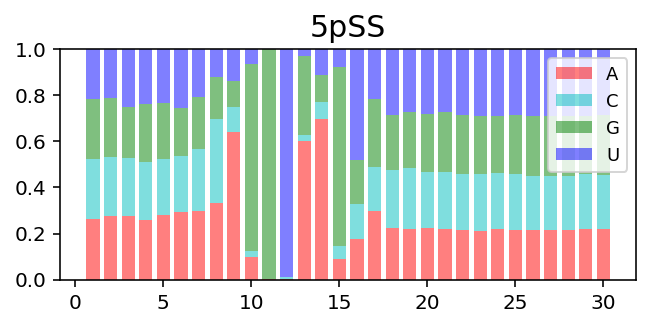

In [71]:
# BP-5'SS exchanging with similar lengths
bp_seqs2, fp_seqs2, coords, chroms, scan2 = [], [], [], [], []
for i in range(X_all.shape[0]):
    bp = np.argmax(y_all[i])
    if bp_l < bp < 70 - bp_r:
        bp_seqs2 += [X_all[i, bp-bp_l:bp+bp_r].reshape(1, -1, 4)]
        fp_seqs2 += [a_fives[i, 20-fp_l:20+fp_r].reshape(1, -1, 4)]
        coords += [a_coords[i]]
        chroms += [a_chroms[i]]
        scan2 += [scan[i]]
bp_seqs2, fp_seqs2, coords, chroms, scan2 = np.vstack(bp_seqs2), np.vstack(fp_seqs2), np.array(coords), np.array(chroms), np.array(scan2)
a_lengths = np.array([lengths[(chrom, coord)] for coord, chrom in zip(coords, chroms)])
print bp_seqs2.shape, fp_seqs2.shape, coords.shape, chroms.shape, a_lengths.shape, scan2.shape
pwm_logo(pwm(bp_seqs2), 'branchpoints')
pwm_logo(pwm(fp_seqs2), '5pSS')

In [121]:
from random import randint
accept = np.log10(1.05)
print accept
i = 0
exchanged_bp_seqs, exchanged_fp_seqs, exchanged_scan = [], [], []
l1, l2 = [], []
for bp, length1, coord1 in zip(bp_seqs2, a_lengths, coords):
    if not i % 10000:
        print i, len(exchanged_bp_seqs)
    i += 1
    for _ in xrange(bp_seqs2.shape[0]):
        j = randint(0, bp_seqs2.shape[0]-1)
        coord2 = coords[j]
        if coord1 == coord2: continue
        length2 = a_lengths[j]
        if np.abs(np.log10(length1) - np.log10(length2)) < accept:
            fp = fp_seqs2[j]
            exchanged_bp_seqs += [bp.reshape(1, -2, 4)]
            exchanged_fp_seqs += [fp.reshape(1, -2, 4)]
            exchanged_scan += [scan[j]]
            l1 += [length1]
            l2 += [length2]
            break

0.0211892990699
0 0
10000 9999
20000 19998
30000 29998
40000 39998
50000 49998
60000 59998
70000 69998
80000 79997
90000 89996
100000 99995
110000 109992
120000 119990
130000 129990
140000 139989
150000 149989
160000 159988
170000 169988
180000 179988
190000 189987
200000 199987


9999


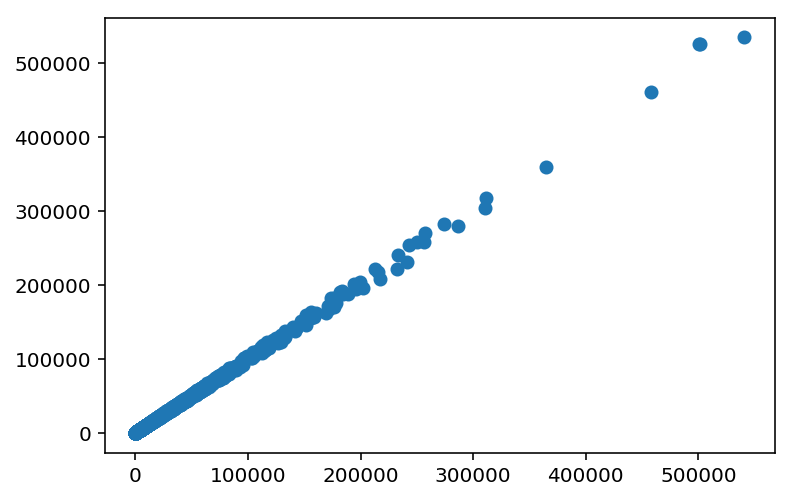

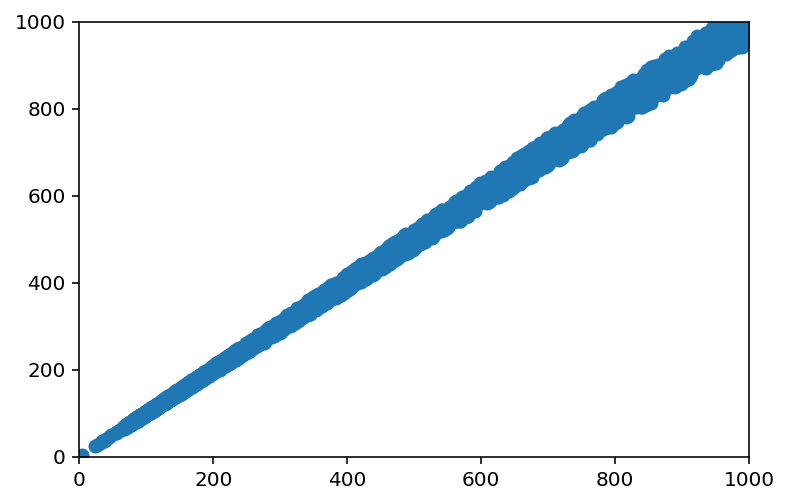

In [120]:
print len(l1)
plt.scatter(l1, l2)
plt.show()

plt.scatter(l1, l2)
plt.xlim(0, 1000)
plt.ylim(0, 1000)
plt.show()

In [128]:
exchanged_bp_seqs = np.vstack(exchanged_bp_seqs)
exchanged_fp_seqs = np.vstack(exchanged_fp_seqs)
exchanged_scan = np.array(exchanged_scan)

In [129]:
X_exchanged =  mutual_information(exchanged_fp_seqs, exchanged_bp_seqs)

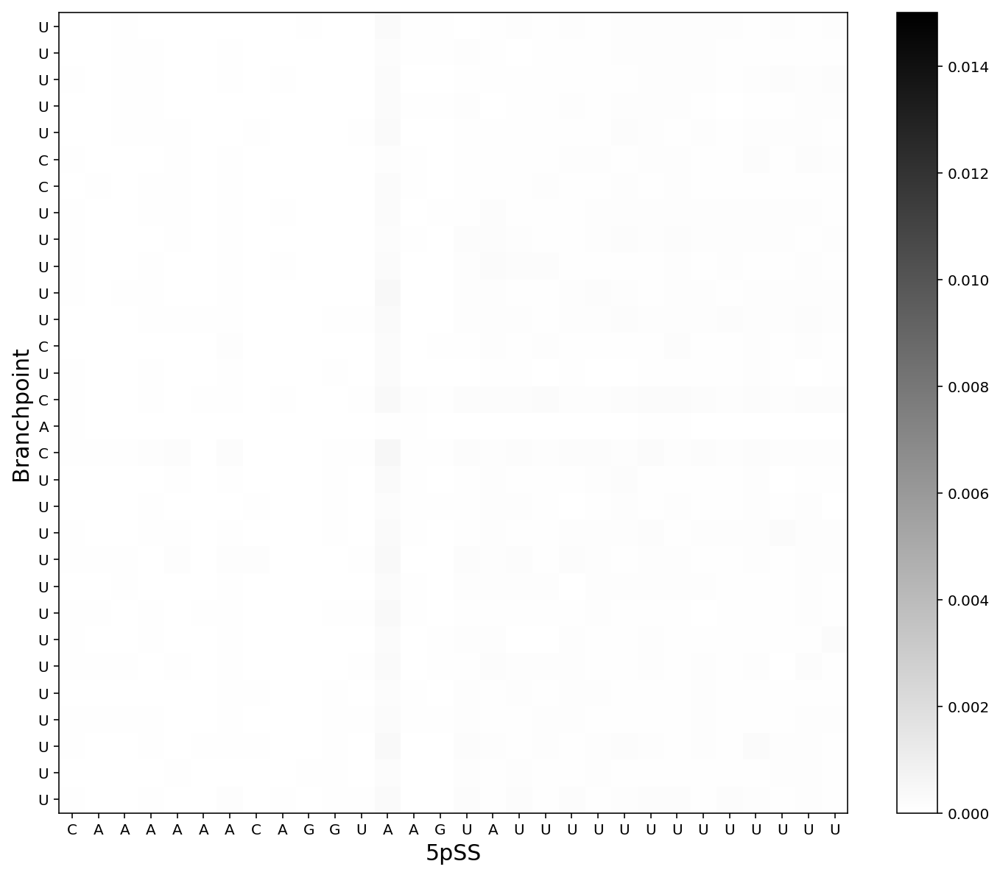

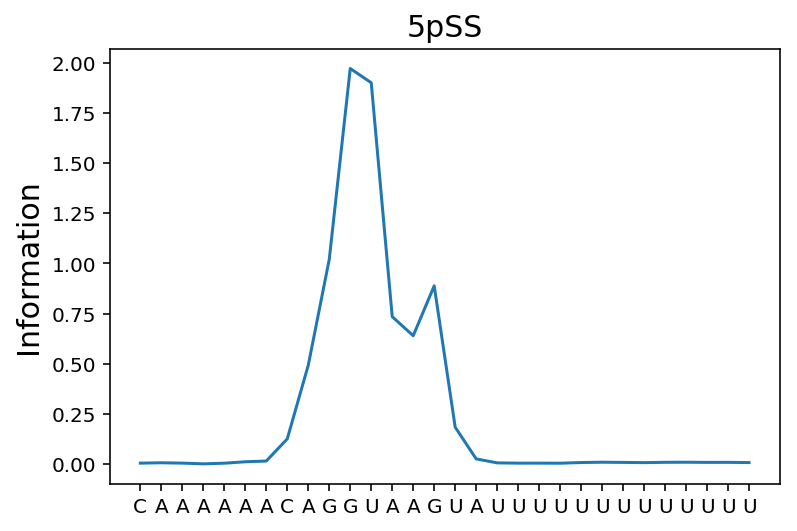

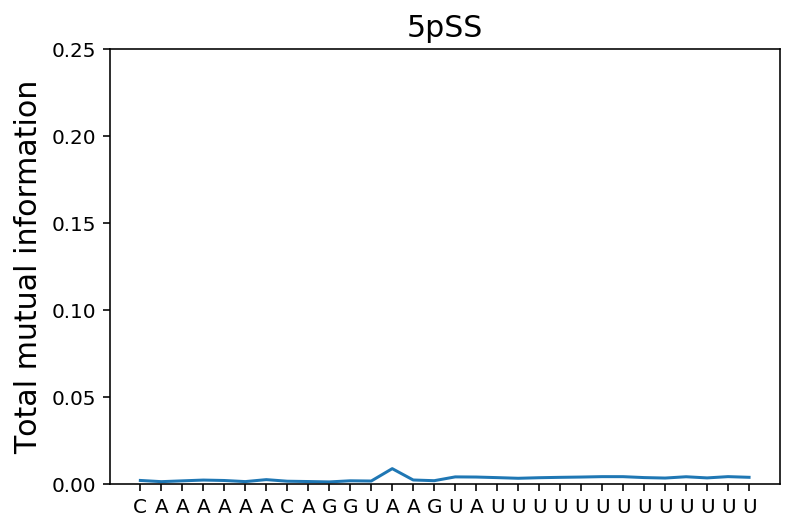

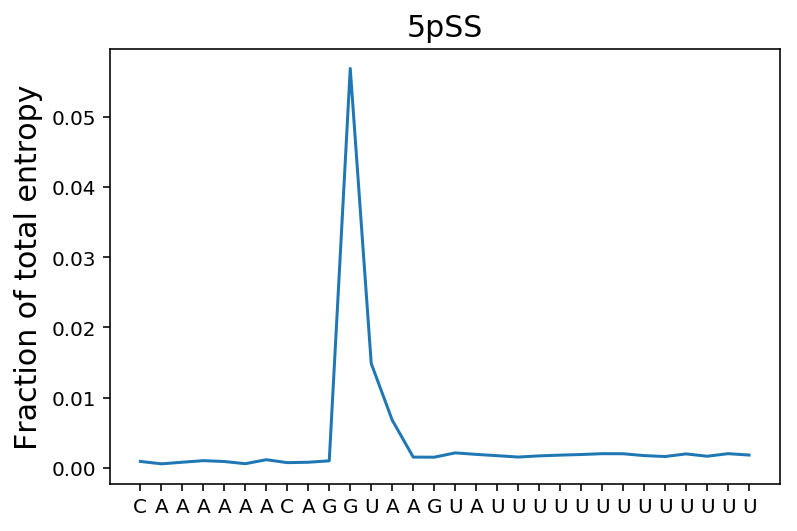

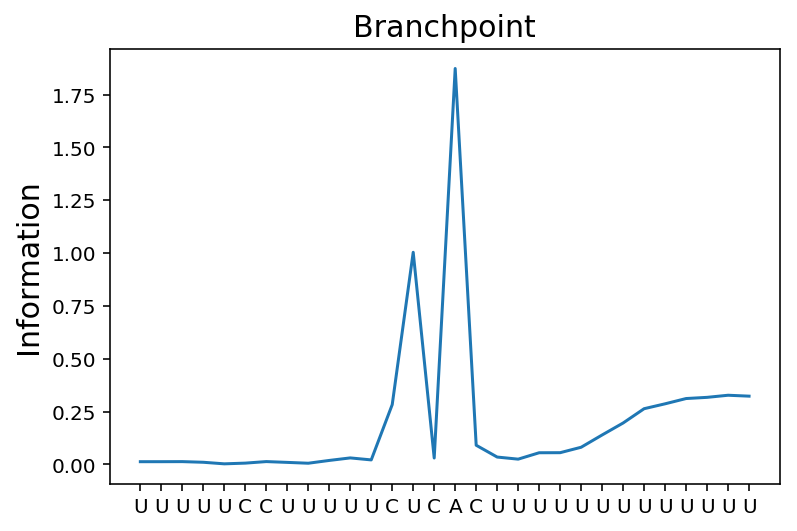

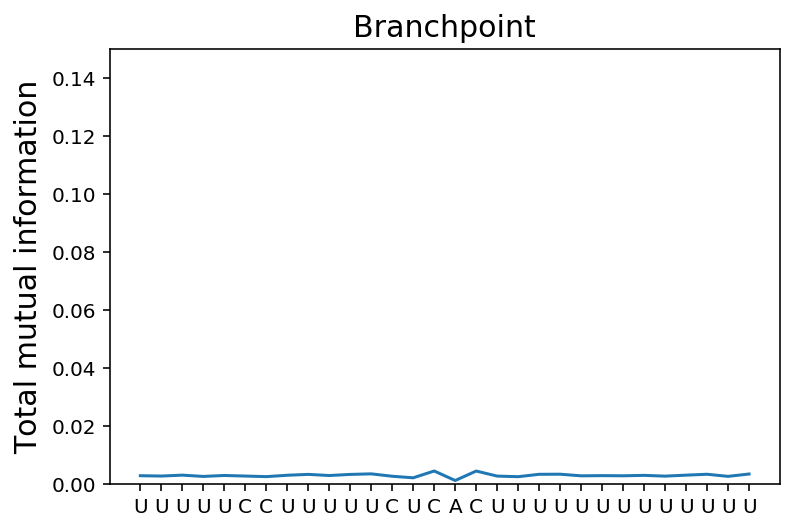

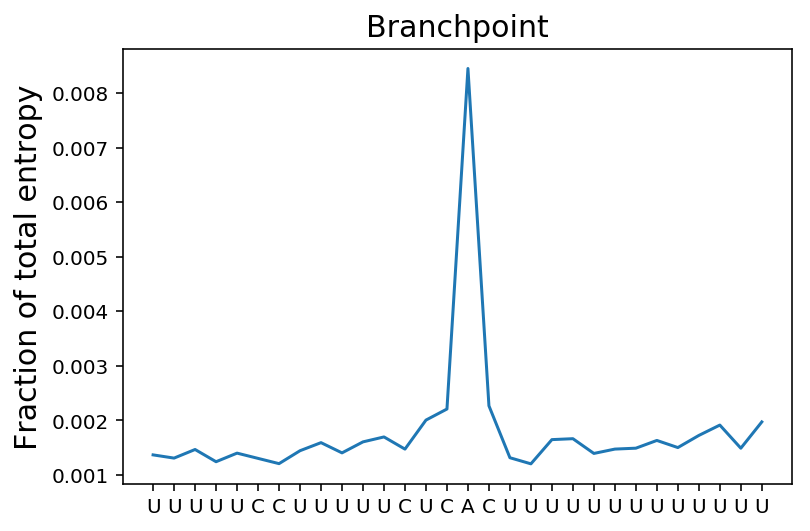

In [165]:
plot_mi(X_exchanged.T, exchanged_bp_seqs, exchanged_fp_seqs, 'Branchpoint', '5pSS')

3279 201078


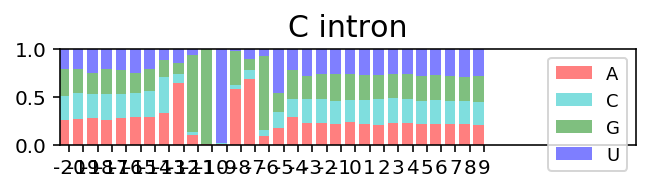

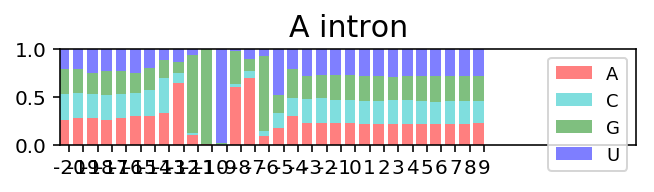

C intron information= 7.88502379613
A intron information= 8.12395458063
C intron information9= 7.75700560305
A intron information9= 7.9857875809
C intron maxentscan= 8.11672156145
A intron maxentscan= 8.10428077661
Ttest_indResult(statistic=0.23481731130705352, pvalue=0.81435076615751312)


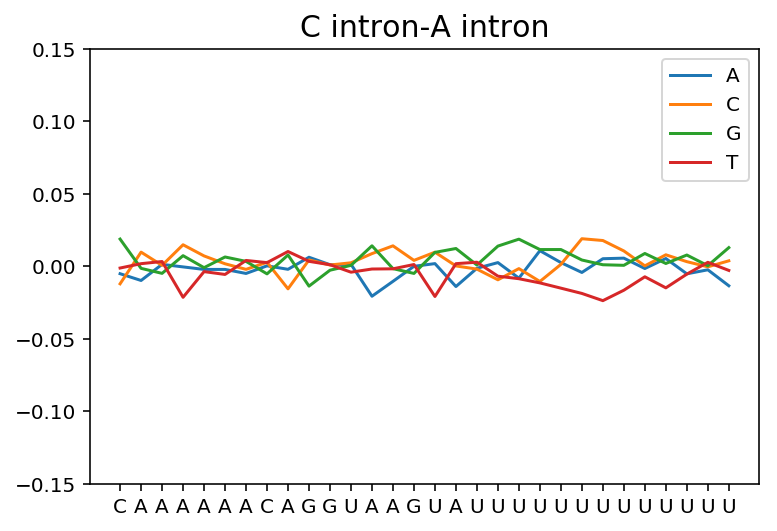

In [150]:
from scipy.stats import ttest_ind

K = 10
def pwm(X):
    return X.mean(axis = 0)[:, :4]

def information(pwm):
    entropy = pwm * np.log2(pwm)
    entropy[np.isnan(entropy)] = 0
    return 2*pwm.shape[0] + np.sum(entropy)

def adjustFigAspect(fig,aspect=1):
    '''
    Adjust the subplot parameters so that the figure has the correct
    aspect ratio.
    '''
    xsize,ysize = fig.get_size_inches()
    minsize = min(xsize,ysize)
    xlim = .4*minsize/xsize
    ylim = .4*minsize/ysize
    if aspect < 1:
        xlim *= aspect
    else:
        ylim /= aspect
    fig.subplots_adjust(left=.5-xlim,
                        right=.5+xlim,
                        bottom=.5-ylim,
                        top=.5+ylim)

def pwm_logo(pwm, title, x=None, aspect = 2.5):
    fig = plt.figure(figsize=(10,5))
    adjustFigAspect(fig,aspect=aspect)

    ax = fig.add_subplot(111)
    #f, ax1 = plt.subplots(1, figsize=(10,5))
    bar_width = 0.75
    bar_l = [i+1 for i in range(pwm.shape[0])]
    tick_pos = [i+(bar_width/2) for i in bar_l]

    for i, (char, color) in enumerate(zip(['A', 'C', 'G', 'U'],
                                 ['r', 'c','g', 'b'])):
        # Create a bar plot, in position bar_1
        ax.bar(bar_l,
               pwm[:, i],
               width=bar_width,
               label=char,
               bottom=np.sum(pwm[:, :i], axis = 1),
               alpha=0.5,
               color = color)
    plt.xticks(tick_pos, x if x else range(-K, K+1))
    plt.legend(loc = 1, prop={'size':9})
    plt.title(title)
    plt.ylim(0, 1)
    plt.xlim(.75, len(x)+1 if x else 2*K+2)
    plt.show()
    
def info(idx1, idx2, title1, title2, fives_onehot, fives_scan, ylim):
    print len(idx1), len(idx2)
    
    pwm1, pwm2 = pwm(fives_onehot[idx1]), pwm(fives_onehot[idx2])

    pwm_logo(pwm1, title1, range(-20, 20), 6)
    pwm_logo(pwm2, title2, range(-20, 20), 6)
    print title1, 'information=', information(pwm1)
    print title2, 'information=', information(pwm2)
    print title1, 'information9=', information(pwm1[fp_l-3:fp_l+6+1])
    print title2, 'information9=', information(pwm2[fp_l-3:fp_l+6+1])
    print title1, 'maxentscan=', np.mean(fives_scan[idx1])
    print title2, 'maxentscan=', np.mean(fives_scan[idx2])
    print ttest_ind(fives_scan[idx1], fives_scan[idx2])
    
    for i in range(4):
        plt.plot(pwm1[:, i] - pwm2[:, i], label = bases[i])
    plt.legend()
    plt.xticks(range(fives_onehot.shape[1]), [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(fives_onehot), axis = 1)])
    plt.title(title1 + '-' + title2)
    plt.ylim(-ylim, ylim)
    plt.show()
    
C = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 1]: continue
    C += [i]
    
A = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 0]: continue
    A += [i]

info(C, A, 'C intron', 'A intron', exchanged_fp_seqs, exchanged_scan, .15)

3280 201090


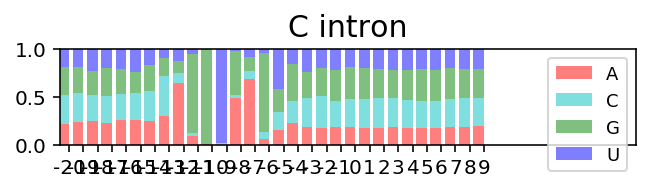

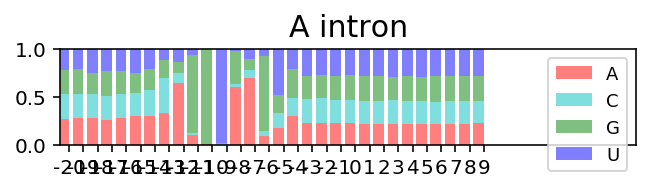

C intron information= 8.65574593806
A intron information= 8.13244656388
C intron information9= 8.07466079474
A intron information9= 7.9931496734
C intron maxentscan= 7.89340853659
A intron maxentscan= 8.15536197722
Ttest_indResult(statistic=-5.2759950628087458, pvalue=1.3217171914998718e-07)


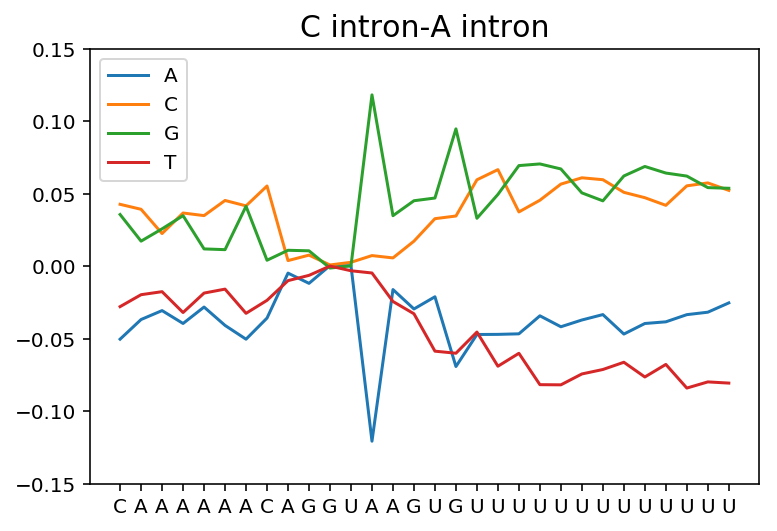

In [151]:
C = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 1]: continue
    C += [i]
    
A = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 0]: continue
    A += [i]

info(C, A, 'C intron', 'A intron', fp_seqs2, scan2, .15)

38544 165932


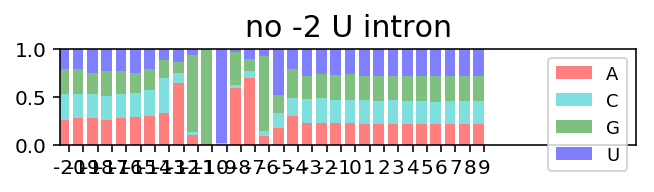

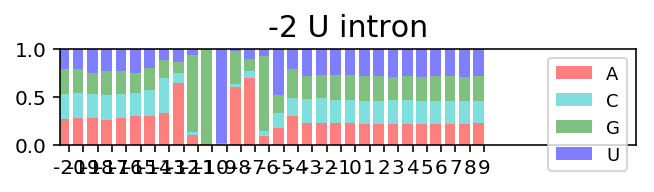

no -2 U intron information= 8.04948919384
-2 U intron information= 8.13644678928
no -2 U intron information9= 7.92025557761
-2 U intron information9= 7.99617539062
no -2 U intron maxentscan= 8.10972083852
-2 U intron maxentscan= 8.1029430128
Ttest_indResult(statistic=0.39829831469572241, pvalue=0.69041071847061075)


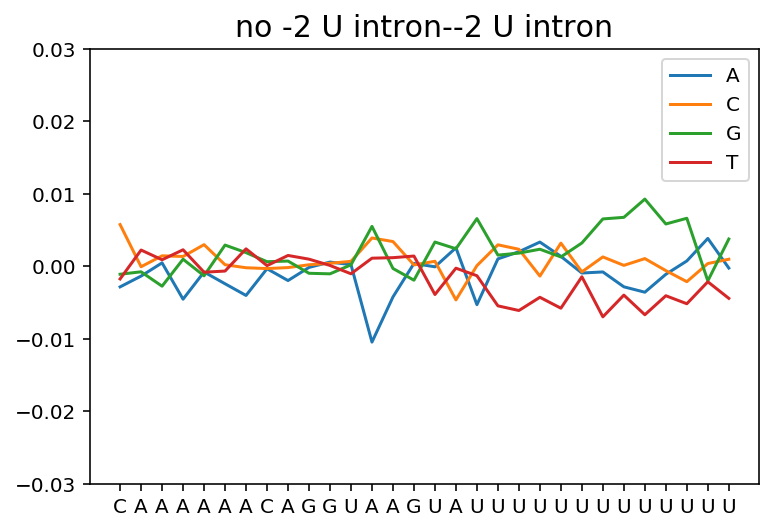

In [157]:
U = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp-2, 3]: continue
    U += [i]
    
noU = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if seq[bp-2, 3]: continue
    noU += [i]
info(noU, U, 'no -2 U intron', '-2 U intron', exchanged_fp_seqs, exchanged_scan, .03)

38547 165942


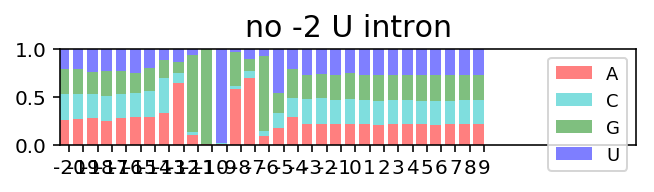

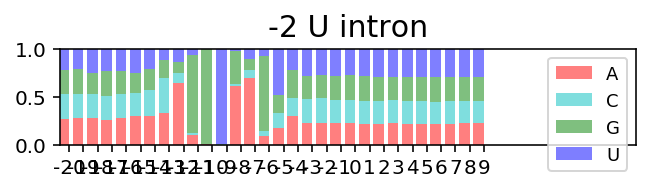

no -2 U intron information= 8.00947843226
-2 U intron information= 8.16336946425
no -2 U intron information9= 7.87643926338
-2 U intron information9= 8.01978479453
no -2 U intron maxentscan= 8.00932575817
-2 U intron maxentscan= 8.18338985911
Ttest_indResult(statistic=-10.902787706796833, pvalue=1.137591430943349e-27)


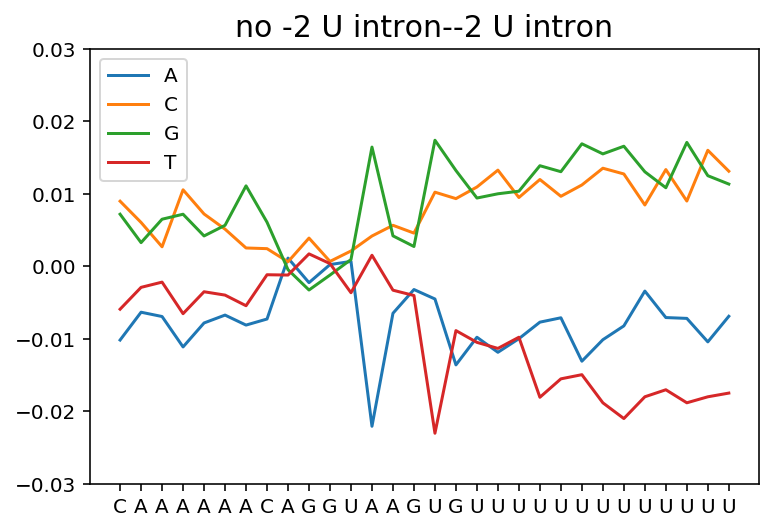

In [156]:
U = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp-2, 3]: continue
    U += [i]
    
noU = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if seq[bp-2, 3]: continue
    noU += [i]
info(noU, U, 'no -2 U intron', '-2 U intron', fp_seqs2, scan2, .03)

0.0140556626681
0.118166980808
0.00548602799046
0.0164289896326


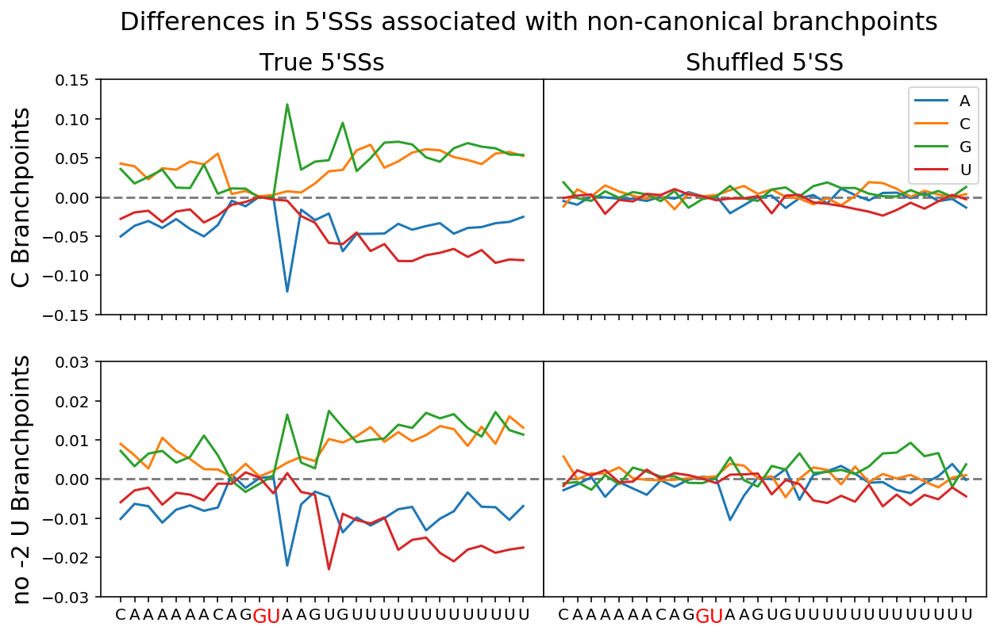

In [378]:
def content(ax, idx1, idx2, fives_onehot, fives_scan, ylim):
    pwm1, pwm2 = pwm(fives_onehot[idx1]), pwm(fives_onehot[idx2])
    ax.axhline(0, color = 'gray', ls='--')
    for i in range(4):
        ax.plot(pwm1[:, i] - pwm2[:, i], label = bases[i] if i != 3 else 'U')
        if i == 2: print pwm1[fp_l+2, i] - pwm2[fp_l+2, i]
    plt.xticks(range(fives_onehot.shape[1]),
               [bases[i] if i != 3 else 'U' for i in np.argmax(pwm(fives_onehot), axis = 1)])
    for i in [10, 11]:
        ax.get_xticklabels()[i].set_color("red")
        ax.get_xticklabels()[i].set_size(12)
    ax.set_ylim(-ylim, ylim)

f, ax = plt.subplots(2, 2, figsize = (10, 6), sharex=True)    

# Shuffled C Branchpoints
C = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 1]: continue
    C += [i]
    
A = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 0]: continue
    A += [i]

content(ax[0, 1], C, A, exchanged_fp_seqs, exchanged_scan, .15)


# Real C Branchpoints
C = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 1]: continue
    C += [i]
    
A = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp, 0]: continue
    A += [i]

content(ax[0, 0], C, A, fp_seqs2, scan2, .15)


# Shuffled -2 U
U = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp-2, 3]: continue
    U += [i]
    
noU = []
for i, seq in enumerate(exchanged_bp_seqs):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if seq[bp-2, 3]: continue
    noU += [i]

content(ax[1, 1], noU, U, exchanged_fp_seqs, exchanged_scan, .03)
# Real -2 U
U = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if not seq[bp-2, 3]: continue
    U += [i]
    
noU = []
for i, seq in enumerate(bp_seqs2):
    bp = bp_l
    if 0 > bp-K or bp+K+1 > seq.shape[0]: continue
    if seq[bp-2, 3]: continue
    noU += [i]
content(ax[1, 0], noU, U, fp_seqs2, scan2, .03)
ax[0, 1].legend(loc = 1)

ax[0, 1].set_yticks([], [])
ax[1, 1].set_yticks([], [])
plt.subplots_adjust(wspace=0, hspace=.2)

ax[0, 0].set_title("True 5'SSs")
ax[0, 1].set_title("Shuffled 5'SS")

ax[0, 0].set_ylabel("C Branchpoints")
ax[1, 0].set_ylabel("no -2 U Branchpoints")


plt.suptitle("Differences in 5'SSs associated with non-canonical branchpoints" , fontsize = 16)
plt.show()

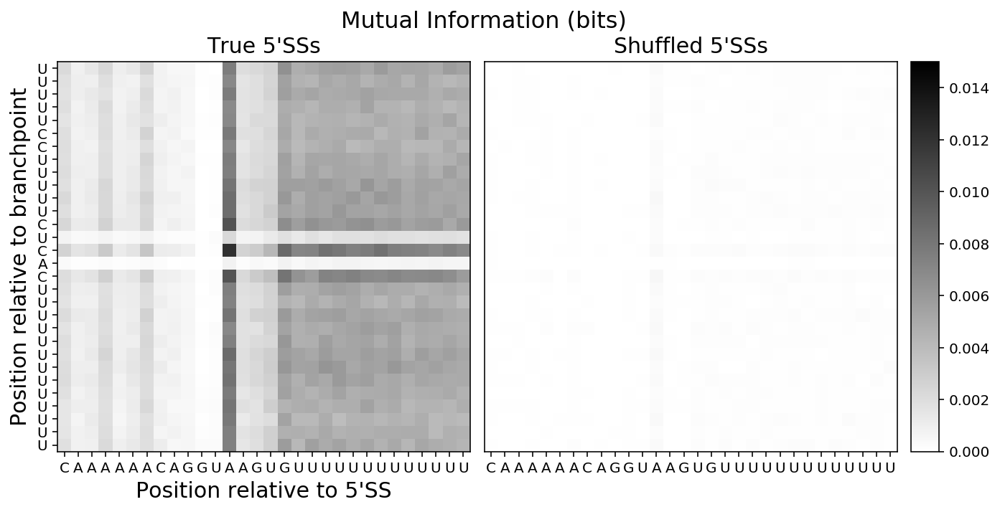

In [253]:
from matplotlib.gridspec import GridSpec

def mi(ax, X):
    X[np.isnan(X)] = 0
    
    plt.colorbar(sc)

# Mutual information figure
f = plt.figure(figsize = (11, 5))
gs = GridSpec(1, 3, width_ratios=[15, 15, 1], wspace=.05)

ax = [plt.subplot(gs[i]) for i in range(3)]

sc = ax[0].imshow(X_fp_bp.T, aspect = 'auto',cmap='binary', vmax=0.015)
ax[1].imshow(X_exchanged.T, aspect = 'auto',cmap='binary', vmax=0.015)
plt.colorbar(sc, cax =ax[2])
ax[1].set_yticks([], [])
for i in range(2):
    ax[i].set_xticks(range(fp_seqs2.shape[1]))
    ax[i].set_xticklabels([bases[i] if i != 3 else 'U' for i in np.argmax(pwm(fp_seqs2), axis = 1)])
ax[0].set_yticks(range(bp_seqs2.shape[1]))
ax[0].set_yticklabels([bases[i] if i != 3 else 'U' for i in np.argmax(pwm(bp_seqs2), axis = 1)])

ax[0].set_title("True 5'SSs")
ax[1].set_title("Shuffled 5'SSs")
plt.suptitle('Mutual Information (bits)', fontsize = 16)
ax[0].set_ylabel('Position relative to branchpoint')
ax[0].set_xlabel("Position relative to 5'SS")
plt.show()

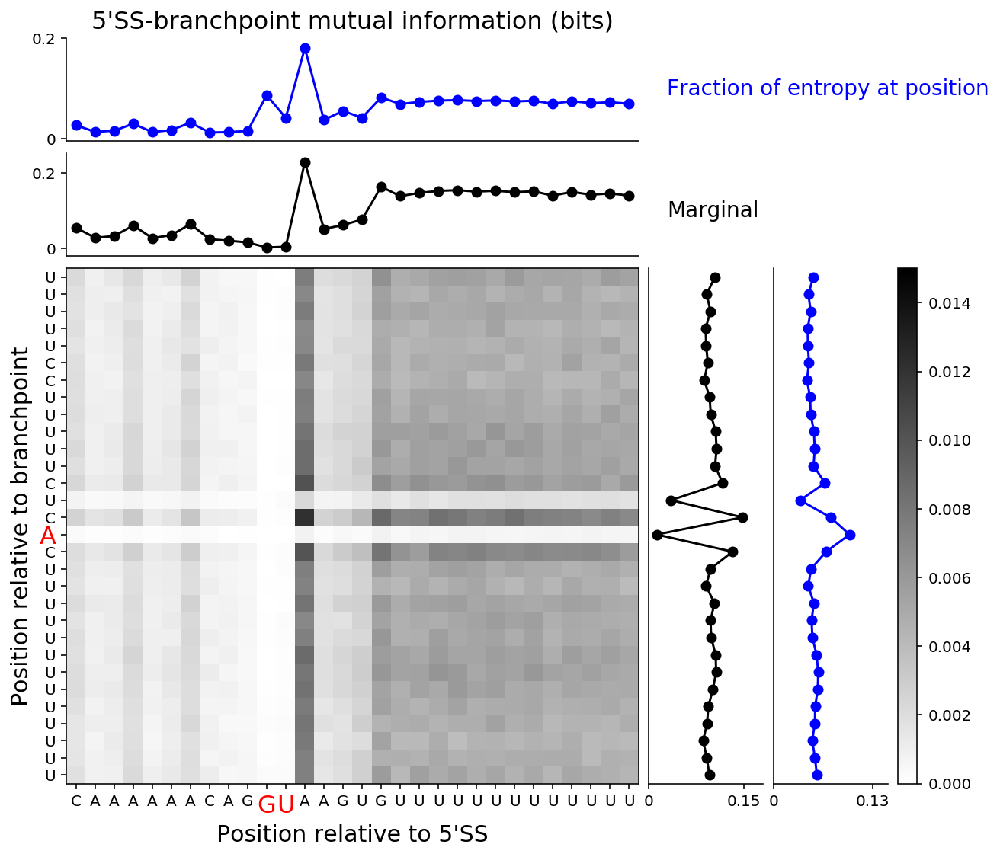

In [376]:
def information(pwm):
    return 2 + (pwm * np.log2(pwm)).sum(axis = 1)

f = plt.figure(figsize=(10, 9))
gs = GridSpec(3, 4,  width_ratios = [15, 3, 3, .5],
              height_ratios = [3, 3, 15], hspace = 0.05, wspace = 0.05)


# Heatmap
sc = plt.subplot(gs[2, 0]).imshow(X_fp_bp.T, aspect = 'auto',cmap='binary', vmax=0.015)
plt.colorbar(sc, cax = plt.subplot(gs[2, 3]))

# Marginals
plt.subplot(gs[1, 0]).plot(X_fp_bp.sum(axis = 1), c='k')
plt.subplot(gs[1, 0]).scatter(range(X_fp_bp.shape[0]),X_fp_bp.sum(axis =1), c='k')
plt.subplot(gs[1, 0]).set_yticks([0, 0.2])
plt.subplot(gs[1, 0]).set_yticklabels([0, 0.2])
plt.subplot(gs[1, 0]).set_yticklabels([0, 0.2])
plt.subplot(gs[1, 0]).spines['right'].set_visible(False)
plt.subplot(gs[1, 0]).spines['top'].set_visible(False)
plt.subplot(gs[1, 0]).set_xticks([])
plt.subplot(gs[1, 0]).set_xlim(-.5, 29.5)

plt.subplot(gs[2, 1]).plot(X_fp_bp.sum(axis =0), range(X_fp_bp.shape[0])[::-1], c='k')
plt.subplot(gs[2, 1]).scatter(X_fp_bp.sum(axis =0), range(X_fp_bp.shape[0])[::-1], c='k')
plt.subplot(gs[2, 1]).set_xlim(0, 0.18)
plt.subplot(gs[2, 1]).set_xticks([0, 0.15])
plt.subplot(gs[2, 1]).set_xticklabels([0, 0.15])
plt.subplot(gs[2, 1]).set_yticks([])
plt.subplot(gs[2, 1]).spines['right'].set_visible(False)
plt.subplot(gs[2, 1]).spines['top'].set_visible(False)
plt.subplot(gs[2, 1]).set_ylim(-.5, 29.5)

# Label
plt.subplot(gs[1, 0]).text(X_fp_bp.shape[0]+1, 0.1, 'Marginal',
                           size=14, ha='left', va='center')
plt.subplot(gs[0, 0]).text(X_fp_bp.shape[0]+1, 0.1, 'Fraction of entropy at position',
                           size=14, ha='left', va='center', color='b')


# Fraction
info = X_fp_bp.sum(axis =1) / (2-information(pwm(fp_seqs2)))
plt.subplot(gs[0, 0]).plot(info, c='b')
plt.subplot(gs[0, 0]).scatter(range(X_fp_bp.shape[0]),info, c='b')
plt.subplot(gs[0, 0]).set_yticks([0, 0.2])
plt.subplot(gs[0, 0]).set_yticklabels([0, 0.2])
plt.subplot(gs[0, 0]).set_yticklabels([0, 0.2])
plt.subplot(gs[0, 0]).spines['right'].set_visible(False)
plt.subplot(gs[0, 0]).spines['top'].set_visible(False)
plt.subplot(gs[0, 0]).set_xticks([])
plt.subplot(gs[0, 0]).set_xlim(-.5, 29.5)

info = X_fp_bp.sum(axis =0) / (2-information(pwm(bp_seqs2)))
plt.subplot(gs[2, 2]).plot(info, range(X_fp_bp.shape[0])[::-1], c='b')
plt.subplot(gs[2, 2]).scatter(info, range(X_fp_bp.shape[0])[::-1], c='b')
plt.subplot(gs[2, 2]).set_xlim(0, 0.15)
plt.subplot(gs[2, 2]).set_xticks([0, 0.13])
plt.subplot(gs[2, 2]).set_xticklabels([0, 0.13])
plt.subplot(gs[2, 2]).set_yticks([])
plt.subplot(gs[2, 2]).spines['right'].set_visible(False)
plt.subplot(gs[2, 2]).spines['top'].set_visible(False)
plt.subplot(gs[2, 2]).set_ylim(-.5, 29.5)

# Ticks
plt.subplot(gs[2, 0]).set_xticks(range(fp_seqs2.shape[1]))
plt.subplot(gs[2, 0]).set_xticklabels([bases[i] if i != 3 else 'U' for i in np.argmax(pwm(fp_seqs2), axis = 1)])
for i in [10, 11]:
    plt.subplot(gs[2, 0]).get_xticklabels()[i].set_color("red")
    plt.subplot(gs[2, 0]).get_xticklabels()[i].set_size(16)

plt.subplot(gs[2, 0]).set_yticks(range(bp_seqs2.shape[1]))
plt.subplot(gs[2, 0]).set_yticklabels([bases[i] if i != 3 else 'U' for i in np.argmax(pwm(bp_seqs2), axis = 1)])
i=15
plt.subplot(gs[2, 0]).get_yticklabels()[i].set_color("red")
plt.subplot(gs[2, 0]).get_yticklabels()[i].set_size(16)

plt.subplot(gs[2, 0]).set_ylabel('Position relative to branchpoint')
plt.subplot(gs[2, 0]).set_xlabel("Position relative to 5'SS")
plt.subplot(gs[0, 0]).set_title("5'SS-branchpoint mutual information (bits)", fontsize = 16)
plt.show()